# UC San Diego: Neural Data Science

## Studying the Impacts of Music on Quality of Sleep using EEG Recordings

## Permissions

Place an X in the appropriate bracket below to specify if you would like your group's project to be made available to the public. (Note that student names will be included (but PIDs will be scraped from any groups who include their PIDs).


[x] YES - make available

[ ] NO - keep private

## Group Members
Sam Kapusta, Brian Ripley, Lian Lumada, Edmundo Zamora, and Joshua Fierro

## Introduction 

Sleep quality was a topic we all found of interest, particularly the ways that listening to music in comparison to other noise affects sleep quality- both in time spent falling asleep as well as the depth of sleep. It is common for students to struggle to sleep in silence, often turning to various forms of sound such as music, podcasts and TV to doze off. We are interested in studying the ways in which this recent change affects the quality of one’s sleep, theorizing that quality will be most affected by the type of sound listened being listened to.

## Research Question
The goal of our project was to analyze existing literature and conduct further EEG analysis on whether music positively or negatively impacts the quality and duration of sleep.

## Background & Prior Work 

We were initially inspired by a study which determined that only certain types of music have a positive impact on sleep quality [1]. Music was played in frequencies that corresponded to brain waves: rapid eye movement (REM) or slow wave sleep (SWS). White noise was used as a control. The researchers concluded that only individuals in the SWS group may have had their sleep quality positively effected. We had reached out to the publishers of this paper in hopes of obtaining their data but were left without a response.

The publication did however reference many other related works from which we could pull EEG data from. We began our project on a separate dataset making use of concurrent fMRI and EEG data. This dataset brought to our attention the various challenges and interpretation issues that result from such data collections. The most notable methods analyzed were Component Analysis, Network Characterization, Granger Casuality Analysis, Dynamic Casual Modeling, and Graph Theoretical Analysis [2].
    
The paper also included analyses in how research done on sleep networks could impact other domains of neuroscience. For instance, the authors theorized that because sleep and comas share many commonalities, an increase in thalamocortical connectivity studies could be very influential if applied to coma and general anestasia patients [2]. The applications beyond simple sleep were intriguing to us.

We had been working with the previously mentioned dataset until we heard back from the publishers of a third study. Similar to the first, which initially peaked our interest, music was played in similar frequencies to that of a particular sleep stage. The participants had EEG recordings over several naps, including one with delta-wave inducing music being played beforehand. A control text was played before a separate nap [3]. 

The study shows a general increase in self-reported sleep quality after listening to music, which is in line with past research. One objective sleep measure is a measurement of the proportion of slow wave activity to beta wave activity. Slow wave activity is indicative of better sleep while beta wave lighter. A separate objective measure is the time spent in N1 sleep. That is, the quicker the subject passed N1 sleep, the better objective sleep measure. Subjects listening to music spent less time in the N1 transition phase, between being awake and fully sleep. The study also found reduced power in the sigma band of 11-15 Hz. [3]

Additionally, participants performed a memory task before and after their nap in each of the trials. In contradiction to the researchers' hypothesis, participants who had listened to music had worse task performance. The researchers theorized that this was caused by a reduction in sigma power as sleep spindles are likely a significant factor for successful sleep consolidation during sleep [3].

In this project, we attempt to partially replicate the methodology. We will look at the time spent in the N1 sleep stage and the ratio between the power of slow wave activity and beta activity in non-REM sleep. However, when analyzing the power spectral densities we will instead the FOOOF tool, developed by VoytekLab [4]. This extra tool accounts for both periodic and aperiodic activity when in the past, aperiodic activity has long been ignored. Due to this, background activity may have been ignored and false oscillations considered in analysis leading to conflated results. 

As an aside, when reaching out to the researchers inquiring about access to their data. We were obliged, but were only sent pre-processed data as opposed to the raw form. This brings to light a prevalent issue in the realm of academic data science [5]. Through this pre-processed data, we could not gather our own, novel conclusions. We were eventually provided with the raw data from which we could process in our own manner, and hopefully then come to new conclusions.



References:

[1]https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7026372/#:~:text=We%20suggest%20that%20SWS%20brain,latency%20to%20improve%20sleep%20quality.

[2] https://www.frontiersin.org/articles/10.3389/fneur.2012.00100/full

[3] https://www.nature.com/articles/s41598-019-45608-y#Sec9

[4] https://fooof-tools.github.io/fooof/#

[5] https://journals.plos.org/ploscompbiol/article?id=10.1371/journal.pcbi.1005037

## Hypothesis

Based on existing research, our group's hypothesis was that listening to music would decrease the amount of time taken for participants to fall asleep, increase self-reported quality of sleep, and decrease some of the power levels of sigma bands closely correlated to sleep quality. 

## Datasets

**Dataset 1:**
- Dataset Name: Effects of Relaxing Music on Sleep
- Dataset Article: https://www.nature.com/articles/s41598-019-45608-y#data-availability 
- Dataset Stored: https://drive.google.com/drive/folders/1NAD4zQb9tulAUJO8Wipe_fytlL9EJBAu?usp=sharing 
- Number of observations: 27
- Summary: 27 women were provided memory tasks to complete before and after completing a 90 minute sleep session, a control group listened to nothing while the study group had music playing. 

**Dataset 2:**
- Conducted literature review using LISC
- Analyzed under "Data Visualization" section and performed coocurance matrix of terms



## Data Cleaning & Wrangling



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
cd drive/Shareddrives/COGS\ 138

/content/drive/Shareddrives/COGS 138


In [ ]:
ls

sample_data/


In [ ]:
!pip install mne
!pip install fooof

     |████████████████████████████████| 7.4 MB 4.2 MB/s 
     |████████████████████████████████| 112 kB 4.3 MB/s 


In [ ]:
import mne
import os
import numpy as np

# import pandas as pd
from fooof import FOOOF

# comment
import mne
import nibabel as nb
import matplotlib
import matplotlib.pyplot as plt
import json

from fooof import FOOOF
from fooof.sim.gen import gen_power_spectrum
from fooof.sim.utils import set_random_seed
from fooof.plts.spectra import plot_spectrum, plot_spectra
from fooof.plts.annotate import plot_annotated_model

from fooof.plts.spectra import plot_spectrum_shading, plot_spectra_shading
# import PyQt5
# %matplotlib qt
# matplotlib.use('Qt5Agg')

# https://mne.tools/stable/auto_tutorials/time-freq/20_sensors_time_frequency.html

## Data Visualization

### Literature Review

In [ ]:
import pandas as pd
from lisc import Counts
from lisc.utils.db import SCDB
from lisc.plts.counts import *

We first do a literature scan to get some insight as to what we may want to look into to answer our question. Using the LISC package, we can see how many PubMed articles have each of our keywords in either the title or abstract. This will be helpful for us, as we can determine which features of sleep are more or less researched. We could use this information to craft a novel approach to studying sleep.

In [ ]:

terms = [['spectral density'], ['k-complex'], ['sleep spindles'], ['aperiodic'], ['phase-amplitude coupling'], 
['slow wave'],['beta oscillations'], ['beta rhythm'], ['beta waves'], ['beta power'], 
['beta coherence'], ['beta phase'], ['beta frequency'], ['beta band'], ['sigma oscillations'], 
['sigma rhythm'], ['sigma waves'], ['sigma power'], ['sigma coherence'], ['sigma phase'], 
['sigma frequency'], ['sigma band'], ['slow wave activity'], ['music'], ['sleep'], ['frontal'], ['center'], ['parietal']]

# Initialize counts object and add the terms we will search for in the literature
counts = Counts()
counts.add_terms(terms)

# Collect data using the run_collection method
counts.run_collection(verbose=True, db='pubmed', field='tiab')

# Check how many articles were found for each search term
counts.check_counts()

Running counts for:  spectral density
Running counts for:  k-complex
Running counts for:  sleep spindles
Running counts for:  aperiodic
Running counts for:  phase-amplitude coupling
Running counts for:  slow wave
Running counts for:  beta oscillations
Running counts for:  beta rhythm
Running counts for:  beta waves
Running counts for:  beta power
Running counts for:  beta coherence
Running counts for:  beta phase
Running counts for:  beta frequency
Running counts for:  beta band
Running counts for:  sigma oscillations
Running counts for:  sigma rhythm
Running counts for:  sigma waves
Running counts for:  sigma power
Running counts for:  sigma coherence


We then look at the cooccurances of terms, that is how many times two of our keywords appeared in the same article together. Again, this may be useful to determine which features of sleep are commonly researched together, but also those that are not. There may be particular combinations of sleep features that have not traditionally been researched together. We may be able to produce novel results by looking at these combinations.

In [ ]:

terms = ['spectral density', 'k-complex', 'sleep spindles', 'aperiodic', 'phase-amplitude coupling', 
'slow wave','beta oscillations', 'beta rhythm', 'beta waves', 'beta power', 
'beta coherence', 'beta phase', 'beta frequency', 'beta band', 'sigma oscillations', 
'sigma rhythm', 'sigma waves', 'sigma power', 'sigma coherence', 'sigma phase', 
'sigma frequency', 'sigma band', 'slow wave activity', 'music', 'sleep', 'frontal', 'center', 'parietal']


cooccurance_df = pd.DataFrame(cooccurance_matrix, columns = columns, index = columns)
cooccurance_df

## Data Analysis & Results 

### Comparing all P3 readings between music and text audio for subject 3

In [ ]:
from IPython import display
display.Image("eeg_placement.png")

In [ ]:
raw = mne.io.read_raw_edf('msm_p03_t2.edf',preload=False) # subject 3, control text run. index 2 in the dataframe in sleep_music_data_notes.ipynb
raw.crop(tmin = 345, tmax = 945) 
raw.pick_channels(['EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'])
# raw.filter(l_freq=.5,h_freq=30)
# DURATION ON TABLE IS 10 MINUTES FOR N1_MIN_TEXT (90,690). 
# or start time for N1 to N2 when interpreting min as stage start time (600,960) 6 minutes
# tmin = 224, tmax = 824, eyes closed to ten minutes after
# tmin = 345, tmax = 945, eyes closed_2 to ten minutes after

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t2.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
# IGNORE THIS
# ch_types = ['eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eog','eog']
# ch_names = ['FP1','FP2','F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'FZ', 'CZ', 'PZ', 'OZ', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'FT9', 'FT10', 'TP9', 'TP10', 'F1', 'F2', 'C1', 'C2', 'P1', 'P2', 'AF3', 'AF4', 'FC3', 'FC4', 'CP3', 'CP4', 'PO3', 'PO4', 'F5', 'F6', 'C5', 'C6', 'P5', 'P6', 'AF7', 'AF8', 'FT7', 'FT8', 'TP7', 'TP8', 'PO7', 'PO8', 'FPZ', 'FCZ', 'CPZ', 'POZ', 'VEOG', 'HEOG']

In [ ]:
# eegbci.standardize(raw)

# channel_renaming_dict = {name: name.replace(' 0', '') for name in raw.ch_names}
channel_renaming_dict = {'EEG 47': 'CP5', 'EEG 51': 'P5', 'EEG 52': 'P3', 'EEG 53': 'CP1', 'EEG 59': 'PO3', 'EEG 60': 'P1'}

raw.rename_channels(channel_renaming_dict)  # happens in-place

raw.ch_names

['CP5', 'P5', 'P3', 'CP1', 'PO3', 'P1']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw.set_montage(montage)

<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~16 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-12-15bd986f335b>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw)


Selecting by number: 6 components
Fitting ICA took 4.0s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


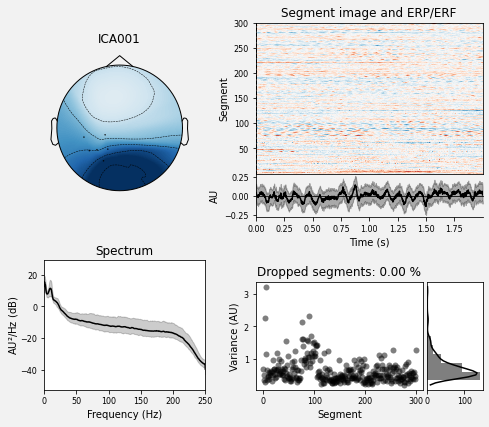

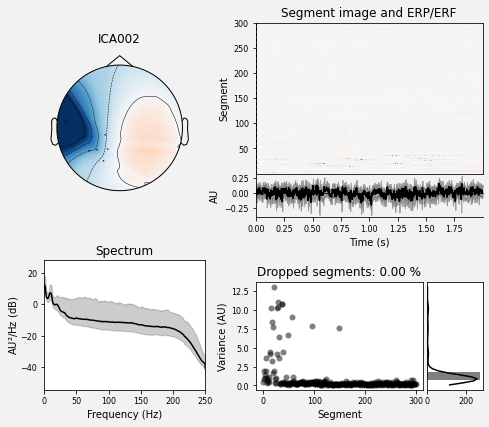

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw, picks=ica.exclude)
plt.show()

#### We can select different brain regions through the chart below:

#### For instance P3:

In [ ]:
# P3 = raw.pick_channels(['EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'])

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


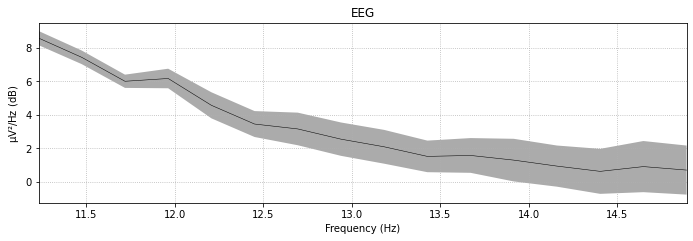

In [ ]:
# 5400 (90 minutes in seconds)

spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


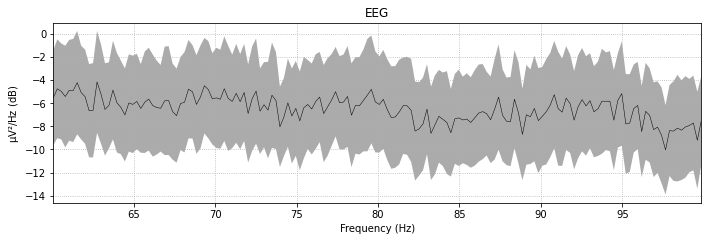

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


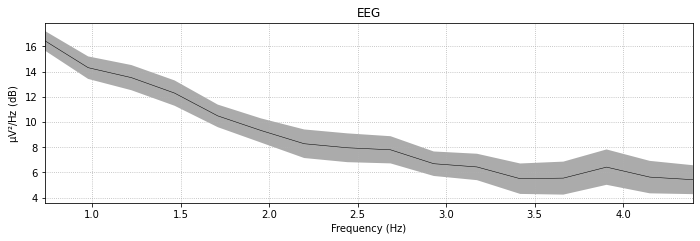

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


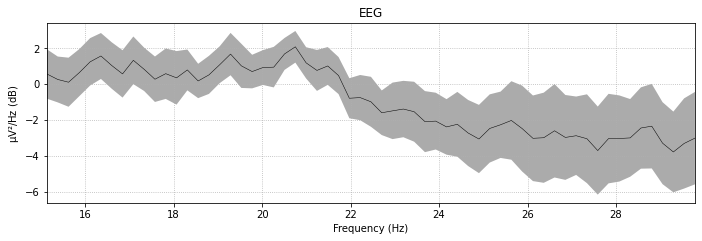

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=15, fmax=30, average = 'Median')
plt.show()

In [ ]:
# https://raphaelvallat.com/bandpower.html
# link above highlights what sensors are common for sleep analysis. which is Fz and Cz

psd, freqs = mne.time_frequency.psd_array_welch(raw.get_data(), sfreq=raw.info['sfreq'], n_fft=4096)

Effective window size : 8.192 (s)


In [ ]:
psd.shape

(6, 2049)

In [ ]:
freqs.shape

(2049,)

In [ ]:
# an_array = freqs
# repetitions = 6

# repeats_array = np.tile(an_array, (repetitions, 1))

# repeats_array.shape

In [ ]:
# an_array = [3,40] 
# repetitions = 6

# freq_range = np.tile(an_array, (repetitions, 1))
# freq_range.shape

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.8533, 0.8199                                         
                                                                                                  
                                       15 peaks were found:                                       
          

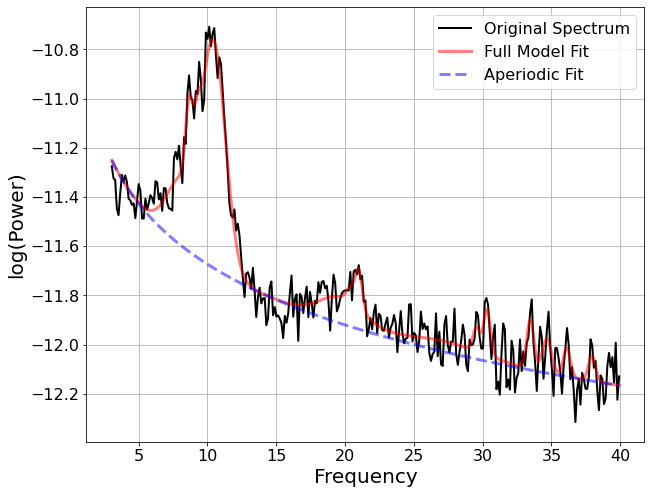

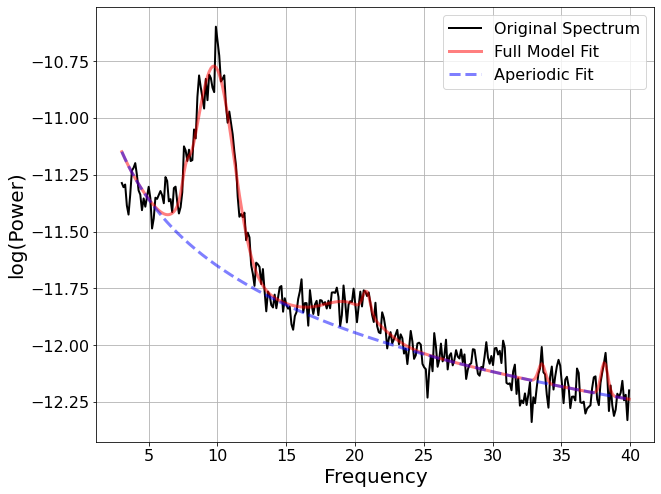

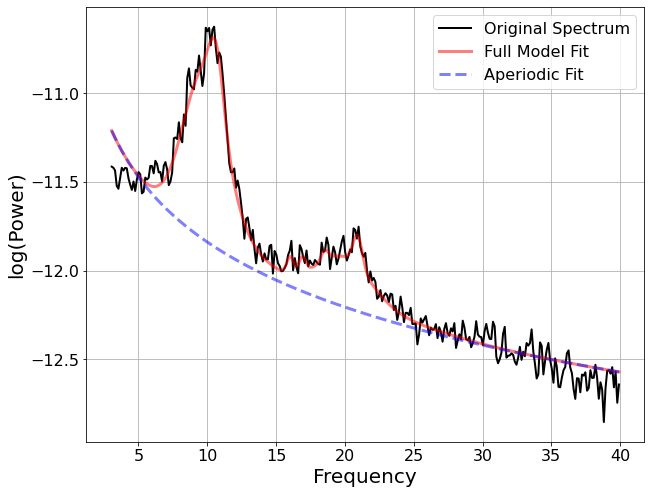

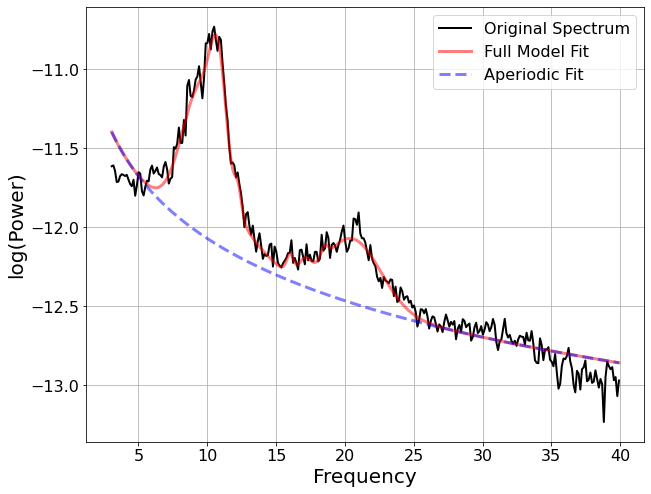

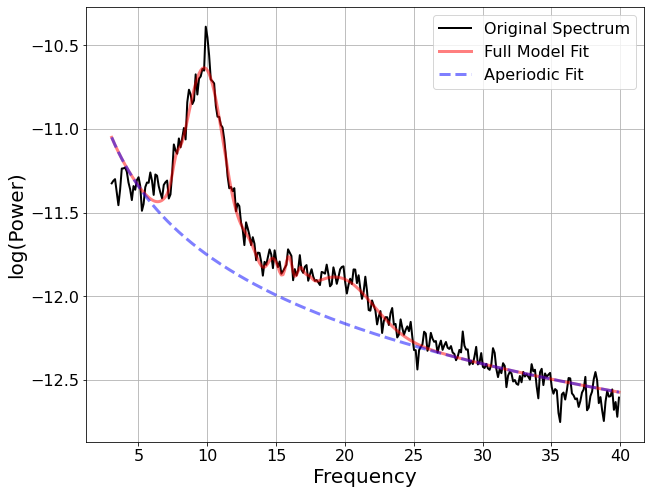

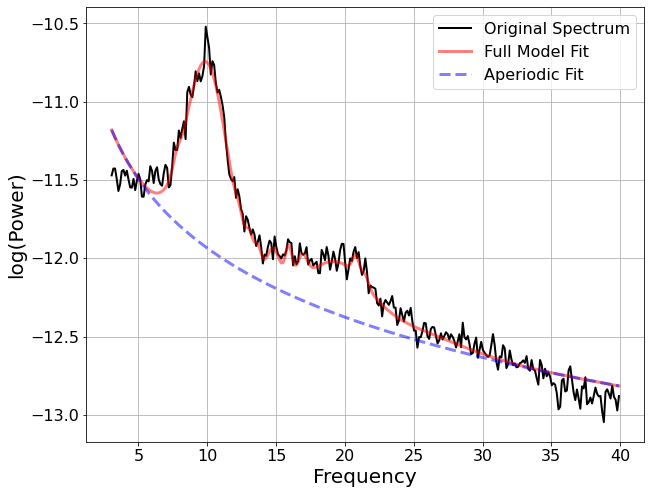

In [ ]:
EEG_47_fm = FOOOF()
EEG_51_fm = FOOOF()
EEG_52_fm = FOOOF()
EEG_53_fm = FOOOF()
EEG_59_fm = FOOOF()
EEG_60_fm = FOOOF()

# freq_range = [11,15] 
freq_range = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta


'P3-EEG_47-Music', 'P3-EEG_51-Music', 'P3-EEG_52-Music', 'P3-EEG_53-Music', 'P3-EEG_59-Music', 'P3-EEG_60-Music'
EEG_47 = EEG_47_fm.report(freqs, psd[0].flatten(), freq_range)
EEG_51 = EEG_51_fm.report(freqs, psd[1].flatten(), freq_range)
EEG_52 = EEG_52_fm.report(freqs, psd[2].flatten(), freq_range)
EEG_53 = EEG_53_fm.report(freqs, psd[3].flatten(), freq_range)
EEG_59 = EEG_59_fm.report(freqs, psd[4].flatten(), freq_range)
EEG_60 = EEG_60_fm.report(freqs, psd[5].flatten(), freq_range)

In [ ]:
Freqs_P3_Music = [EEG_47_fm.freqs,EEG_51_fm.freqs,EEG_52_fm.freqs,EEG_53_fm.freqs,EEG_59_fm.freqs,EEG_60_fm.freqs]
Power_Spectrum_P3_Music = [EEG_47_fm.power_spectrum,EEG_51_fm.power_spectrum,EEG_52_fm.power_spectrum,EEG_53_fm.power_spectrum,EEG_59_fm.power_spectrum,EEG_60_fm.power_spectrum]

In [ ]:
# Music_Spec_1 = plot_spectrum(Freqs_P3_Music[0], Power_Spectrum_P3_Music[0])
# Music_Spec_2 = plot_spectrum(Freqs_P3_Music[1], Power_Spectrum_P3_Music[1])
# Music_Spec_3 = plot_spectrum(Freqs_P3_Music[2], Power_Spectrum_P3_Music[2])
# Music_Spec_4 = plot_spectrum(Freqs_P3_Music[3], Power_Spectrum_P3_Music[3])
# Music_Spec_5 = plot_spectrum(Freqs_P3_Music[4], Power_Spectrum_P3_Music[4])
# Music_Spec_6 = plot_spectrum(Freqs_P3_Music[5], Power_Spectrum_P3_Music[5])

In [ ]:
Freq_Range_P3_Music = [EEG_47_fm.freq_range,EEG_51_fm.freq_range,EEG_52_fm.freq_range,EEG_53_fm.freq_range,EEG_59_fm.freq_range,EEG_60_fm.freq_range]
Aperiodic_Params_P3_Music = [list(EEG_47_fm.aperiodic_params_),list(EEG_51_fm.aperiodic_params_),list(EEG_52_fm.aperiodic_params_),list(EEG_53_fm.aperiodic_params_),list(EEG_59_fm.aperiodic_params_),list(EEG_60_fm.aperiodic_params_)]
Peak_Params_P3_Music = [EEG_47_fm.peak_params_.tolist(),EEG_51_fm.peak_params_.tolist(),EEG_52_fm.peak_params_.tolist(),EEG_53_fm.peak_params_.tolist(),EEG_59_fm.peak_params_.tolist(),EEG_60_fm.peak_params_.tolist()]

In [ ]:
freqs_1_1, powers_1_1 = gen_power_spectrum(Freq_Range_P3_Music[0], Aperiodic_Params_P3_Music[0], Peak_Params_P3_Music[0])
freqs_1_2, powers_1_2 = gen_power_spectrum(Freq_Range_P3_Music[1], Aperiodic_Params_P3_Music[1], Peak_Params_P3_Music[1])
freqs_1_3, powers_1_3 = gen_power_spectrum(Freq_Range_P3_Music[2], Aperiodic_Params_P3_Music[2], Peak_Params_P3_Music[2])
freqs_1_4, powers_1_4 = gen_power_spectrum(Freq_Range_P3_Music[3], Aperiodic_Params_P3_Music[3], Peak_Params_P3_Music[3])
freqs_1_5, powers_1_5 = gen_power_spectrum(Freq_Range_P3_Music[4], Aperiodic_Params_P3_Music[4], Peak_Params_P3_Music[4])
freqs_1_6, powers_1_6 = gen_power_spectrum(Freq_Range_P3_Music[5], Aperiodic_Params_P3_Music[5], Peak_Params_P3_Music[5])

# Music_p_1 = plot_spectrum(freqs_1_1, powers_1_1, log_powers=True)
# Music_p_2 = plot_spectrum(freqs_1_2, powers_1_2, log_powers=True)
# Music_p_3 = plot_spectrum(freqs_1_3, powers_1_3, log_powers=True)
# Music_p_4 = plot_spectrum(freqs_1_4, powers_1_4, log_powers=True)
# Music_p_5 = plot_spectrum(freqs_1_5, powers_1_5, log_powers=True)
# Music_p_6 = plot_spectrum(freqs_1_6, powers_1_6, log_powers=True)

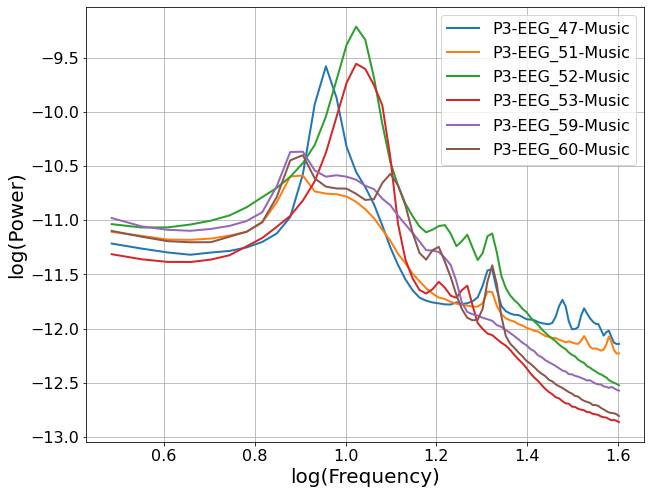

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['P3-EEG_47-Music', 'P3-EEG_51-Music', 'P3-EEG_52-Music', 'P3-EEG_53-Music', 'P3-EEG_59-Music', 'P3-EEG_60-Music']#'P3-TextAudio'

plot_spectra(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

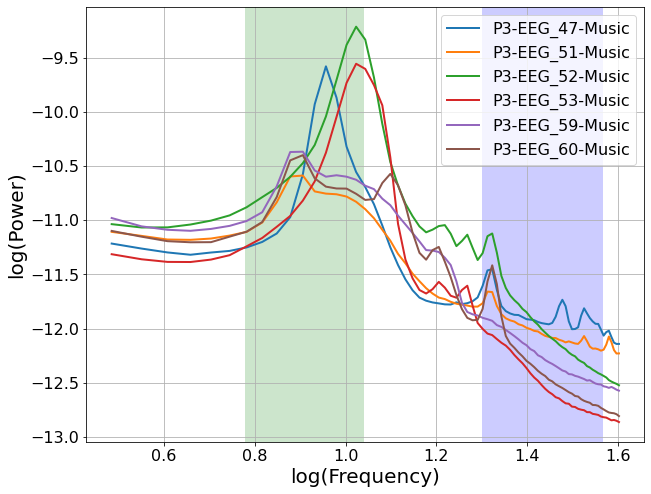

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['P3-EEG_47-Music', 'P3-EEG_51-Music', 'P3-EEG_52-Music', 'P3-EEG_53-Music', 'P3-EEG_59-Music', 'P3-EEG_60-Music']
plot_spectra_shading(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], [[6, 11], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting slow wave activity (music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.6766, 1.3193                                         
                                                                                                  
                                       2 peaks were found:                                        
          

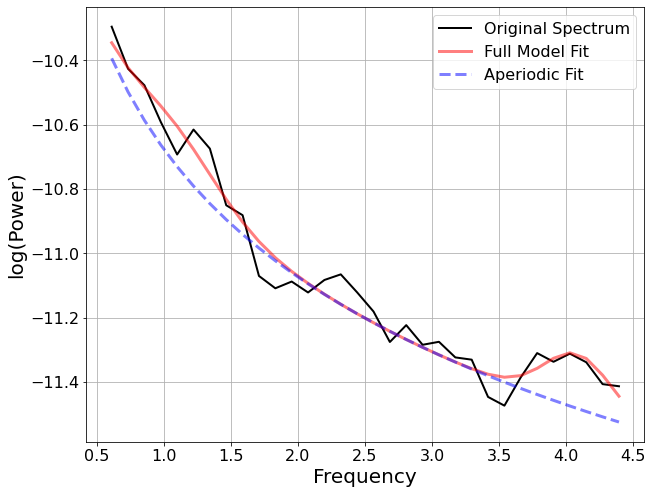

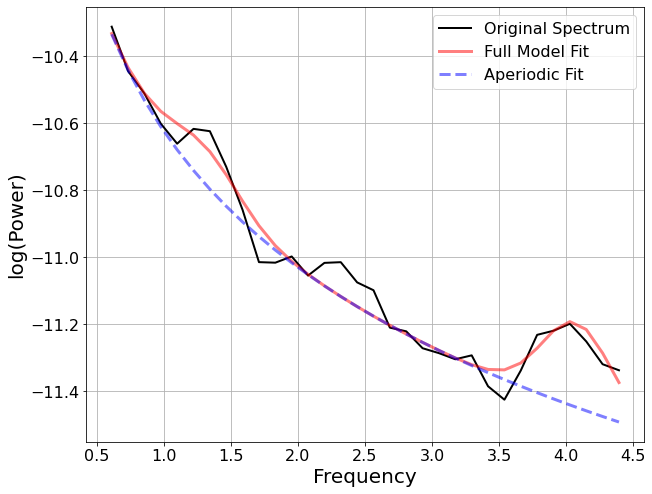

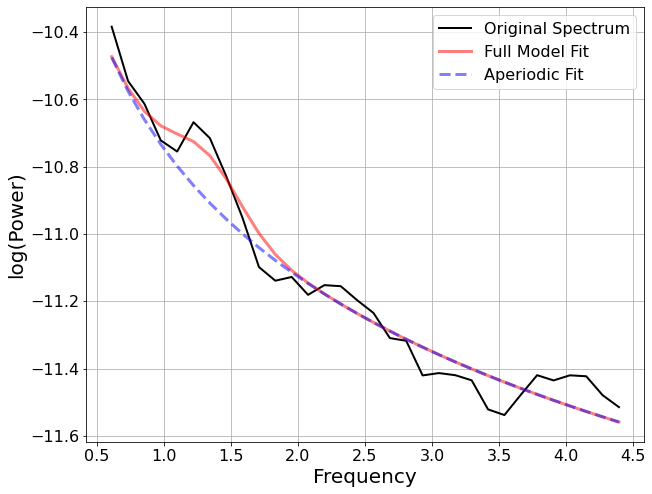

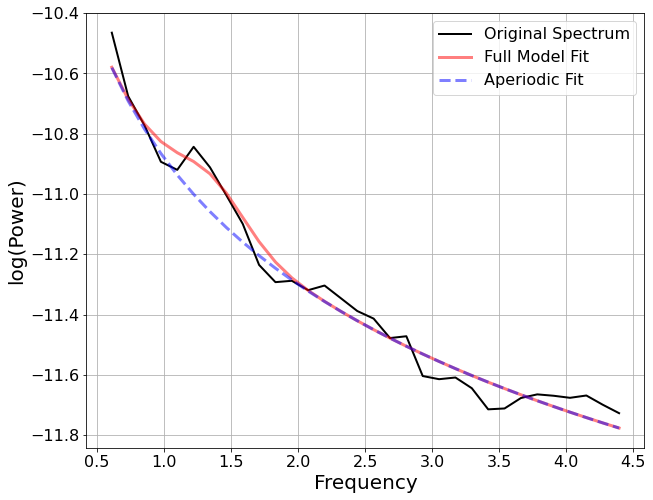

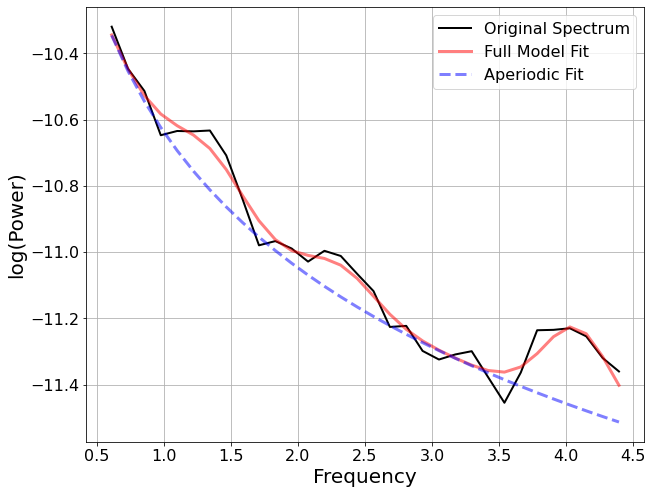

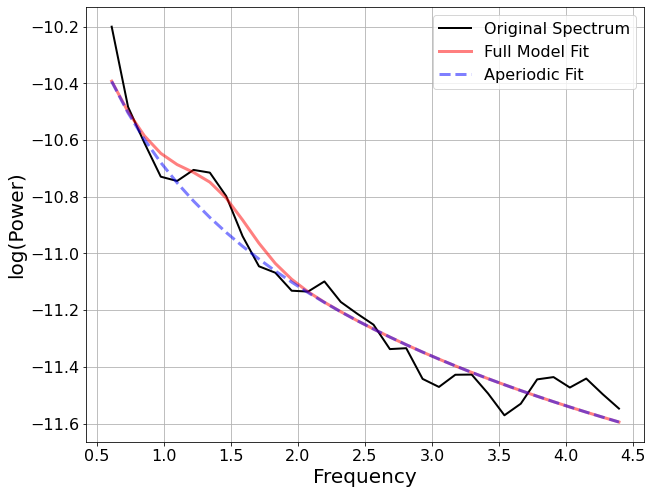

In [ ]:
#'EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'
EEG_47_fm_mus_sw = FOOOF()
EEG_51_fm_mus_sw = FOOOF()
EEG_52_fm_mus_sw = FOOOF()
EEG_53_fm_mus_sw = FOOOF()
EEG_59_fm_mus_sw = FOOOF()
EEG_60_fm_mus_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta

#'EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'
EEG_47_mus_sw = EEG_47_fm_mus_sw.report(freqs, psd[0].flatten(), freq_range)
EEG_51_mus_sw = EEG_51_fm_mus_sw.report(freqs, psd[1].flatten(), freq_range)
EEG_52_mus_sw = EEG_52_fm_mus_sw.report(freqs, psd[2].flatten(), freq_range)
EEG_53_mus_sw = EEG_53_fm_mus_sw.report(freqs, psd[3].flatten(), freq_range)
EEG_59_mus_sw = EEG_59_fm_mus_sw.report(freqs, psd[4].flatten(), freq_range)
EEG_60_mus_sw = EEG_60_fm_mus_sw.report(freqs, psd[5].flatten(), freq_range)

Extracting beta activity (music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.2785, 0.5021                                         
                                                                                                  
                                       8 peaks were found:                                        
          

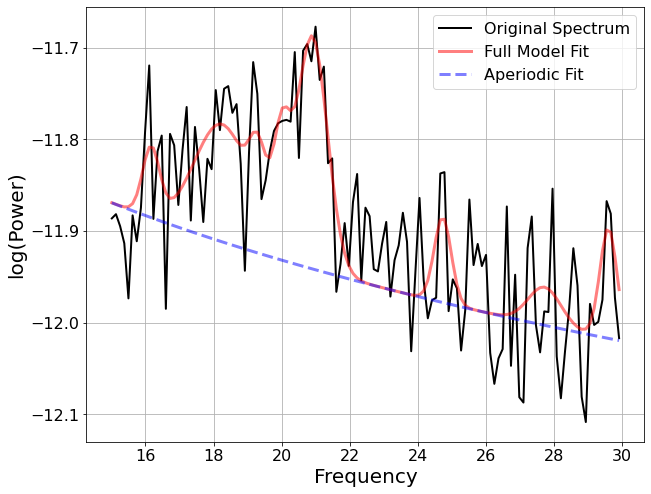

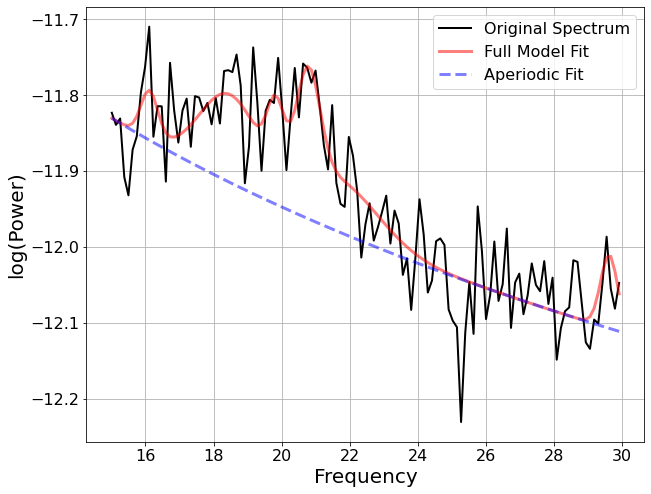

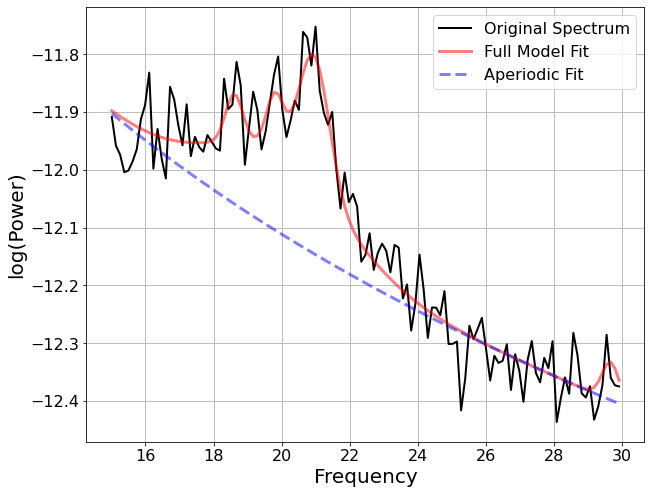

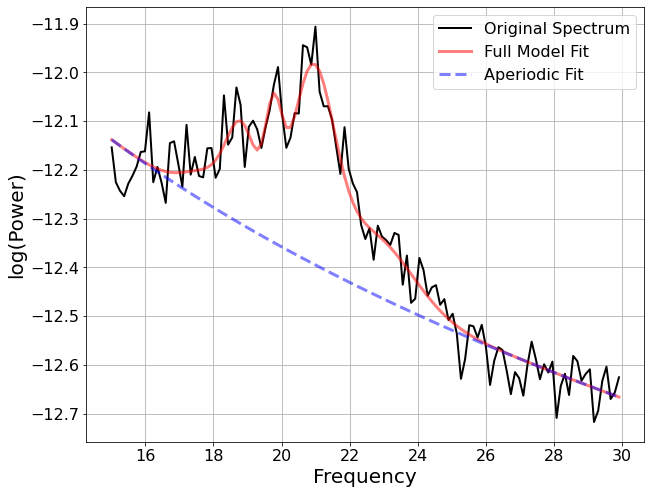

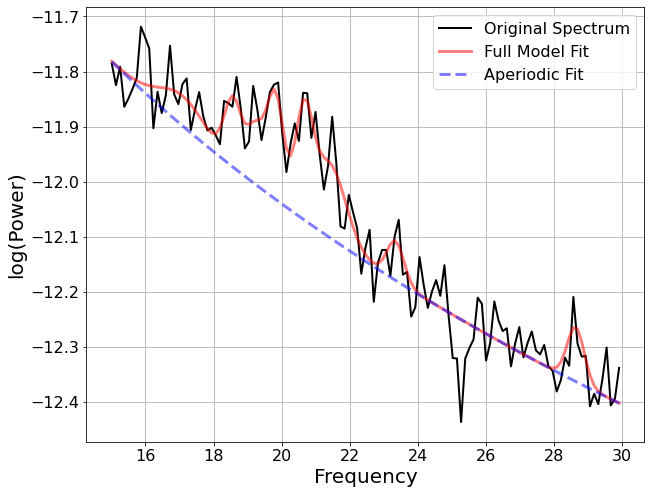

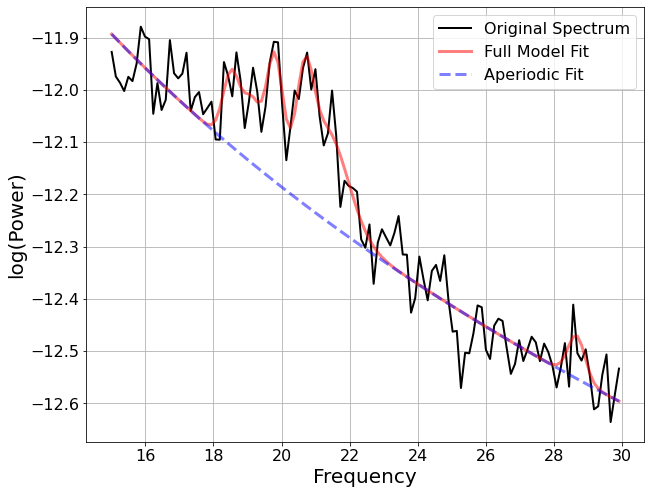

In [ ]:
#'EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'
EEG_47_fm_mus_b = FOOOF()
EEG_51_fm_mus_b = FOOOF()
EEG_52_fm_mus_b = FOOOF()
EEG_53_fm_mus_b = FOOOF()
EEG_59_fm_mus_b = FOOOF()
EEG_60_fm_mus_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


# 'EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'
EEG_47_mus_b = EEG_47_fm_mus_b.report(freqs, psd[0].flatten(), freq_range)
EEG_51_mus_b = EEG_51_fm_mus_b.report(freqs, psd[1].flatten(), freq_range)
EEG_52_mus_b = EEG_52_fm_mus_b.report(freqs, psd[2].flatten(), freq_range)
EEG_53_mus_b = EEG_53_fm_mus_b.report(freqs, psd[3].flatten(), freq_range)
EEG_59_mus_b = EEG_59_fm_mus_b.report(freqs, psd[4].flatten(), freq_range)
EEG_60_mus_b = EEG_60_fm_mus_b.report(freqs, psd[5].flatten(), freq_range)

SW/Beta Ratios

In [ ]:
#'EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'
EEG_47_mus_ratio = sum(EEG_47_fm_mus_sw.power_spectrum) / sum(EEG_47_fm_mus_b.power_spectrum)
EEG_51_mus_ratio = sum(EEG_51_fm_mus_sw.power_spectrum) / sum(EEG_51_fm_mus_b.power_spectrum)
EEG_52_mus_ratio = sum(EEG_52_fm_mus_sw.power_spectrum) / sum(EEG_52_fm_mus_b.power_spectrum)
EEG_53_mus_ratio = sum(EEG_53_fm_mus_sw.power_spectrum) / sum(EEG_53_fm_mus_b.power_spectrum)
EEG_59_mus_ratio = sum(EEG_59_fm_mus_sw.power_spectrum) / sum(EEG_59_fm_mus_b.power_spectrum)
EEG_60_mus_ratio = sum(EEG_60_fm_mus_sw.power_spectrum) / sum(EEG_60_fm_mus_b.power_spectrum)

#### SW/Beta Ratio (Text Condtion)

In [ ]:
raw2 = mne.io.read_raw_edf('msm_p03_t3.edf') 
raw2.crop(tmin = 339, tmax = 939)
raw2.pick_channels(['EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'])

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t3.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
channel_renaming_dict = {'EEG 47': 'CP5', 'EEG 51': 'P5', 'EEG 52': 'P3', 'EEG 53': 'CP1', 'EEG 59': 'PO3', 'EEG 60': 'P1'}

raw2.rename_channels(channel_renaming_dict)  # happens in-place

raw2.ch_names

['CP5', 'P5', 'P3', 'CP1', 'PO3', 'P1']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw2.set_montage(montage)

<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~16 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-36-1f682e7cb6ee>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw2)


Selecting by number: 6 components
Fitting ICA took 2.7s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


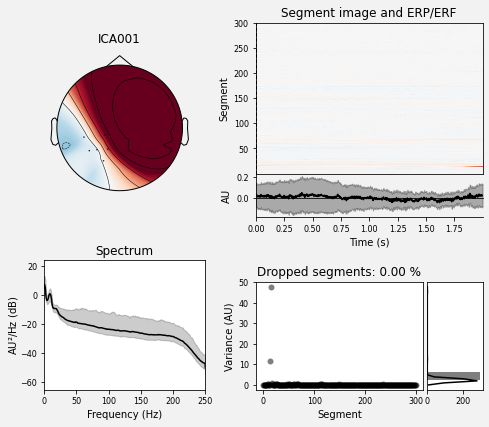

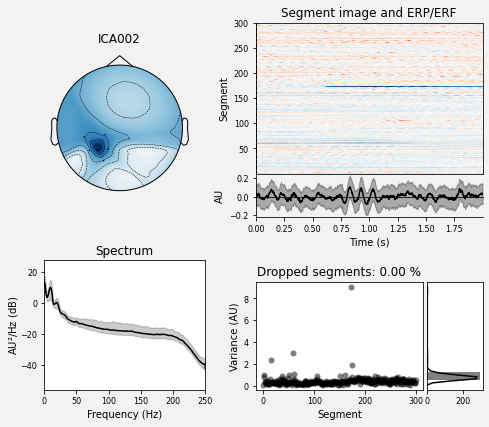

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw2)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw2, picks=ica.exclude)
plt.show()

In [ ]:
# for ann in raw2.annotations:
#     descr = ann['description']
#     start = ann['onset']
#     # end = ann['onset'] + ann['duration']
#     print(f"'{descr}' starts at {start}")

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


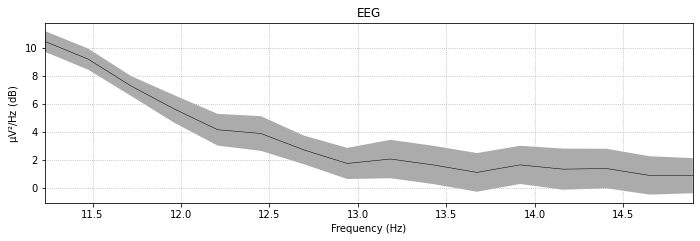

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


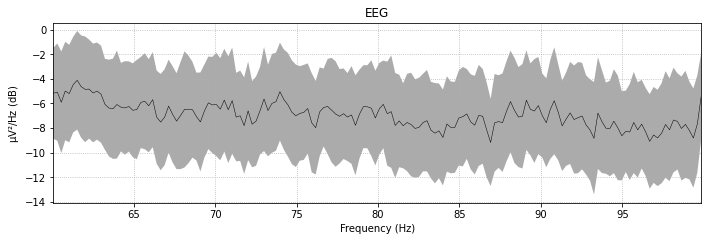

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


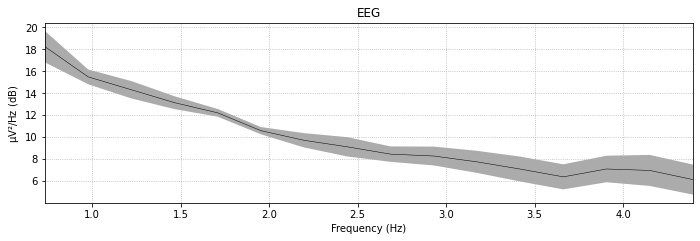

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


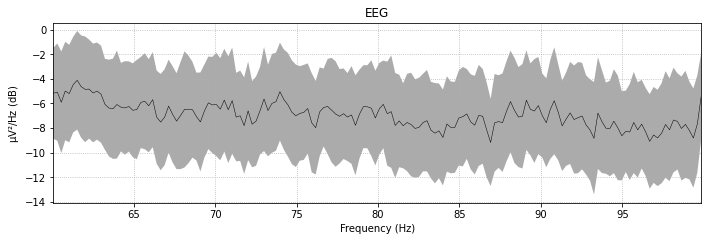

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

In [ ]:
psd2, freqs2 = mne.time_frequency.psd_array_welch(raw2.get_data(), sfreq=raw2.info['sfreq'], n_fft=4096)
psd2.shape,freqs2.shape

Effective window size : 8.192 (s)


((6, 2049), (2049,))

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.5975, 1.0313                                         
                                                                                                  
                                       10 peaks were found:                                       
          

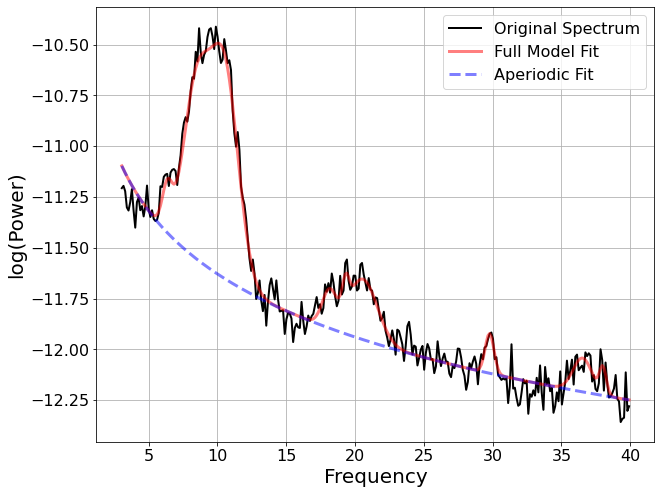

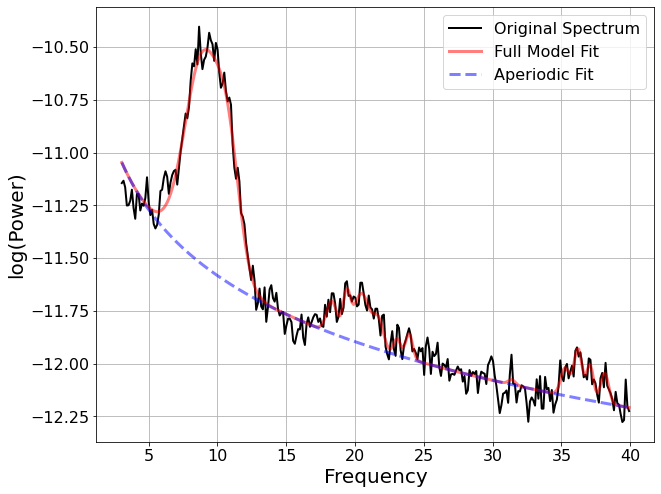

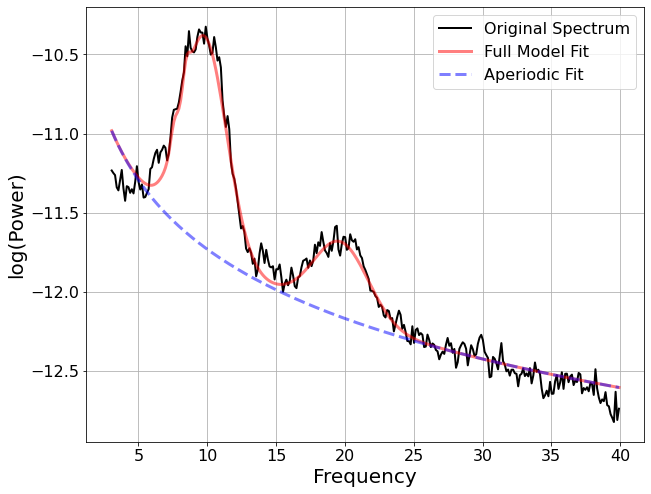

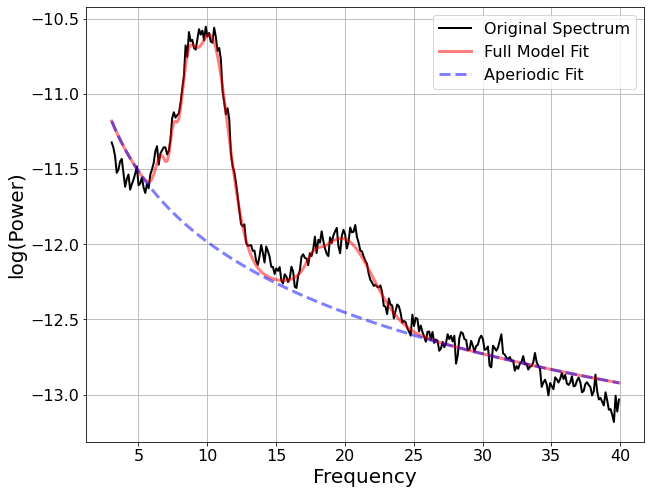

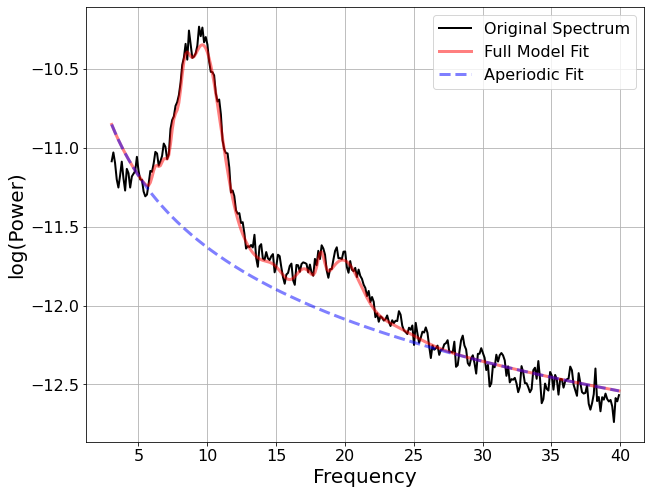

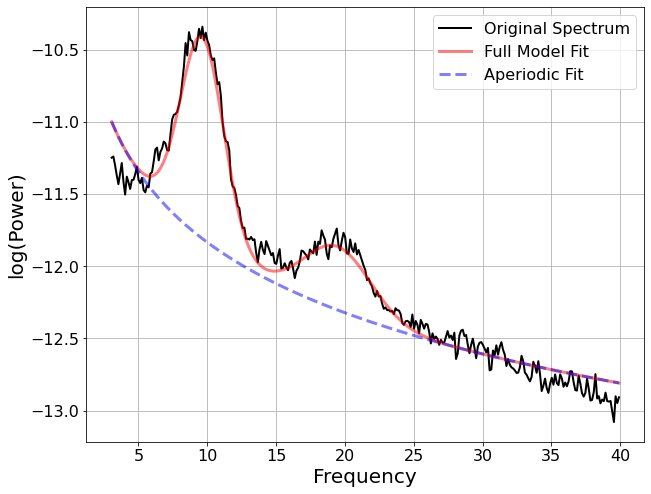

In [ ]:
EEG_47_fm2 = FOOOF()
EEG_51_fm2 = FOOOF()
EEG_52_fm2 = FOOOF()
EEG_53_fm2 = FOOOF()
EEG_59_fm2 = FOOOF()
EEG_60_fm2 = FOOOF()

# freq_range = [11,15] 
freq_range2 = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta

# 'EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'
EEG_47 = EEG_47_fm2.report(freqs2, psd2[0].flatten(), freq_range2)
EEG_51 = EEG_51_fm2.report(freqs2, psd2[1].flatten(), freq_range2)
EEG_52 = EEG_52_fm2.report(freqs2, psd2[2].flatten(), freq_range2)
EEG_53 = EEG_53_fm2.report(freqs2, psd2[3].flatten(), freq_range2)
EEG_59 = EEG_59_fm2.report(freqs2, psd2[4].flatten(), freq_range2)
EEG_60 = EEG_60_fm2.report(freqs2, psd2[5].flatten(), freq_range2)

In [ ]:
Freqs_P3_text = [EEG_47_fm2.freqs,EEG_51_fm2.freqs,EEG_52_fm2.freqs,EEG_53_fm2.freqs,EEG_59_fm2.freqs,EEG_60_fm2.freqs]
Power_Spectrum_P3_Text = [EEG_47_fm2.power_spectrum,EEG_51_fm2.power_spectrum,EEG_52_fm2.power_spectrum,EEG_53_fm2.power_spectrum,EEG_59_fm2.power_spectrum,EEG_60_fm2.power_spectrum]

In [ ]:
# Text_Spec_1 = plot_spectrum(Freqs_P3_text[0], Power_Spectrum_P3_Text[0])
# Text_Spec_2 = plot_spectrum(Freqs_P3_text[1], Power_Spectrum_P3_Text[1])
# Text_Spec_3 = plot_spectrum(Freqs_P3_text[2], Power_Spectrum_P3_Text[2])
# Text_Spec_4 = plot_spectrum(Freqs_P3_text[3], Power_Spectrum_P3_Text[3])
# Text_Spec_5 = plot_spectrum(Freqs_P3_text[4], Power_Spectrum_P3_Text[4])
# Text_Spec_6 = plot_spectrum(Freqs_P3_text[5], Power_Spectrum_P3_Text[5])

In [ ]:
# spec_2 = plot_spectrum(fm2.freqs, fm2.power_spectrum)
# plt.show()

In [ ]:
Freq_Range_P3_Text = [EEG_47_fm2.freq_range,EEG_51_fm2.freq_range,EEG_52_fm2.freq_range,EEG_53_fm2.freq_range,EEG_59_fm2.freq_range,EEG_60_fm2.freq_range]
Aperiodic_Params_P3_Text = [list(EEG_47_fm2.aperiodic_params_),list(EEG_51_fm2.aperiodic_params_),list(EEG_52_fm2.aperiodic_params_),list(EEG_53_fm2.aperiodic_params_),list(EEG_59_fm2.aperiodic_params_),list(EEG_60_fm2.aperiodic_params_)]
Peak_Params_P3_Text = [EEG_47_fm2.peak_params_.tolist(),EEG_51_fm2.peak_params_.tolist(),EEG_52_fm2.peak_params_.tolist(),EEG_53_fm2.peak_params_.tolist(),EEG_59_fm2.peak_params_.tolist(),EEG_60_fm2.peak_params_.tolist()]

In [ ]:
freqs_2_1, powers_2_1 = gen_power_spectrum(Freq_Range_P3_Text[0], Aperiodic_Params_P3_Text[0], Peak_Params_P3_Text[0])
freqs_2_2, powers_2_2 = gen_power_spectrum(Freq_Range_P3_Text[1], Aperiodic_Params_P3_Text[1], Peak_Params_P3_Text[1])
freqs_2_3, powers_2_3 = gen_power_spectrum(Freq_Range_P3_Text[2], Aperiodic_Params_P3_Text[2], Peak_Params_P3_Text[2])
freqs_2_4, powers_2_4 = gen_power_spectrum(Freq_Range_P3_Text[3], Aperiodic_Params_P3_Text[3], Peak_Params_P3_Text[3])
freqs_2_5, powers_2_5 = gen_power_spectrum(Freq_Range_P3_Text[4], Aperiodic_Params_P3_Text[4], Peak_Params_P3_Text[4])
freqs_2_6, powers_2_6 = gen_power_spectrum(Freq_Range_P3_Text[5], Aperiodic_Params_P3_Text[5], Peak_Params_P3_Text[5])

# Text_p_1 = plot_spectrum(freqs_2_1, powers_2_1, log_powers=True)
# Text_p_2 = plot_spectrum(freqs_2_2, powers_2_2, log_powers=True)
# Text_p_3 = plot_spectrum(freqs_2_3, powers_2_3, log_powers=True)
# Text_p_4 = plot_spectrum(freqs_2_4, powers_2_4, log_powers=True)
# Text_p_5 = plot_spectrum(freqs_2_5, powers_2_5, log_powers=True)
# Text_p_6 = plot_spectrum(freqs_2_6, powers_2_6, log_powers=True)

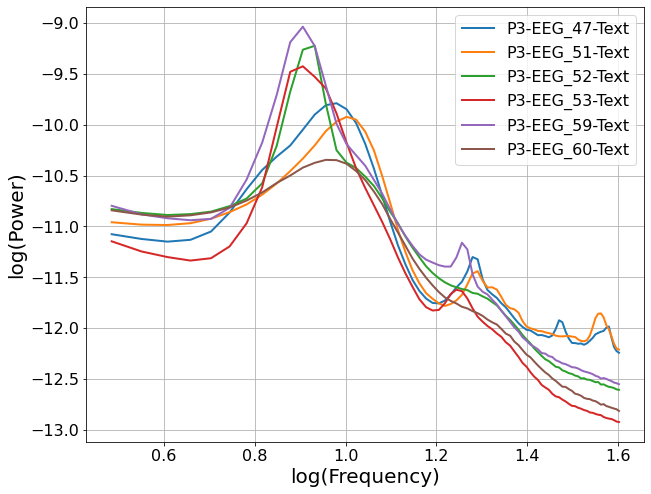

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['P3-EEG_47-Text', 'P3-EEG_51-Text', 'P3-EEG_52-Text', 'P3-EEG_53-Text', 'P3-EEG_59-Text', 'P3-EEG_60-Text']#'P3-TextAudio'

plot_spectra(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

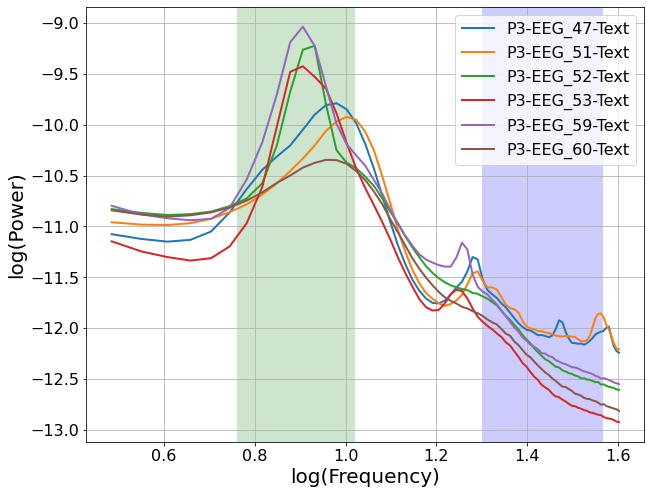

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['P3-EEG_47-Text', 'P3-EEG_51-Text', 'P3-EEG_52-Text', 'P3-EEG_53-Text', 'P3-EEG_59-Text', 'P3-EEG_60-Text']
plot_spectra_shading(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], [[5.75, 10.5], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting slow wave activity (text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.5896, 1.3178                                         
                                                                                                  
                                       2 peaks were found:                                        
          

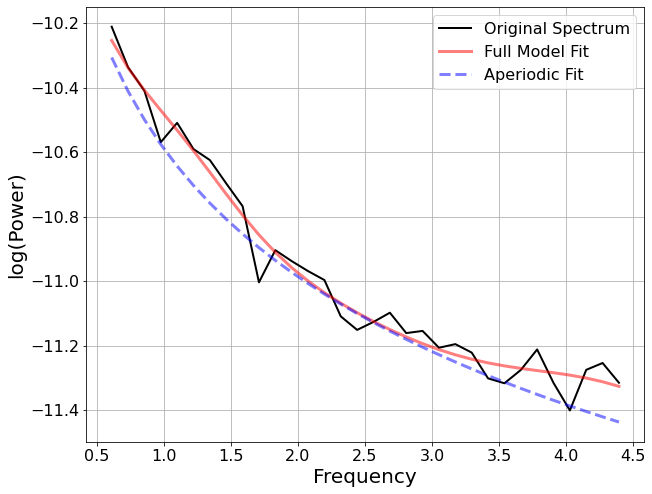

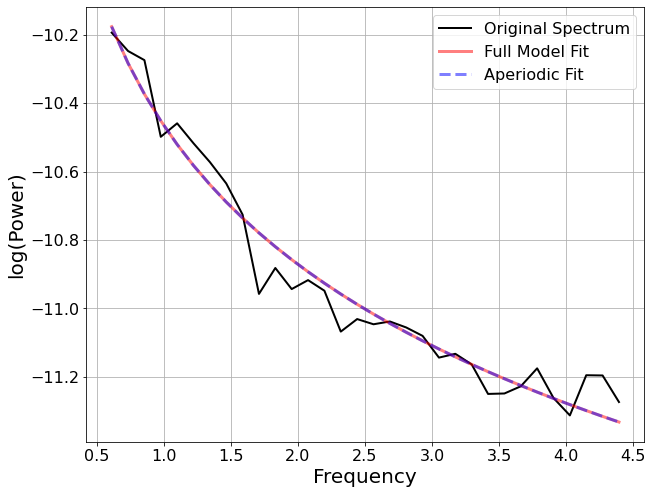

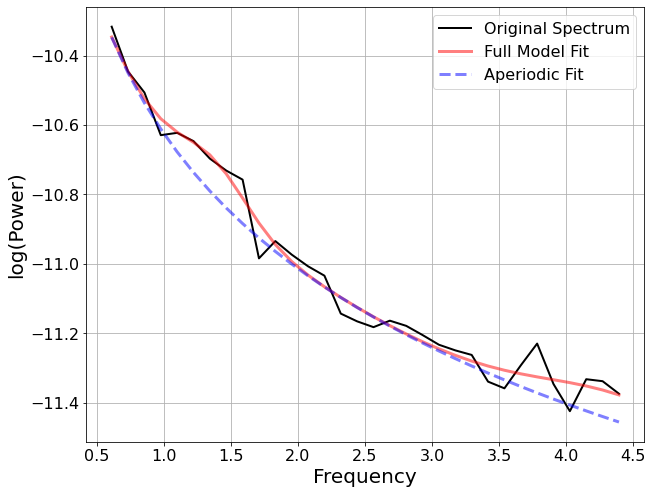

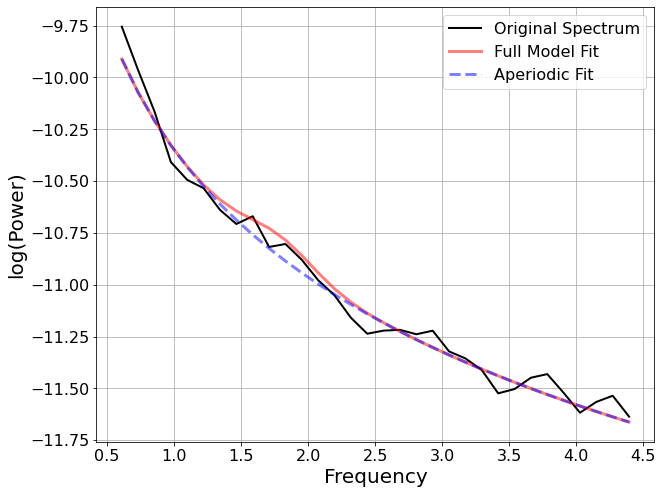

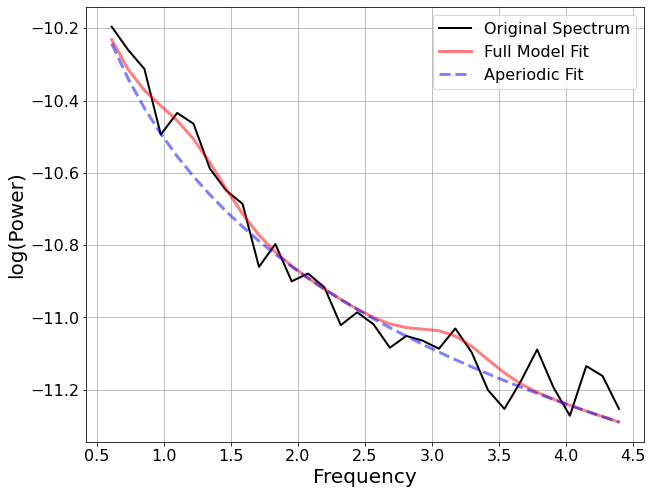

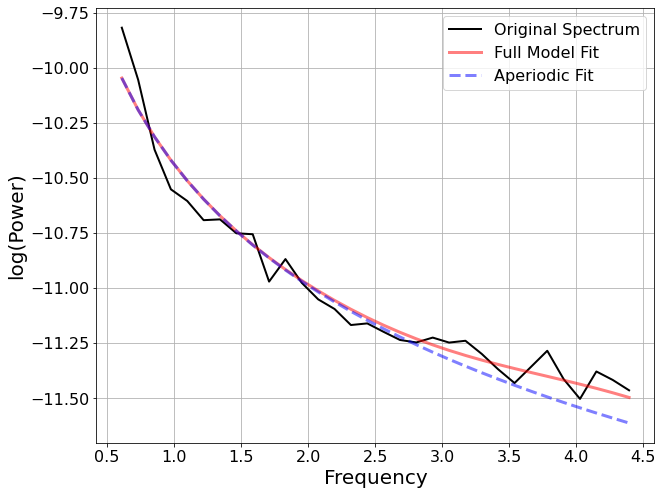

In [ ]:
# 'EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'
EEG_47_fm_text_sw = FOOOF()
EEG_51_fm_text_sw = FOOOF()
EEG_52_fm_text_sw = FOOOF()
EEG_53_fm_text_sw = FOOOF()
EEG_59_fm_text_sw = FOOOF()
EEG_60_fm_text_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'
EEG_47_text_sw = EEG_47_fm_text_sw.report(freqs, psd2[0].flatten(), freq_range)
EEG_51_text_sw = EEG_51_fm_text_sw.report(freqs, psd2[1].flatten(), freq_range)
EEG_52_text_sw = EEG_52_fm_text_sw.report(freqs, psd2[2].flatten(), freq_range)
EEG_53_text_sw = EEG_53_fm_text_sw.report(freqs, psd2[3].flatten(), freq_range)
EEG_59_text_sw = EEG_59_fm_text_sw.report(freqs, psd2[4].flatten(), freq_range)
EEG_60_text_sw = EEG_60_fm_text_sw.report(freqs, psd2[5].flatten(), freq_range)

Extracting beta activity (text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.8992, 0.8008                                         
                                                                                                  
                                       6 peaks were found:                                        
          

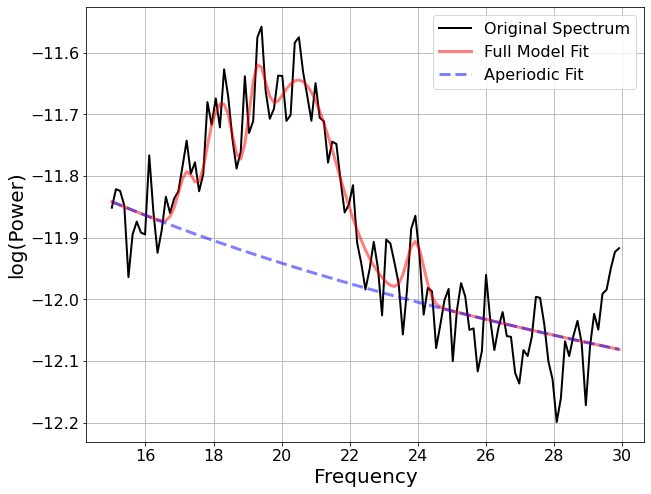

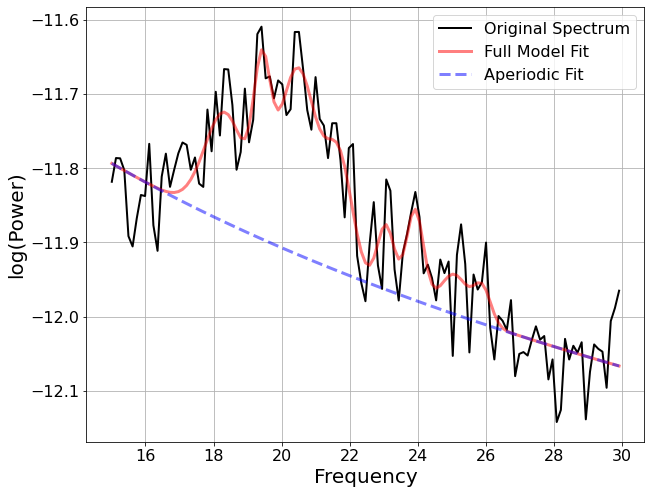

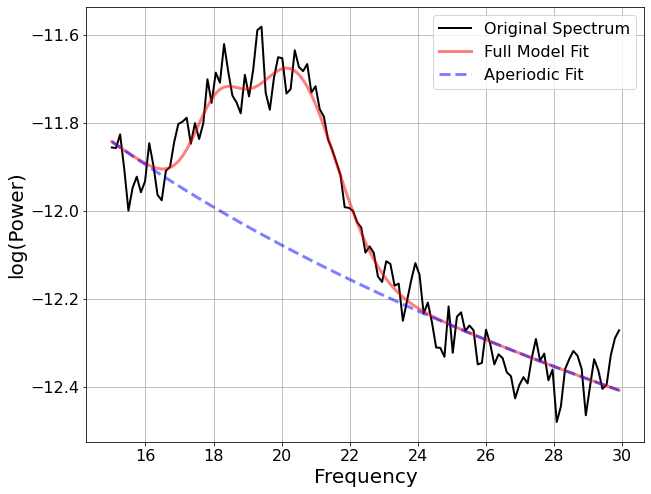

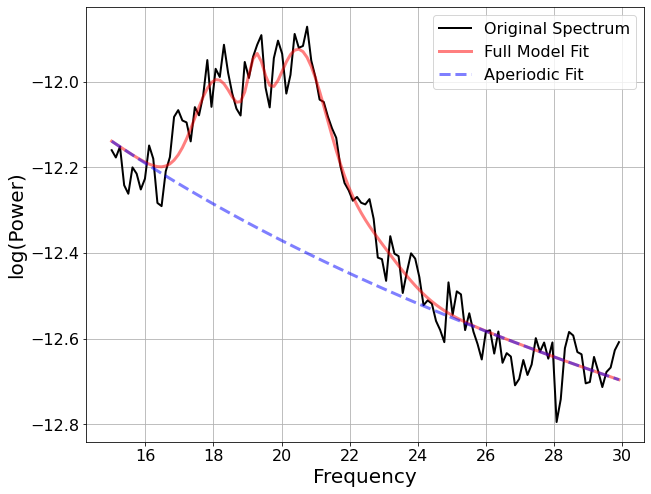

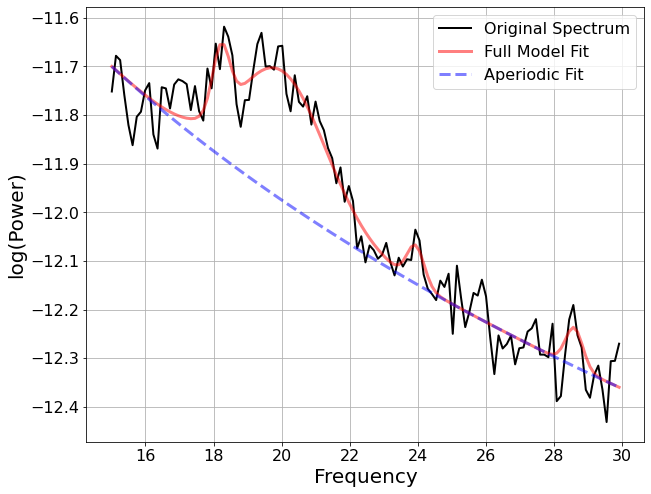

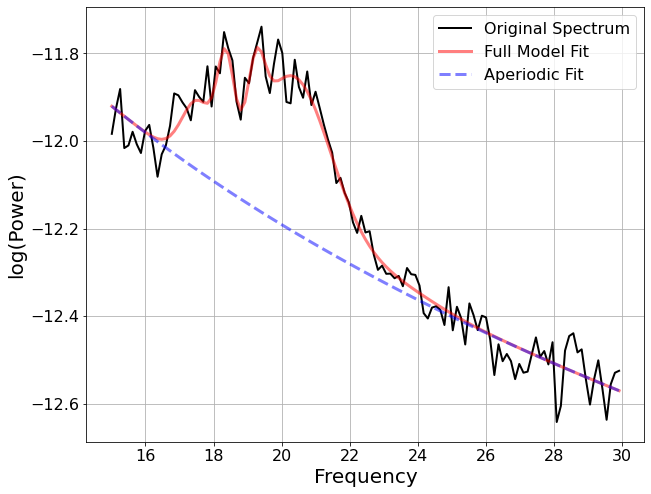

In [ ]:
# 'EEG 47', 'EEG 51', 'EEG 52', 'EEG 53', 'EEG 59', 'EEG 60'
EEG_47_fm_text_b = FOOOF()
EEG_51_fm_text_b = FOOOF()
EEG_52_fm_text_b = FOOOF()
EEG_53_fm_text_b = FOOOF()
EEG_59_fm_text_b = FOOOF()
EEG_60_fm_text_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


EEG_47_text_b = EEG_47_fm_text_b.report(freqs, psd2[0].flatten(), freq_range)
EEG_51_text_b = EEG_51_fm_text_b.report(freqs, psd2[1].flatten(), freq_range)
EEG_52_text_b = EEG_52_fm_text_b.report(freqs, psd2[2].flatten(), freq_range)
EEG_53_text_b = EEG_53_fm_text_b.report(freqs, psd2[3].flatten(), freq_range)
EEG_59_text_b = EEG_59_fm_text_b.report(freqs, psd2[4].flatten(), freq_range)
EEG_60_text_b = EEG_60_fm_text_b.report(freqs, psd2[5].flatten(), freq_range)

SW/Beta Ratios

In [ ]:
EEG_47_text_ratio = sum(EEG_47_fm_text_sw.power_spectrum) / sum(EEG_47_fm_text_b.power_spectrum)
EEG_51_text_ratio = sum(EEG_51_fm_text_sw.power_spectrum) / sum(EEG_51_fm_text_b.power_spectrum)
EEG_52_text_ratio = sum(EEG_52_fm_text_sw.power_spectrum) / sum(EEG_52_fm_text_b.power_spectrum)
EEG_53_text_ratio = sum(EEG_53_fm_text_sw.power_spectrum) / sum(EEG_53_fm_text_b.power_spectrum)
EEG_59_text_ratio = sum(EEG_59_fm_text_sw.power_spectrum) / sum(EEG_59_fm_text_b.power_spectrum)
EEG_60_text_ratio = sum(EEG_60_fm_text_sw.power_spectrum) / sum(EEG_60_fm_text_b.power_spectrum)

Comparison

In [ ]:
mus_ratios = [EEG_47_mus_ratio, EEG_51_mus_ratio, EEG_52_mus_ratio, EEG_53_mus_ratio, EEG_59_mus_ratio, EEG_60_mus_ratio]
text_ratios = [EEG_47_text_ratio, EEG_51_text_ratio, EEG_52_text_ratio, EEG_53_text_ratio, EEG_59_text_ratio, EEG_60_text_ratio]
difference = np.array(mus_ratios) - np.array(text_ratios)

In [ ]:
results = pd.DataFrame([mus_ratios, text_ratios, difference], index = ['Music', 'Text', 'Difference'], columns = [47, 51, 52, 53, 59, 60])
results = results.style.set_table_attributes("style='display:inline'").set_caption('P3 Slow Wave/Beta Activity')
results

,47,51,52,53,59,60
Music,0.242318,0.240360,0.239650,0.239016,0.237640,0.237170
Text,0.240357,0.239387,0.238242,0.232860,0.236222,0.235442
Difference,0.001961,0.000973,0.001408,0.006156,0.001418,0.001728


### Comparing all P4 readings between music and text audio for subject 3

In [ ]:
from IPython import display
display.Image("eeg_placement.png")

In [ ]:
raw = mne.io.read_raw_edf('msm_p03_t2.edf',preload=False) # subject 3, control text run. index 2 in the dataframe in sleep_music_data_notes.ipynb
raw.crop(tmin = 345, tmax = 945) 
raw.pick_channels(['EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'])
# raw.filter(l_freq=.5,h_freq=30)
# DURATION ON TABLE IS 10 MINUTES FOR N1_MIN_TEXT (90,690). 
# or start time for N1 to N2 when interpreting min as stage start time (600,960) 6 minutes
# tmin = 224, tmax = 824, eyes closed to ten minutes after
# tmin = 345, tmax = 945, eyes closed_2 to ten minutes after

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t2.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
# IGNORE THIS
# ch_types = ['eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eog','eog']
# ch_names = ['FP1','FP2','F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'FZ', 'CZ', 'PZ', 'OZ', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'FT9', 'FT10', 'TP9', 'TP10', 'F1', 'F2', 'C1', 'C2', 'P1', 'P2', 'AF3', 'AF4', 'FC3', 'FC4', 'CP3', 'CP4', 'PO3', 'PO4', 'F5', 'F6', 'C5', 'C6', 'P5', 'P6', 'AF7', 'AF8', 'FT7', 'FT8', 'TP7', 'TP8', 'PO7', 'PO8', 'FPZ', 'FCZ', 'CPZ', 'POZ', 'VEOG', 'HEOG']

In [ ]:
# eegbci.standardize(raw)

# channel_renaming_dict = {name: name.replace(' 0', '') for name in raw.ch_names}
channel_renaming_dict = {'EEG 85':'PO4', 'EEG 86':'P2', 'EEG 91':'P6', 'EEG 92':'P4', 'EEG 97':'CP6', 'EEG 98':'CP4'}

raw.rename_channels(channel_renaming_dict)  # happens in-place

raw.ch_names

['PO4', 'P2', 'P6', 'P4', 'CP6', 'CP4']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw.set_montage(montage)

<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~16 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-11-15bd986f335b>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw)


Selecting by number: 6 components
Fitting ICA took 5.2s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


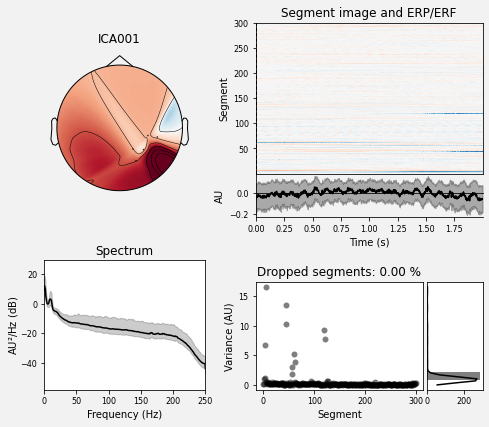

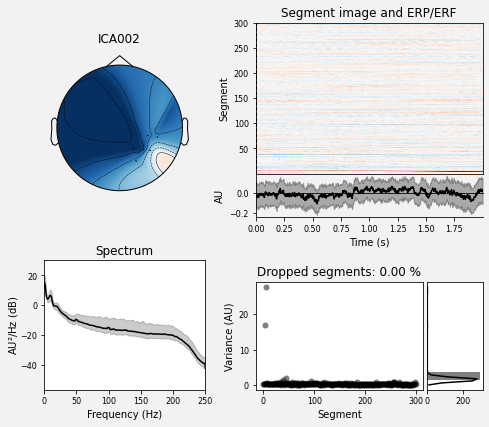

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw, picks=ica.exclude)
plt.show()

#### We can select different brain regions through the chart below:

#### For instance P4:

In [ ]:
# F3 = raw.pick_channels(['EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'])

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


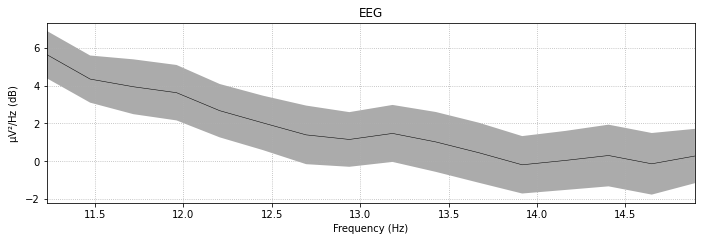

In [ ]:
# 5400 (90 minutes in seconds)

spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


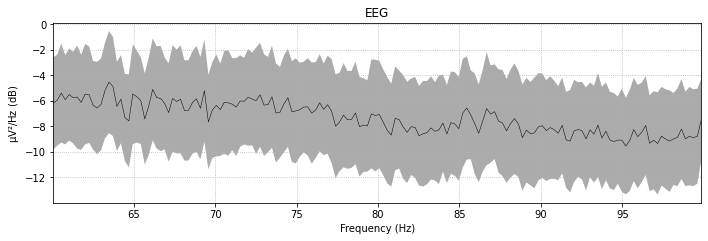

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


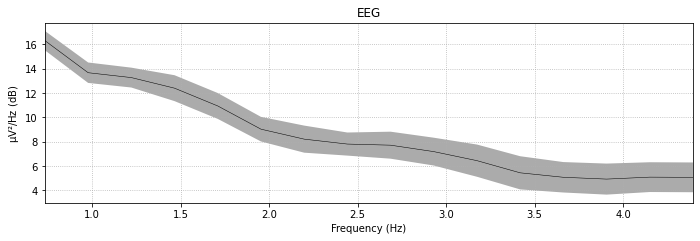

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


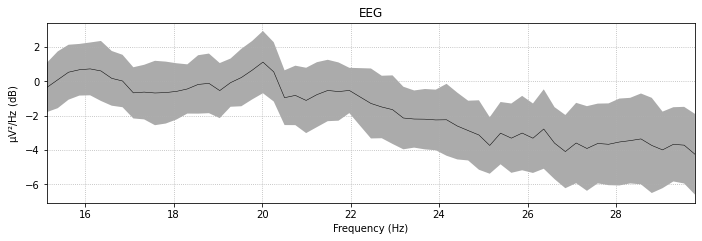

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=15, fmax=30, average = 'Median')
plt.show()

In [ ]:
# https://raphaelvallat.com/bandpower.html
# link above highlights what sensors are common for sleep analysis. which is Fz and Cz

psd, freqs = mne.time_frequency.psd_array_welch(raw.get_data(), sfreq=raw.info['sfreq'], n_fft=4096)

Effective window size : 8.192 (s)


In [ ]:
psd.shape

(6, 2049)

In [ ]:
freqs.shape

(2049,)

In [ ]:
# an_array = freqs
# repetitions = 6

# repeats_array = np.tile(an_array, (repetitions, 1))

# repeats_array.shape

In [ ]:
# an_array = [3,40] 
# repetitions = 6

# freq_range = np.tile(an_array, (repetitions, 1))
# freq_range.shape

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.5805, 1.4152                                         
                                                                                                  
                                       20 peaks were found:                                       
          

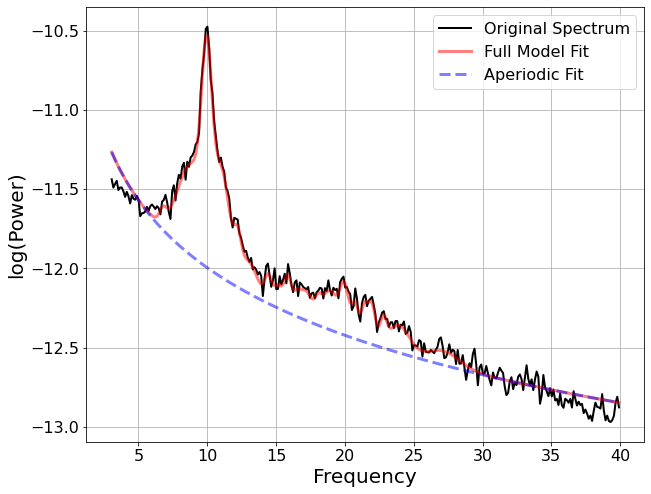

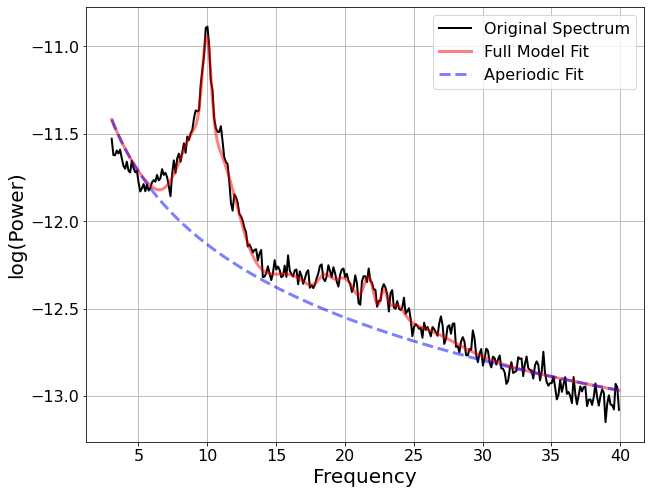

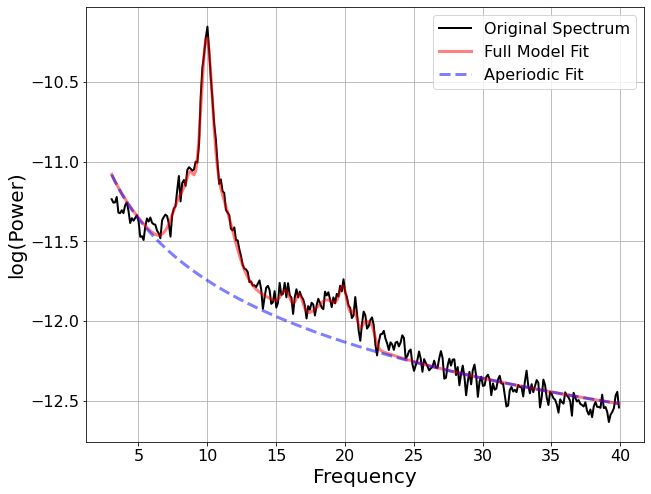

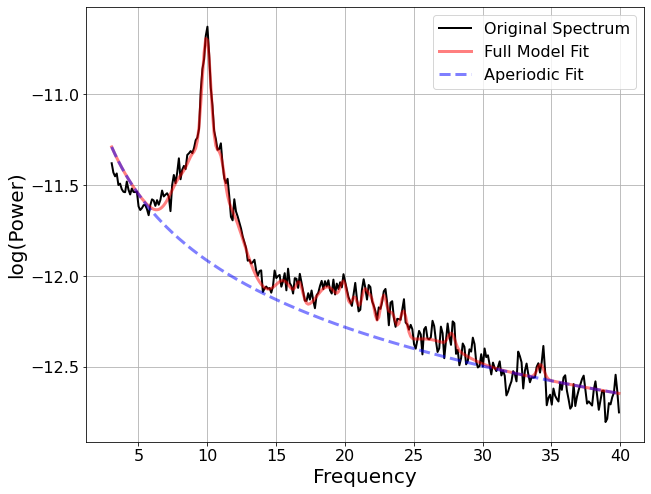

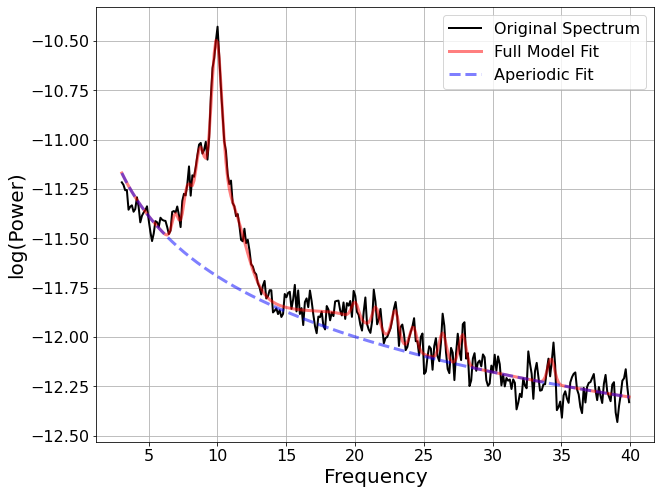

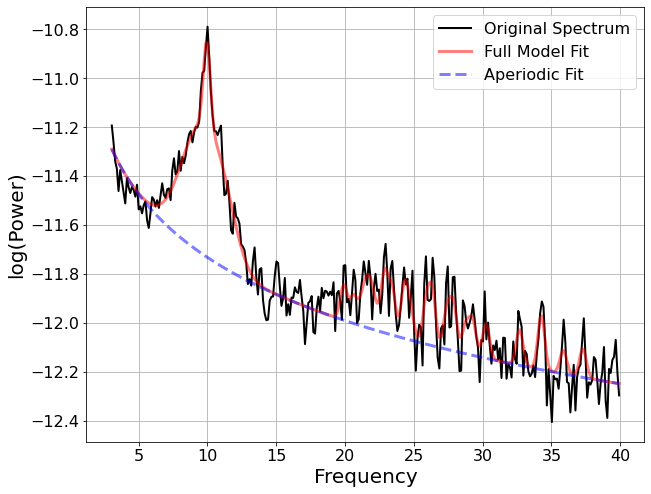

In [ ]:
EEG_85_fm = FOOOF()
EEG_86_fm = FOOOF()
EEG_91_fm = FOOOF()
EEG_92_fm = FOOOF()
EEG_97_fm = FOOOF()
EEG_98_fm = FOOOF()

# freq_range = [11,15] 
freq_range = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'
EEG_85 = EEG_85_fm.report(freqs, psd[0].flatten(), freq_range)
EEG_86 = EEG_86_fm.report(freqs, psd[1].flatten(), freq_range)
EEG_91 = EEG_91_fm.report(freqs, psd[2].flatten(), freq_range)
EEG_92 = EEG_92_fm.report(freqs, psd[3].flatten(), freq_range)
EEG_97 = EEG_97_fm.report(freqs, psd[4].flatten(), freq_range)
EEG_98 = EEG_98_fm.report(freqs, psd[5].flatten(), freq_range)

In [ ]:
#'EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'
Freqs_P4_Music = [EEG_85_fm.freqs,EEG_86_fm.freqs,EEG_91_fm.freqs,EEG_92_fm.freqs,EEG_97_fm.freqs,EEG_98_fm.freqs]
Power_Spectrum_P4_Music = [EEG_85_fm.power_spectrum,EEG_86_fm.power_spectrum,EEG_91_fm.power_spectrum,EEG_92_fm.power_spectrum,EEG_97_fm.power_spectrum,EEG_98_fm.power_spectrum]

In [ ]:
# Music_Spec_1 = plot_spectrum(Freqs_P4_Music[0], Power_Spectrum_P4_Music[0])
# Music_Spec_2 = plot_spectrum(Freqs_P4_Music[1], Power_Spectrum_P4_Music[1])
# Music_Spec_3 = plot_spectrum(Freqs_P4_Music[2], Power_Spectrum_P4_Music[2])
# Music_Spec_4 = plot_spectrum(Freqs_P4_Music[3], Power_Spectrum_P4_Music[3])
# Music_Spec_5 = plot_spectrum(Freqs_P4_Music[4], Power_Spectrum_P4_Music[4])
# Music_Spec_6 = plot_spectrum(Freqs_P4_Music[5], Power_Spectrum_P4_Music[5])

In [ ]:
Freq_Range_P4_Music = [EEG_85_fm.freq_range,EEG_86_fm.freq_range,EEG_91_fm.freq_range,EEG_92_fm.freq_range,EEG_97_fm.freq_range,EEG_98_fm.freq_range]
Aperiodic_Params_P4_Music = [list(EEG_85_fm.aperiodic_params_),list(EEG_86_fm.aperiodic_params_),list(EEG_91_fm.aperiodic_params_),list(EEG_92_fm.aperiodic_params_),list(EEG_97_fm.aperiodic_params_),list(EEG_98_fm.aperiodic_params_)]
Peak_Params_P4_Music = [EEG_85_fm.peak_params_.tolist(),EEG_86_fm.peak_params_.tolist(),EEG_91_fm.peak_params_.tolist(),EEG_92_fm.peak_params_.tolist(),EEG_97_fm.peak_params_.tolist(),EEG_98_fm.peak_params_.tolist()]

In [ ]:
freqs_1_1, powers_1_1 = gen_power_spectrum(Freq_Range_P4_Music[0], Aperiodic_Params_P4_Music[0], Peak_Params_P4_Music[0])
freqs_1_2, powers_1_2 = gen_power_spectrum(Freq_Range_P4_Music[1], Aperiodic_Params_P4_Music[1], Peak_Params_P4_Music[1])
freqs_1_3, powers_1_3 = gen_power_spectrum(Freq_Range_P4_Music[2], Aperiodic_Params_P4_Music[2], Peak_Params_P4_Music[2])
freqs_1_4, powers_1_4 = gen_power_spectrum(Freq_Range_P4_Music[3], Aperiodic_Params_P4_Music[3], Peak_Params_P4_Music[3])
freqs_1_5, powers_1_5 = gen_power_spectrum(Freq_Range_P4_Music[4], Aperiodic_Params_P4_Music[4], Peak_Params_P4_Music[4])
freqs_1_6, powers_1_6 = gen_power_spectrum(Freq_Range_P4_Music[5], Aperiodic_Params_P4_Music[5], Peak_Params_P4_Music[5])

# Music_p_1 = plot_spectrum(freqs_1_1, powers_1_1, log_powers=True)
# Music_p_2 = plot_spectrum(freqs_1_2, powers_1_2, log_powers=True)
# Music_p_3 = plot_spectrum(freqs_1_3, powers_1_3, log_powers=True)
# Music_p_4 = plot_spectrum(freqs_1_4, powers_1_4, log_powers=True)
# Music_p_5 = plot_spectrum(freqs_1_5, powers_1_5, log_powers=True)
# Music_p_6 = plot_spectrum(freqs_1_6, powers_1_6, log_powers=True)

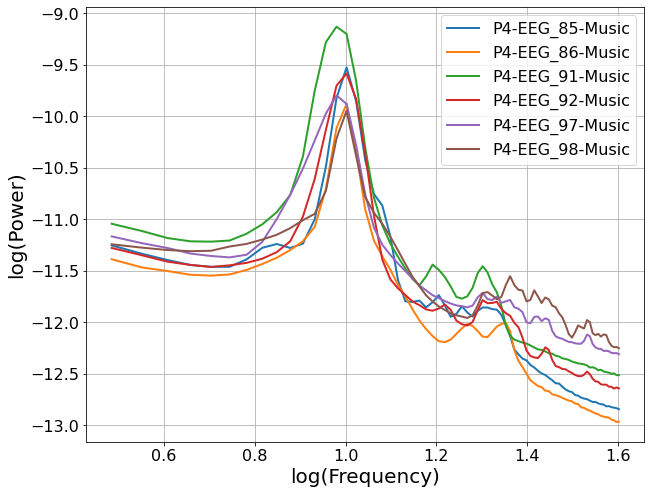

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['P4-EEG_85-Music', 'P4-EEG_86-Music', 'P4-EEG_91-Music', 'P4-EEG_92-Music', 'P4-EEG_97-Music', 'P4-EEG_98-Music']#'P4-TextAudio'

plot_spectra(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

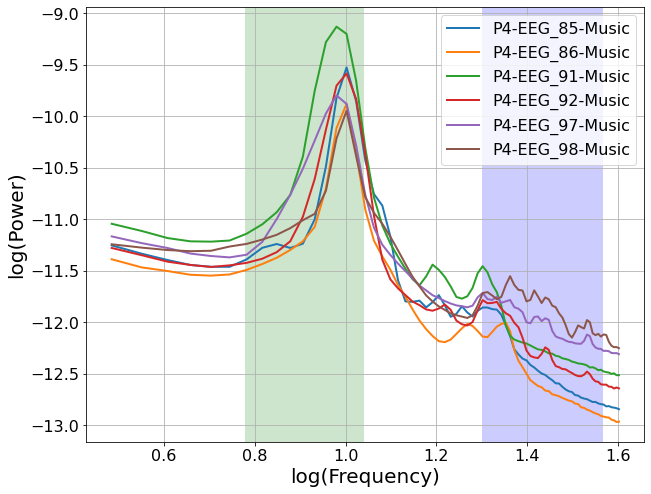

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['P4-EEG_85-Music', 'P4-EEG_86-Music', 'P4-EEG_91-Music', 'P4-EEG_92-Music', 'P4-EEG_97-Music', 'P4-EEG_98-Music']
plot_spectra_shading(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], [[6, 11], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting slow wave activity (music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.7546, 1.3073                                         
                                                                                                  
                                       1 peaks were found:                                        
          

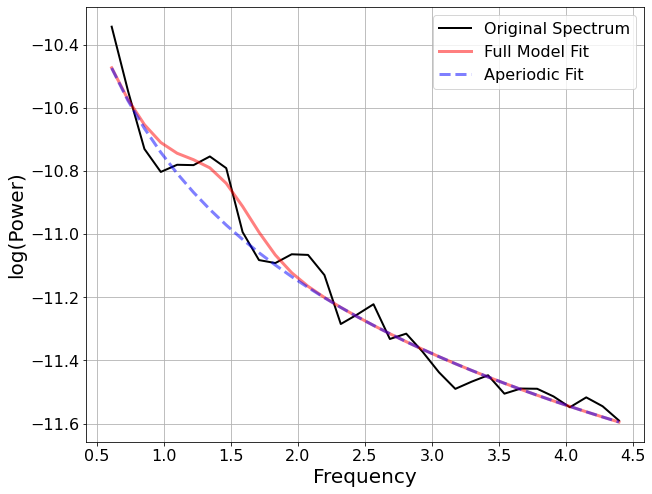

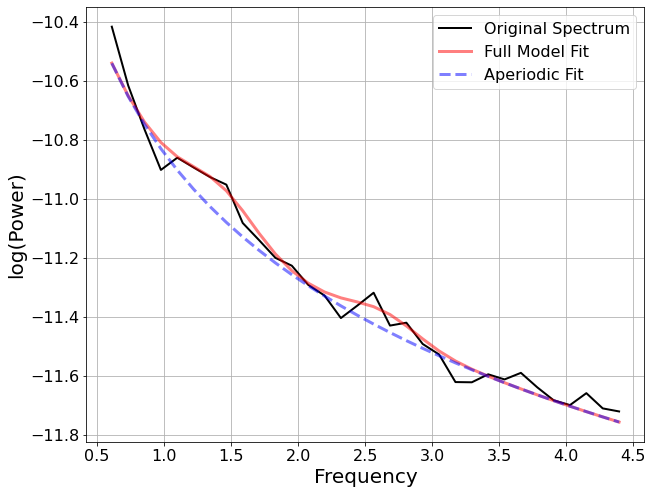

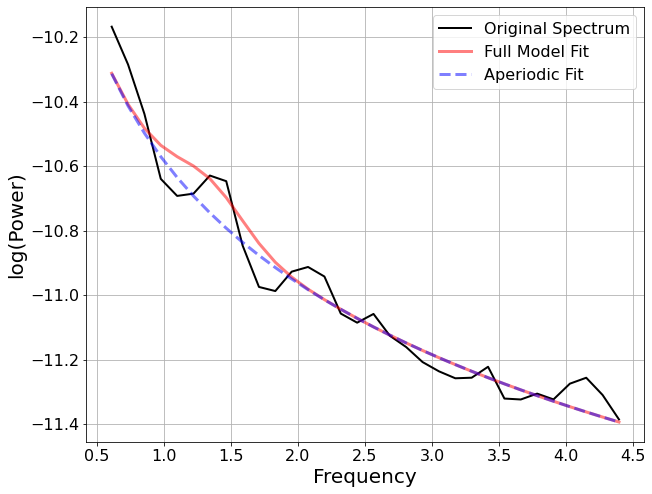

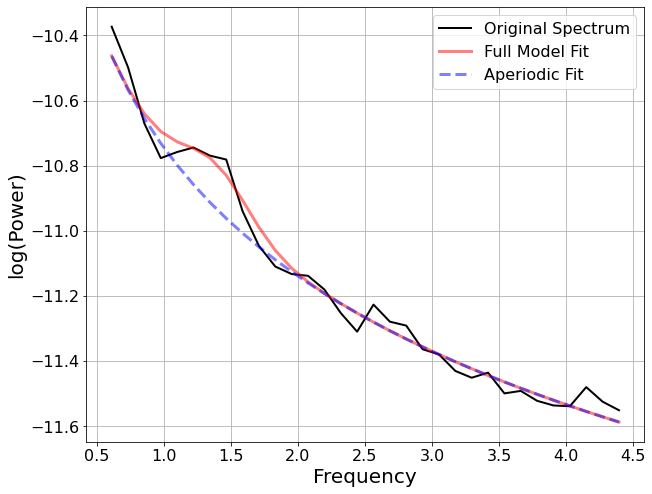

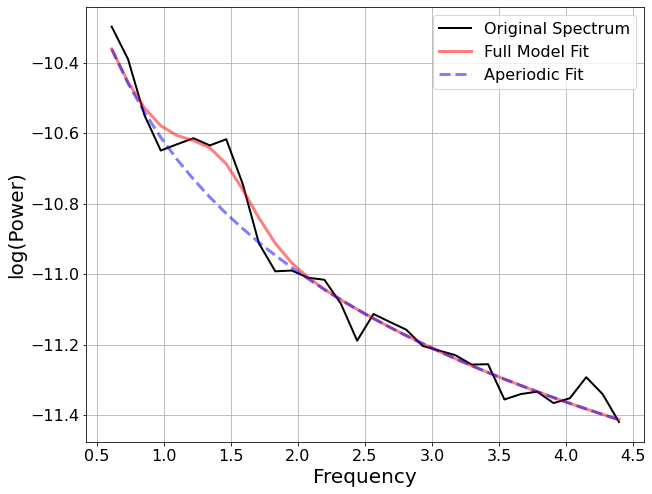

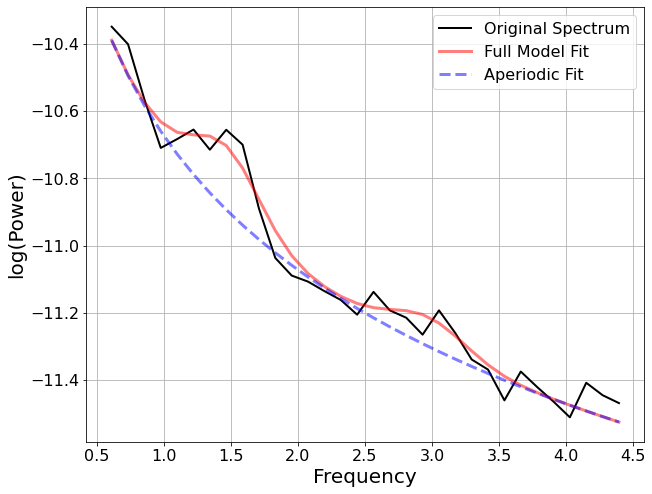

In [ ]:
#'EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'
EEG_85_fm_mus_sw = FOOOF()
EEG_86_fm_mus_sw = FOOOF()
EEG_91_fm_mus_sw = FOOOF()
EEG_92_fm_mus_sw = FOOOF()
EEG_97_fm_mus_sw = FOOOF()
EEG_98_fm_mus_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta

#'EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'
EEG_85_mus_sw = EEG_85_fm_mus_sw.report(freqs, psd[0].flatten(), freq_range)
EEG_86_mus_sw = EEG_86_fm_mus_sw.report(freqs, psd[1].flatten(), freq_range)
EEG_91_mus_sw = EEG_91_fm_mus_sw.report(freqs, psd[2].flatten(), freq_range)
EEG_92_mus_sw = EEG_92_fm_mus_sw.report(freqs, psd[3].flatten(), freq_range)
EEG_97_mus_sw = EEG_97_fm_mus_sw.report(freqs, psd[4].flatten(), freq_range)
EEG_98_mus_sw = EEG_98_fm_mus_sw.report(freqs, psd[5].flatten(), freq_range)

Extracting beta activity (music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -9.6966, 1.9893                                          
                                                                                                  
                                       10 peaks were found:                                       
          

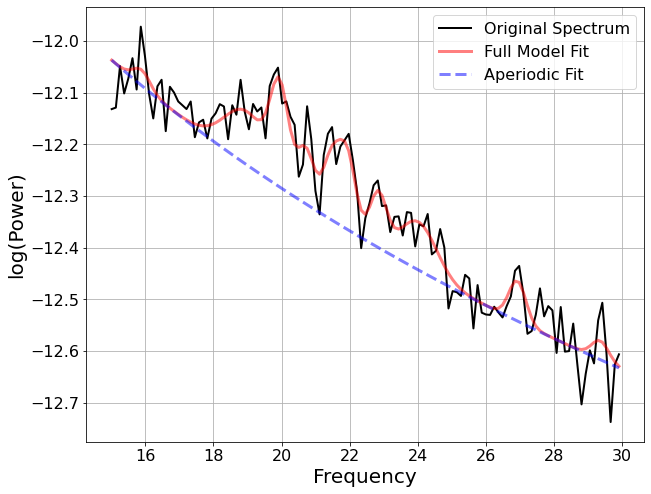

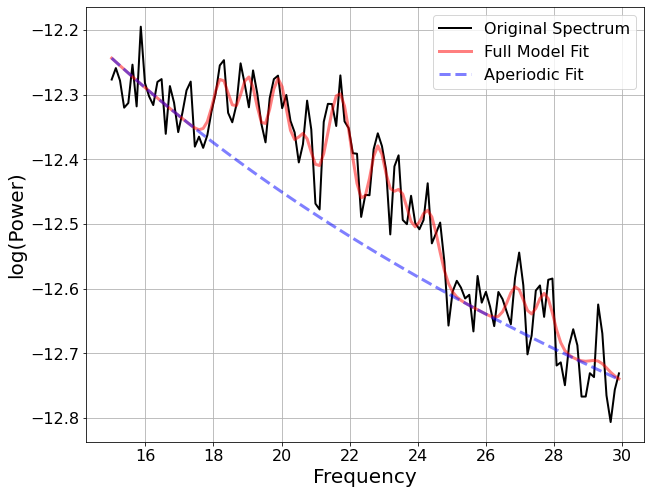

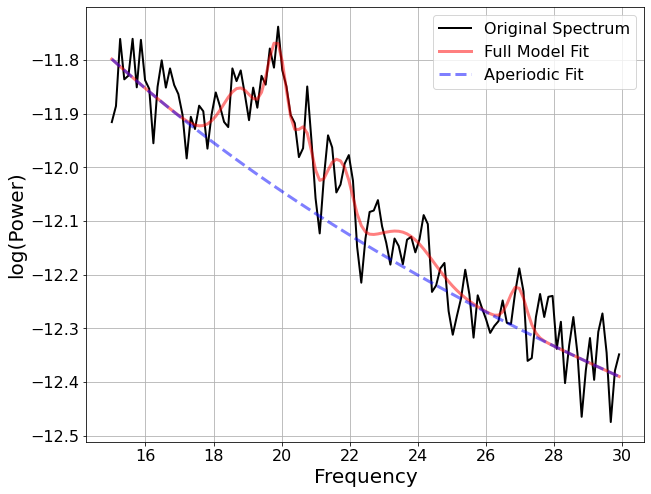

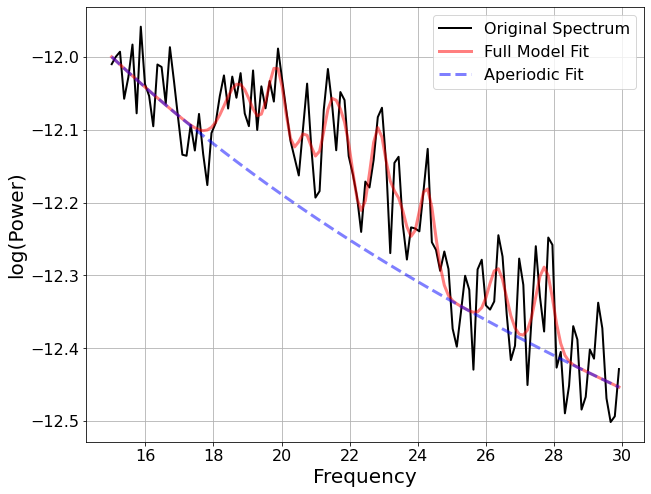

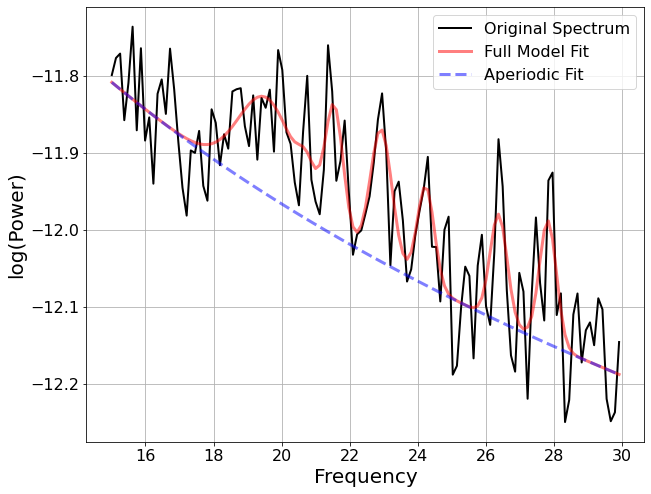

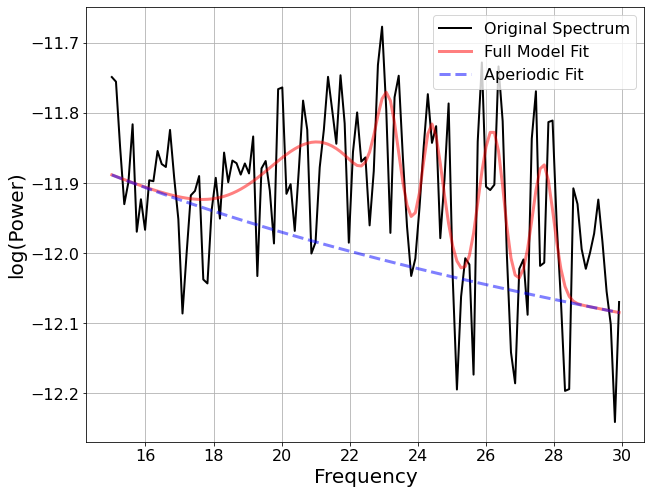

In [ ]:
#'EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'
EEG_85_fm_mus_b = FOOOF()
EEG_86_fm_mus_b = FOOOF()
EEG_91_fm_mus_b = FOOOF()
EEG_92_fm_mus_b = FOOOF()
EEG_97_fm_mus_b = FOOOF()
EEG_98_fm_mus_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


# 'EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'
EEG_85_mus_b = EEG_85_fm_mus_b.report(freqs, psd[0].flatten(), freq_range)
EEG_86_mus_b = EEG_86_fm_mus_b.report(freqs, psd[1].flatten(), freq_range)
EEG_91_mus_b = EEG_91_fm_mus_b.report(freqs, psd[2].flatten(), freq_range)
EEG_92_mus_b = EEG_92_fm_mus_b.report(freqs, psd[3].flatten(), freq_range)
EEG_97_mus_b = EEG_97_fm_mus_b.report(freqs, psd[4].flatten(), freq_range)
EEG_98_mus_b = EEG_98_fm_mus_b.report(freqs, psd[5].flatten(), freq_range)

Computing slow wave/ beta activity ratios

In [ ]:
#'EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'
EEG_85_mus_ratio = sum(EEG_85_fm_mus_sw.power_spectrum) / sum(EEG_85_fm_mus_b.power_spectrum)
EEG_86_mus_ratio = sum(EEG_86_fm_mus_sw.power_spectrum) / sum(EEG_86_fm_mus_b.power_spectrum)
EEG_91_mus_ratio = sum(EEG_91_fm_mus_sw.power_spectrum) / sum(EEG_91_fm_mus_b.power_spectrum)
EEG_92_mus_ratio = sum(EEG_92_fm_mus_sw.power_spectrum) / sum(EEG_92_fm_mus_b.power_spectrum)
EEG_97_mus_ratio = sum(EEG_97_fm_mus_sw.power_spectrum) / sum(EEG_97_fm_mus_b.power_spectrum)
EEG_98_mus_ratio = sum(EEG_98_fm_mus_sw.power_spectrum) / sum(EEG_98_fm_mus_b.power_spectrum)

#### SW/Beta Ratio (Text Condition)

In [ ]:
raw2 = mne.io.read_raw_edf('msm_p03_t3.edf') 
raw2.crop(tmin = 339, tmax = 939)
raw2.pick_channels(['EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'])

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t3.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
channel_renaming_dict = {'EEG 85':'PO4', 'EEG 86':'P2', 'EEG 91':'P6', 'EEG 92':'P4', 'EEG 97':'CP6', 'EEG 98':'CP4'}

raw2.rename_channels(channel_renaming_dict)  # happens in-place

raw2.ch_names

['PO4', 'P2', 'P6', 'P4', 'CP6', 'CP4']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw2.set_montage(montage)

<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~16 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-35-1f682e7cb6ee>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw2)


Selecting by number: 6 components
Fitting ICA took 1.6s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


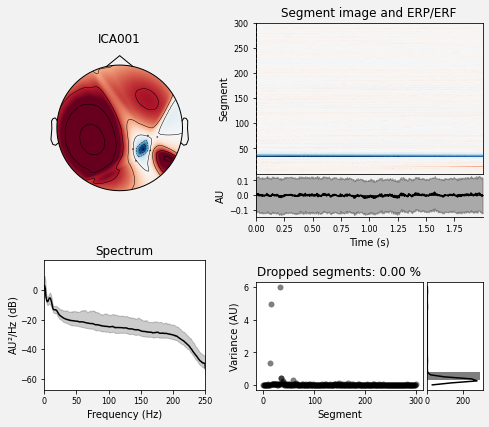

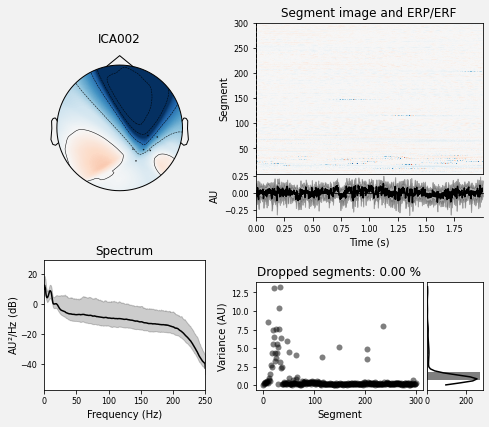

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw2)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw2, picks=ica.exclude)
plt.show()

In [ ]:
# for ann in raw2.annotations:
#     descr = ann['description']
#     start = ann['onset']
#     # end = ann['onset'] + ann['duration']
#     print(f"'{descr}' starts at {start}")

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


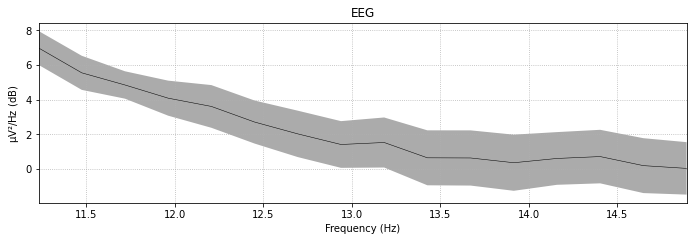

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


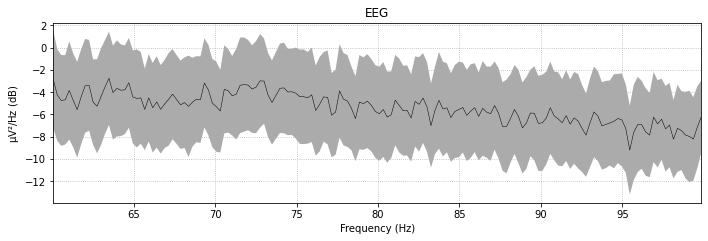

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


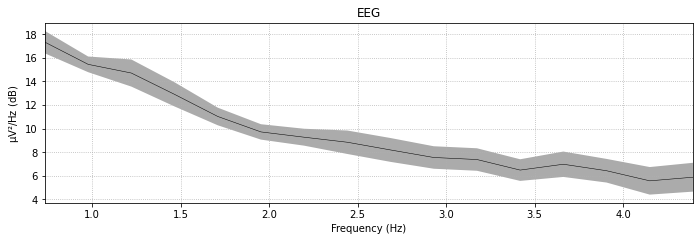

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


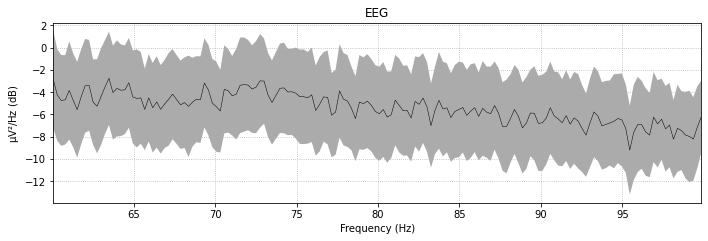

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

In [ ]:
psd2, freqs2 = mne.time_frequency.psd_array_welch(raw2.get_data(), sfreq=raw2.info['sfreq'], n_fft=4096)
psd2.shape,freqs2.shape

Effective window size : 8.192 (s)


((6, 2049), (2049,))

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.4820, 1.4068                                         
                                                                                                  
                                       14 peaks were found:                                       
          

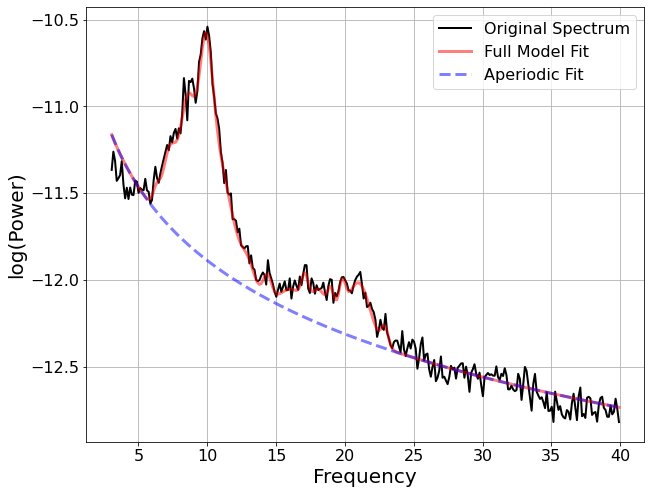

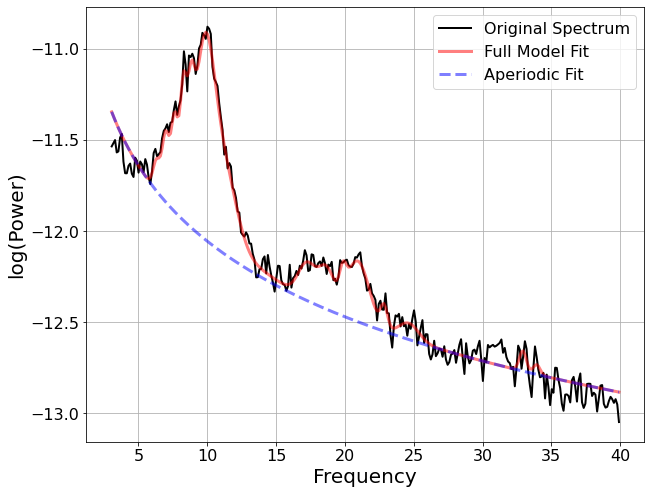

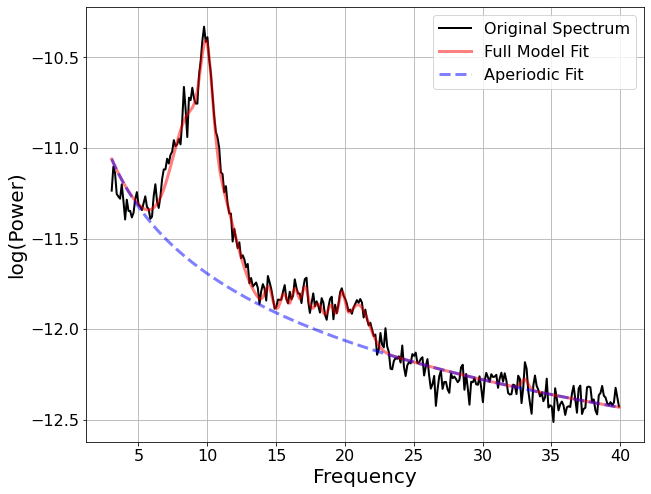

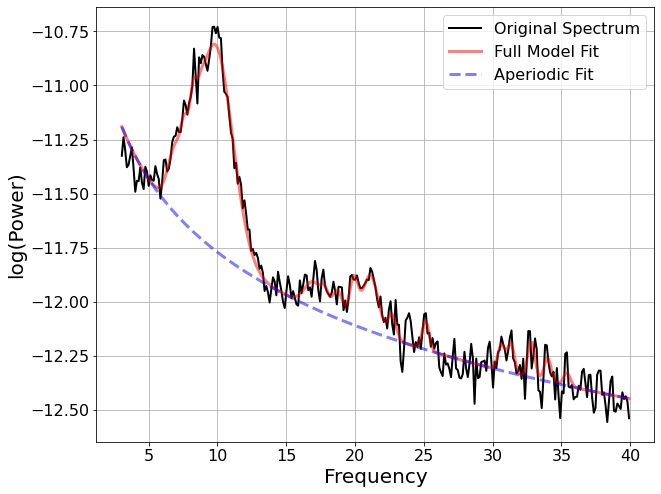

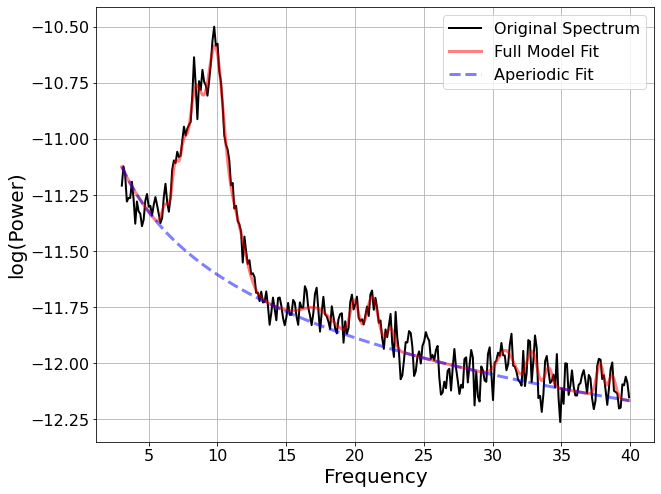

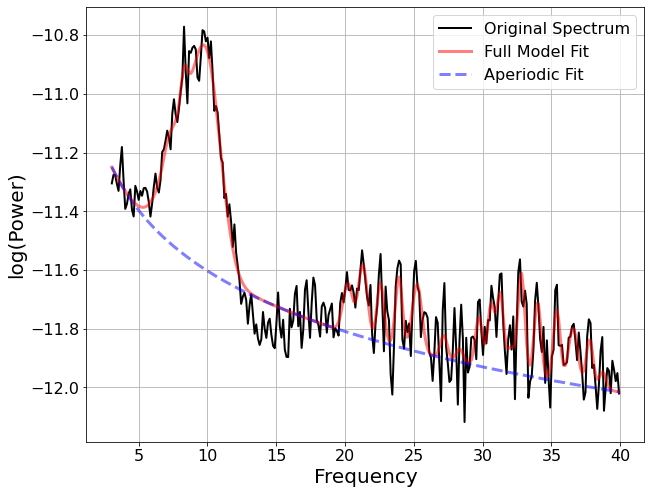

In [ ]:
EEG_85_fm2 = FOOOF()
EEG_86_fm2 = FOOOF()
EEG_91_fm2 = FOOOF()
EEG_92_fm2 = FOOOF()
EEG_97_fm2 = FOOOF()
EEG_98_fm2 = FOOOF()

# freq_range = [11,15] 
freq_range2 = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta

# 'EEG 85':'PO4', 'EEG 86':'P2', 'EEG 91':'P6', 'EEG 92':'P4', 'EEG 97':'CP6', 'EEG 98':'CP4'
EEG_85 = EEG_85_fm2.report(freqs2, psd2[0].flatten(), freq_range2)
EEG_86 = EEG_86_fm2.report(freqs2, psd2[1].flatten(), freq_range2)
EEG_91 = EEG_91_fm2.report(freqs2, psd2[2].flatten(), freq_range2)
EEG_92 = EEG_92_fm2.report(freqs2, psd2[3].flatten(), freq_range2)
EEG_97 = EEG_97_fm2.report(freqs2, psd2[4].flatten(), freq_range2)
EEG_98 = EEG_98_fm2.report(freqs2, psd2[5].flatten(), freq_range2)

In [ ]:
Freqs_P4_text = [EEG_85_fm2.freqs,EEG_86_fm2.freqs,EEG_91_fm2.freqs,EEG_92_fm2.freqs,EEG_97_fm2.freqs,EEG_98_fm2.freqs]
Power_Spectrum_P4_Text = [EEG_85_fm2.power_spectrum,EEG_86_fm2.power_spectrum,EEG_91_fm2.power_spectrum,EEG_92_fm2.power_spectrum,EEG_97_fm2.power_spectrum,EEG_98_fm2.power_spectrum]

In [ ]:
# Text_Spec_1 = plot_spectrum(Freqs_P4_text[0], Power_Spectrum_P4_Text[0])
# Text_Spec_2 = plot_spectrum(Freqs_P4_text[1], Power_Spectrum_P4_Text[1])
# Text_Spec_3 = plot_spectrum(Freqs_P4_text[2], Power_Spectrum_P4_Text[2])
# Text_Spec_4 = plot_spectrum(Freqs_P4_text[3], Power_Spectrum_P4_Text[3])
# Text_Spec_5 = plot_spectrum(Freqs_P4_text[4], Power_Spectrum_P4_Text[4])
# Text_Spec_6 = plot_spectrum(Freqs_P4_text[5], Power_Spectrum_P4_Text[5])

In [ ]:
# spec_2 = plot_spectrum(fm2.freqs, fm2.power_spectrum)
# plt.show()

In [ ]:
Freq_Range_P4_Text = [EEG_85_fm2.freq_range,EEG_86_fm2.freq_range,EEG_91_fm2.freq_range,EEG_92_fm2.freq_range,EEG_97_fm2.freq_range,EEG_98_fm2.freq_range]
Aperiodic_Params_P4_Text = [list(EEG_85_fm2.aperiodic_params_),list(EEG_86_fm2.aperiodic_params_),list(EEG_91_fm2.aperiodic_params_),list(EEG_92_fm2.aperiodic_params_),list(EEG_97_fm2.aperiodic_params_),list(EEG_98_fm2.aperiodic_params_)]
Peak_Params_P4_Text = [EEG_85_fm2.peak_params_.tolist(),EEG_86_fm2.peak_params_.tolist(),EEG_91_fm2.peak_params_.tolist(),EEG_92_fm2.peak_params_.tolist(),EEG_97_fm2.peak_params_.tolist(),EEG_98_fm2.peak_params_.tolist()]

In [ ]:
freqs_2_1, powers_2_1 = gen_power_spectrum(Freq_Range_P4_Text[0], Aperiodic_Params_P4_Text[0], Peak_Params_P4_Text[0])
freqs_2_2, powers_2_2 = gen_power_spectrum(Freq_Range_P4_Text[1], Aperiodic_Params_P4_Text[1], Peak_Params_P4_Text[1])
freqs_2_3, powers_2_3 = gen_power_spectrum(Freq_Range_P4_Text[2], Aperiodic_Params_P4_Text[2], Peak_Params_P4_Text[2])
freqs_2_4, powers_2_4 = gen_power_spectrum(Freq_Range_P4_Text[3], Aperiodic_Params_P4_Text[3], Peak_Params_P4_Text[3])
freqs_2_5, powers_2_5 = gen_power_spectrum(Freq_Range_P4_Text[4], Aperiodic_Params_P4_Text[4], Peak_Params_P4_Text[4])
freqs_2_6, powers_2_6 = gen_power_spectrum(Freq_Range_P4_Text[5], Aperiodic_Params_P4_Text[5], Peak_Params_P4_Text[5])

# Text_p_1 = plot_spectrum(freqs_2_1, powers_2_1, log_powers=True)
# Text_p_2 = plot_spectrum(freqs_2_2, powers_2_2, log_powers=True)
# Text_p_3 = plot_spectrum(freqs_2_3, powers_2_3, log_powers=True)
# Text_p_4 = plot_spectrum(freqs_2_4, powers_2_4, log_powers=True)
# Text_p_5 = plot_spectrum(freqs_2_5, powers_2_5, log_powers=True)
# Text_p_6 = plot_spectrum(freqs_2_6, powers_2_6, log_powers=True)

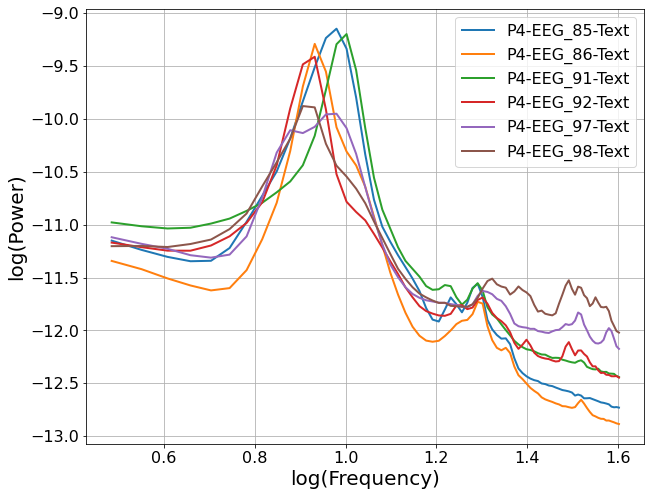

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['P4-EEG_85-Text', 'P4-EEG_86-Text', 'P4-EEG_91-Text', 'P4-EEG_92-Text', 'P4-EEG_97-Text', 'P4-EEG_98-Text']#'P4-TextAudio'

plot_spectra(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

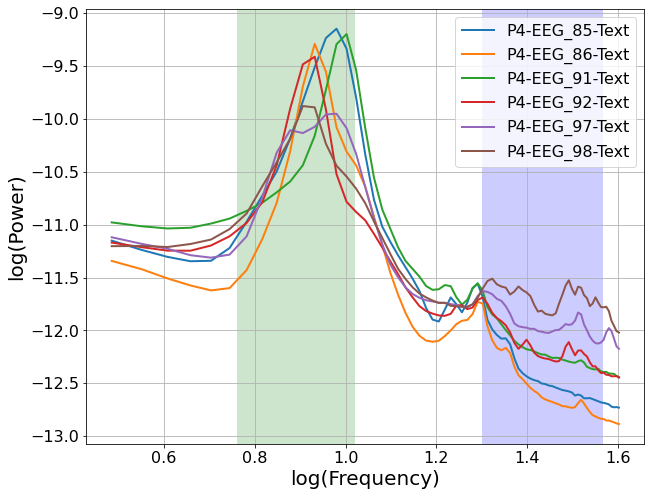

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['P4-EEG_85-Text', 'P4-EEG_86-Text', 'P4-EEG_91-Text', 'P4-EEG_92-Text', 'P4-EEG_97-Text', 'P4-EEG_98-Text']
plot_spectra_shading(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], [[5.75, 10.5], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting slow wave activity(text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.6290, 1.3827                                         
                                                                                                  
                                       1 peaks were found:                                        
          

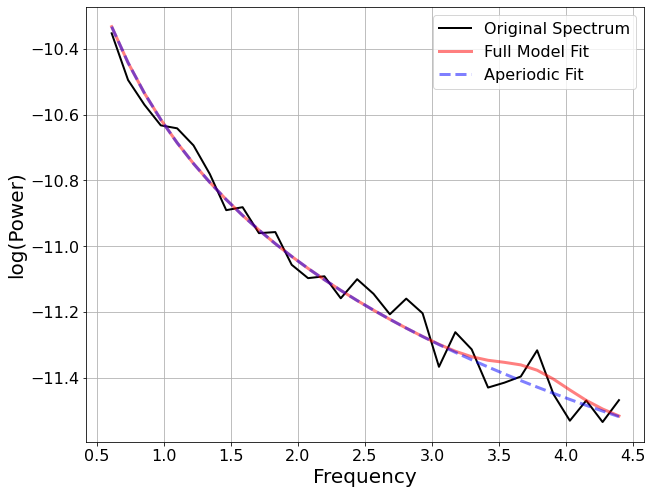

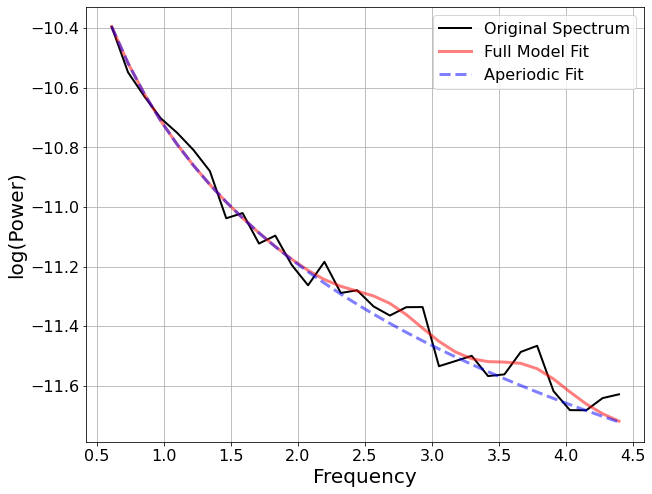

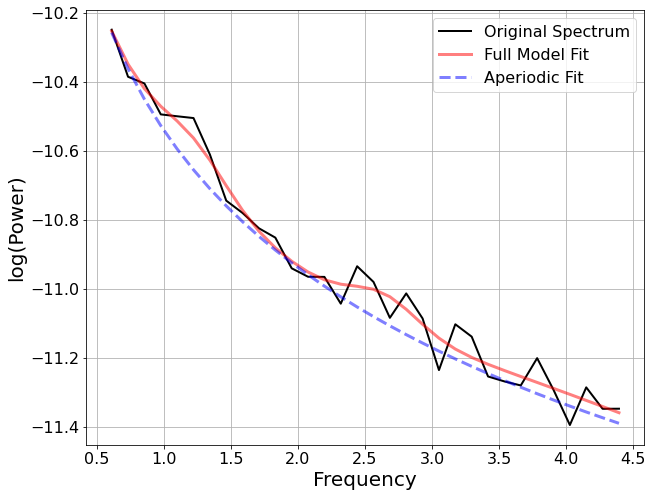

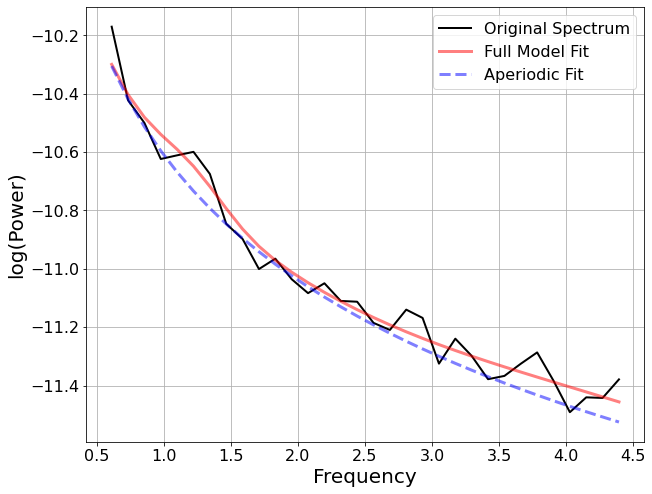

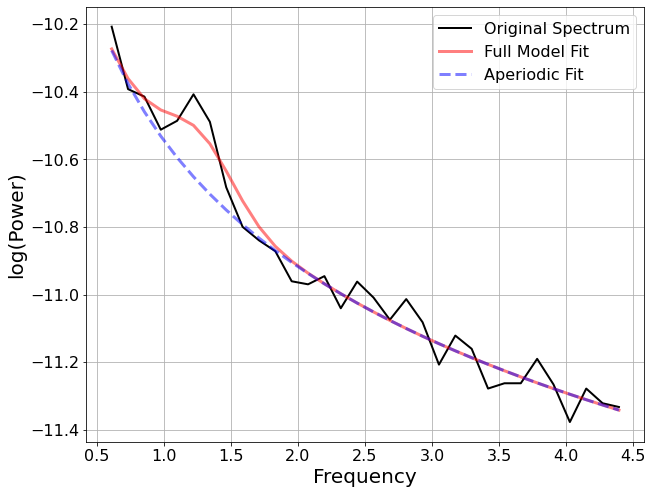

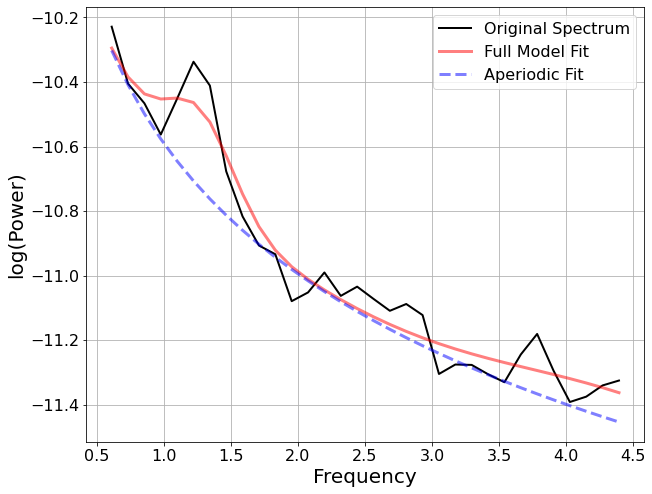

In [ ]:
# 'EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'
EEG_85_fm_text_sw = FOOOF()
EEG_86_fm_text_sw = FOOOF()
EEG_91_fm_text_sw = FOOOF()
EEG_92_fm_text_sw = FOOOF()
EEG_97_fm_text_sw = FOOOF()
EEG_98_fm_text_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'
EEG_85_text_sw = EEG_85_fm_text_sw.report(freqs, psd2[0].flatten(), freq_range)
EEG_86_text_sw = EEG_86_fm_text_sw.report(freqs, psd2[1].flatten(), freq_range)
EEG_91_text_sw = EEG_91_fm_text_sw.report(freqs, psd2[2].flatten(), freq_range)
EEG_92_text_sw = EEG_92_fm_text_sw.report(freqs, psd2[3].flatten(), freq_range)
EEG_97_text_sw = EEG_97_fm_text_sw.report(freqs, psd2[4].flatten(), freq_range)
EEG_98_text_sw = EEG_98_fm_text_sw.report(freqs, psd2[5].flatten(), freq_range)

Extracting beta activity(text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -9.6500, 1.9909                                          
                                                                                                  
                                       9 peaks were found:                                        
          

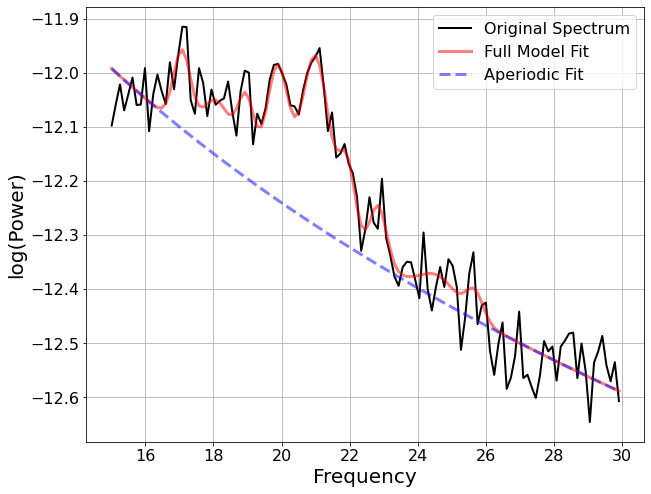

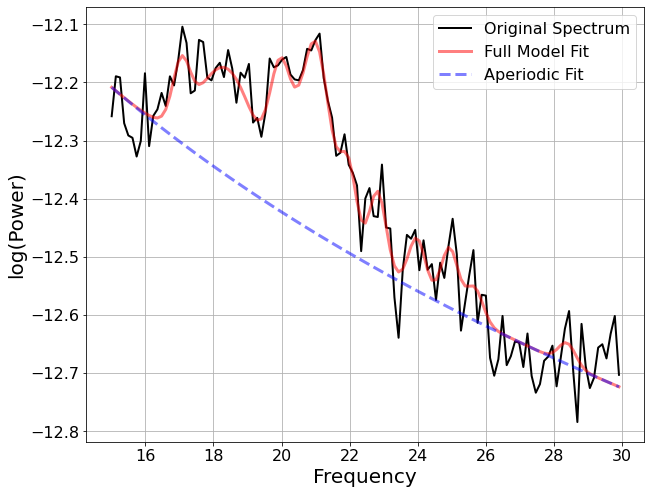

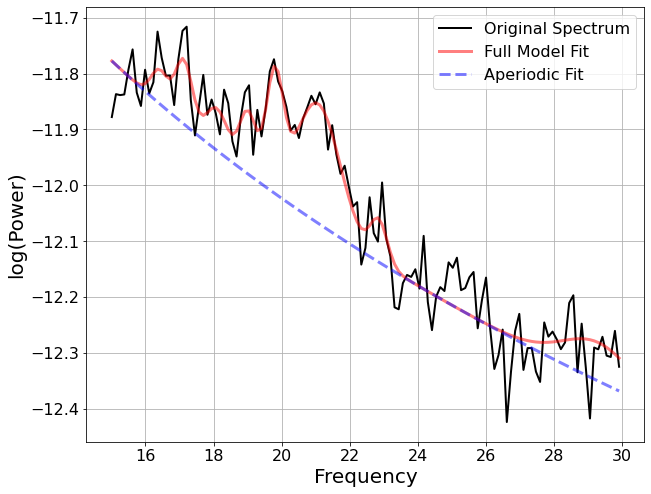

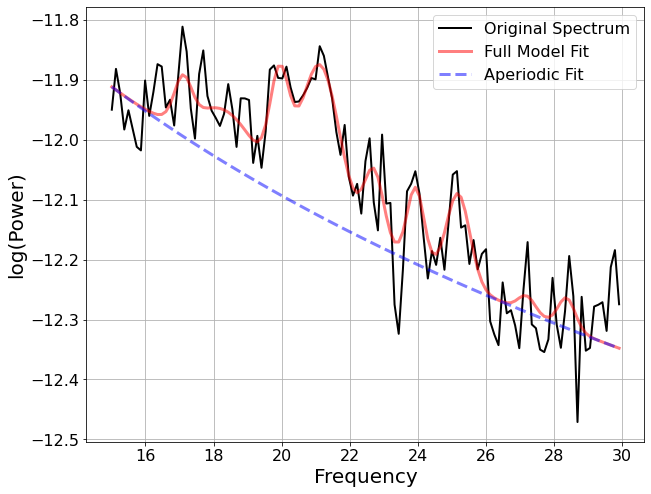

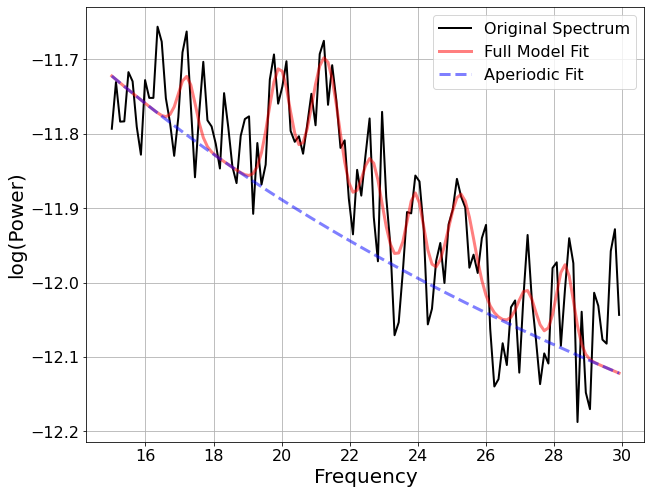

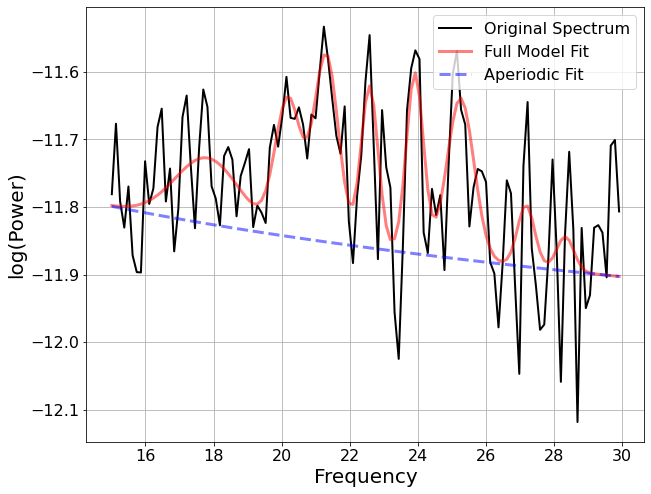

In [ ]:
# 'EEG 85', 'EEG 86', 'EEG 91', 'EEG 92', 'EEG 97', 'EEG 98'
EEG_85_fm_text_b = FOOOF()
EEG_86_fm_text_b = FOOOF()
EEG_91_fm_text_b = FOOOF()
EEG_92_fm_text_b = FOOOF()
EEG_97_fm_text_b = FOOOF()
EEG_98_fm_text_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


EEG_85_text_b = EEG_85_fm_text_b.report(freqs, psd2[0].flatten(), freq_range)
EEG_86_text_b = EEG_86_fm_text_b.report(freqs, psd2[1].flatten(), freq_range)
EEG_91_text_b = EEG_91_fm_text_b.report(freqs, psd2[2].flatten(), freq_range)
EEG_92_text_b = EEG_92_fm_text_b.report(freqs, psd2[3].flatten(), freq_range)
EEG_97_text_b = EEG_97_fm_text_b.report(freqs, psd2[4].flatten(), freq_range)
EEG_98_text_b = EEG_98_fm_text_b.report(freqs, psd2[5].flatten(), freq_range)

Computing slow wave / beta activity

In [ ]:
EEG_85_text_ratio = sum(EEG_85_fm_text_sw.power_spectrum) / sum(EEG_85_fm_text_b.power_spectrum)
EEG_86_text_ratio = sum(EEG_86_fm_text_sw.power_spectrum) / sum(EEG_86_fm_text_b.power_spectrum)
EEG_91_text_ratio = sum(EEG_91_fm_text_sw.power_spectrum) / sum(EEG_91_fm_text_b.power_spectrum)
EEG_92_text_ratio = sum(EEG_92_fm_text_sw.power_spectrum) / sum(EEG_92_fm_text_b.power_spectrum)
EEG_97_text_ratio = sum(EEG_97_fm_text_sw.power_spectrum) / sum(EEG_97_fm_text_b.power_spectrum)
EEG_98_text_ratio = sum(EEG_98_fm_text_sw.power_spectrum) / sum(EEG_98_fm_text_b.power_spectrum)

Comparison

In [ ]:
mus_ratios = [EEG_85_mus_ratio, EEG_86_mus_ratio, EEG_91_mus_ratio, EEG_92_mus_ratio, EEG_97_mus_ratio, EEG_98_mus_ratio]
text_ratios = [EEG_85_text_ratio, EEG_86_text_ratio, EEG_91_text_ratio, EEG_92_text_ratio, EEG_97_text_ratio, EEG_98_text_ratio]
difference = np.array(mus_ratios) - np.array(text_ratios)

In [ ]:
results = pd.DataFrame([mus_ratios, text_ratios, difference], index = ['Music', 'Text', 'Difference'], columns = [85, 86, 91, 92, 97, 98])
results = results.style.set_table_attributes("style='display:inline'").set_caption('P4 Slow Wave/Beta Activity')
results

,85,86,91,92,97,98
Music,0.236189,0.236008,0.236918,0.238308,0.239622,0.241882
Text,0.235548,0.235552,0.236551,0.238029,0.239518,0.242782
Difference,0.000641,0.000456,0.000367,0.000280,0.000104,-0.000900


### Comparing all F3 readings between music and text audio for subject 3

In [ ]:
from IPython import display
display.Image("eeg_placement.png")

In [ ]:
raw = mne.io.read_raw_edf('msm_p03_t2.edf',preload=False) # subject 3, control text run. index 2 in the dataframe in sleep_music_data_notes.ipynb
raw.crop(tmin = 345, tmax = 945) 
raw.pick_channels(['EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'])
# raw.filter(l_freq=.5,h_freq=30)
# DURATION ON TABLE IS 10 MINUTES FOR N1_MIN_TEXT (90,690). 
# or start time for N1 to N2 when interpreting min as stage start time (600,960) 6 minutes
# tmin = 224, tmax = 824, eyes closed to ten minutes after
# tmin = 345, tmax = 945, eyes closed_2 to ten minutes after

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t2.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
# IGNORE THIS
# ch_types = ['eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eog','eog']
# ch_names = ['FP1','FP2','F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'FZ', 'CZ', 'PZ', 'OZ', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'FT9', 'FT10', 'TP9', 'TP10', 'F1', 'F2', 'C1', 'C2', 'P1', 'P2', 'AF3', 'AF4', 'FC3', 'FC4', 'CP3', 'CP4', 'PO3', 'PO4', 'F5', 'F6', 'C5', 'C6', 'P5', 'P6', 'AF7', 'AF8', 'FT7', 'FT8', 'TP7', 'TP8', 'PO7', 'PO8', 'FPZ', 'FCZ', 'CPZ', 'POZ', 'VEOG', 'HEOG']

In [ ]:
# eegbci.standardize(raw)

# channel_renaming_dict = {name: name.replace(' 0', '') for name in raw.ch_names}
channel_renaming_dict = {'EEG 19':'F1', 'EEG 20':'FC1', 'EEG 23':'AF3', 'EEG 24':'F3', 'EEG 27':'F5', 'EEG 28':'FC5'}

raw.rename_channels(channel_renaming_dict)  # happens in-place

raw.ch_names

['F1', 'FC1', 'AF3', 'F3', 'F5', 'FC5']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw.set_montage(montage)

<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~15 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-11-15bd986f335b>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw)


Selecting by number: 6 components
Fitting ICA took 4.6s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


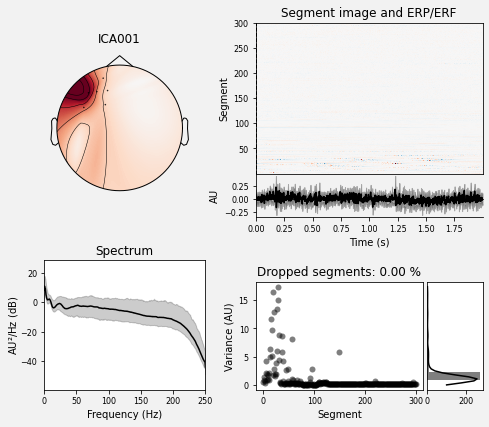

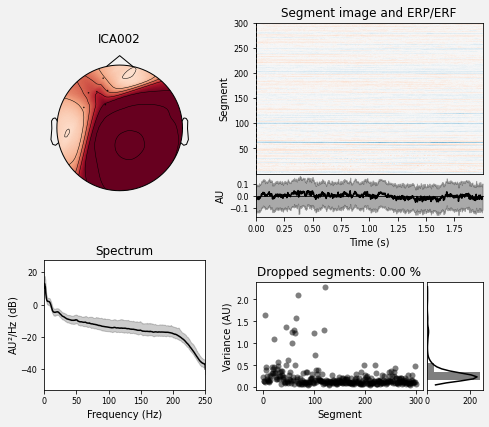

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw, picks=ica.exclude)
plt.show()

#### We can select different brain regions through the chart below:

#### For instance F3:

In [ ]:
# F3 = raw.pick_channels(['EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'])

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


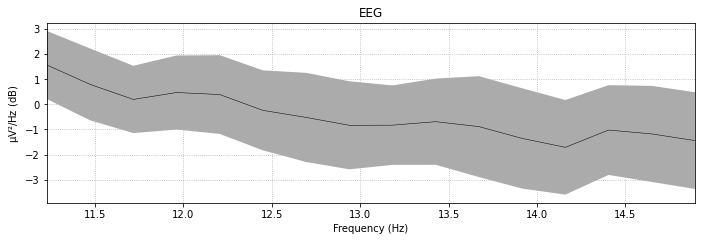

In [ ]:
# 5400 (90 minutes in seconds)

spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


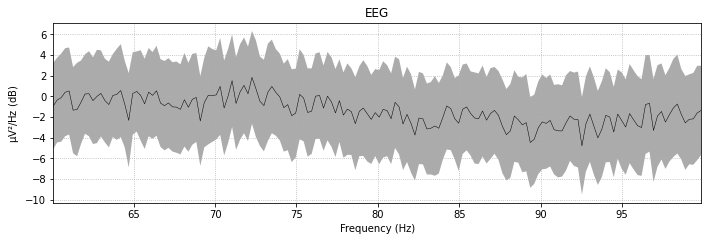

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


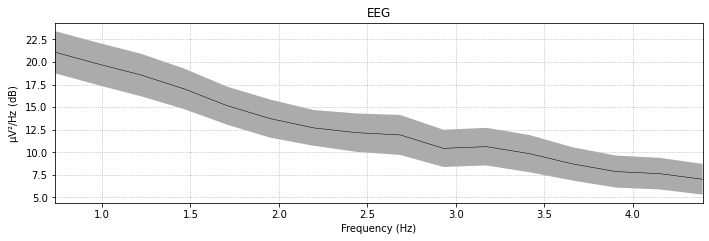

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


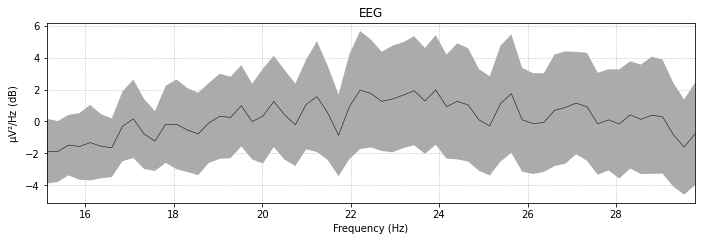

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=15, fmax=30, average = 'Median')
plt.show()

In [ ]:
# https://raphaelvallat.com/bandpower.html
# link above highlights what sensors are common for sleep analysis. which is Fz and Cz

psd, freqs = mne.time_frequency.psd_array_welch(raw.get_data(), sfreq=raw.info['sfreq'], n_fft=4096)

Effective window size : 8.192 (s)


In [ ]:
psd.shape

(6, 2049)

In [ ]:
freqs.shape

(2049,)

In [ ]:
# an_array = freqs
# repetitions = 6

# repeats_array = np.tile(an_array, (repetitions, 1))

# repeats_array.shape

In [ ]:
# an_array = [3,40] 
# repetitions = 6

# freq_range = np.tile(an_array, (repetitions, 1))
# freq_range.shape

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.4497, 1.4971                                         
                                                                                                  
                                       15 peaks were found:                                       
          

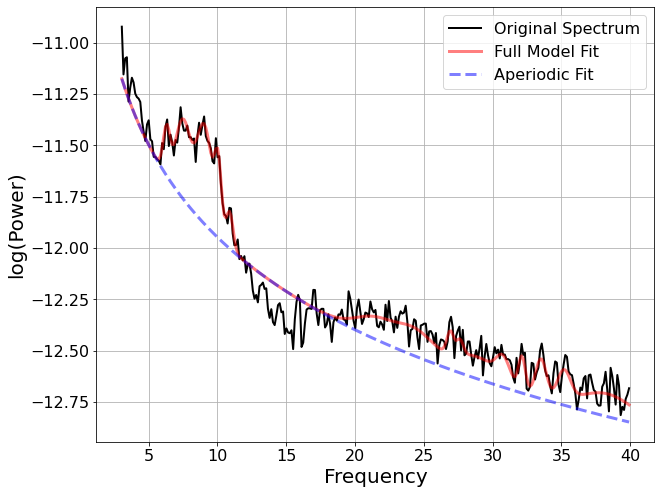

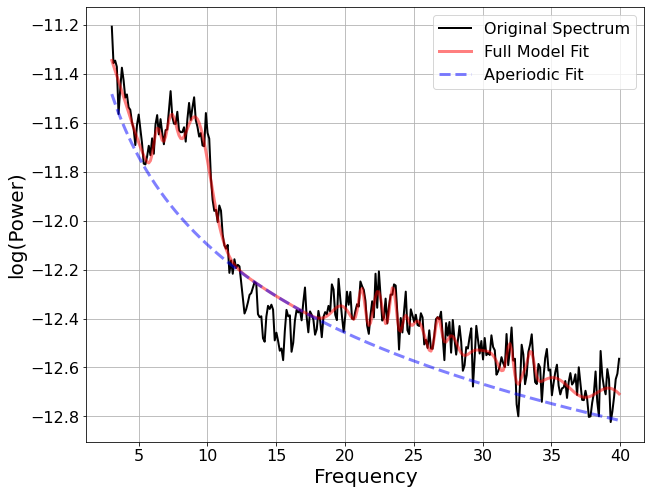

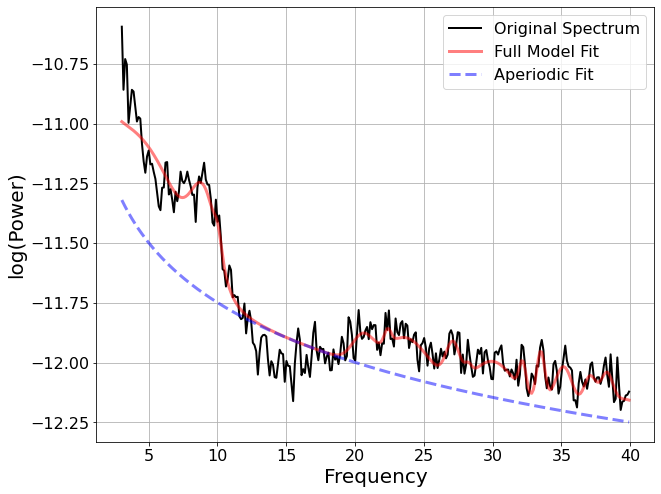

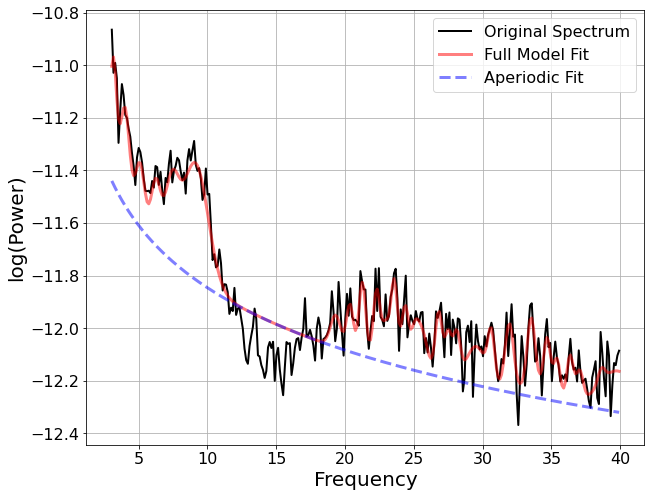

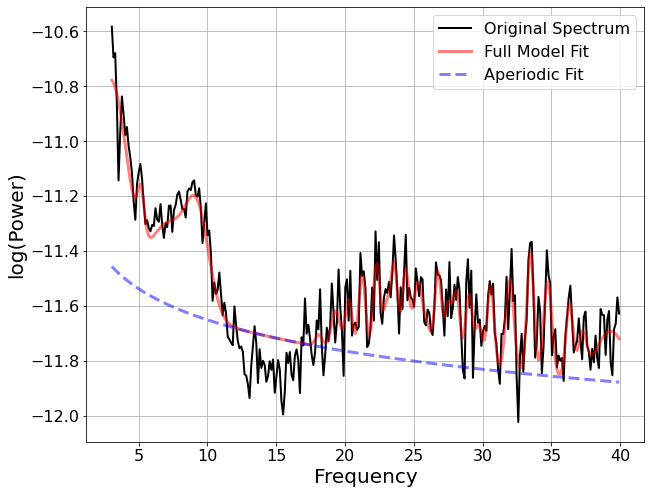

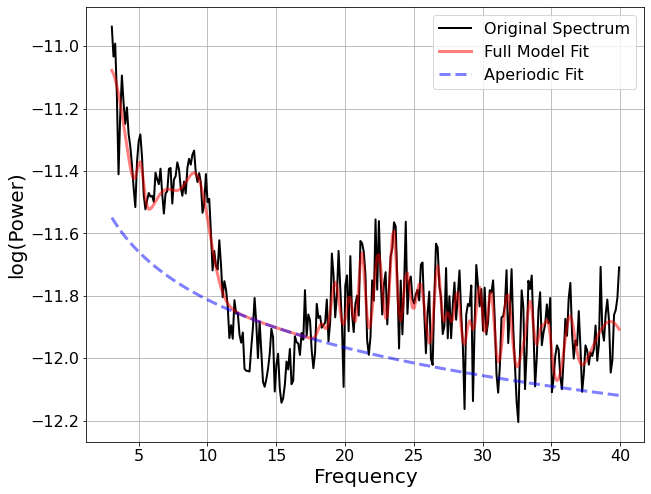

In [ ]:
EEG_19_fm = FOOOF()
EEG_20_fm = FOOOF()
EEG_23_fm = FOOOF()
EEG_24_fm = FOOOF()
EEG_27_fm = FOOOF()
EEG_28_fm = FOOOF()

# freq_range = [11,15] 
freq_range = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'
EEG_19 = EEG_19_fm.report(freqs, psd[0].flatten(), freq_range)
EEG_20 = EEG_20_fm.report(freqs, psd[1].flatten(), freq_range)
EEG_23 = EEG_23_fm.report(freqs, psd[2].flatten(), freq_range)
EEG_24 = EEG_24_fm.report(freqs, psd[3].flatten(), freq_range)
EEG_27 = EEG_27_fm.report(freqs, psd[4].flatten(), freq_range)
EEG_28 = EEG_28_fm.report(freqs, psd[5].flatten(), freq_range)

In [ ]:
Freqs_F3_Music = [EEG_19_fm.freqs,EEG_20_fm.freqs,EEG_23_fm.freqs,EEG_24_fm.freqs,EEG_27_fm.freqs,EEG_28_fm.freqs]
Power_Spectrum_F3_Music = [EEG_19_fm.power_spectrum,EEG_20_fm.power_spectrum,EEG_23_fm.power_spectrum,EEG_24_fm.power_spectrum,EEG_27_fm.power_spectrum,EEG_28_fm.power_spectrum]

In [ ]:
# Music_Spec_1 = plot_spectrum(Freqs_F3_Music[0], Power_Spectrum_F3_Music[0])
# Music_Spec_2 = plot_spectrum(Freqs_F3_Music[1], Power_Spectrum_F3_Music[1])
# Music_Spec_3 = plot_spectrum(Freqs_F3_Music[2], Power_Spectrum_F3_Music[2])
# Music_Spec_4 = plot_spectrum(Freqs_F3_Music[3], Power_Spectrum_F3_Music[3])
# Music_Spec_5 = plot_spectrum(Freqs_F3_Music[4], Power_Spectrum_F3_Music[4])
# Music_Spec_6 = plot_spectrum(Freqs_F3_Music[5], Power_Spectrum_F3_Music[5])

In [ ]:
Freq_Range_F3_Music = [EEG_19_fm.freq_range,EEG_20_fm.freq_range,EEG_23_fm.freq_range,EEG_24_fm.freq_range,EEG_27_fm.freq_range,EEG_28_fm.freq_range]
Aperiodic_Params_F3_Music = [list(EEG_19_fm.aperiodic_params_),list(EEG_20_fm.aperiodic_params_),list(EEG_23_fm.aperiodic_params_),list(EEG_24_fm.aperiodic_params_),list(EEG_27_fm.aperiodic_params_),list(EEG_28_fm.aperiodic_params_)]
Peak_Params_F3_Music = [EEG_19_fm.peak_params_.tolist(),EEG_20_fm.peak_params_.tolist(),EEG_23_fm.peak_params_.tolist(),EEG_24_fm.peak_params_.tolist(),EEG_27_fm.peak_params_.tolist(),EEG_28_fm.peak_params_.tolist()]

In [ ]:
freqs_1_1, powers_1_1 = gen_power_spectrum(Freq_Range_F3_Music[0], Aperiodic_Params_F3_Music[0], Peak_Params_F3_Music[0])
freqs_1_2, powers_1_2 = gen_power_spectrum(Freq_Range_F3_Music[1], Aperiodic_Params_F3_Music[1], Peak_Params_F3_Music[1])
freqs_1_3, powers_1_3 = gen_power_spectrum(Freq_Range_F3_Music[2], Aperiodic_Params_F3_Music[2], Peak_Params_F3_Music[2])
freqs_1_4, powers_1_4 = gen_power_spectrum(Freq_Range_F3_Music[3], Aperiodic_Params_F3_Music[3], Peak_Params_F3_Music[3])
freqs_1_5, powers_1_5 = gen_power_spectrum(Freq_Range_F3_Music[4], Aperiodic_Params_F3_Music[4], Peak_Params_F3_Music[4])
freqs_1_6, powers_1_6 = gen_power_spectrum(Freq_Range_F3_Music[5], Aperiodic_Params_F3_Music[5], Peak_Params_F3_Music[5])

# Music_p_1 = plot_spectrum(freqs_1_1, powers_1_1, log_powers=True)
# Music_p_2 = plot_spectrum(freqs_1_2, powers_1_2, log_powers=True)
# Music_p_3 = plot_spectrum(freqs_1_3, powers_1_3, log_powers=True)
# Music_p_4 = plot_spectrum(freqs_1_4, powers_1_4, log_powers=True)
# Music_p_5 = plot_spectrum(freqs_1_5, powers_1_5, log_powers=True)
# Music_p_6 = plot_spectrum(freqs_1_6, powers_1_6, log_powers=True)

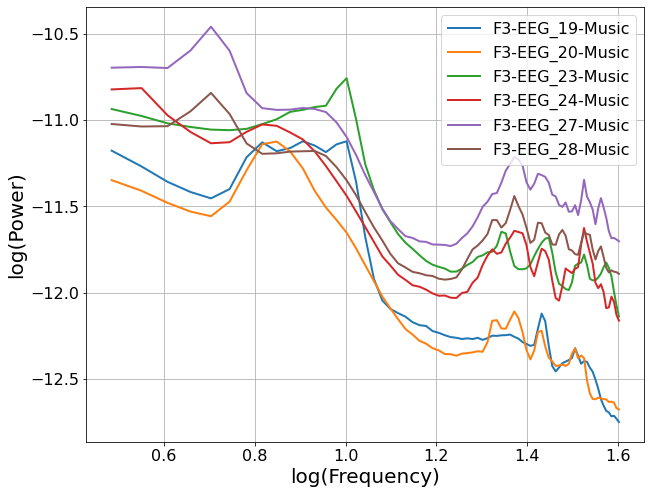

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['F3-EEG_19-Music', 'F3-EEG_20-Music', 'F3-EEG_23-Music', 'F3-EEG_24-Music', 'F3-EEG_27-Music', 'F3-EEG_28-Music']#'F3-TextAudio'

plot_spectra(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

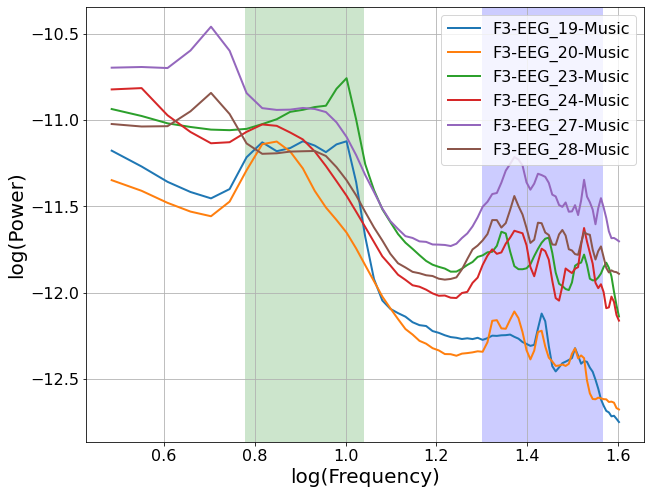

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['F3-EEG_19-Music', 'F3-EEG_20-Music', 'F3-EEG_23-Music', 'F3-EEG_24-Music', 'F3-EEG_27-Music', 'F3-EEG_28-Music']
plot_spectra_shading(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], [[6, 11], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting slow wave activity (Music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.2725, 1.7326                                         
                                                                                                  
                                       2 peaks were found:                                        
          

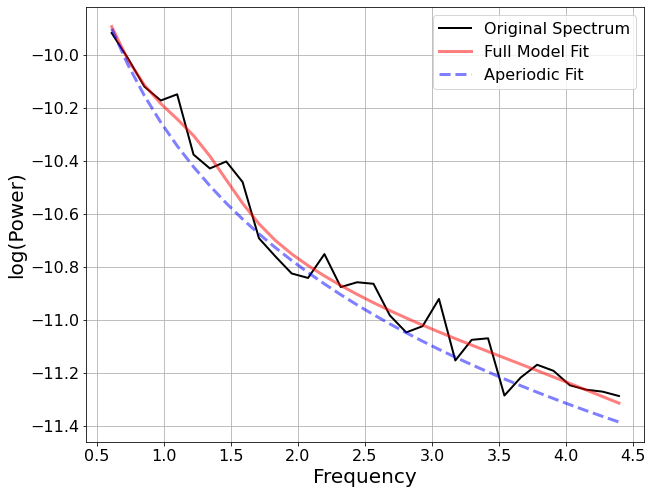

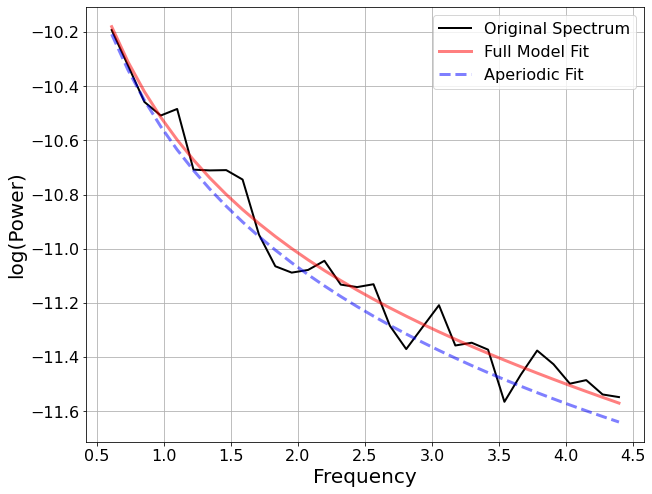

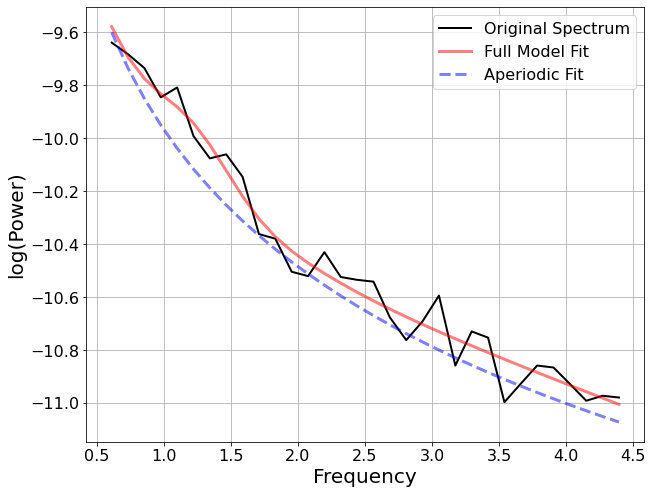

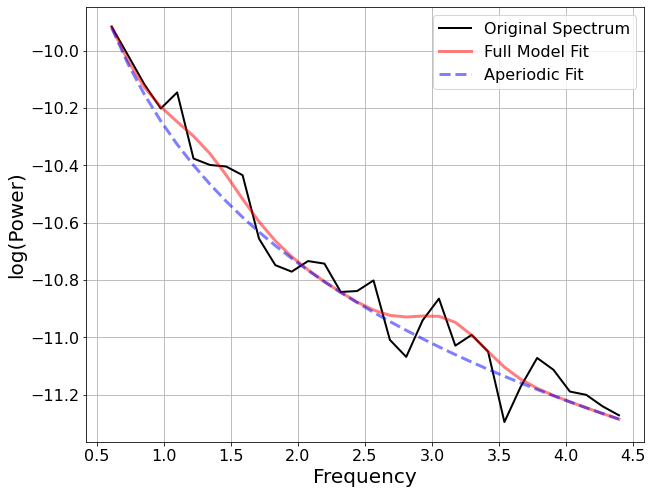

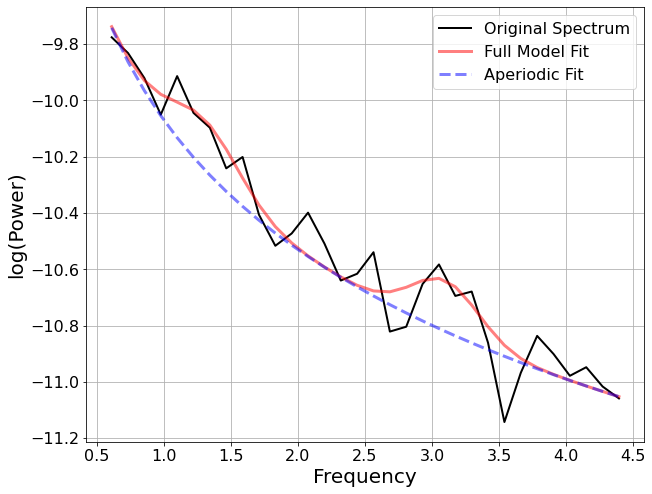

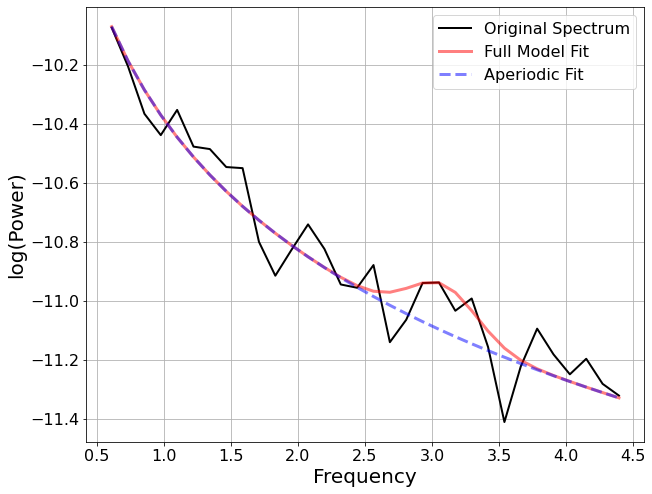

In [ ]:
#'EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'
EEG_19_fm_mus_sw = FOOOF()
EEG_20_fm_mus_sw = FOOOF()
EEG_23_fm_mus_sw = FOOOF()
EEG_24_fm_mus_sw = FOOOF()
EEG_27_fm_mus_sw = FOOOF()
EEG_28_fm_mus_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta

#'EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'
EEG_19_mus_sw = EEG_19_fm_mus_sw.report(freqs, psd[0].flatten(), freq_range)
EEG_20_mus_sw = EEG_20_fm_mus_sw.report(freqs, psd[1].flatten(), freq_range)
EEG_23_mus_sw = EEG_23_fm_mus_sw.report(freqs, psd[2].flatten(), freq_range)
EEG_24_mus_sw = EEG_24_fm_mus_sw.report(freqs, psd[3].flatten(), freq_range)
EEG_27_mus_sw = EEG_27_fm_mus_sw.report(freqs, psd[4].flatten(), freq_range)
EEG_28_mus_sw = EEG_28_fm_mus_sw.report(freqs, psd[5].flatten(), freq_range)

Extracting beta activity (Music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.8213, 0.4683                                         
                                                                                                  
                                       8 peaks were found:                                        
          

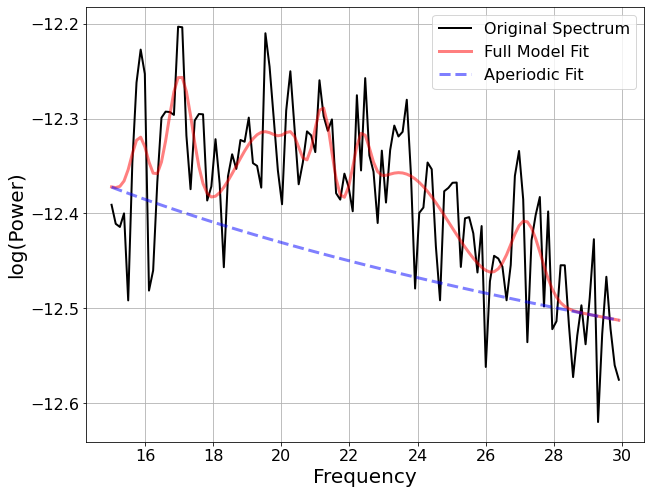

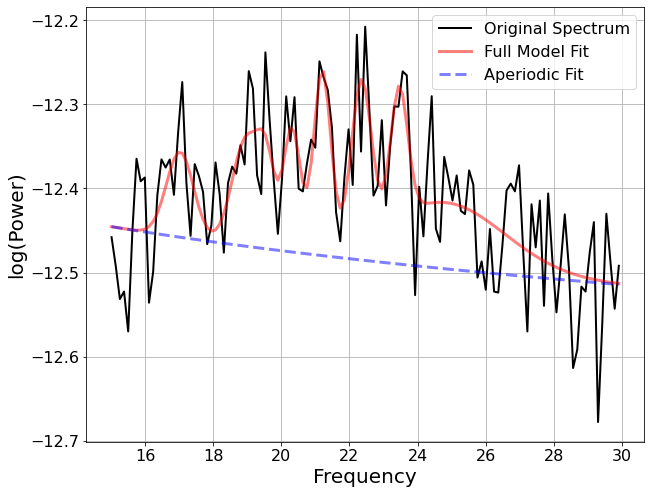

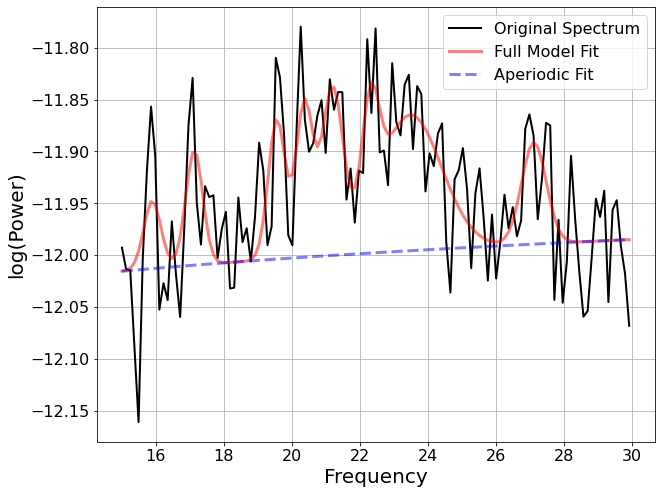

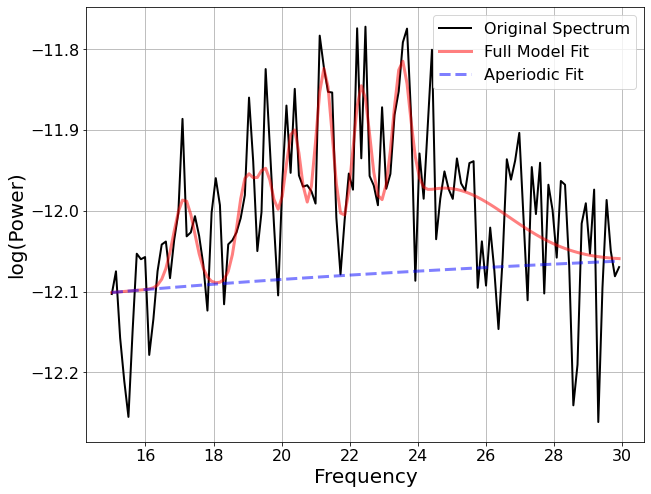

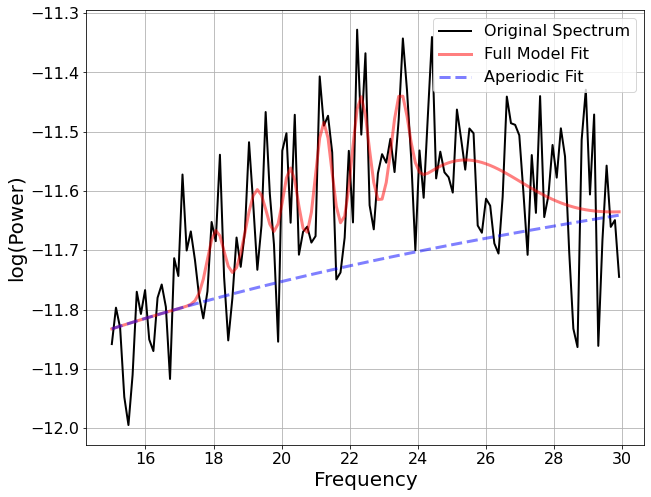

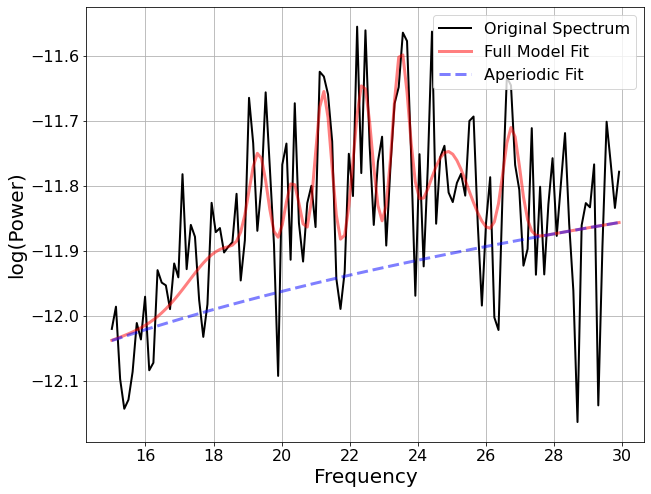

In [ ]:
#'EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'
EEG_19_fm_mus_b = FOOOF()
EEG_20_fm_mus_b = FOOOF()
EEG_23_fm_mus_b = FOOOF()
EEG_24_fm_mus_b = FOOOF()
EEG_27_fm_mus_b = FOOOF()
EEG_28_fm_mus_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


# 'EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'
EEG_19_mus_b = EEG_19_fm_mus_b.report(freqs, psd[0].flatten(), freq_range)
EEG_20_mus_b = EEG_20_fm_mus_b.report(freqs, psd[1].flatten(), freq_range)
EEG_23_mus_b = EEG_23_fm_mus_b.report(freqs, psd[2].flatten(), freq_range)
EEG_24_mus_b = EEG_24_fm_mus_b.report(freqs, psd[3].flatten(), freq_range)
EEG_27_mus_b = EEG_27_fm_mus_b.report(freqs, psd[4].flatten(), freq_range)
EEG_28_mus_b = EEG_28_fm_mus_b.report(freqs, psd[5].flatten(), freq_range)

SW/Beta Ratios

In [ ]:
#'EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'
EEG_19_mus_ratio = sum(EEG_19_fm_mus_sw.power_spectrum) / sum(EEG_19_fm_mus_b.power_spectrum)
EEG_20_mus_ratio = sum(EEG_20_fm_mus_sw.power_spectrum) / sum(EEG_20_fm_mus_b.power_spectrum)
EEG_23_mus_ratio = sum(EEG_23_fm_mus_sw.power_spectrum) / sum(EEG_23_fm_mus_b.power_spectrum)
EEG_24_mus_ratio = sum(EEG_24_fm_mus_sw.power_spectrum) / sum(EEG_24_fm_mus_b.power_spectrum)
EEG_27_mus_ratio = sum(EEG_27_fm_mus_sw.power_spectrum) / sum(EEG_27_fm_mus_b.power_spectrum)
EEG_28_mus_ratio = sum(EEG_28_fm_mus_sw.power_spectrum) / sum(EEG_28_fm_mus_b.power_spectrum)

#### SW/Beta Ratio (Text Condition)

In [ ]:
raw2 = mne.io.read_raw_edf('msm_p03_t3.edf') 
raw2.crop(tmin = 339, tmax = 939)
raw2.pick_channels(['EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'])

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t3.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
channel_renaming_dict = {'EEG 19':'F1', 'EEG 20':'FC1', 'EEG 23':'AF3', 'EEG 24':'F3', 'EEG 27':'F5', 'EEG 28':'FC5'}

raw2.rename_channels(channel_renaming_dict)  # happens in-place

raw2.ch_names

['F1', 'FC1', 'AF3', 'F3', 'F5', 'FC5']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw2.set_montage(montage)

<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~15 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-35-1f682e7cb6ee>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw2)


Selecting by number: 6 components
Fitting ICA took 2.4s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


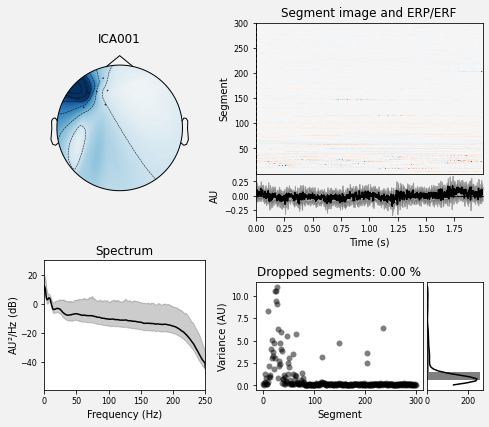

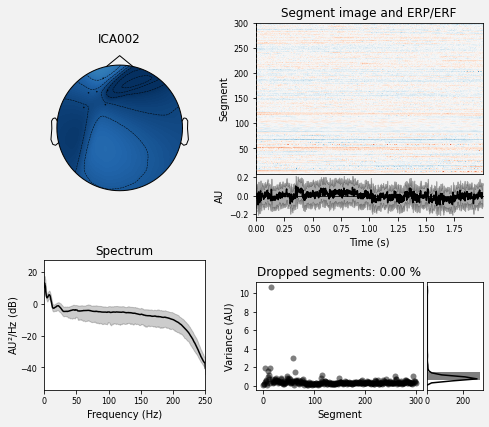

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw2)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw2, picks=ica.exclude)
plt.show()

In [ ]:
# for ann in raw2.annotations:
#     descr = ann['description']
#     start = ann['onset']
#     # end = ann['onset'] + ann['duration']
#     print(f"'{descr}' starts at {start}")

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


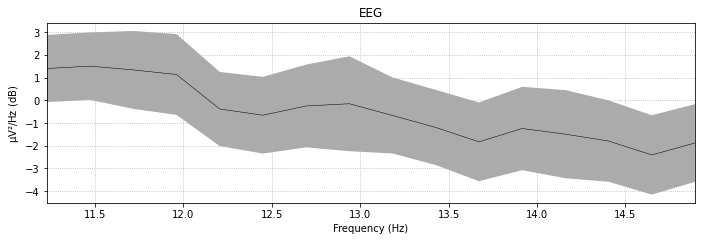

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


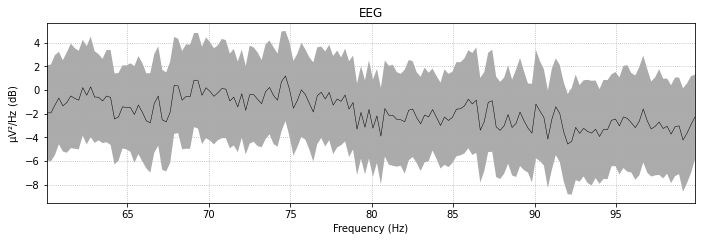

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


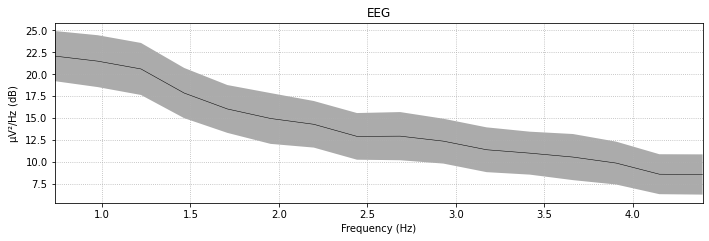

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


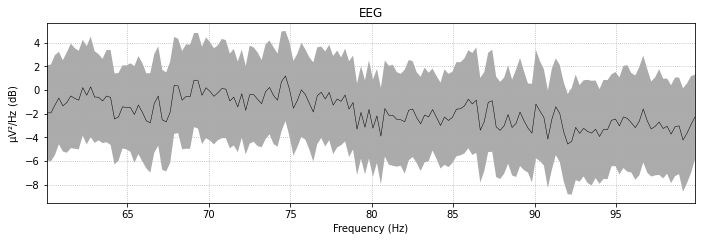

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

In [ ]:
psd2, freqs2 = mne.time_frequency.psd_array_welch(raw2.get_data(), sfreq=raw2.info['sfreq'], n_fft=4096)
psd2.shape,freqs2.shape

Effective window size : 8.192 (s)


((6, 2049), (2049,))

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.2126, 1.6557                                         
                                                                                                  
                                       17 peaks were found:                                       
          

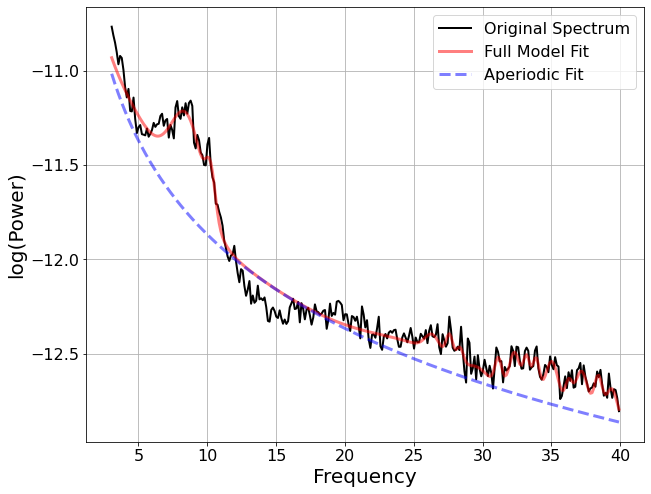

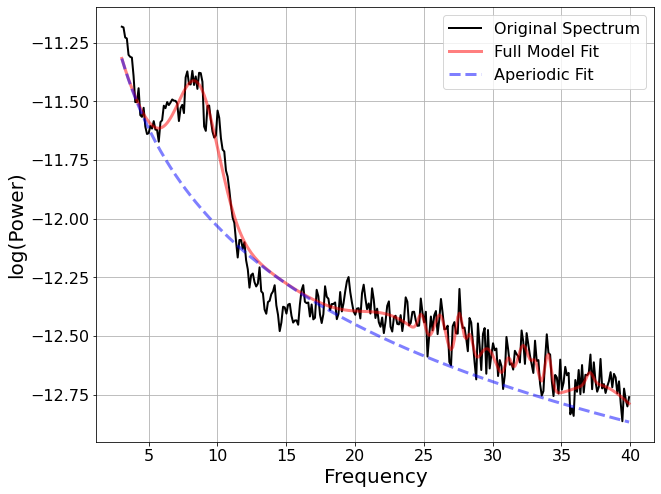

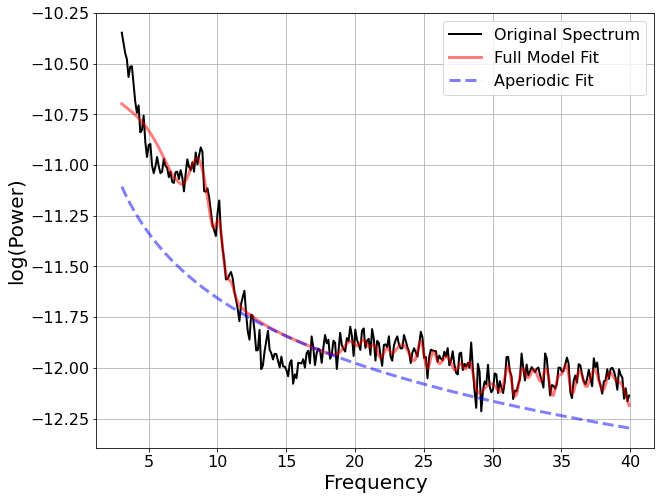

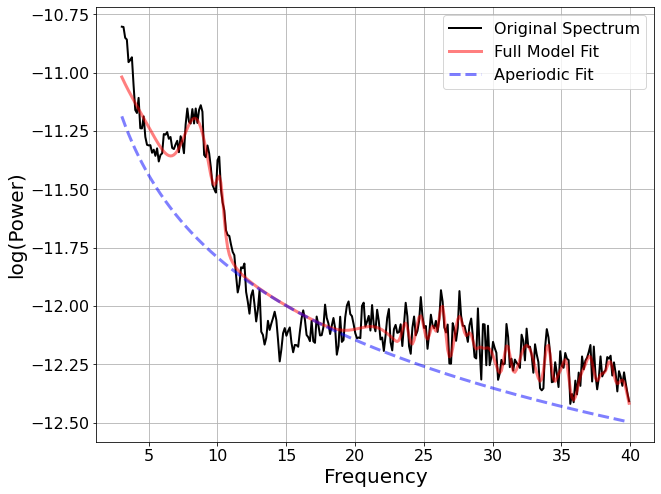

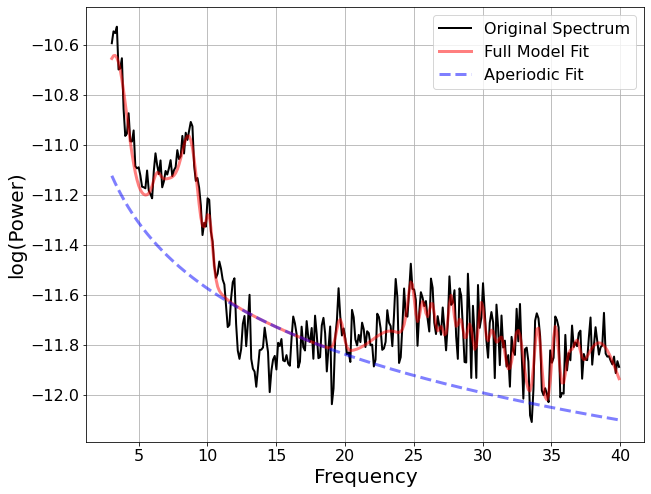

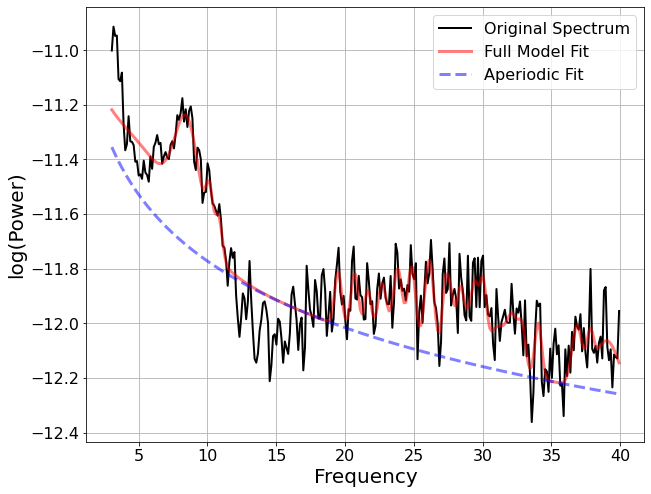

In [ ]:
EEG_19_fm2 = FOOOF()
EEG_20_fm2 = FOOOF()
EEG_23_fm2 = FOOOF()
EEG_24_fm2 = FOOOF()
EEG_27_fm2 = FOOOF()
EEG_28_fm2 = FOOOF()

# freq_range = [11,15] 
freq_range2 = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta

# 'EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'
EEG_19 = EEG_19_fm2.report(freqs2, psd2[0].flatten(), freq_range2)
EEG_20 = EEG_20_fm2.report(freqs2, psd2[1].flatten(), freq_range2)
EEG_23 = EEG_23_fm2.report(freqs2, psd2[2].flatten(), freq_range2)
EEG_24 = EEG_24_fm2.report(freqs2, psd2[3].flatten(), freq_range2)
EEG_27 = EEG_27_fm2.report(freqs2, psd2[4].flatten(), freq_range2)
EEG_28 = EEG_28_fm2.report(freqs2, psd2[5].flatten(), freq_range2)

In [ ]:
Freqs_F3_text = [EEG_19_fm2.freqs,EEG_20_fm2.freqs,EEG_23_fm2.freqs,EEG_24_fm2.freqs,EEG_27_fm2.freqs,EEG_28_fm2.freqs]
Power_Spectrum_F3_Text = [EEG_19_fm2.power_spectrum,EEG_20_fm2.power_spectrum,EEG_23_fm2.power_spectrum,EEG_24_fm2.power_spectrum,EEG_27_fm2.power_spectrum,EEG_28_fm2.power_spectrum]

In [ ]:
# Text_Spec_1 = plot_spectrum(Freqs_F3_text[0], Power_Spectrum_F3_Text[0])
# Text_Spec_2 = plot_spectrum(Freqs_F3_text[1], Power_Spectrum_F3_Text[1])
# Text_Spec_3 = plot_spectrum(Freqs_F3_text[2], Power_Spectrum_F3_Text[2])
# Text_Spec_4 = plot_spectrum(Freqs_F3_text[3], Power_Spectrum_F3_Text[3])
# Text_Spec_5 = plot_spectrum(Freqs_F3_text[4], Power_Spectrum_F3_Text[4])
# Text_Spec_6 = plot_spectrum(Freqs_F3_text[5], Power_Spectrum_F3_Text[5])

In [ ]:
# spec_2 = plot_spectrum(fm2.freqs, fm2.power_spectrum)
# plt.show()

In [ ]:
Freq_Range_F3_Text = [EEG_19_fm2.freq_range,EEG_20_fm2.freq_range,EEG_23_fm2.freq_range,EEG_24_fm2.freq_range,EEG_27_fm2.freq_range,EEG_28_fm2.freq_range]
Aperiodic_Params_F3_Text = [list(EEG_19_fm2.aperiodic_params_),list(EEG_20_fm2.aperiodic_params_),list(EEG_23_fm2.aperiodic_params_),list(EEG_24_fm2.aperiodic_params_),list(EEG_27_fm2.aperiodic_params_),list(EEG_28_fm2.aperiodic_params_)]
Peak_Params_F3_Text = [EEG_19_fm2.peak_params_.tolist(),EEG_20_fm2.peak_params_.tolist(),EEG_23_fm2.peak_params_.tolist(),EEG_24_fm2.peak_params_.tolist(),EEG_27_fm2.peak_params_.tolist(),EEG_28_fm2.peak_params_.tolist()]

In [ ]:
freqs_2_1, powers_2_1 = gen_power_spectrum(Freq_Range_F3_Text[0], Aperiodic_Params_F3_Text[0], Peak_Params_F3_Text[0])
freqs_2_2, powers_2_2 = gen_power_spectrum(Freq_Range_F3_Text[1], Aperiodic_Params_F3_Text[1], Peak_Params_F3_Text[1])
freqs_2_3, powers_2_3 = gen_power_spectrum(Freq_Range_F3_Text[2], Aperiodic_Params_F3_Text[2], Peak_Params_F3_Text[2])
freqs_2_4, powers_2_4 = gen_power_spectrum(Freq_Range_F3_Text[3], Aperiodic_Params_F3_Text[3], Peak_Params_F3_Text[3])
freqs_2_5, powers_2_5 = gen_power_spectrum(Freq_Range_F3_Text[4], Aperiodic_Params_F3_Text[4], Peak_Params_F3_Text[4])
freqs_2_6, powers_2_6 = gen_power_spectrum(Freq_Range_F3_Text[5], Aperiodic_Params_F3_Text[5], Peak_Params_F3_Text[5])

# Text_p_1 = plot_spectrum(freqs_2_1, powers_2_1, log_powers=True)
# Text_p_2 = plot_spectrum(freqs_2_2, powers_2_2, log_powers=True)
# Text_p_3 = plot_spectrum(freqs_2_3, powers_2_3, log_powers=True)
# Text_p_4 = plot_spectrum(freqs_2_4, powers_2_4, log_powers=True)
# Text_p_5 = plot_spectrum(freqs_2_5, powers_2_5, log_powers=True)
# Text_p_6 = plot_spectrum(freqs_2_6, powers_2_6, log_powers=True)

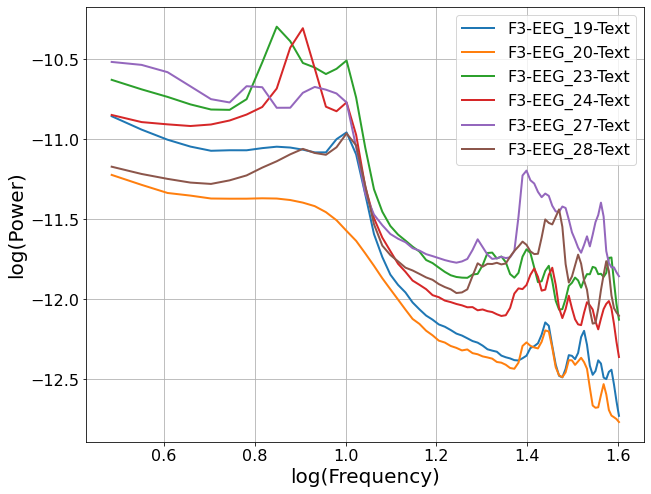

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['F3-EEG_19-Text', 'F3-EEG_20-Text', 'F3-EEG_23-Text', 'F3-EEG_24-Text', 'F3-EEG_27-Text', 'F3-EEG_28-Text']#'F3-TextAudio'

plot_spectra(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

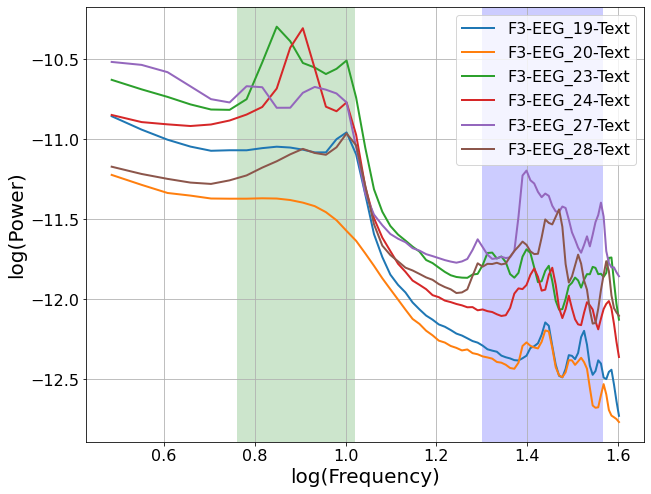

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['F3-EEG_19-Text', 'F3-EEG_20-Text', 'F3-EEG_23-Text', 'F3-EEG_24-Text', 'F3-EEG_27-Text', 'F3-EEG_28-Text']
plot_spectra_shading(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], [[5.75, 10.5], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting slow wave activity (text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.0802, 1.5788                                         
                                                                                                  
                                       1 peaks were found:                                        
          

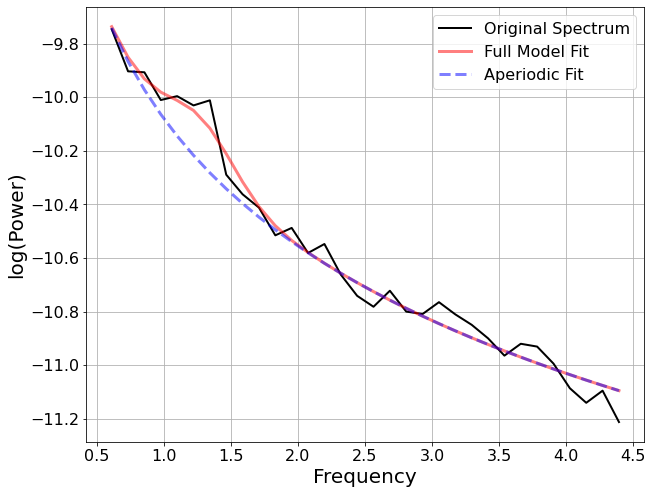

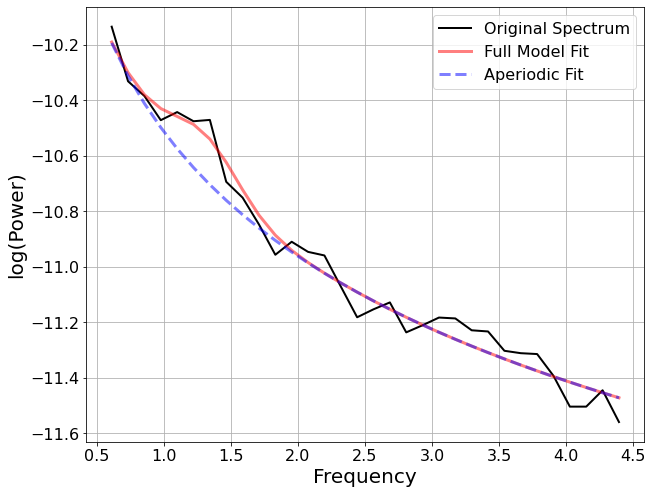

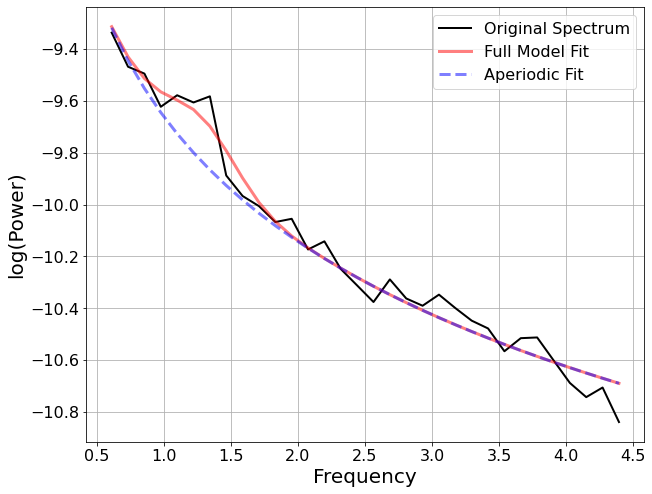

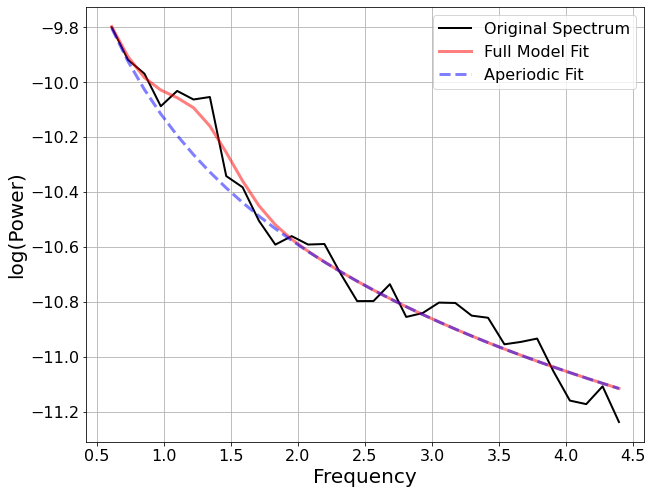

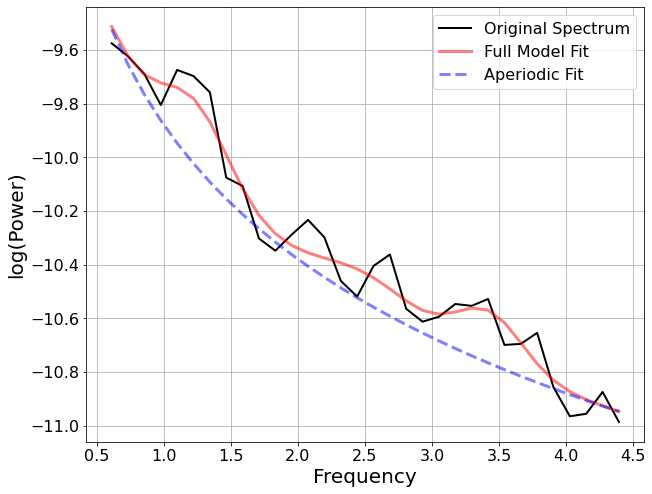

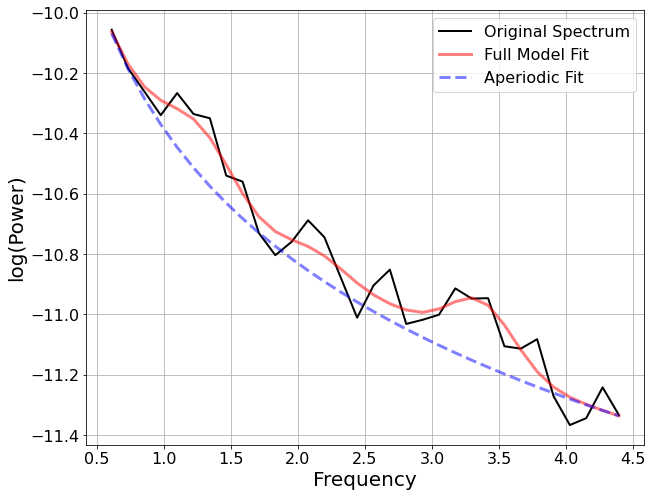

In [ ]:
# 'EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'
EEG_19_fm_text_sw = FOOOF()
EEG_20_fm_text_sw = FOOOF()
EEG_23_fm_text_sw = FOOOF()
EEG_24_fm_text_sw = FOOOF()
EEG_27_fm_text_sw = FOOOF()
EEG_28_fm_text_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'
EEG_19_text_sw = EEG_19_fm_text_sw.report(freqs, psd2[0].flatten(), freq_range)
EEG_20_text_sw = EEG_20_fm_text_sw.report(freqs, psd2[1].flatten(), freq_range)
EEG_23_text_sw = EEG_23_fm_text_sw.report(freqs, psd2[2].flatten(), freq_range)
EEG_24_text_sw = EEG_24_fm_text_sw.report(freqs, psd2[3].flatten(), freq_range)
EEG_27_text_sw = EEG_27_fm_text_sw.report(freqs, psd2[4].flatten(), freq_range)
EEG_28_text_sw = EEG_28_fm_text_sw.report(freqs, psd2[5].flatten(), freq_range)

Extracting beta activity (text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.2012, 0.9117                                         
                                                                                                  
                                       5 peaks were found:                                        
          

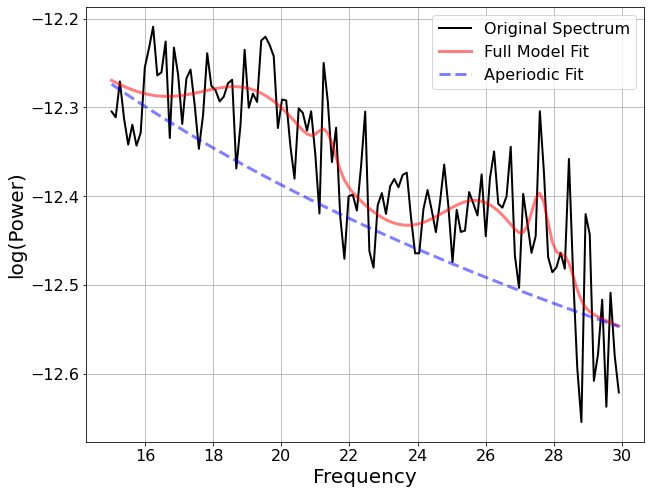

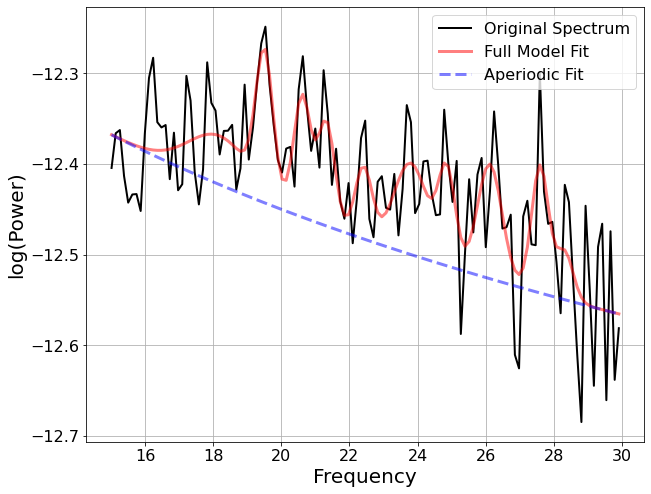

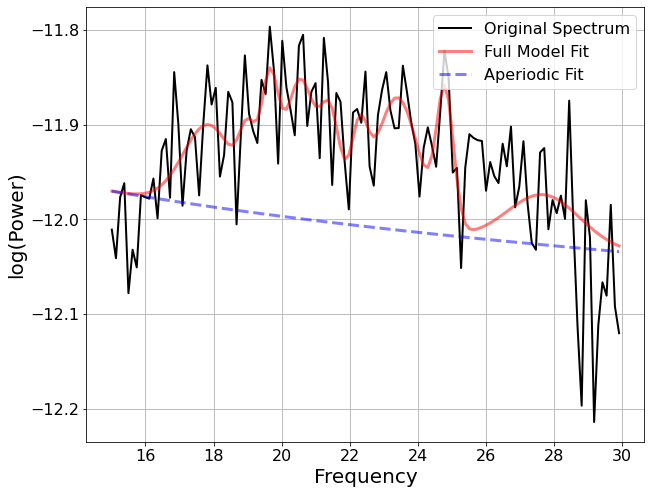

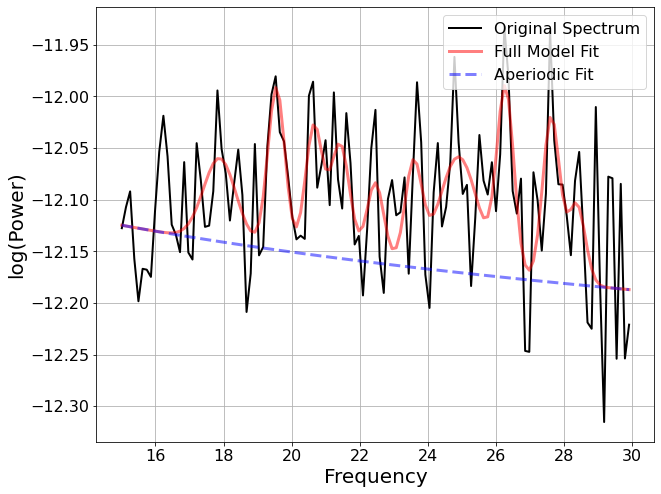

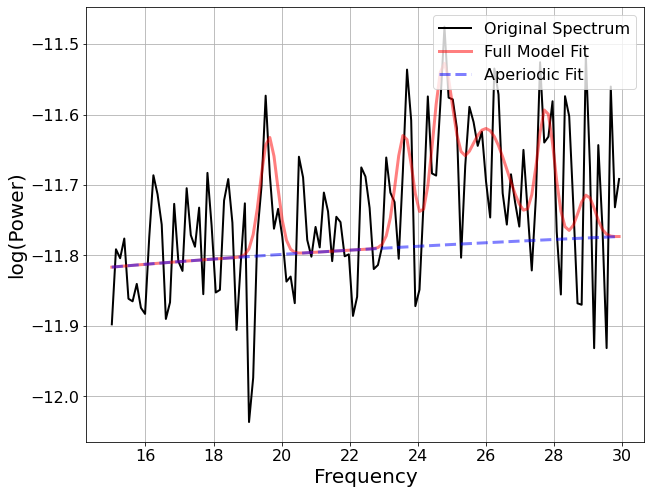

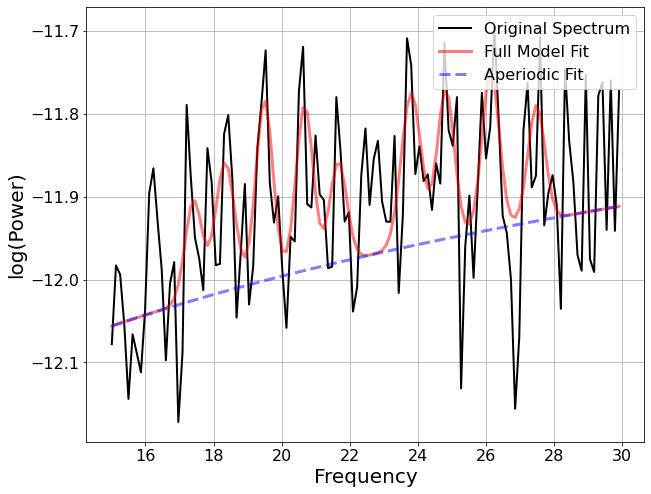

In [ ]:
# 'EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'
EEG_19_fm_text_b = FOOOF()
EEG_20_fm_text_b = FOOOF()
EEG_23_fm_text_b = FOOOF()
EEG_24_fm_text_b = FOOOF()
EEG_27_fm_text_b = FOOOF()
EEG_28_fm_text_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


EEG_19_text_b = EEG_19_fm_text_b.report(freqs, psd2[0].flatten(), freq_range)
EEG_20_text_b = EEG_20_fm_text_b.report(freqs, psd2[1].flatten(), freq_range)
EEG_23_text_b = EEG_23_fm_text_b.report(freqs, psd2[2].flatten(), freq_range)
EEG_24_text_b = EEG_24_fm_text_b.report(freqs, psd2[3].flatten(), freq_range)
EEG_27_text_b = EEG_27_fm_text_b.report(freqs, psd2[4].flatten(), freq_range)
EEG_28_text_b = EEG_28_fm_text_b.report(freqs, psd2[5].flatten(), freq_range)

SW/Beta ratios

In [ ]:
EEG_19_text_ratio = sum(EEG_19_fm_text_sw.power_spectrum) / sum(EEG_19_fm_text_b.power_spectrum)
EEG_20_text_ratio = sum(EEG_20_fm_text_sw.power_spectrum) / sum(EEG_20_fm_text_b.power_spectrum)
EEG_23_text_ratio = sum(EEG_23_fm_text_sw.power_spectrum) / sum(EEG_23_fm_text_b.power_spectrum)
EEG_24_text_ratio = sum(EEG_24_fm_text_sw.power_spectrum) / sum(EEG_24_fm_text_b.power_spectrum)
EEG_27_text_ratio = sum(EEG_27_fm_text_sw.power_spectrum) / sum(EEG_27_fm_text_b.power_spectrum)
EEG_28_text_ratio = sum(EEG_28_fm_text_sw.power_spectrum) / sum(EEG_28_fm_text_b.power_spectrum)

Comparison

In [ ]:
mus_ratios = [EEG_19_mus_ratio, EEG_20_mus_ratio, EEG_23_mus_ratio, EEG_24_mus_ratio, EEG_27_mus_ratio, EEG_28_mus_ratio]
text_ratios = [EEG_19_text_ratio, EEG_20_text_ratio, EEG_23_text_ratio, EEG_24_text_ratio, EEG_27_text_ratio, EEG_28_text_ratio]
difference = np.array(mus_ratios) - np.array(text_ratios)

In [ ]:
results = pd.DataFrame([mus_ratios, text_ratios, difference], index = ['Music', 'Text', 'Difference'], columns = [19, 20, 23, 24, 27, 28])
results = results.style.set_table_attributes("style='display:inline'").set_caption('F3 Slow Wave/Beta Activity')
results

,19,20,23,24,27,28
Music,0.226994,0.232277,0.228324,0.233533,0.235606,0.238587
Text,0.222722,0.230336,0.221889,0.228500,0.229442,0.236171
Difference,0.004273,0.001941,0.006435,0.005033,0.006165,0.002416


In [ ]:
ls

sample_data/


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
cd drive/Shareddrives/COGS\ 138

/content/drive/Shareddrives/COGS 138


In [ ]:
ls

'Brain Storming Literature Review.gdoc'   msm_p19_t3.edf
'File Downloads.gdoc'                     msm_p21_t2.edf
 msm_p02_t2.edf                           msm_p21_t3_2.edf
 msm_p02_t3.edf                           msm_p22_t2.edf
 msm_p03_t2.edf                          'msm_p22_t3 (1).edf'
 msm_p03_t3.edf                           msm_p24_t2.edf
 msm_p04_t2.edf                           msm_p24_t3.edf
 msm_p04_t3.edf                           msm_p25_t2.edf
 msm_p05_t2.edf                           msm_p25_t3.edf
 msm_p05_t3.edf                           msm_p27_t2.edf
 msm_p07_t2.edf                           msm_p27_t3.edf
 msm_p07_t3.edf                           msm_p28_t2_2.edf
 msm_p09_t2.edf                           msm_p28_t3_2.edf
 msm_p09_t3.edf                           msm_p29_t2.edf
 msm_p11_t2.edf                           msm_p29_t3.edf
 msm_p11_t3.edf                           msm_p32_t2.edf
 msm_p12_t2.edf                           msm_p32_t3.edf
 msm_p12_t3.edf     

In [ ]:
!pip install mne
!pip install fooof

     |████████████████████████████████| 7.4 MB 9.2 MB/s 
     |████████████████████████████████| 112 kB 12.7 MB/s 


In [ ]:
import mne
import os
import numpy as np
import pandas as pd

# import pandas as pd
from fooof import FOOOF

# comment
import mne
import nibabel as nb
import matplotlib
import matplotlib.pyplot as plt
import json

from fooof import FOOOF
from fooof.sim.gen import gen_power_spectrum
from fooof.sim.utils import set_random_seed
from fooof.plts.spectra import plot_spectrum, plot_spectra
from fooof.plts.annotate import plot_annotated_model

from fooof.plts.spectra import plot_spectrum_shading, plot_spectra_shading
# import PyQt5
# %matplotlib qt
# matplotlib.use('Qt5Agg')

### Comparing all F4 readings between music and text audio for subject 3

In [ ]:
from IPython import display
display.Image("eeg_placement.png")

In [ ]:
raw = mne.io.read_raw_edf('msm_p03_t2.edf',preload=False) # subject 3, control text run. index 2 in the dataframe in sleep_music_data_notes.ipynb
raw.crop(tmin = 345, tmax = 945) 
raw.pick_channels(['EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'])
# raw.filter(l_freq=.5,h_freq=30)
# DURATION ON TABLE IS 10 MINUTES FOR N1_MIN_TEXT (90,690). 
# or start time for N1 to N2 when interpreting min as stage start time (600,960) 6 minutes
# tmin = 224, tmax = 824, eyes closed to ten minutes after
# tmin = 345, tmax = 945, eyes closed_2 to ten minutes after

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t2.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
# IGNORE THIS
# ch_types = ['eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eog','eog']
# ch_names = ['FP1','FP2','F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'FZ', 'CZ', 'PZ', 'OZ', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'FT9', 'FT10', 'TP9', 'TP10', 'F1', 'F2', 'C1', 'C2', 'P1', 'P2', 'AF3', 'AF4', 'FC3', 'FC4', 'CP3', 'CP4', 'PO3', 'PO4', 'F5', 'F6', 'C5', 'C6', 'P5', 'P6', 'AF7', 'AF8', 'FT7', 'FT8', 'TP7', 'TP8', 'PO7', 'PO8', 'FPZ', 'FCZ', 'CPZ', 'POZ', 'VEOG', 'HEOG']

In [ ]:
# eegbci.standardize(raw)

# channel_renaming_dict = {name: name.replace(' 0', '') for name in raw.ch_names}
channel_renaming_dict = {'EEG 3': 'AF4', 'EEG 4': 'F2', 'EEG 117': 'FC6', 'EEG 118': 'FC2', 'EEG 123': 'F6', 'EEG 124': 'F4'}

raw.rename_channels(channel_renaming_dict)  # happens in-place

raw.ch_names

['AF4', 'F2', 'FC6', 'FC2', 'F6', 'F4']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw.set_montage(montage)

<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~16 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-12-15bd986f335b>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw)


Selecting by number: 6 components
Fitting ICA took 4.7s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


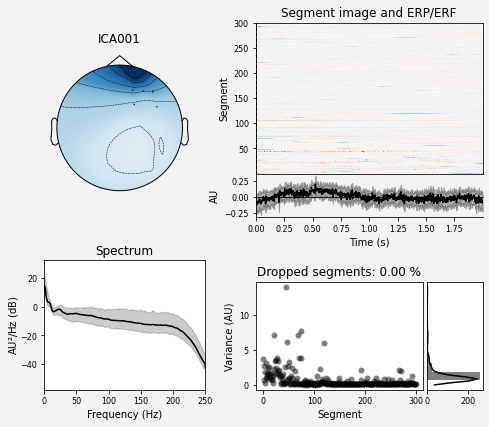

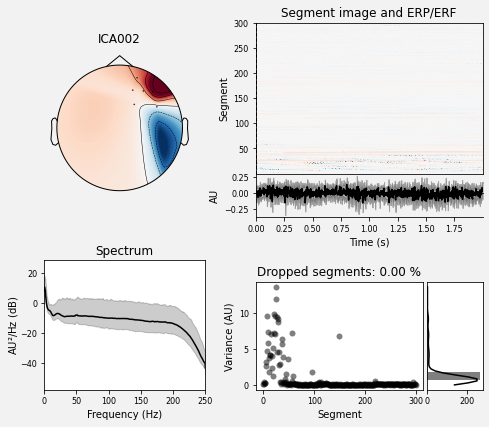

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw, picks=ica.exclude)
plt.show()

#### We can select different brain regions through the chart below:

#### For instance F4:

In [ ]:
# F4 = raw.pick_channels(['EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'])

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


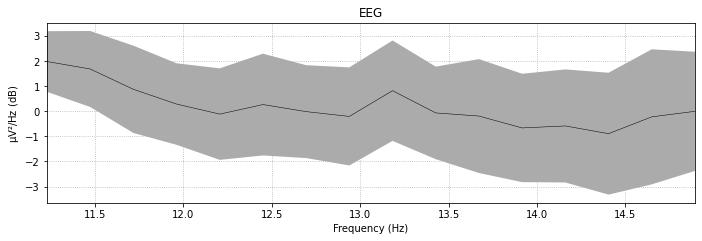

In [ ]:
# 5400 (90 minutes in seconds)

spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


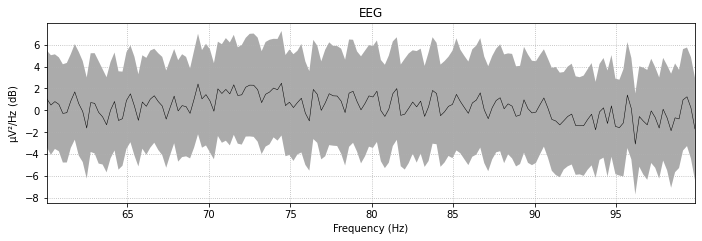

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


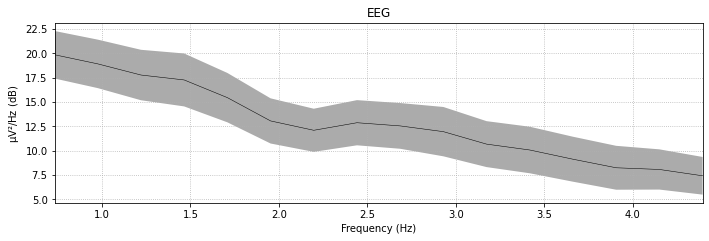

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


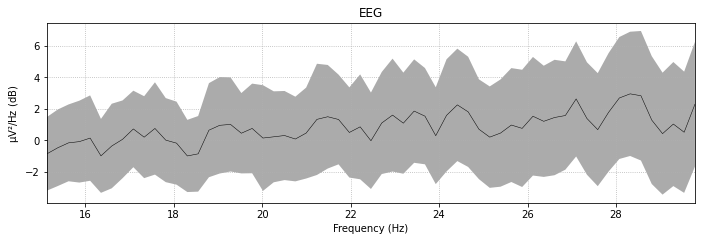

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=15, fmax=30, average = 'Median')
plt.show()

In [ ]:
# https://raphaelvallat.com/bandpower.html
# link above highlights what sensors are common for sleep analysis. which is Fz and Cz

psd, freqs = mne.time_frequency.psd_array_welch(raw.get_data(), sfreq=raw.info['sfreq'], n_fft=4096)

Effective window size : 8.192 (s)


In [ ]:
psd.shape

(6, 2049)

In [ ]:
freqs.shape

(2049,)

In [ ]:
# an_array = freqs
# repetitions = 6

# repeats_array = np.tile(an_array, (repetitions, 1))

# repeats_array.shape

In [ ]:
# an_array = [3,40] 
# repetitions = 6

# freq_range = np.tile(an_array, (repetitions, 1))
# freq_range.shape

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.2778, 0.4938                                         
                                                                                                  
                                       25 peaks were found:                                       
          

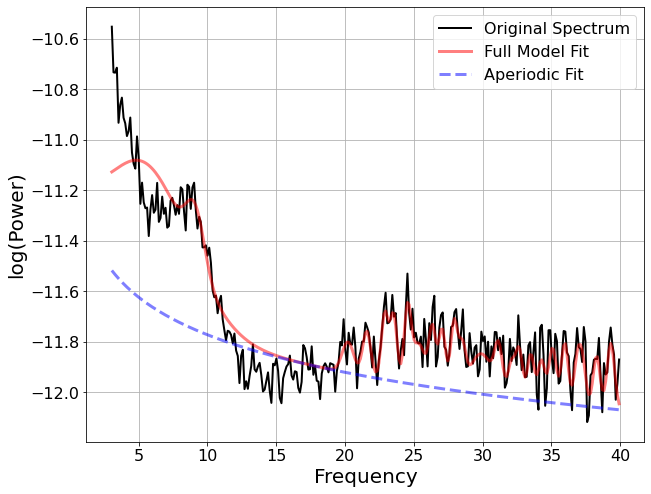

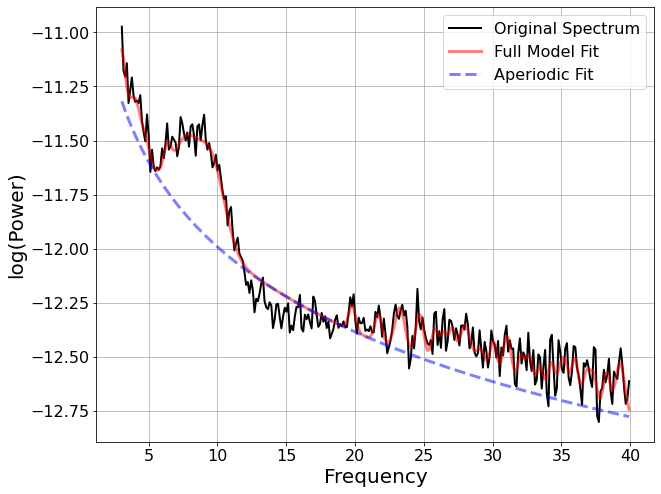

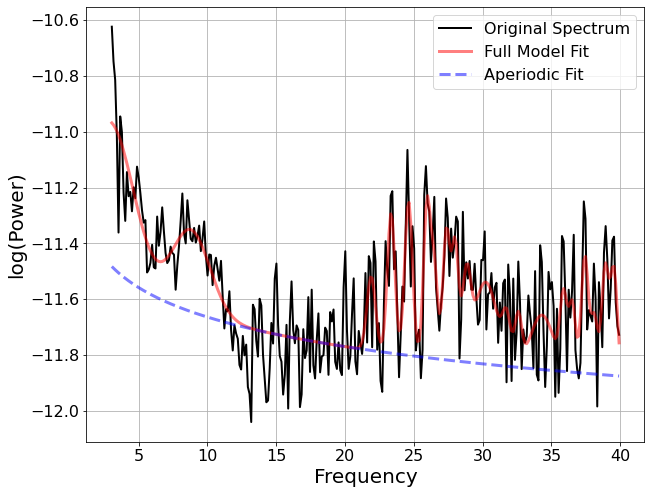

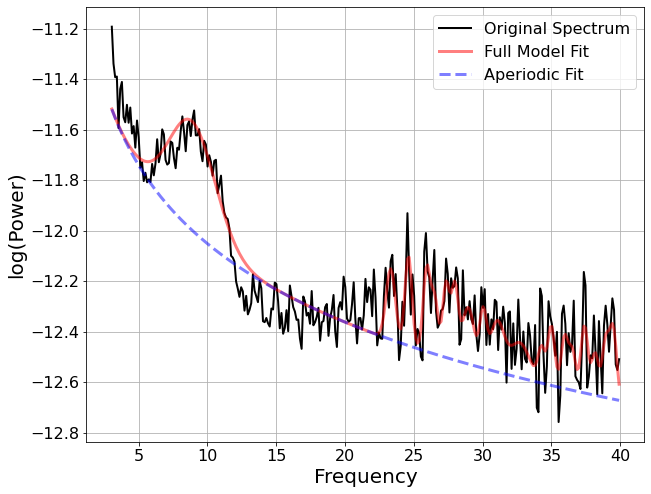

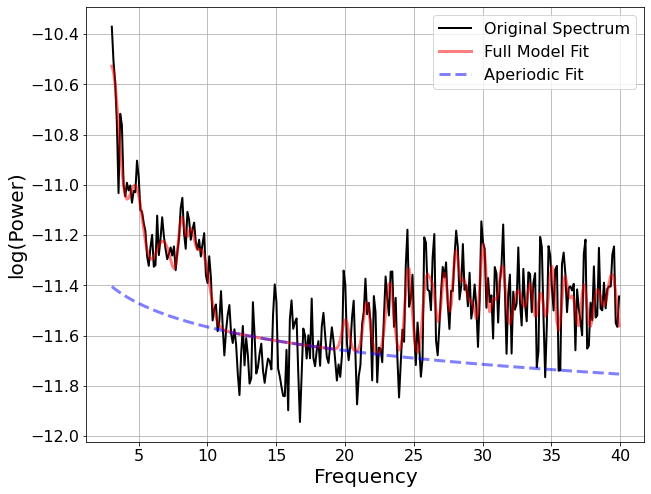

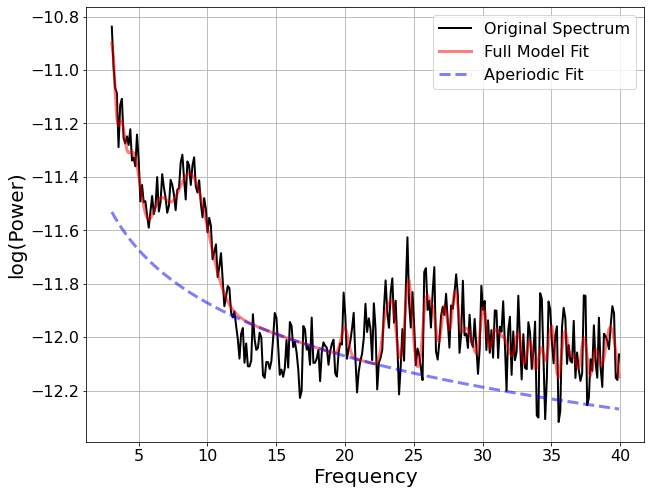

In [ ]:
EEG_3_fm = FOOOF()
EEG_4_fm = FOOOF()
EEG_117_fm = FOOOF()
EEG_118_fm = FOOOF()
EEG_123_fm = FOOOF()
EEG_124_fm = FOOOF()

# freq_range = [11,15] 
freq_range = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta


EEG_3 = EEG_3_fm.report(freqs, psd[0].flatten(), freq_range)
EEG_4 = EEG_4_fm.report(freqs, psd[1].flatten(), freq_range)
EEG_117 = EEG_117_fm.report(freqs, psd[2].flatten(), freq_range)
EEG_118 = EEG_118_fm.report(freqs, psd[3].flatten(), freq_range)
EEG_123 = EEG_123_fm.report(freqs, psd[4].flatten(), freq_range)
EEG_124 = EEG_124_fm.report(freqs, psd[5].flatten(), freq_range)

In [ ]:
Freqs_F4_Music = [EEG_3_fm.freqs,EEG_4_fm.freqs,EEG_117_fm.freqs,EEG_118_fm.freqs,EEG_123_fm.freqs,EEG_124_fm.freqs]
Power_Spectrum_F4_Music = [EEG_3_fm.power_spectrum,EEG_4_fm.power_spectrum,EEG_117_fm.power_spectrum,EEG_118_fm.power_spectrum,EEG_123_fm.power_spectrum,EEG_124_fm.power_spectrum]

In [ ]:
# Music_Spec_1 = plot_spectrum(Freqs_F4_Music[0], Power_Spectrum_F4_Music[0])
# Music_Spec_2 = plot_spectrum(Freqs_F4_Music[1], Power_Spectrum_F4_Music[1])
# Music_Spec_3 = plot_spectrum(Freqs_F4_Music[2], Power_Spectrum_F4_Music[2])
# Music_Spec_4 = plot_spectrum(Freqs_F4_Music[3], Power_Spectrum_F4_Music[3])
# Music_Spec_5 = plot_spectrum(Freqs_F4_Music[4], Power_Spectrum_F4_Music[4])
# Music_Spec_6 = plot_spectrum(Freqs_F4_Music[5], Power_Spectrum_F4_Music[5])

In [ ]:
Freq_Range_F4_Music = [EEG_3_fm.freq_range,EEG_4_fm.freq_range,EEG_117_fm.freq_range,EEG_118_fm.freq_range,EEG_123_fm.freq_range,EEG_124_fm.freq_range]
Aperiodic_Params_F4_Music = [list(EEG_3_fm.aperiodic_params_),list(EEG_4_fm.aperiodic_params_),list(EEG_117_fm.aperiodic_params_),list(EEG_118_fm.aperiodic_params_),list(EEG_123_fm.aperiodic_params_),list(EEG_124_fm.aperiodic_params_)]
Peak_Params_F4_Music = [EEG_3_fm.peak_params_.tolist(),EEG_4_fm.peak_params_.tolist(),EEG_117_fm.peak_params_.tolist(),EEG_118_fm.peak_params_.tolist(),EEG_123_fm.peak_params_.tolist(),EEG_124_fm.peak_params_.tolist()]

In [ ]:
freqs_1_1, powers_1_1 = gen_power_spectrum(Freq_Range_F4_Music[0], Aperiodic_Params_F4_Music[0], Peak_Params_F4_Music[0])
freqs_1_2, powers_1_2 = gen_power_spectrum(Freq_Range_F4_Music[1], Aperiodic_Params_F4_Music[1], Peak_Params_F4_Music[1])
freqs_1_3, powers_1_3 = gen_power_spectrum(Freq_Range_F4_Music[2], Aperiodic_Params_F4_Music[2], Peak_Params_F4_Music[2])
freqs_1_4, powers_1_4 = gen_power_spectrum(Freq_Range_F4_Music[3], Aperiodic_Params_F4_Music[3], Peak_Params_F4_Music[3])
freqs_1_5, powers_1_5 = gen_power_spectrum(Freq_Range_F4_Music[4], Aperiodic_Params_F4_Music[4], Peak_Params_F4_Music[4])
freqs_1_6, powers_1_6 = gen_power_spectrum(Freq_Range_F4_Music[5], Aperiodic_Params_F4_Music[5], Peak_Params_F4_Music[5])

# Music_p_1 = plot_spectrum(freqs_1_1, powers_1_1, log_powers=True)
# Music_p_2 = plot_spectrum(freqs_1_2, powers_1_2, log_powers=True)
# Music_p_3 = plot_spectrum(freqs_1_3, powers_1_3, log_powers=True)
# Music_p_4 = plot_spectrum(freqs_1_4, powers_1_4, log_powers=True)
# Music_p_5 = plot_spectrum(freqs_1_5, powers_1_5, log_powers=True)
# Music_p_6 = plot_spectrum(freqs_1_6, powers_1_6, log_powers=True)

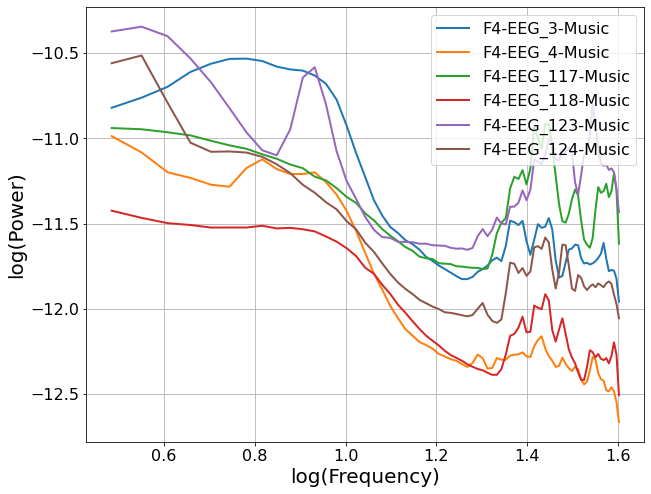

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['F4-EEG_3-Music', 'F4-EEG_4-Music', 'F4-EEG_117-Music', 'F4-EEG_118-Music', 'F4-EEG_123-Music', 'F4-EEG_124-Music']#'F4-TextAudio'

plot_spectra(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

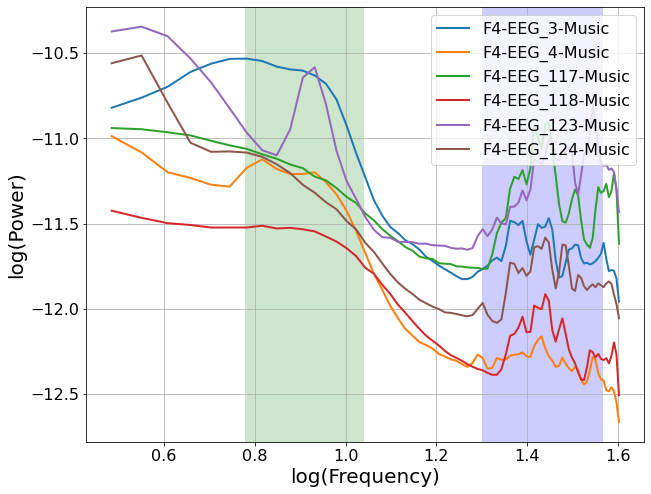

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['F4-EEG_3-Music', 'F4-EEG_4-Music', 'F4-EEG_117-Music', 'F4-EEG_118-Music', 'F4-EEG_123-Music', 'F4-EEG_124-Music']
plot_spectra_shading(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], [[6, 11], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting slow wave activity (music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -9.9811, 1.5866                                          
                                                                                                  
                                       3 peaks were found:                                        
          

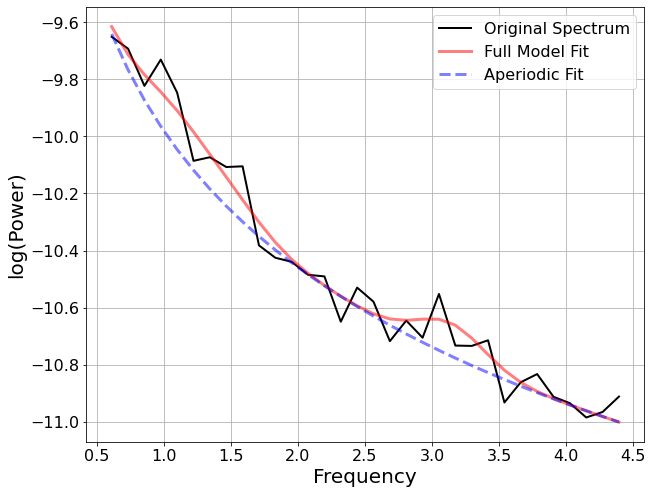

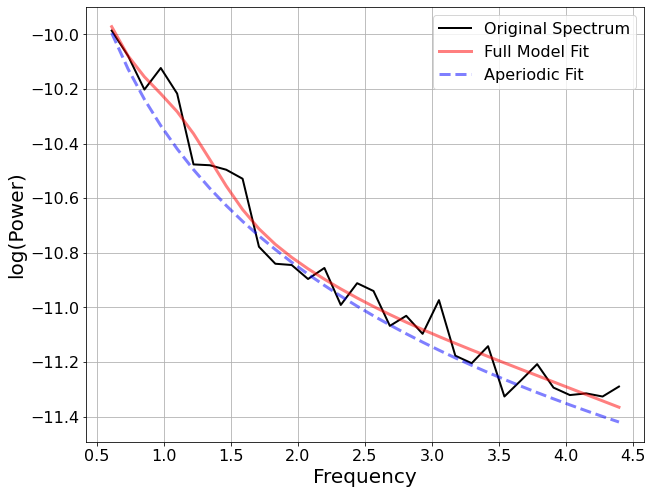

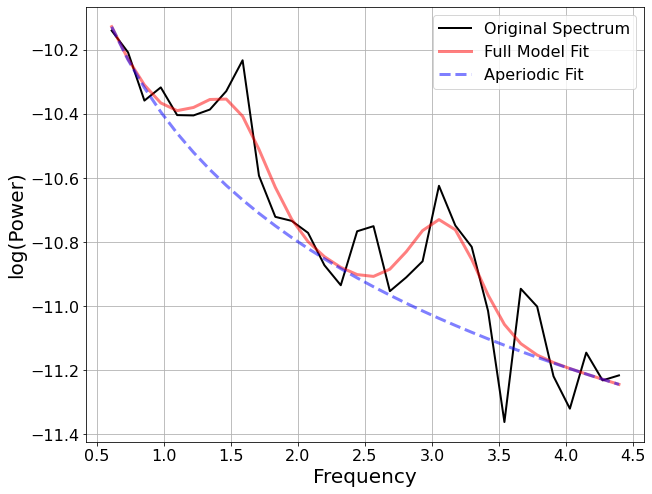

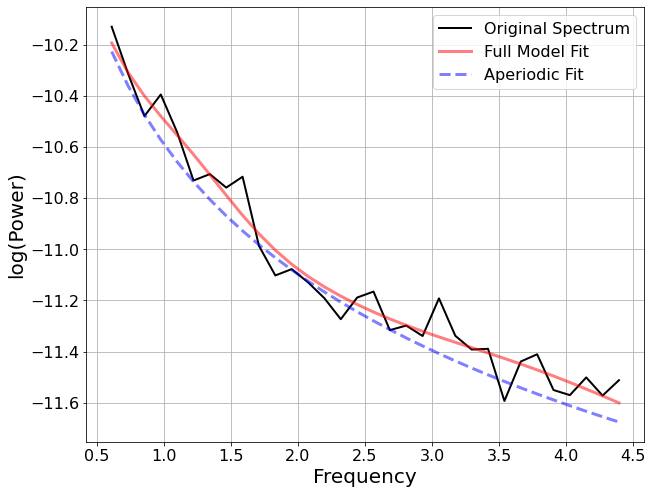

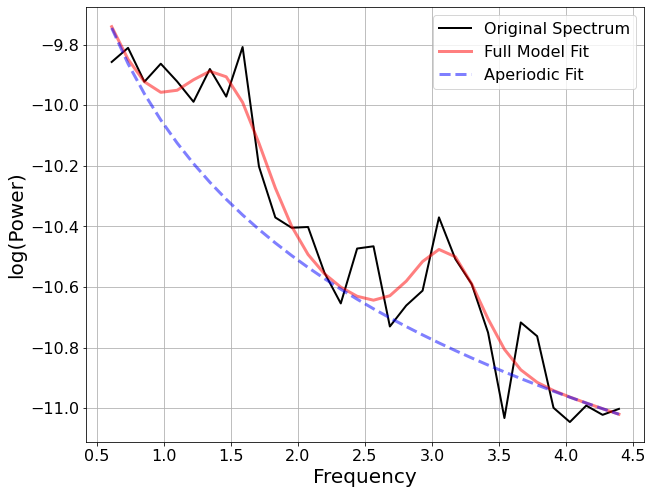

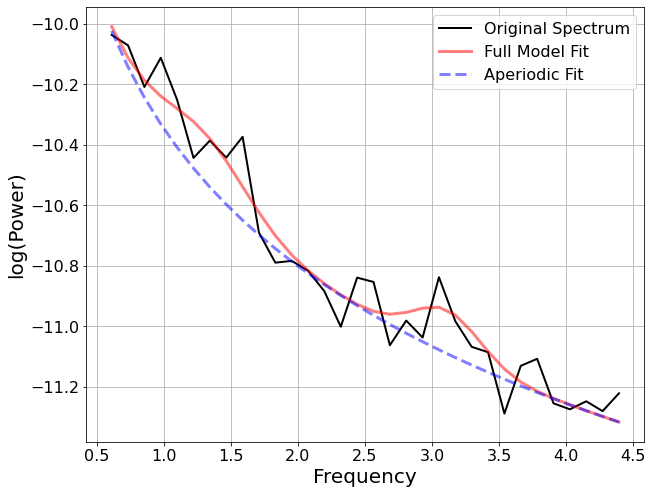

In [ ]:
#'EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'
EEG_3_fm_mus_sw = FOOOF()
EEG_4_fm_mus_sw = FOOOF()
EEG_117_fm_mus_sw = FOOOF()
EEG_118_fm_mus_sw = FOOOF()
EEG_123_fm_mus_sw = FOOOF()
EEG_124_fm_mus_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta

#'EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'
EEG_3_mus_sw = EEG_3_fm_mus_sw.report(freqs, psd[0].flatten(), freq_range)
EEG_4_mus_sw = EEG_4_fm_mus_sw.report(freqs, psd[1].flatten(), freq_range)
EEG_117_mus_sw = EEG_117_fm_mus_sw.report(freqs, psd[2].flatten(), freq_range)
EEG_118_mus_sw = EEG_118_fm_mus_sw.report(freqs, psd[3].flatten(), freq_range)
EEG_123_mus_sw = EEG_123_fm_mus_sw.report(freqs, psd[4].flatten(), freq_range)
EEG_124_mus_sw = EEG_124_fm_mus_sw.report(freqs, psd[5].flatten(), freq_range)

Extracting beta activity (music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                        -12.3470, -0.3436                                         
                                                                                                  
                                       9 peaks were found:                                        
          

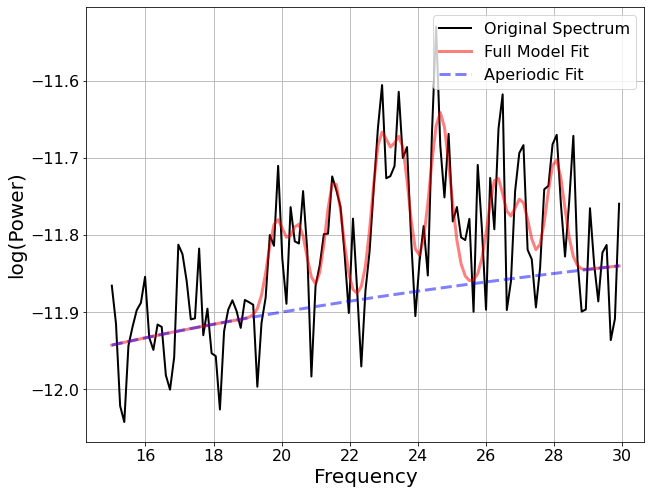

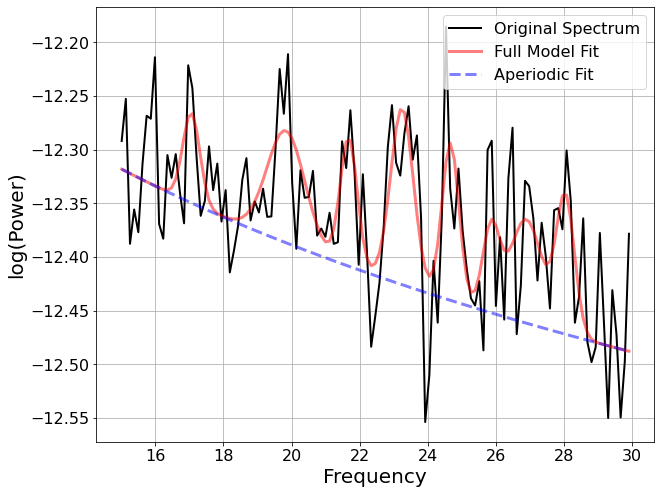

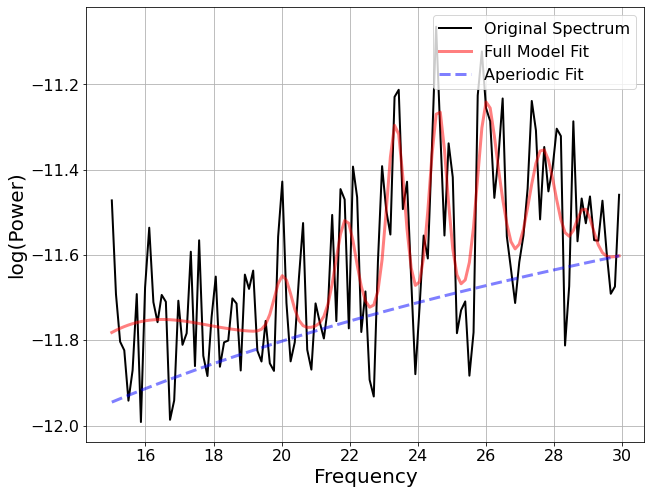

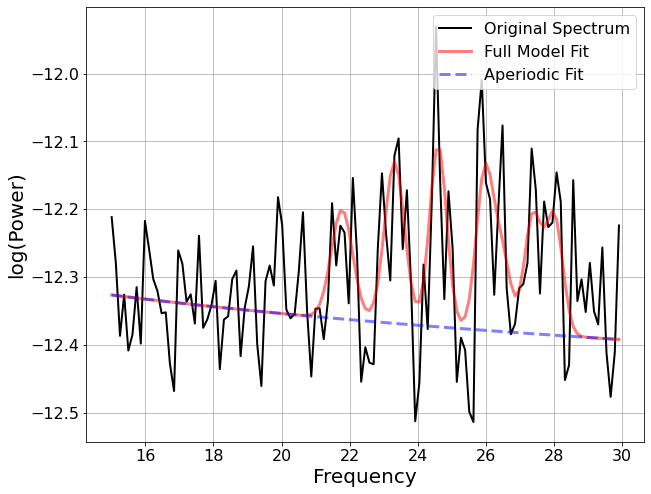

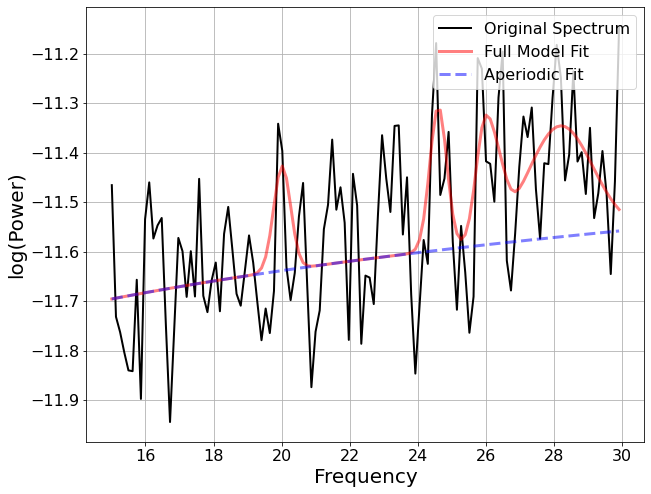

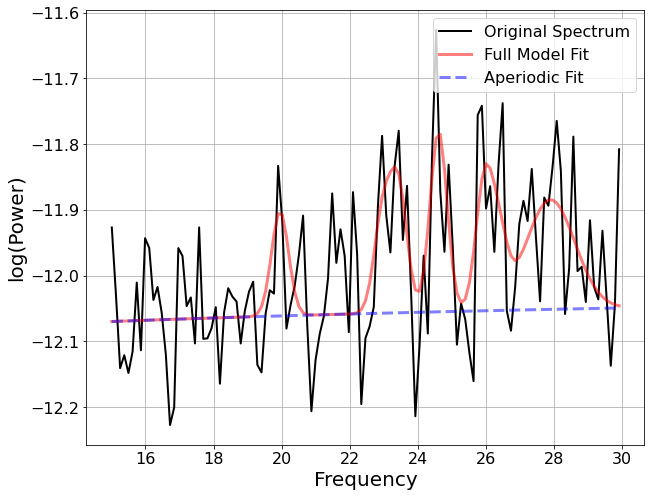

In [ ]:
#'EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'
EEG_3_fm_mus_b = FOOOF()
EEG_4_fm_mus_b = FOOOF()
EEG_117_fm_mus_b = FOOOF()
EEG_118_fm_mus_b = FOOOF()
EEG_123_fm_mus_b = FOOOF()
EEG_124_fm_mus_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


# 'EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'
EEG_3_mus_b = EEG_3_fm_mus_b.report(freqs, psd[0].flatten(), freq_range)
EEG_4_mus_b = EEG_4_fm_mus_b.report(freqs, psd[1].flatten(), freq_range)
EEG_117_mus_b = EEG_117_fm_mus_b.report(freqs, psd[2].flatten(), freq_range)
EEG_118_mus_b = EEG_118_fm_mus_b.report(freqs, psd[3].flatten(), freq_range)
EEG_123_mus_b = EEG_123_fm_mus_b.report(freqs, psd[4].flatten(), freq_range)
EEG_124_mus_b = EEG_124_fm_mus_b.report(freqs, psd[5].flatten(), freq_range)

SW/beta ratios

In [ ]:
#'EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'
EEG_3_mus_ratio = sum(EEG_3_fm_mus_sw.power_spectrum) / sum(EEG_3_fm_mus_b.power_spectrum)
EEG_4_mus_ratio = sum(EEG_4_fm_mus_sw.power_spectrum) / sum(EEG_4_fm_mus_b.power_spectrum)
EEG_117_mus_ratio = sum(EEG_117_fm_mus_sw.power_spectrum) / sum(EEG_117_fm_mus_b.power_spectrum)
EEG_118_mus_ratio = sum(EEG_118_fm_mus_sw.power_spectrum) / sum(EEG_118_fm_mus_b.power_spectrum)
EEG_123_mus_ratio = sum(EEG_123_fm_mus_sw.power_spectrum) / sum(EEG_123_fm_mus_b.power_spectrum)
EEG_124_mus_ratio = sum(EEG_124_fm_mus_sw.power_spectrum) / sum(EEG_124_fm_mus_b.power_spectrum)

#### SW/Beta Analysis (Text Condition)

In [ ]:
raw2 = mne.io.read_raw_edf('msm_p03_t3.edf') 
raw2.crop(tmin = 339, tmax = 939)
raw2.pick_channels(['EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'])

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t3.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
channel_renaming_dict = {'EEG 3': 'AF4', 'EEG 4': 'F2', 'EEG 117': 'FC6', 'EEG 118': 'FC2', 'EEG 123': 'F6', 'EEG 124': 'F4'}

raw2.rename_channels(channel_renaming_dict)  # happens in-place

raw2.ch_names

['AF4', 'F2', 'FC6', 'FC2', 'F6', 'F4']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw2.set_montage(montage)

<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~16 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-36-1f682e7cb6ee>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw2)


Selecting by number: 6 components
Fitting ICA took 2.8s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


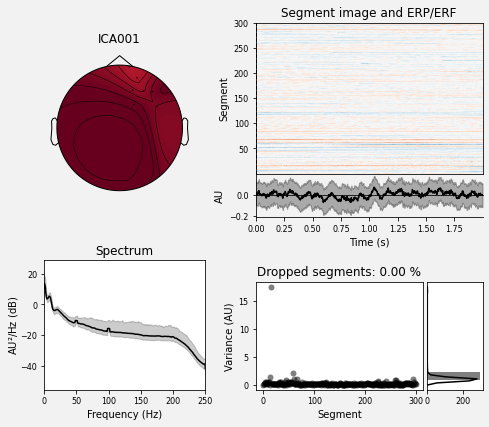

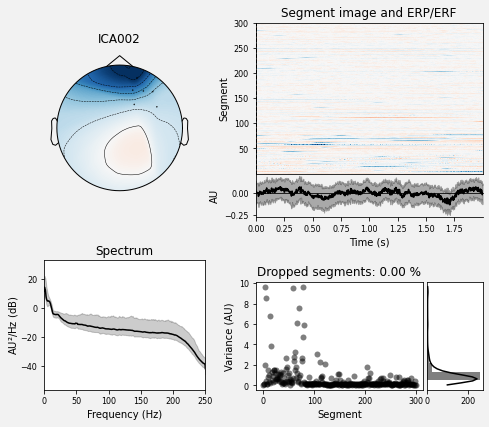

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw2)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw2, picks=ica.exclude)
plt.show()

In [ ]:
# for ann in raw2.annotations:
#     descr = ann['description']
#     start = ann['onset']
#     # end = ann['onset'] + ann['duration']
#     print(f"'{descr}' starts at {start}")

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


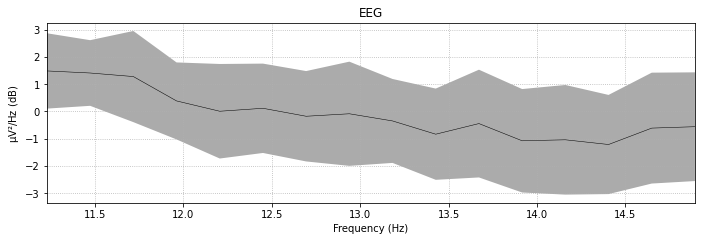

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


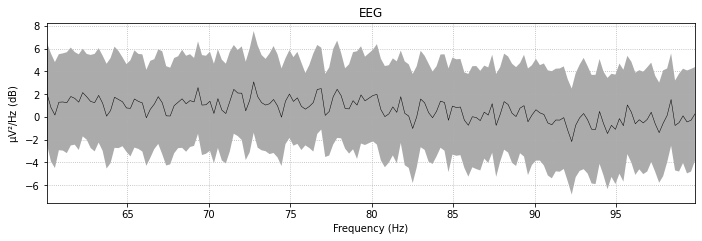

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


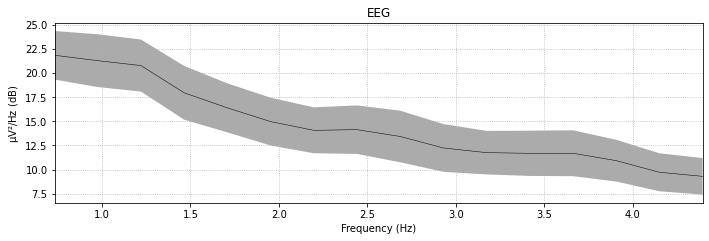

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


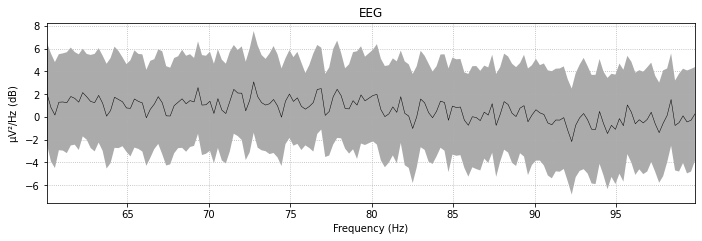

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

In [ ]:
psd2, freqs2 = mne.time_frequency.psd_array_welch(raw2.get_data(), sfreq=raw2.info['sfreq'], n_fft=4096)
psd2.shape,freqs2.shape

Effective window size : 8.192 (s)


((6, 2049), (2049,))

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.8526, 0.9217                                         
                                                                                                  
                                       8 peaks were found:                                        
          

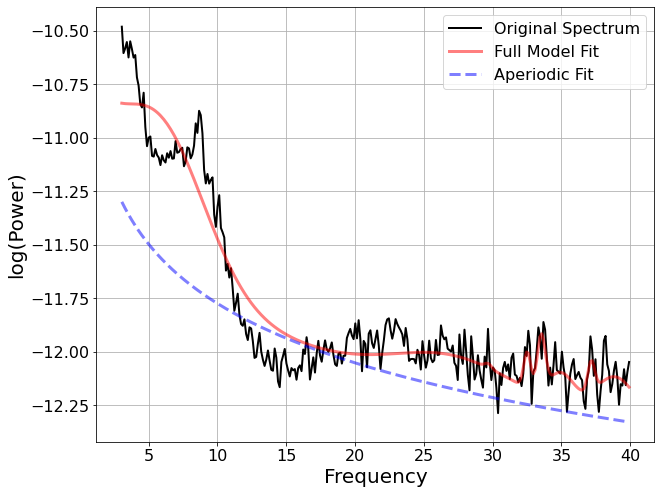

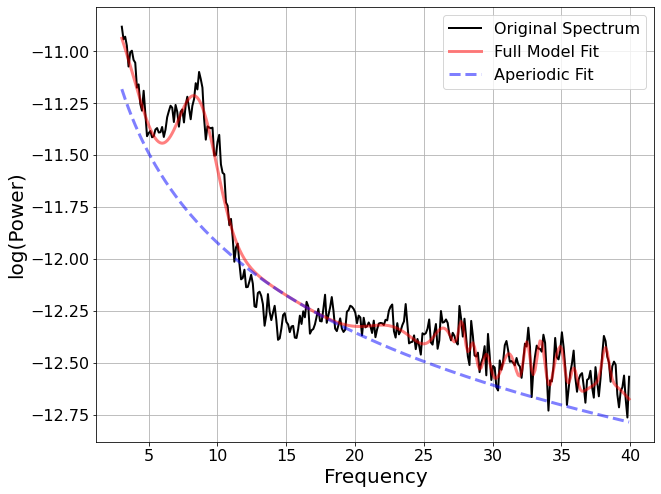

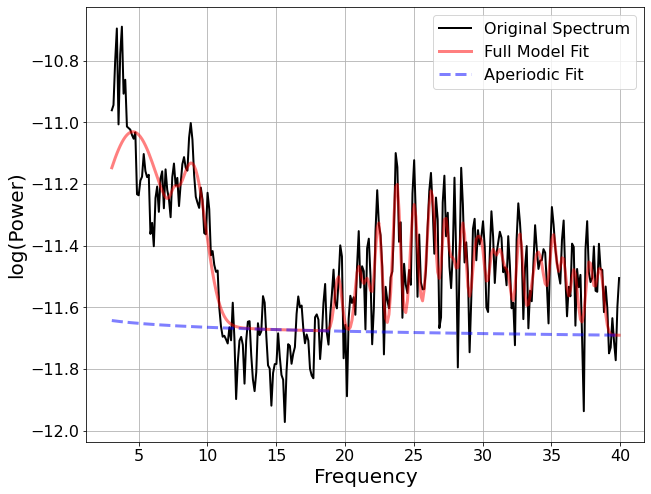

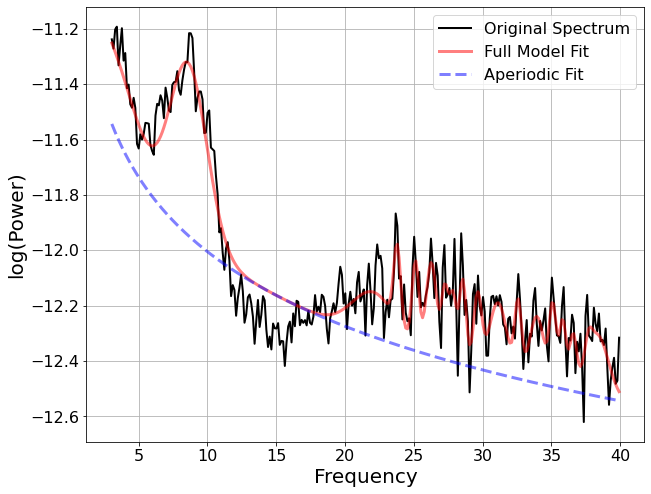

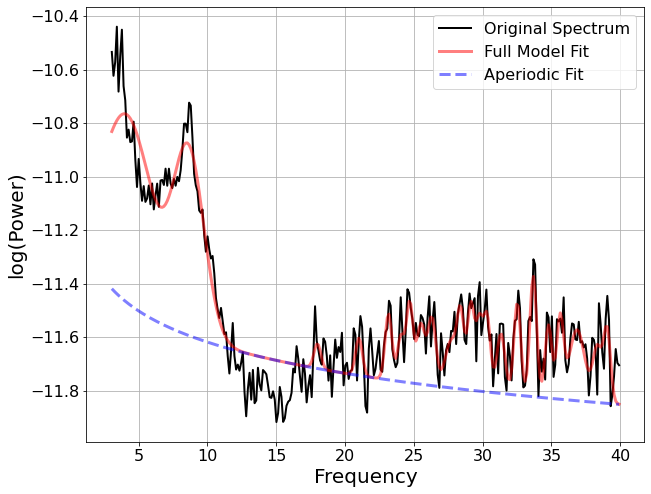

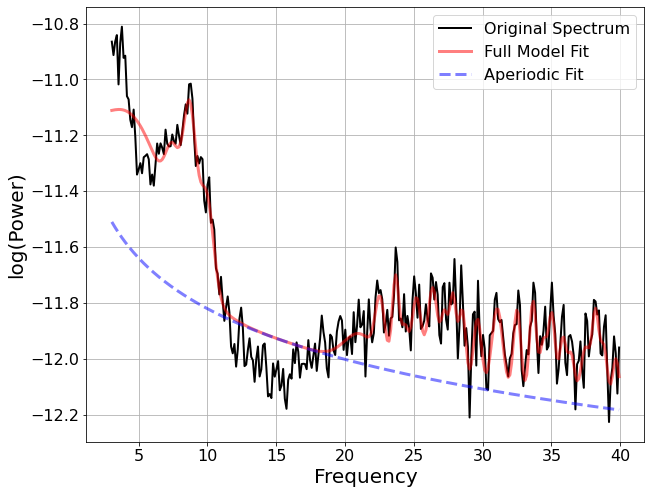

In [ ]:
EEG_3_fm2 = FOOOF()
EEG_4_fm2 = FOOOF()
EEG_117_fm2 = FOOOF()
EEG_118_fm2 = FOOOF()
EEG_123_fm2 = FOOOF()
EEG_124_fm2 = FOOOF()

# freq_range = [11,15] 
freq_range2 = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta

# 'EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'
EEG_3 = EEG_3_fm2.report(freqs2, psd2[0].flatten(), freq_range2)
EEG_4 = EEG_4_fm2.report(freqs2, psd2[1].flatten(), freq_range2)
EEG_117 = EEG_117_fm2.report(freqs2, psd2[2].flatten(), freq_range2)
EEG_118 = EEG_118_fm2.report(freqs2, psd2[3].flatten(), freq_range2)
EEG_123 = EEG_123_fm2.report(freqs2, psd2[4].flatten(), freq_range2)
EEG_124 = EEG_124_fm2.report(freqs2, psd2[5].flatten(), freq_range2)

In [ ]:
Freqs_F4_text = [EEG_3_fm2.freqs,EEG_4_fm2.freqs,EEG_117_fm2.freqs,EEG_118_fm2.freqs,EEG_123_fm2.freqs,EEG_124_fm2.freqs]
Power_Spectrum_F4_Text = [EEG_3_fm2.power_spectrum,EEG_4_fm2.power_spectrum,EEG_117_fm2.power_spectrum,EEG_118_fm2.power_spectrum,EEG_123_fm2.power_spectrum,EEG_124_fm2.power_spectrum]

In [ ]:
# Text_Spec_1 = plot_spectrum(Freqs_F4_text[0], Power_Spectrum_F4_Text[0])
# Text_Spec_2 = plot_spectrum(Freqs_F4_text[1], Power_Spectrum_F4_Text[1])
# Text_Spec_3 = plot_spectrum(Freqs_F4_text[2], Power_Spectrum_F4_Text[2])
# Text_Spec_4 = plot_spectrum(Freqs_F4_text[3], Power_Spectrum_F4_Text[3])
# Text_Spec_5 = plot_spectrum(Freqs_F4_text[4], Power_Spectrum_F4_Text[4])
# Text_Spec_6 = plot_spectrum(Freqs_F4_text[5], Power_Spectrum_F4_Text[5])

In [ ]:
# spec_2 = plot_spectrum(fm2.freqs, fm2.power_spectrum)
# plt.show()

In [ ]:
Freq_Range_F4_Text = [EEG_3_fm2.freq_range,EEG_4_fm2.freq_range,EEG_117_fm2.freq_range,EEG_118_fm2.freq_range,EEG_123_fm2.freq_range,EEG_124_fm2.freq_range]
Aperiodic_Params_F4_Text = [list(EEG_3_fm2.aperiodic_params_),list(EEG_4_fm2.aperiodic_params_),list(EEG_117_fm2.aperiodic_params_),list(EEG_118_fm2.aperiodic_params_),list(EEG_123_fm2.aperiodic_params_),list(EEG_124_fm2.aperiodic_params_)]
Peak_Params_F4_Text = [EEG_3_fm2.peak_params_.tolist(),EEG_4_fm2.peak_params_.tolist(),EEG_117_fm2.peak_params_.tolist(),EEG_118_fm2.peak_params_.tolist(),EEG_123_fm2.peak_params_.tolist(),EEG_124_fm2.peak_params_.tolist()]

In [ ]:
freqs_2_1, powers_2_1 = gen_power_spectrum(Freq_Range_F4_Text[0], Aperiodic_Params_F4_Text[0], Peak_Params_F4_Text[0])
freqs_2_2, powers_2_2 = gen_power_spectrum(Freq_Range_F4_Text[1], Aperiodic_Params_F4_Text[1], Peak_Params_F4_Text[1])
freqs_2_3, powers_2_3 = gen_power_spectrum(Freq_Range_F4_Text[2], Aperiodic_Params_F4_Text[2], Peak_Params_F4_Text[2])
freqs_2_4, powers_2_4 = gen_power_spectrum(Freq_Range_F4_Text[3], Aperiodic_Params_F4_Text[3], Peak_Params_F4_Text[3])
freqs_2_5, powers_2_5 = gen_power_spectrum(Freq_Range_F4_Text[4], Aperiodic_Params_F4_Text[4], Peak_Params_F4_Text[4])
freqs_2_6, powers_2_6 = gen_power_spectrum(Freq_Range_F4_Text[5], Aperiodic_Params_F4_Text[5], Peak_Params_F4_Text[5])

# Text_p_1 = plot_spectrum(freqs_2_1, powers_2_1, log_powers=True)
# Text_p_2 = plot_spectrum(freqs_2_2, powers_2_2, log_powers=True)
# Text_p_3 = plot_spectrum(freqs_2_3, powers_2_3, log_powers=True)
# Text_p_4 = plot_spectrum(freqs_2_4, powers_2_4, log_powers=True)
# Text_p_5 = plot_spectrum(freqs_2_5, powers_2_5, log_powers=True)
# Text_p_6 = plot_spectrum(freqs_2_6, powers_2_6, log_powers=True)

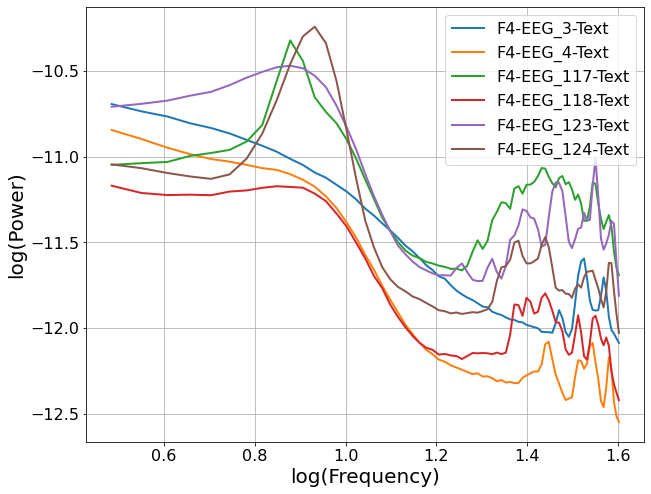

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels

labels = ['F4-EEG_3-Text', 'F4-EEG_4-Text', 'F4-EEG_117-Text', 'F4-EEG_118-Text', 'F4-EEG_123-Text', 'F4-EEG_124-Text']#'F4-TextAudio'

plot_spectra(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

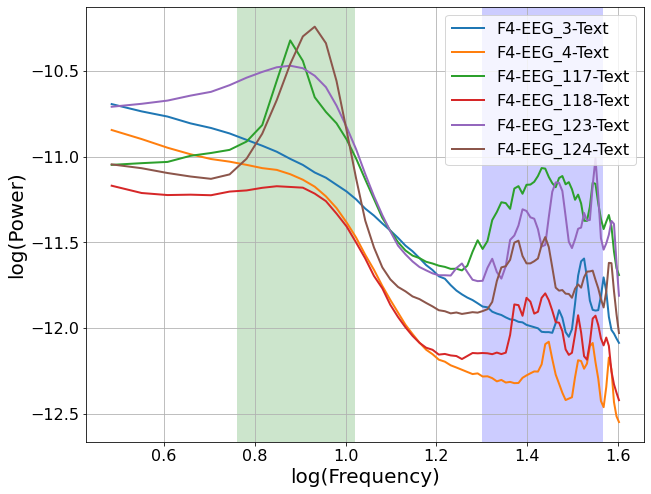

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['F4-EEG_3-Text', 'F4-EEG_4-Text', 'F4-EEG_117-Text', 'F4-EEG_118-Text', 'F4-EEG_123-Text', 'F4-EEG_124-Text']
plot_spectra_shading(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], [[5.75, 10.5], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting slow wave activity (text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -9.7576, 1.5214                                          
                                                                                                  
                                       1 peaks were found:                                        
          

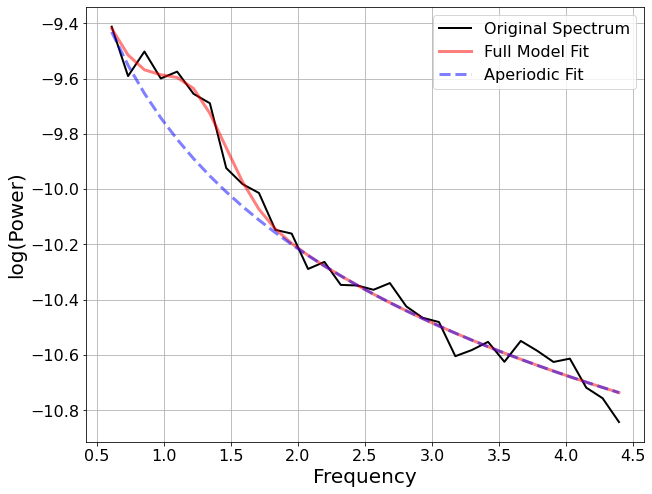

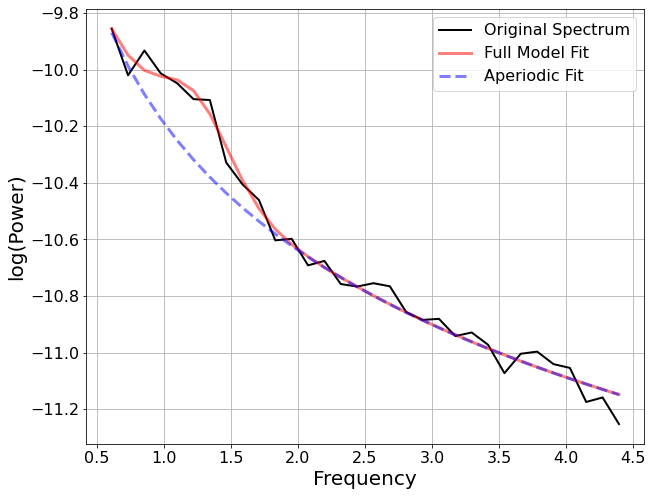

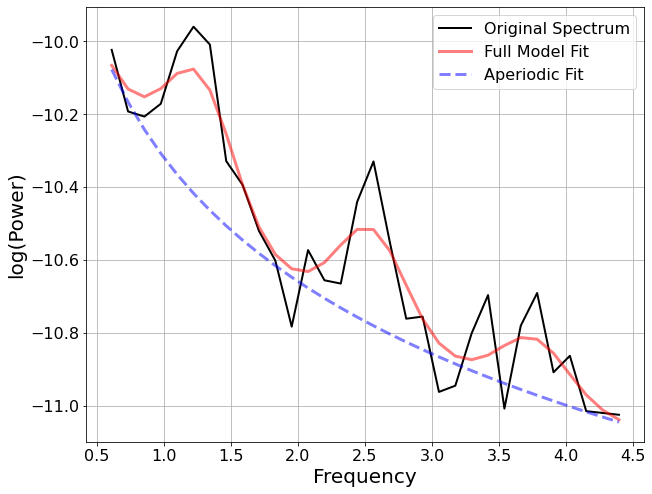

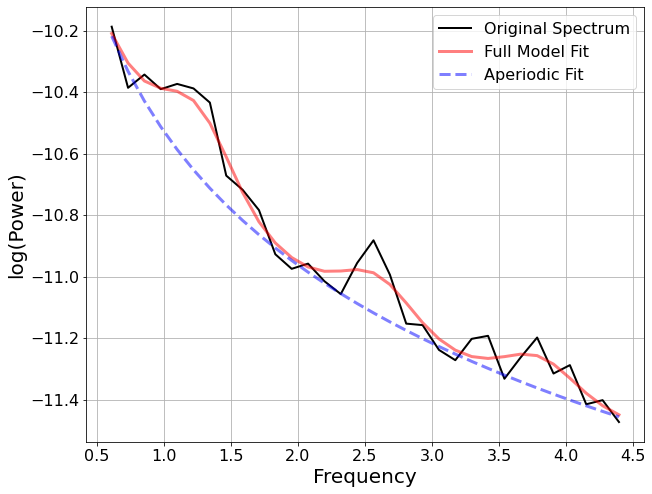

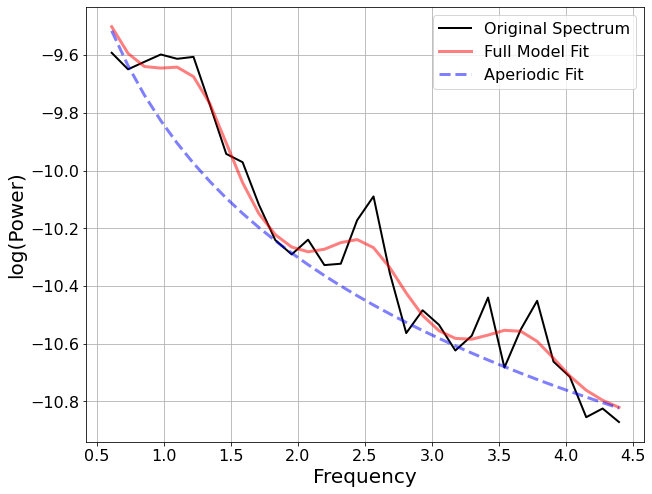

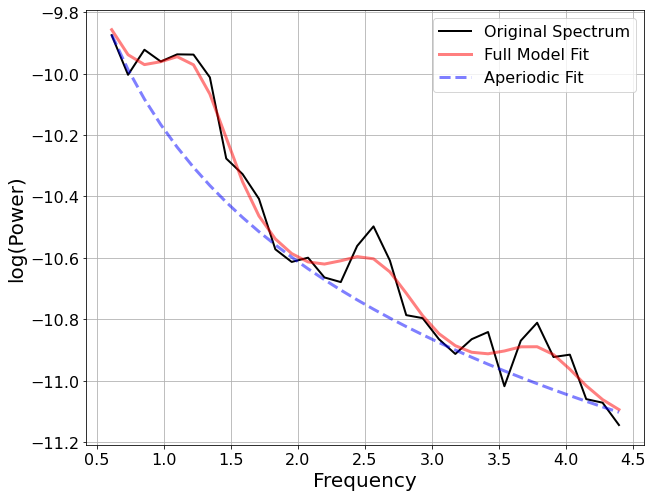

In [ ]:
# 'EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'
EEG_3_fm_text_sw = FOOOF()
EEG_4_fm_text_sw = FOOOF()
EEG_117_fm_text_sw = FOOOF()
EEG_118_fm_text_sw = FOOOF()
EEG_123_fm_text_sw = FOOOF()
EEG_124_fm_text_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'
EEG_3_text_sw = EEG_3_fm_text_sw.report(freqs, psd2[0].flatten(), freq_range)
EEG_4_text_sw = EEG_4_fm_text_sw.report(freqs, psd2[1].flatten(), freq_range)
EEG_117_text_sw = EEG_117_fm_text_sw.report(freqs, psd2[2].flatten(), freq_range)
EEG_118_text_sw = EEG_118_fm_text_sw.report(freqs, psd2[3].flatten(), freq_range)
EEG_123_text_sw = EEG_123_fm_text_sw.report(freqs, psd2[4].flatten(), freq_range)
EEG_124_text_sw = EEG_124_fm_text_sw.report(freqs, psd2[5].flatten(), freq_range)

Extracting beta activity (text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.9498, 0.0767                                         
                                                                                                  
                                       7 peaks were found:                                        
          

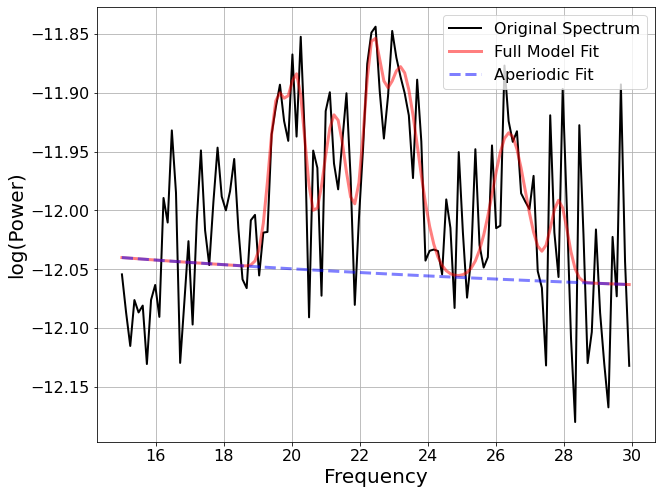

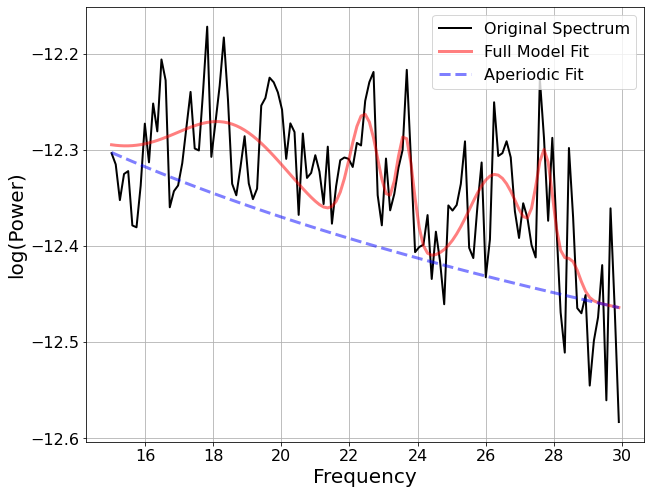

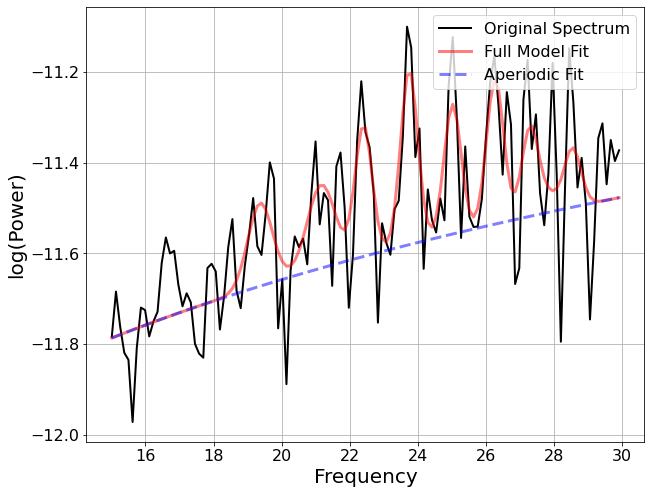

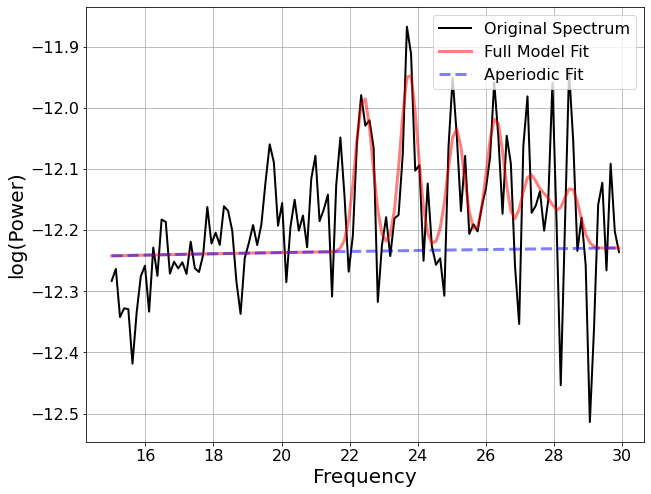

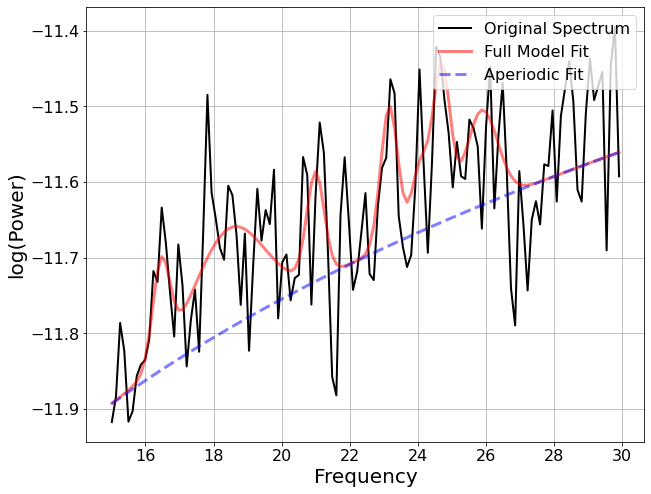

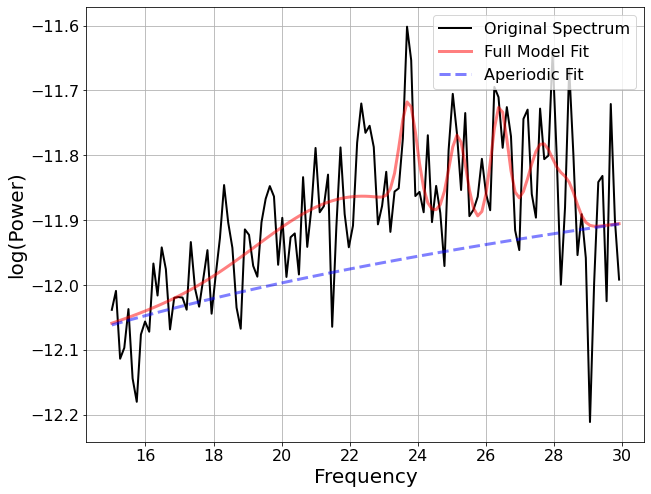

In [ ]:
# 'EEG 3', 'EEG 4', 'EEG 117', 'EEG 118', 'EEG 123', 'EEG 124'
EEG_3_fm_text_b = FOOOF()
EEG_4_fm_text_b = FOOOF()
EEG_117_fm_text_b = FOOOF()
EEG_118_fm_text_b = FOOOF()
EEG_123_fm_text_b = FOOOF()
EEG_124_fm_text_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


EEG_3_text_b = EEG_3_fm_text_b.report(freqs, psd2[0].flatten(), freq_range)
EEG_4_text_b = EEG_4_fm_text_b.report(freqs, psd2[1].flatten(), freq_range)
EEG_117_text_b = EEG_117_fm_text_b.report(freqs, psd2[2].flatten(), freq_range)
EEG_118_text_b = EEG_118_fm_text_b.report(freqs, psd2[3].flatten(), freq_range)
EEG_123_text_b = EEG_123_fm_text_b.report(freqs, psd2[4].flatten(), freq_range)
EEG_124_text_b = EEG_124_fm_text_b.report(freqs, psd2[5].flatten(), freq_range)

SW/beta ratios

In [ ]:
EEG_3_text_ratio = sum(EEG_3_fm_text_sw.power_spectrum) / sum(EEG_3_fm_text_b.power_spectrum)
EEG_4_text_ratio = sum(EEG_4_fm_text_sw.power_spectrum) / sum(EEG_4_fm_text_b.power_spectrum)
EEG_117_text_ratio = sum(EEG_117_fm_text_sw.power_spectrum) / sum(EEG_117_fm_text_b.power_spectrum)
EEG_118_text_ratio = sum(EEG_118_fm_text_sw.power_spectrum) / sum(EEG_118_fm_text_b.power_spectrum)
EEG_123_text_ratio = sum(EEG_123_fm_text_sw.power_spectrum) / sum(EEG_123_fm_text_b.power_spectrum)
EEG_124_text_ratio = sum(EEG_124_fm_text_sw.power_spectrum) / sum(EEG_124_fm_text_b.power_spectrum)

Comparison

In [ ]:
mus_ratios = [EEG_3_mus_ratio, EEG_4_mus_ratio, EEG_117_mus_ratio, EEG_118_mus_ratio, EEG_123_mus_ratio, EEG_124_mus_ratio]
text_ratios = [EEG_3_text_ratio, EEG_4_text_ratio, EEG_117_text_ratio, EEG_118_text_ratio, EEG_123_text_ratio, EEG_124_text_ratio]
difference = np.array(mus_ratios) - np.array(text_ratios)

In [ ]:
results = pd.DataFrame([mus_ratios, text_ratios, difference], index = ['Music', 'Text', 'Difference'], columns = [3, 4, 117, 118, 123, 124])
results = results.style.set_table_attributes("style='display:inline'").set_caption('F4 Slow Wave/Beta Activity')
results

,3,4,117,118,123,124
Music,0.230475,0.228656,0.240935,0.234787,0.235346,0.234426
Text,0.221986,0.224816,0.238947,0.233797,0.229256,0.231204
Difference,0.008489,0.003840,0.001988,0.000990,0.006091,0.003221


### Comparing all C3 readings between music and text audio for subject 3


In [ ]:
from IPython import display
display.Image("eeg_placement.png")

In [ ]:
raw = mne.io.read_raw_edf('msm_p03_t2.edf',preload=False) # subject 3, control text run. index 2 in the dataframe in sleep_music_data_notes.ipynb
raw.crop(tmin = 345, tmax = 945) 
raw.pick_channels(['EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'])
# raw.filter(l_freq=.5,h_freq=30)
# DURATION ON TABLE IS 10 MINUTES FOR N1_MIN_TEXT (90,690). 
# or start time for N1 to N2 when interpreting min as stage start time (600,960) 6 minutes
# tmin = 224, tmax = 824, eyes closed to ten minutes after
# tmin = 345, tmax = 945, eyes closed_2 to ten minutes after

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t2.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
# IGNORE THIS
# ch_types = ['eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eog','eog']
# ch_names = ['FP1','FP2','F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'FZ', 'CZ', 'PZ', 'OZ', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'FT9', 'FT10', 'TP9', 'TP10', 'F1', 'F2', 'C1', 'C2', 'P1', 'P2', 'AF3', 'AF4', 'FC3', 'FC4', 'CP3', 'CP4', 'PO3', 'PO4', 'F5', 'F6', 'C5', 'C6', 'P5', 'P6', 'AF7', 'AF8', 'FT7', 'FT8', 'TP7', 'TP8', 'PO7', 'PO8', 'FPZ', 'FCZ', 'CPZ', 'POZ', 'VEOG', 'HEOG']

In [ ]:
# eegbci.standardize(raw)

# channel_renaming_dict = {name: name.replace(' 0', '') for name in raw.ch_names}
channel_renaming_dict = {'EEG 30':'C1', 'EEG 35':'FC5', 'EEG 36':'C3', 'EEG 37':'CP1', 'EEG 41':'C5', 'EEG 42':'CP3'}

raw.rename_channels(channel_renaming_dict)  # happens in-place

raw.ch_names

['C1', 'FC5', 'C3', 'CP1', 'C5', 'CP3']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw.set_montage(montage)

<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~16 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-11-15bd986f335b>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw)


Selecting by number: 6 components
Fitting ICA took 5.2s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


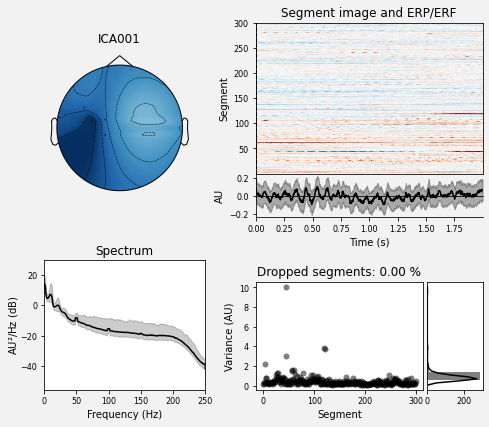

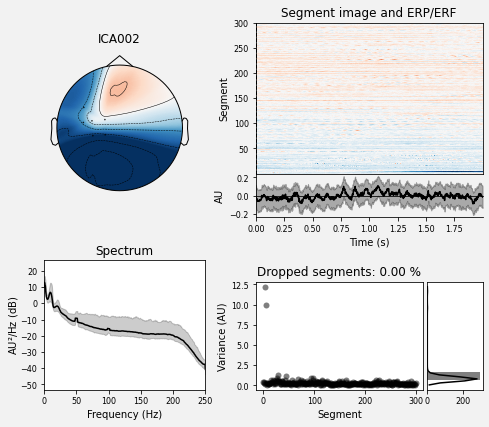

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw, picks=ica.exclude)
plt.show()

#### We can select different brain regions through the chart below:

#### For instance C3:

In [ ]:
# C3 = raw.pick_channels(['EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'])

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


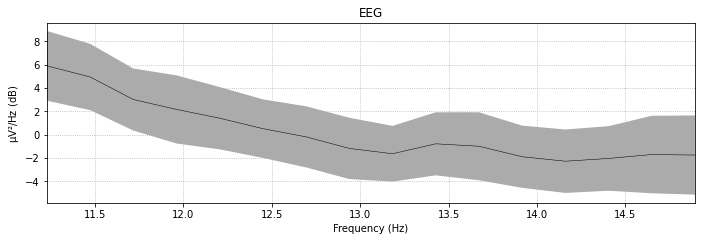

In [ ]:
# 5400 (90 minutes in seconds)

spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


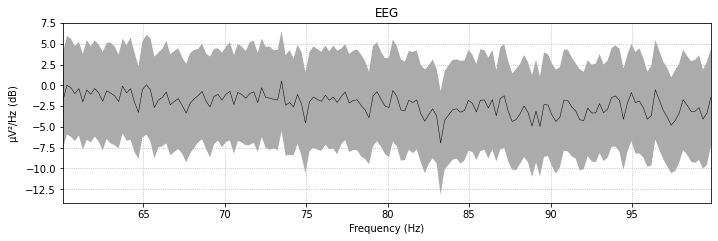

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


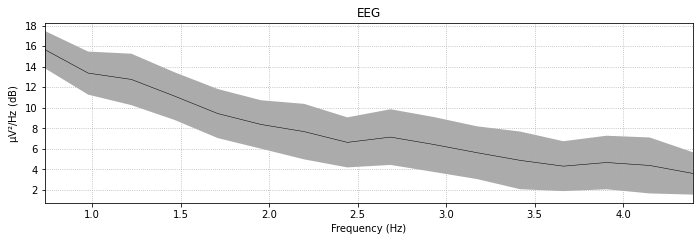

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


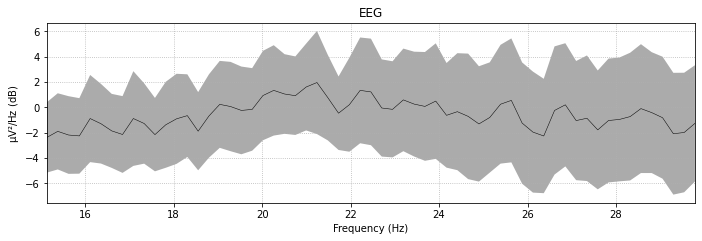

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=15, fmax=30, average = 'Median')
plt.show()

In [ ]:
# https://raphaelvallat.com/bandpower.html
# link above highlights what sensors are common for sleep analysis. which is Fz and Cz

psd, freqs = mne.time_frequency.psd_array_welch(raw.get_data(), sfreq=raw.info['sfreq'], n_fft=4096)

Effective window size : 8.192 (s)


In [ ]:
psd.shape

(6, 2049)

In [ ]:
freqs.shape

(2049,)

In [ ]:
# an_array = freqs
# repetitions = 6

# repeats_array = np.tile(an_array, (repetitions, 1))

# repeats_array.shape

In [ ]:
# an_array = [3,40] 
# repetitions = 6

# freq_range = np.tile(an_array, (repetitions, 1))
# freq_range.shape

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.2309, 1.1062                                         
                                                                                                  
                                       23 peaks were found:                                       
          

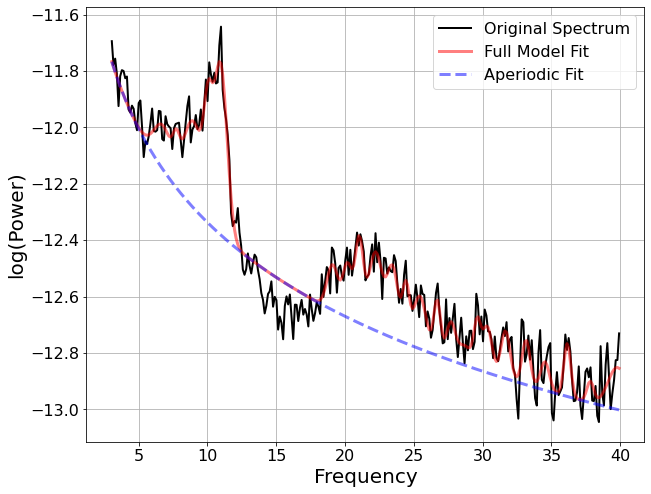

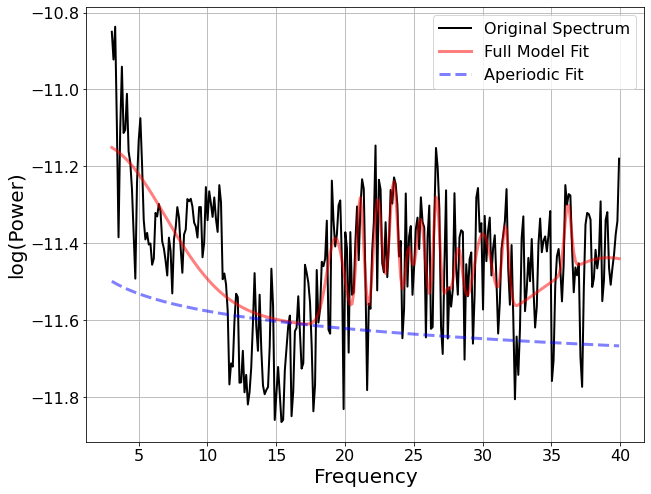

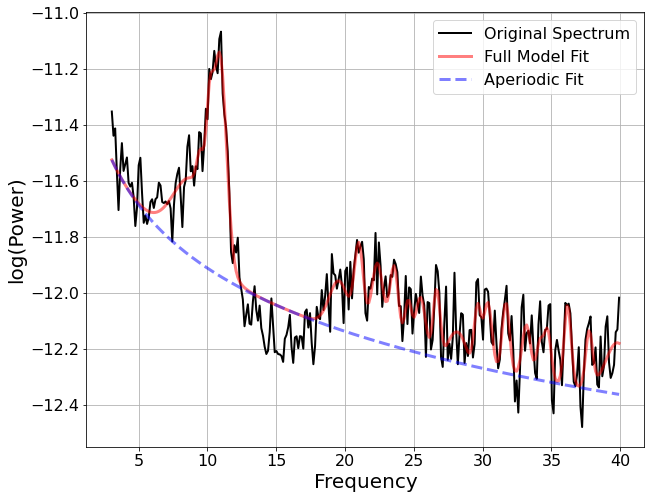

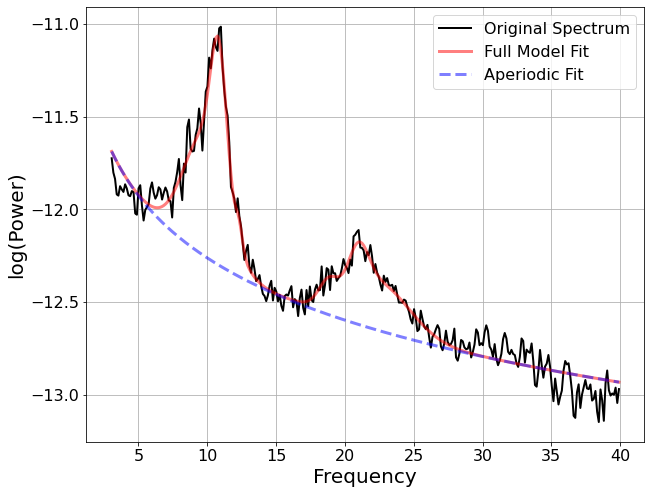

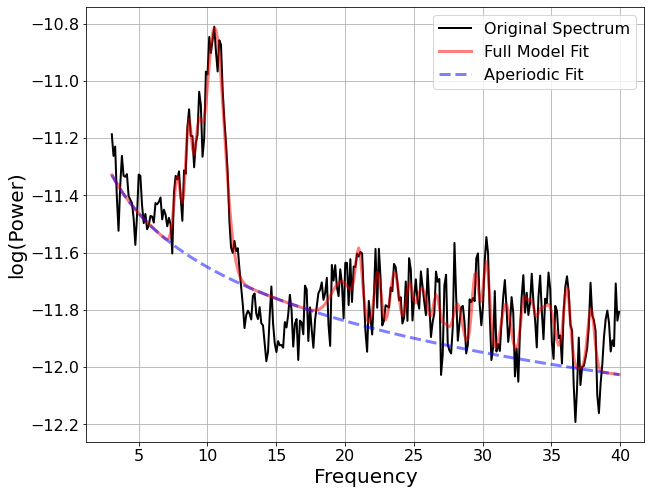

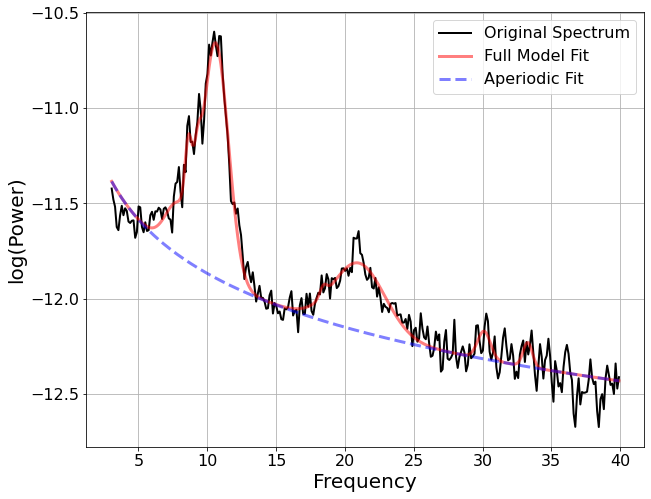

In [ ]:
# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
EEG_30_fm = FOOOF()
EEG_35_fm = FOOOF()
EEG_36_fm = FOOOF()
EEG_37_fm = FOOOF()
EEG_41_fm = FOOOF()
EEG_42_fm = FOOOF()

# freq_range = [11,15] 
freq_range = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
EEG_30 = EEG_30_fm.report(freqs, psd[0].flatten(), freq_range)
EEG_35 = EEG_35_fm.report(freqs, psd[1].flatten(), freq_range)
EEG_36 = EEG_36_fm.report(freqs, psd[2].flatten(), freq_range)
EEG_37 = EEG_37_fm.report(freqs, psd[3].flatten(), freq_range)
EEG_41 = EEG_41_fm.report(freqs, psd[4].flatten(), freq_range)
EEG_42 = EEG_42_fm.report(freqs, psd[5].flatten(), freq_range)

In [ ]:
# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
Freqs_C3_Music = [EEG_30_fm.freqs,EEG_35_fm.freqs,EEG_36_fm.freqs,EEG_37_fm.freqs,EEG_41_fm.freqs,EEG_42_fm.freqs]
Power_Spectrum_C3_Music = [EEG_30_fm.power_spectrum,EEG_35_fm.power_spectrum,EEG_36_fm.power_spectrum,EEG_37_fm.power_spectrum,EEG_41_fm.power_spectrum,EEG_42_fm.power_spectrum]

In [ ]:
# Music_Spec_1 = plot_spectrum(Freqs_C3_Music[0], Power_Spectrum_C3_Music[0])
# Music_Spec_2 = plot_spectrum(Freqs_C3_Music[1], Power_Spectrum_C3_Music[1])
# Music_Spec_3 = plot_spectrum(Freqs_C3_Music[2], Power_Spectrum_C3_Music[2])
# Music_Spec_4 = plot_spectrum(Freqs_C3_Music[3], Power_Spectrum_C3_Music[3])
# Music_Spec_5 = plot_spectrum(Freqs_C3_Music[4], Power_Spectrum_C3_Music[4])
# Music_Spec_6 = plot_spectrum(Freqs_C3_Music[5], Power_Spectrum_C3_Music[5])

In [ ]:
Freq_Range_C3_Music = [EEG_30_fm.freq_range,EEG_35_fm.freq_range,EEG_36_fm.freq_range,EEG_37_fm.freq_range,EEG_41_fm.freq_range,EEG_42_fm.freq_range]
Aperiodic_Params_C3_Music = [list(EEG_30_fm.aperiodic_params_),list(EEG_35_fm.aperiodic_params_),list(EEG_36_fm.aperiodic_params_),list(EEG_37_fm.aperiodic_params_),list(EEG_41_fm.aperiodic_params_),list(EEG_42_fm.aperiodic_params_)]
Peak_Params_C3_Music = [EEG_30_fm.peak_params_.tolist(),EEG_35_fm.peak_params_.tolist(),EEG_36_fm.peak_params_.tolist(),EEG_37_fm.peak_params_.tolist(),EEG_41_fm.peak_params_.tolist(),EEG_42_fm.peak_params_.tolist()]

In [ ]:
freqs_1_1, powers_1_1 = gen_power_spectrum(Freq_Range_C3_Music[0], Aperiodic_Params_C3_Music[0], Peak_Params_C3_Music[0])
freqs_1_2, powers_1_2 = gen_power_spectrum(Freq_Range_C3_Music[1], Aperiodic_Params_C3_Music[1], Peak_Params_C3_Music[1])
freqs_1_3, powers_1_3 = gen_power_spectrum(Freq_Range_C3_Music[2], Aperiodic_Params_C3_Music[2], Peak_Params_C3_Music[2])
freqs_1_4, powers_1_4 = gen_power_spectrum(Freq_Range_C3_Music[3], Aperiodic_Params_C3_Music[3], Peak_Params_C3_Music[3])
freqs_1_5, powers_1_5 = gen_power_spectrum(Freq_Range_C3_Music[4], Aperiodic_Params_C3_Music[4], Peak_Params_C3_Music[4])
freqs_1_6, powers_1_6 = gen_power_spectrum(Freq_Range_C3_Music[5], Aperiodic_Params_C3_Music[5], Peak_Params_C3_Music[5])

# Music_p_1 = plot_spectrum(freqs_1_1, powers_1_1, log_powers=True)
# Music_p_2 = plot_spectrum(freqs_1_2, powers_1_2, log_powers=True)
# Music_p_3 = plot_spectrum(freqs_1_3, powers_1_3, log_powers=True)
# Music_p_4 = plot_spectrum(freqs_1_4, powers_1_4, log_powers=True)
# Music_p_5 = plot_spectrum(freqs_1_5, powers_1_5, log_powers=True)
# Music_p_6 = plot_spectrum(freqs_1_6, powers_1_6, log_powers=True)

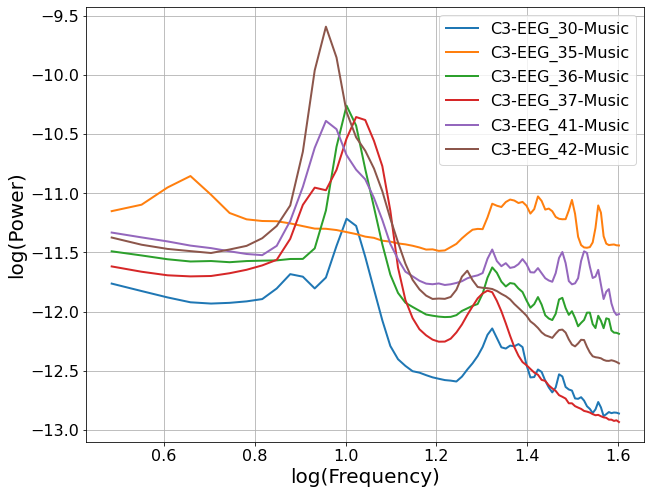

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['C3-EEG_30-Music', 'C3-EEG_35-Music', 'C3-EEG_36-Music', 'C3-EEG_37-Music', 'C3-EEG_41-Music', 'C3-EEG_42-Music']#'C3-TextAudio'

plot_spectra(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

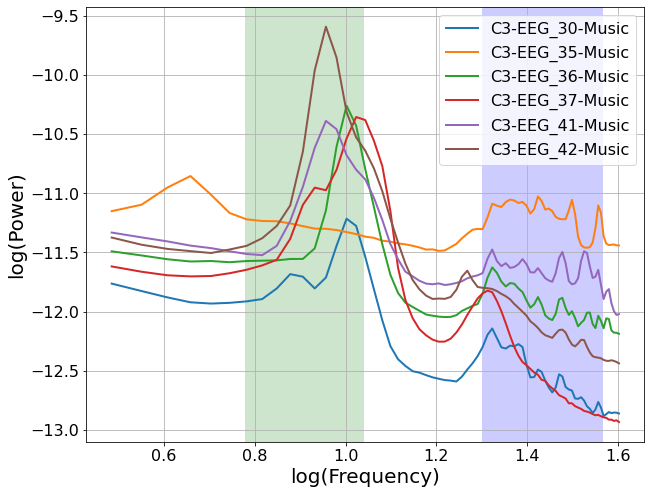

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['C3-EEG_30-Music', 'C3-EEG_35-Music', 'C3-EEG_36-Music', 'C3-EEG_37-Music', 'C3-EEG_41-Music', 'C3-EEG_42-Music']
plot_spectra_shading(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], [[6, 11], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting only Slow Wave (music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.9815, 1.4932                                         
                                                                                                  
                                       1 peaks were found:                                        
          

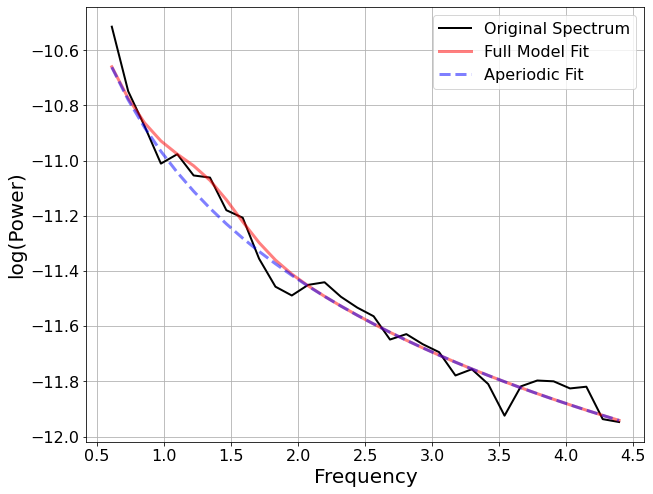

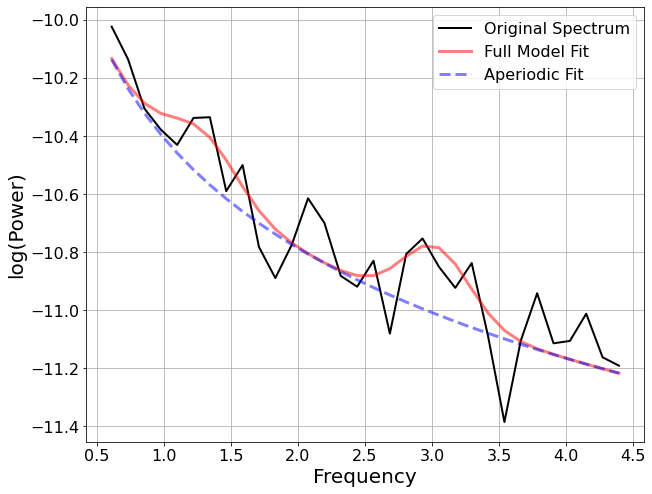

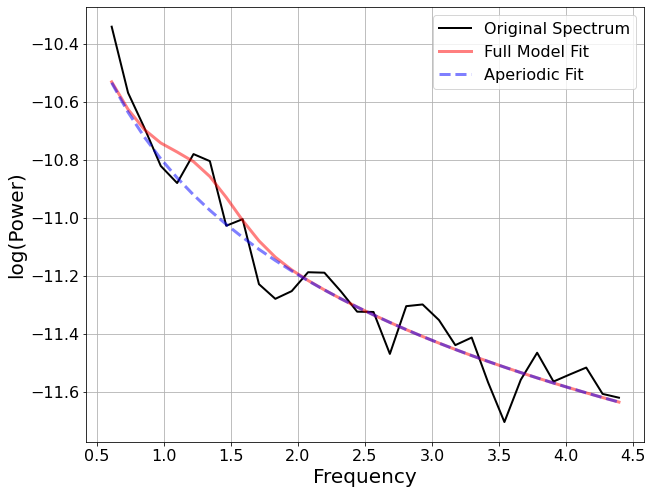

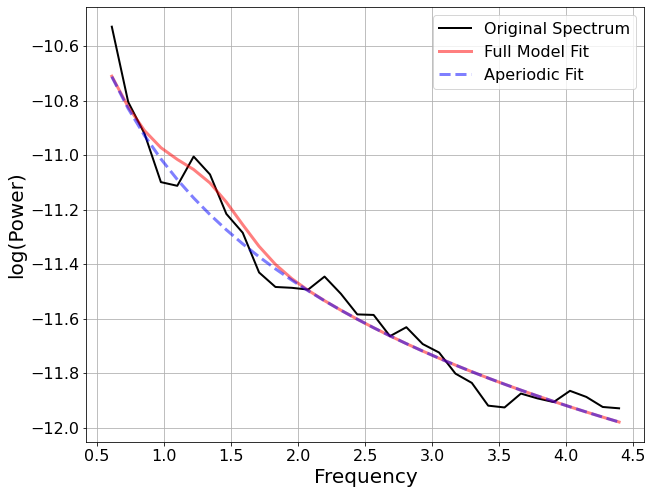

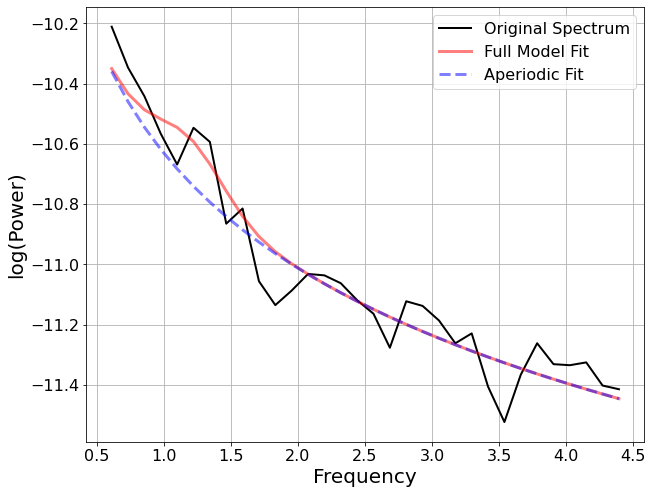

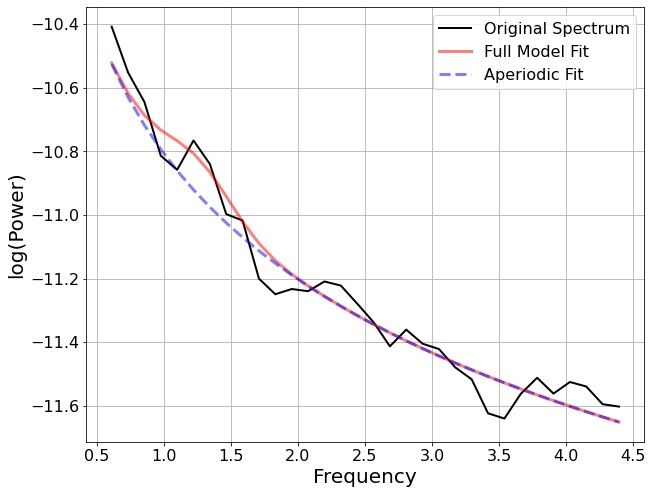

In [ ]:
# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
EEG_30_fm_mus_sw = FOOOF()
EEG_35_fm_mus_sw = FOOOF()
EEG_36_fm_mus_sw = FOOOF()
EEG_37_fm_mus_sw = FOOOF()
EEG_41_fm_mus_sw = FOOOF()
EEG_42_fm_mus_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
EEG_30_mus_sw = EEG_30_fm_mus_sw.report(freqs, psd[0].flatten(), freq_range)
EEG_35_mus_sw = EEG_35_fm_mus_sw.report(freqs, psd[1].flatten(), freq_range)
EEG_36_mus_sw = EEG_36_fm_mus_sw.report(freqs, psd[2].flatten(), freq_range)
EEG_37_mus_sw = EEG_37_fm_mus_sw.report(freqs, psd[3].flatten(), freq_range)
EEG_41_mus_sw = EEG_41_fm_mus_sw.report(freqs, psd[4].flatten(), freq_range)
EEG_42_mus_sw = EEG_42_fm_mus_sw.report(freqs, psd[5].flatten(), freq_range)

Extracting only beta (music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -12.2684, 0.3148                                         
                                                                                                  
                                       13 peaks were found:                                       
          

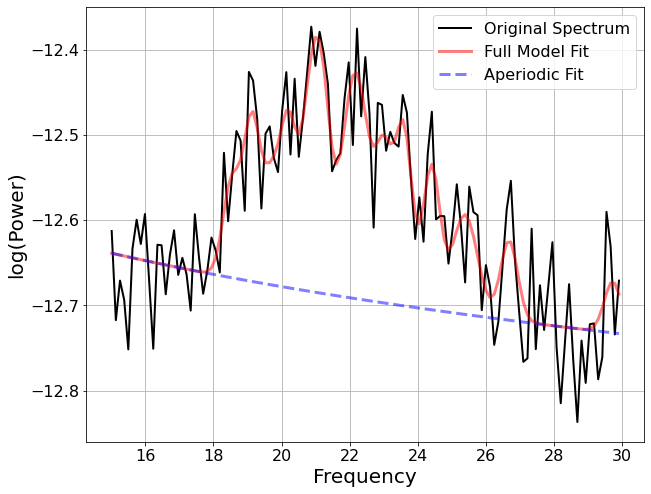

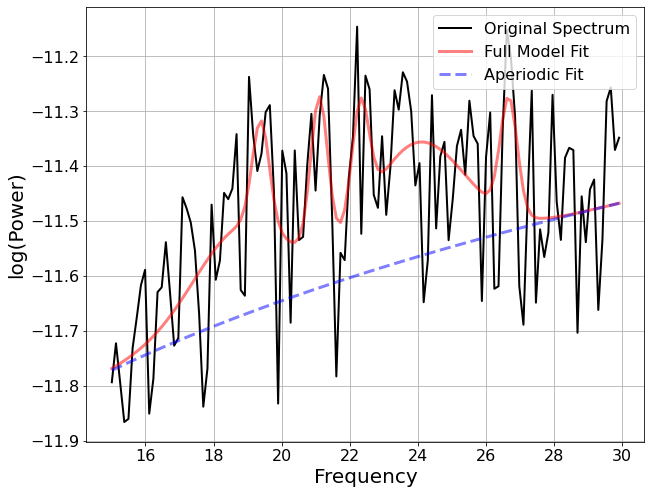

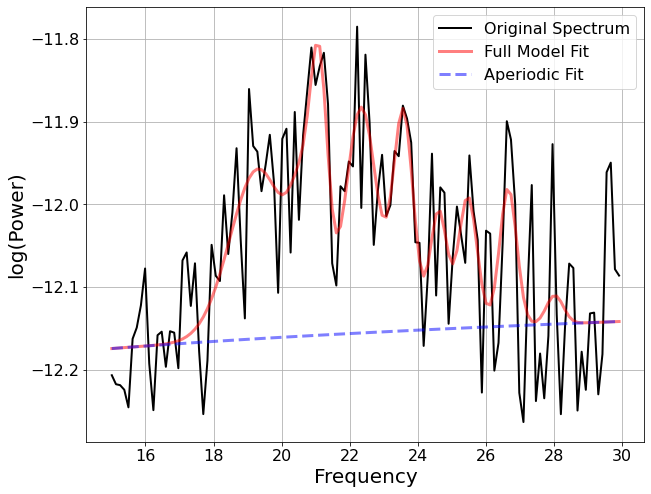

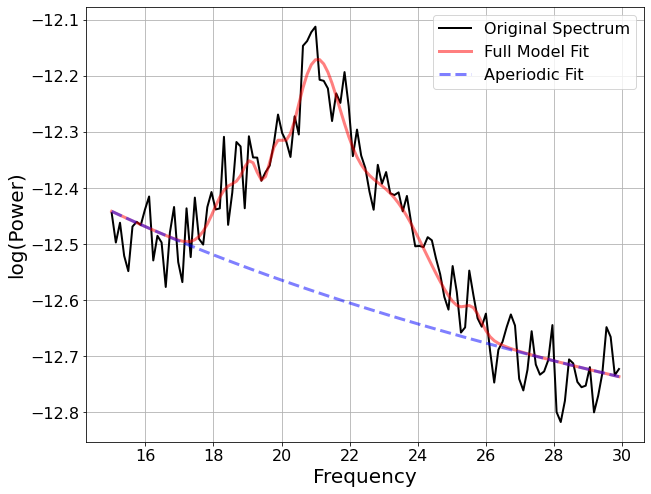

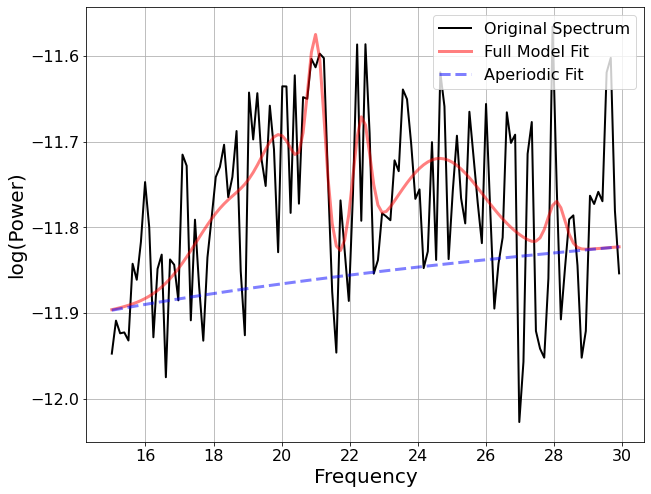

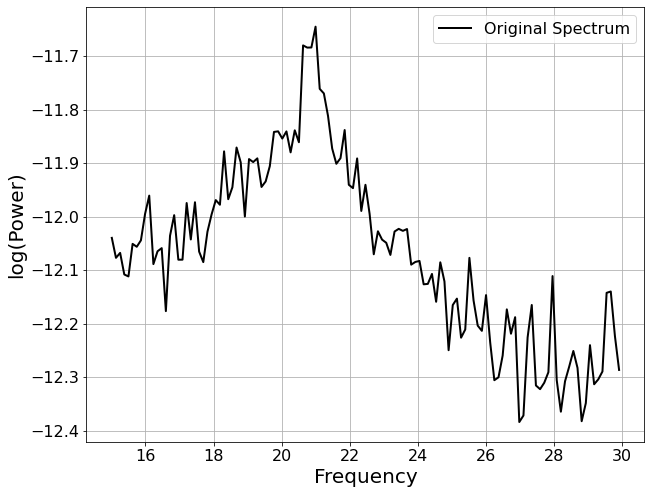

In [ ]:
# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
EEG_30_fm_mus_b = FOOOF()
EEG_35_fm_mus_b = FOOOF()
EEG_36_fm_mus_b = FOOOF()
EEG_37_fm_mus_b = FOOOF()
EEG_41_fm_mus_b = FOOOF()
EEG_42_fm_mus_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
EEG_30_mus_b = EEG_30_fm_mus_b.report(freqs, psd[0].flatten(), freq_range)
EEG_35_mus_b = EEG_35_fm_mus_b.report(freqs, psd[1].flatten(), freq_range)
EEG_36_mus_b = EEG_36_fm_mus_b.report(freqs, psd[2].flatten(), freq_range)
EEG_37_mus_b = EEG_37_fm_mus_b.report(freqs, psd[3].flatten(), freq_range)
EEG_41_mus_b = EEG_41_fm_mus_b.report(freqs, psd[4].flatten(), freq_range)
EEG_42_mus_b = EEG_42_fm_mus_b.report(freqs, psd[5].flatten(), freq_range)

In [ ]:
EEG_30_mus_ratio = sum(EEG_30_fm_mus_sw.power_spectrum) / sum(EEG_30_fm_mus_b.power_spectrum)
EEG_35_mus_ratio = sum(EEG_35_fm_mus_sw.power_spectrum) / sum(EEG_35_fm_mus_b.power_spectrum)
EEG_36_mus_ratio = sum(EEG_36_fm_mus_sw.power_spectrum) / sum(EEG_36_fm_mus_b.power_spectrum)
EEG_37_mus_ratio = sum(EEG_37_fm_mus_sw.power_spectrum) / sum(EEG_37_fm_mus_b.power_spectrum)
EEG_41_mus_ratio = sum(EEG_41_fm_mus_sw.power_spectrum) / sum(EEG_41_fm_mus_b.power_spectrum)
EEG_42_mus_ratio = sum(EEG_42_fm_mus_sw.power_spectrum) / sum(EEG_42_fm_mus_b.power_spectrum)

#### SW/Beta Ratio (Text Condition)

In [ ]:
raw2 = mne.io.read_raw_edf('msm_p03_t3.edf') 
raw2.crop(tmin = 339, tmax = 939)
raw2.pick_channels(['EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'])

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t3.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
channel_renaming_dict = {'EEG 30':'C1', 'EEG 35':'FC5', 'EEG 36':'C3', 'EEG 37':'CP1', 'EEG 41':'C5', 'EEG 42':'CP3'}

raw2.rename_channels(channel_renaming_dict)  # happens in-place

raw2.ch_names

['C1', 'FC5', 'C3', 'CP1', 'C5', 'CP3']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw2.set_montage(montage)

<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~16 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-35-1f682e7cb6ee>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw2)


Selecting by number: 6 components
Fitting ICA took 5.0s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


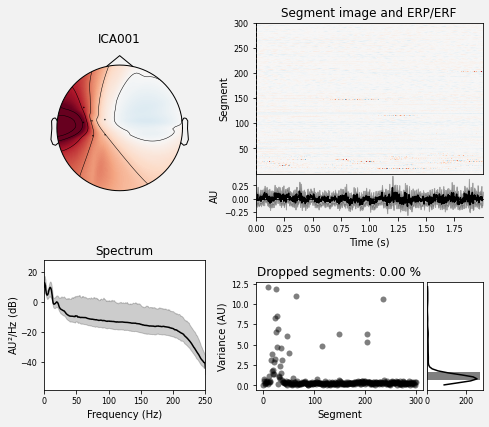

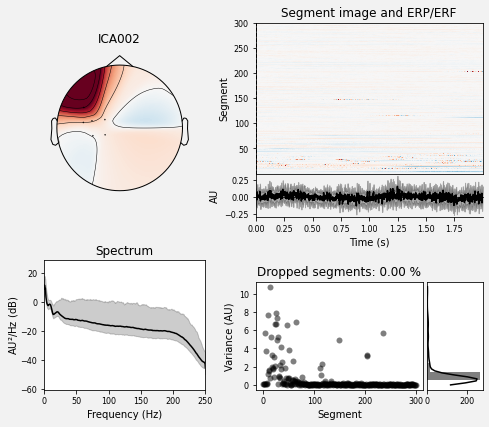

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw2)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw2, picks=ica.exclude)
plt.show()

In [ ]:
# for ann in raw2.annotations:
#     descr = ann['description']
#     start = ann['onset']
#     # end = ann['onset'] + ann['duration']
#     print(f"'{descr}' starts at {start}")

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


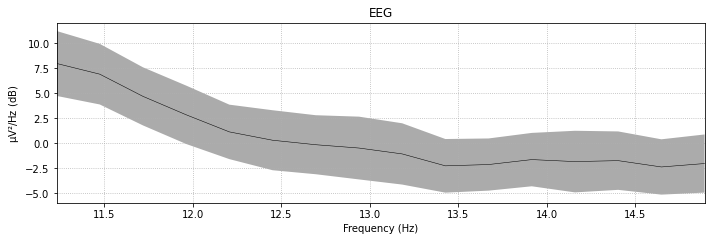

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


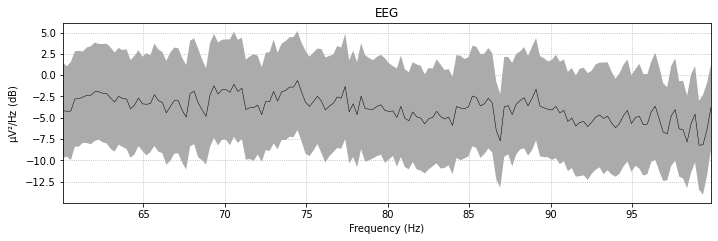

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


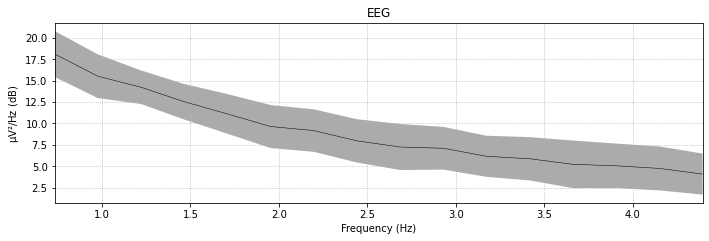

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


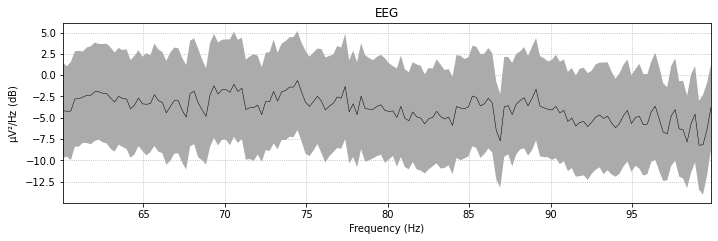

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

In [ ]:
psd2, freqs2 = mne.time_frequency.psd_array_welch(raw2.get_data(), sfreq=raw2.info['sfreq'], n_fft=4096)
psd2.shape,freqs2.shape

Effective window size : 8.192 (s)


((6, 2049), (2049,))

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.1044, 1.2449                                         
                                                                                                  
                                       21 peaks were found:                                       
          

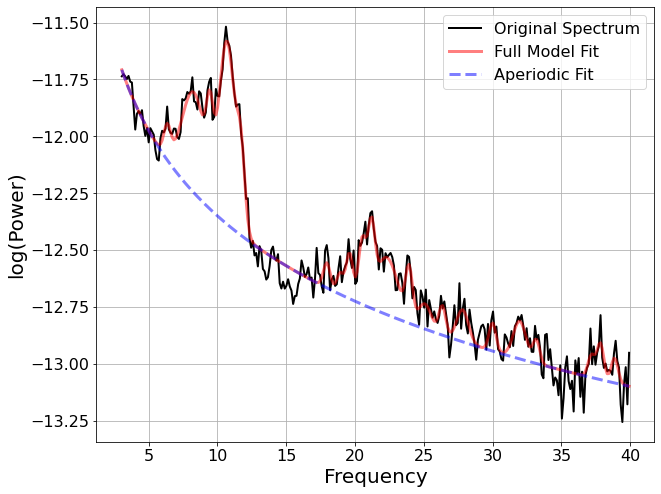

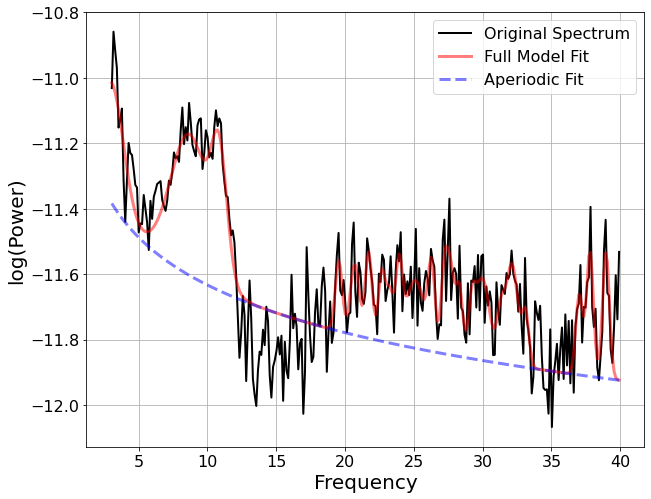

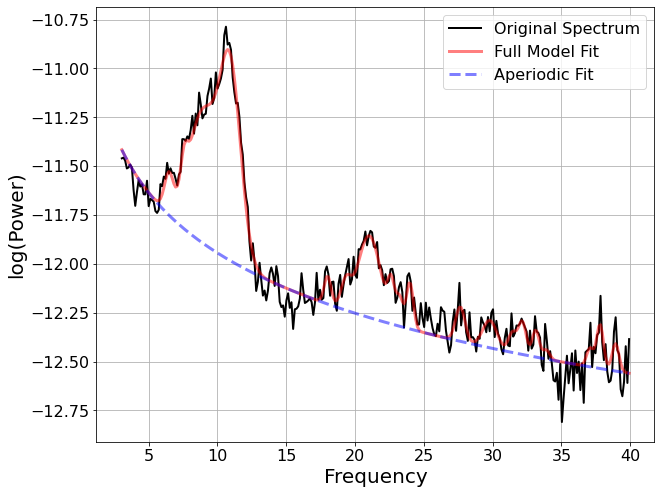

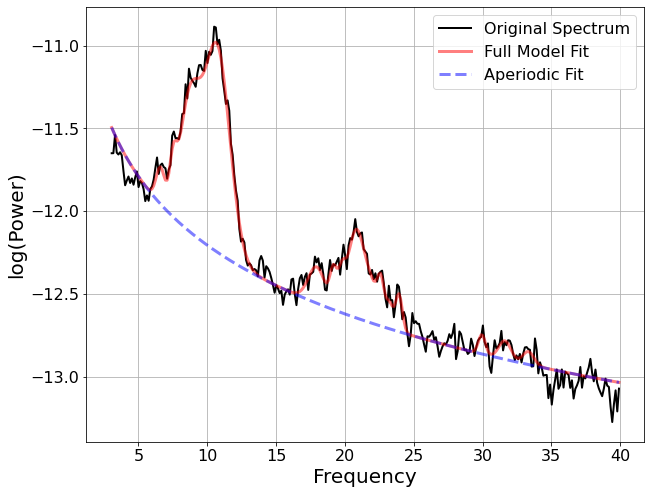

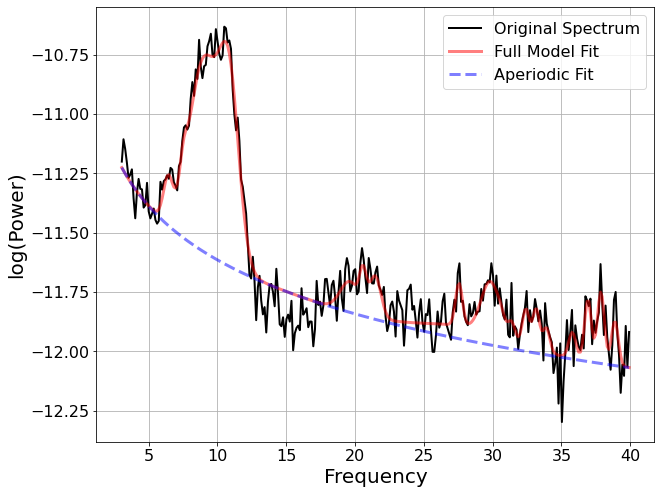

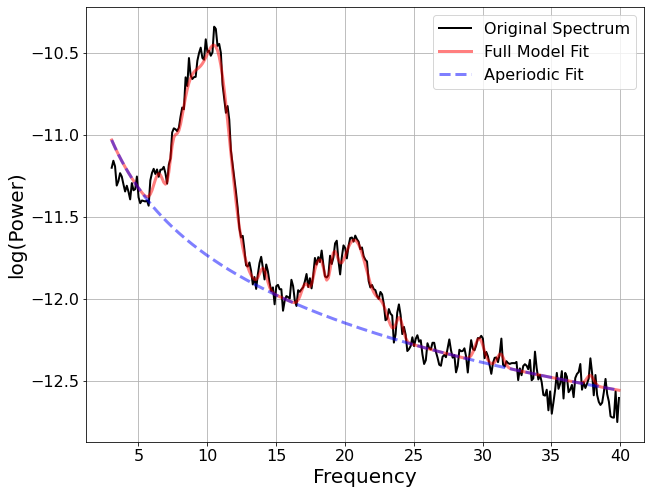

In [ ]:
# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
EEG_30_fm2 = FOOOF()
EEG_35_fm2 = FOOOF()
EEG_36_fm2 = FOOOF()
EEG_37_fm2 = FOOOF()
EEG_41_fm2 = FOOOF()
EEG_42_fm2 = FOOOF()

# freq_range = [11,15] 
freq_range2 = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta


EEG_30 = EEG_30_fm2.report(freqs2, psd2[0].flatten(), freq_range2)
EEG_35 = EEG_35_fm2.report(freqs2, psd2[1].flatten(), freq_range2)
EEG_36 = EEG_36_fm2.report(freqs2, psd2[2].flatten(), freq_range2)
EEG_37 = EEG_37_fm2.report(freqs2, psd2[3].flatten(), freq_range2)
EEG_41 = EEG_41_fm2.report(freqs2, psd2[4].flatten(), freq_range2)
EEG_42 = EEG_42_fm2.report(freqs2, psd2[5].flatten(), freq_range2)

In [ ]:
#'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
Freqs_C3_text = [EEG_30_fm2.freqs,EEG_35_fm2.freqs,EEG_36_fm2.freqs,EEG_37_fm2.freqs,EEG_41_fm2.freqs,EEG_42_fm2.freqs]
Power_Spectrum_C3_Text = [EEG_30_fm2.power_spectrum,EEG_35_fm2.power_spectrum,EEG_36_fm2.power_spectrum,EEG_37_fm2.power_spectrum,EEG_41_fm2.power_spectrum,EEG_42_fm2.power_spectrum]

In [ ]:
# Text_Spec_1 = plot_spectrum(Freqs_C3_text[0], Power_Spectrum_C3_Text[0])
# Text_Spec_2 = plot_spectrum(Freqs_C3_text[1], Power_Spectrum_C3_Text[1])
# Text_Spec_3 = plot_spectrum(Freqs_C3_text[2], Power_Spectrum_C3_Text[2])
# Text_Spec_4 = plot_spectrum(Freqs_C3_text[3], Power_Spectrum_C3_Text[3])
# Text_Spec_5 = plot_spectrum(Freqs_C3_text[4], Power_Spectrum_C3_Text[4])
# Text_Spec_6 = plot_spectrum(Freqs_C3_text[5], Power_Spectrum_C3_Text[5])

In [ ]:
# spec_2 = plot_spectrum(fm2.freqs, fm2.power_spectrum)
# plt.show()

In [ ]:
Freq_Range_C3_Text = [EEG_30_fm2.freq_range,EEG_35_fm2.freq_range,EEG_36_fm2.freq_range,EEG_37_fm2.freq_range,EEG_41_fm2.freq_range,EEG_42_fm2.freq_range]
Aperiodic_Params_C3_Text = [list(EEG_30_fm2.aperiodic_params_),list(EEG_35_fm2.aperiodic_params_),list(EEG_36_fm2.aperiodic_params_),list(EEG_37_fm2.aperiodic_params_),list(EEG_41_fm2.aperiodic_params_),list(EEG_42_fm2.aperiodic_params_)]
Peak_Params_C3_Text = [EEG_30_fm2.peak_params_.tolist(),EEG_35_fm2.peak_params_.tolist(),EEG_36_fm2.peak_params_.tolist(),EEG_37_fm2.peak_params_.tolist(),EEG_41_fm2.peak_params_.tolist(),EEG_42_fm2.peak_params_.tolist()]

In [ ]:
freqs_2_1, powers_2_1 = gen_power_spectrum(Freq_Range_C3_Text[0], Aperiodic_Params_C3_Text[0], Peak_Params_C3_Text[0])
freqs_2_2, powers_2_2 = gen_power_spectrum(Freq_Range_C3_Text[1], Aperiodic_Params_C3_Text[1], Peak_Params_C3_Text[1])
freqs_2_3, powers_2_3 = gen_power_spectrum(Freq_Range_C3_Text[2], Aperiodic_Params_C3_Text[2], Peak_Params_C3_Text[2])
freqs_2_4, powers_2_4 = gen_power_spectrum(Freq_Range_C3_Text[3], Aperiodic_Params_C3_Text[3], Peak_Params_C3_Text[3])
freqs_2_5, powers_2_5 = gen_power_spectrum(Freq_Range_C3_Text[4], Aperiodic_Params_C3_Text[4], Peak_Params_C3_Text[4])
freqs_2_6, powers_2_6 = gen_power_spectrum(Freq_Range_C3_Text[5], Aperiodic_Params_C3_Text[5], Peak_Params_C3_Text[5])

# Text_p_1 = plot_spectrum(freqs_2_1, powers_2_1, log_powers=True)
# Text_p_2 = plot_spectrum(freqs_2_2, powers_2_2, log_powers=True)
# Text_p_3 = plot_spectrum(freqs_2_3, powers_2_3, log_powers=True)
# Text_p_4 = plot_spectrum(freqs_2_4, powers_2_4, log_powers=True)
# Text_p_5 = plot_spectrum(freqs_2_5, powers_2_5, log_powers=True)
# Text_p_6 = plot_spectrum(freqs_2_6, powers_2_6, log_powers=True)

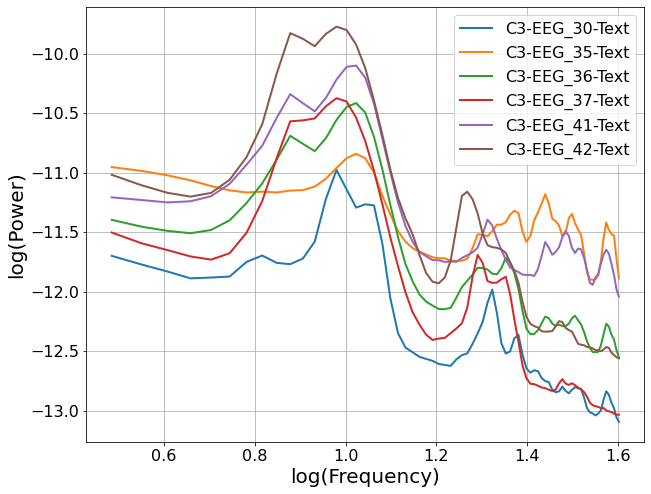

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['C3-EEG_30-Text', 'C3-EEG_35-Text', 'C3-EEG_36-Text', 'C3-EEG_37-Text', 'C3-EEG_41-Text', 'C3-EEG_42-Text']#'C3-TextAudio'

plot_spectra(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

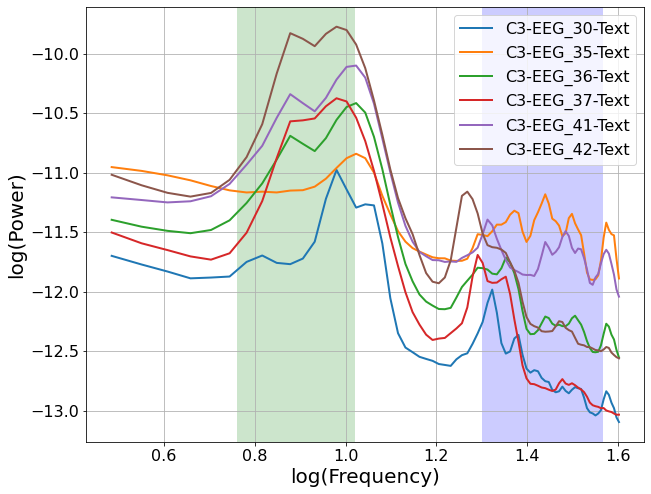

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['C3-EEG_30-Text', 'C3-EEG_35-Text', 'C3-EEG_36-Text', 'C3-EEG_37-Text', 'C3-EEG_41-Text', 'C3-EEG_42-Text']
plot_spectra_shading(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], [[5.75, 10.5], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting slow wave (text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.9489, 1.5913                                         
                                                                                                  
                                       2 peaks were found:                                        
          

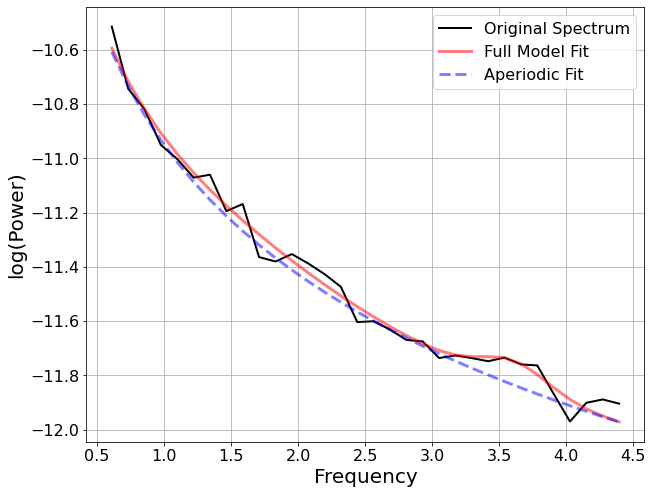

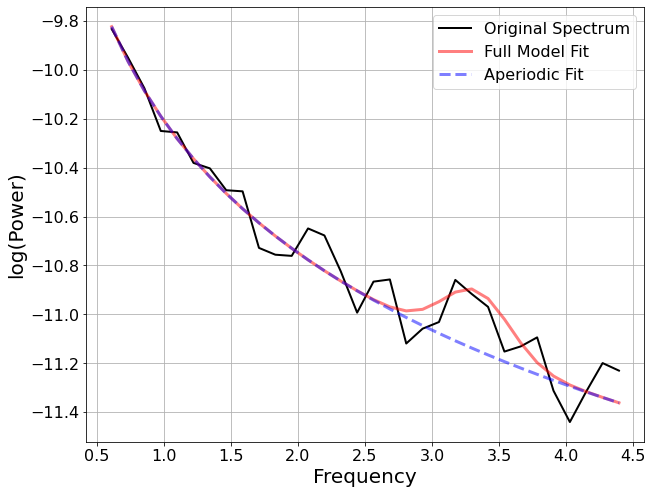

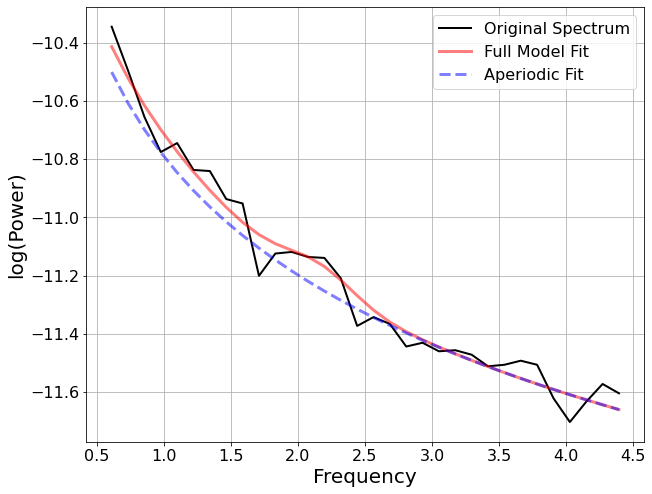

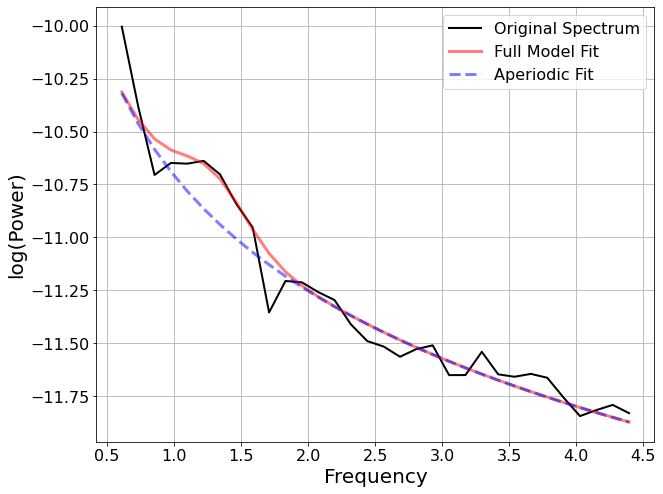

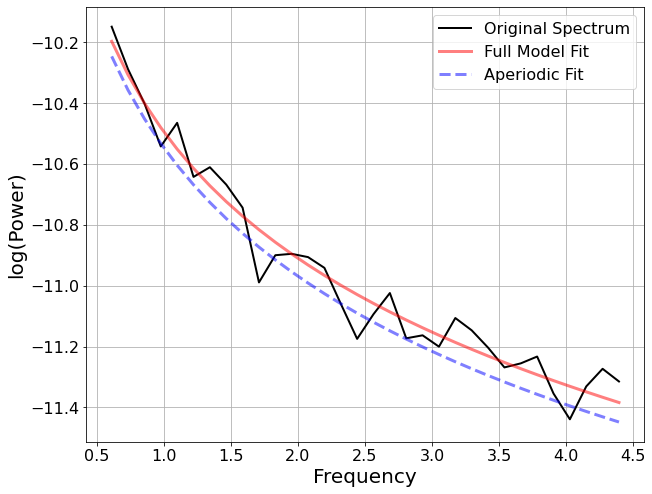

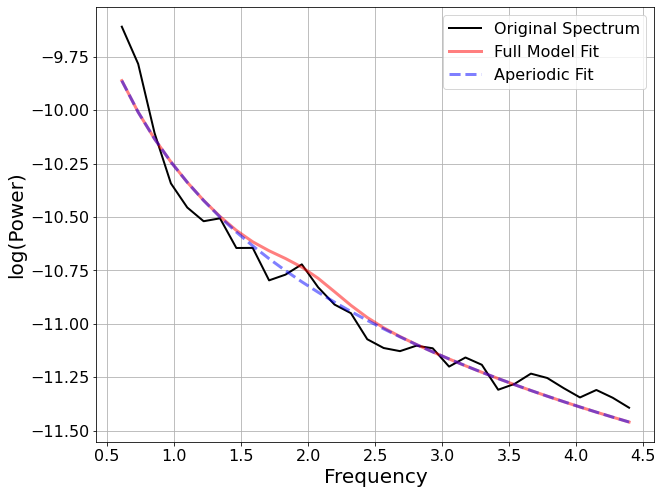

In [ ]:
# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
EEG_30_fm_text_sw = FOOOF()
EEG_35_fm_text_sw = FOOOF()
EEG_36_fm_text_sw = FOOOF()
EEG_37_fm_text_sw = FOOOF()
EEG_41_fm_text_sw = FOOOF()
EEG_42_fm_text_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
EEG_30_text_sw = EEG_30_fm_text_sw.report(freqs, psd2[0].flatten(), freq_range)
EEG_35_text_sw = EEG_35_fm_text_sw.report(freqs, psd2[1].flatten(), freq_range)
EEG_36_text_sw = EEG_36_fm_text_sw.report(freqs, psd2[2].flatten(), freq_range)
EEG_37_text_sw = EEG_37_fm_text_sw.report(freqs, psd2[3].flatten(), freq_range)
EEG_41_text_sw = EEG_41_fm_text_sw.report(freqs, psd2[4].flatten(), freq_range)
EEG_42_text_sw = EEG_42_fm_text_sw.report(freqs, psd2[5].flatten(), freq_range)

Extracting beta (text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.6554, 0.8121                                         
                                                                                                  
                                       8 peaks were found:                                        
          

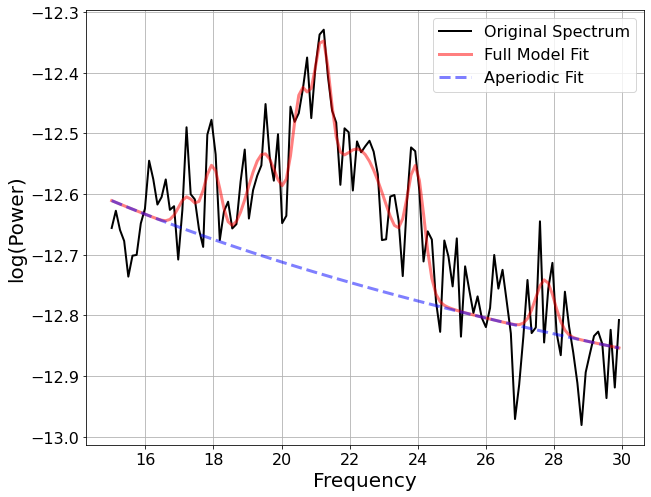

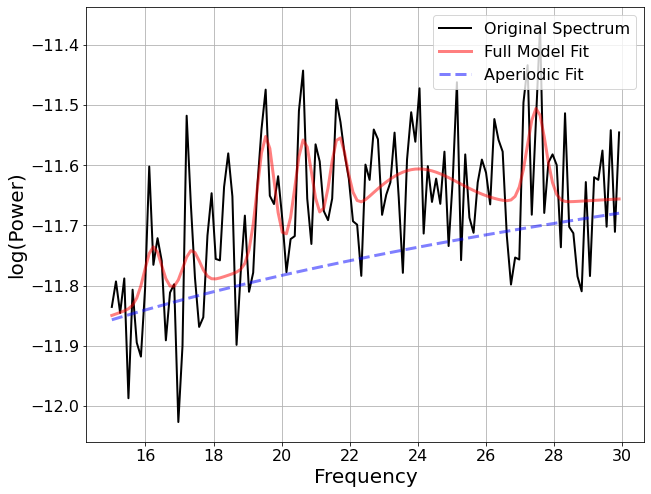

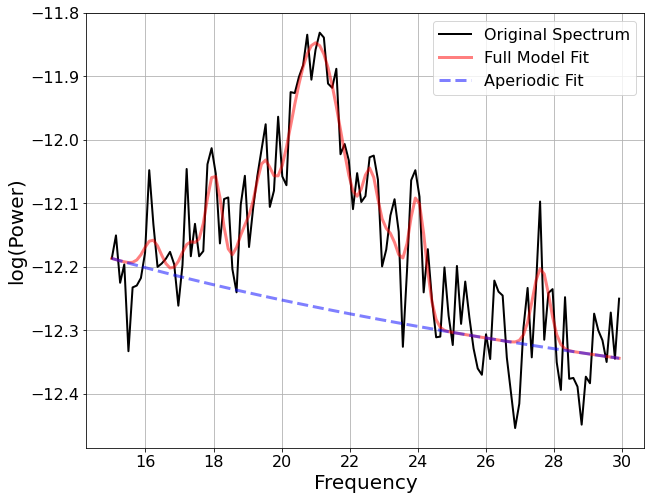

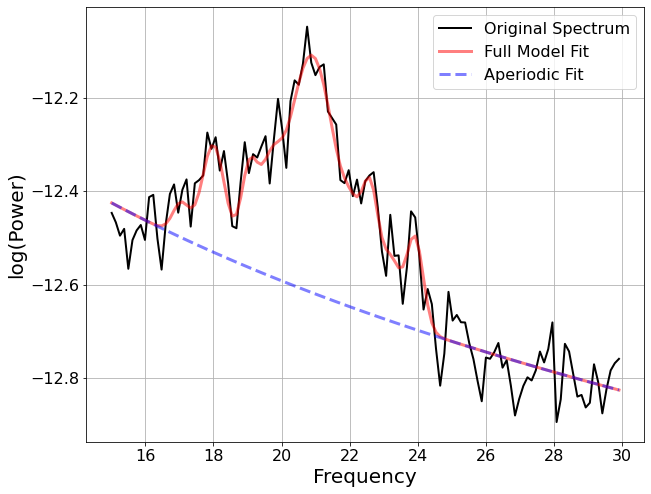

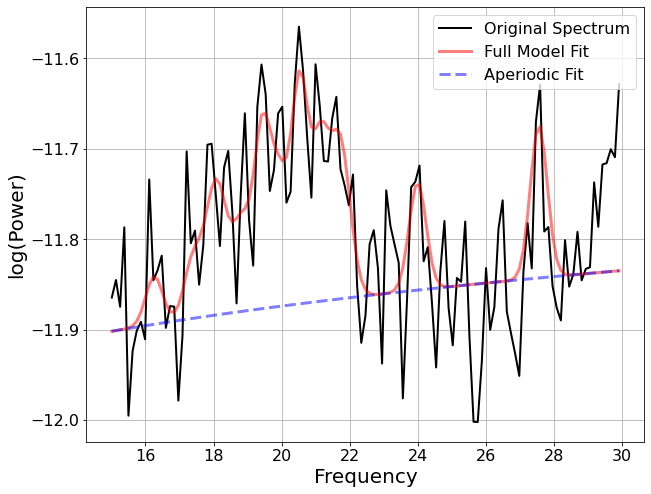

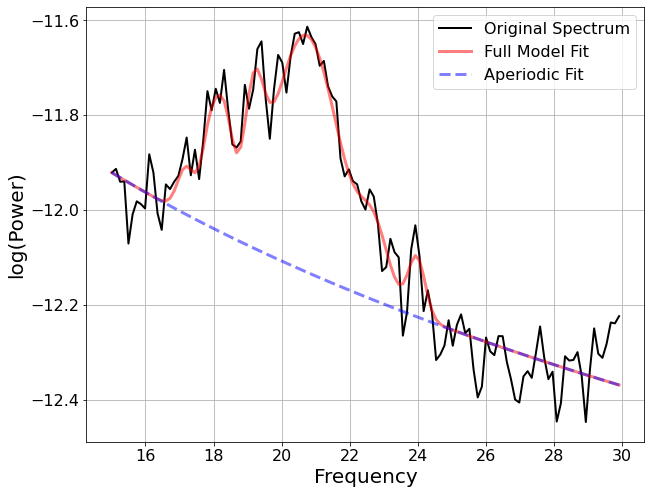

In [ ]:
# 'EEG 30', 'EEG 35', 'EEG 36', 'EEG 37', 'EEG 41', 'EEG 42'
EEG_30_fm_text_b = FOOOF()
EEG_35_fm_text_b = FOOOF()
EEG_36_fm_text_b = FOOOF()
EEG_37_fm_text_b = FOOOF()
EEG_41_fm_text_b = FOOOF()
EEG_42_fm_text_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


EEG_30_text_b = EEG_30_fm_text_b.report(freqs, psd2[0].flatten(), freq_range)
EEG_35_text_b = EEG_35_fm_text_b.report(freqs, psd2[1].flatten(), freq_range)
EEG_36_text_b = EEG_36_fm_text_b.report(freqs, psd2[2].flatten(), freq_range)
EEG_37_text_b = EEG_37_fm_text_b.report(freqs, psd2[3].flatten(), freq_range)
EEG_41_text_b = EEG_41_fm_text_b.report(freqs, psd2[4].flatten(), freq_range)
EEG_42_text_b = EEG_42_fm_text_b.report(freqs, psd2[5].flatten(), freq_range)

Calculating sw/beta ratios

In [ ]:
EEG_30_text_ratio = sum(EEG_30_fm_text_sw.power_spectrum) / sum(EEG_30_fm_text_b.power_spectrum)
EEG_35_text_ratio = sum(EEG_35_fm_text_sw.power_spectrum) / sum(EEG_35_fm_text_b.power_spectrum)
EEG_36_text_ratio = sum(EEG_36_fm_text_sw.power_spectrum) / sum(EEG_36_fm_text_b.power_spectrum)
EEG_37_text_ratio = sum(EEG_37_fm_text_sw.power_spectrum) / sum(EEG_37_fm_text_b.power_spectrum)
EEG_41_text_ratio = sum(EEG_41_fm_text_sw.power_spectrum) / sum(EEG_41_fm_text_b.power_spectrum)
EEG_42_text_ratio = sum(EEG_42_fm_text_sw.power_spectrum) / sum(EEG_42_fm_text_b.power_spectrum)

Comparison of ratios for music and control(text) conditions

In [ ]:
mus_ratios = [EEG_30_mus_ratio, EEG_35_mus_ratio, EEG_36_mus_ratio, EEG_37_mus_ratio, EEG_41_mus_ratio, EEG_42_mus_ratio]
text_ratios = [EEG_30_text_ratio, EEG_35_text_ratio, EEG_36_text_ratio, EEG_37_text_ratio, EEG_41_text_ratio, EEG_42_text_ratio]
difference = np.array(mus_ratios) - np.array(text_ratios)

In [ ]:
results = pd.DataFrame([mus_ratios, text_ratios, difference], index = ['Music', 'Text', 'Difference'], columns = [30, 35, 36, 37, 41, 42])
results = results.style.set_table_attributes("style='display:inline'").set_caption('C3 Slow Wave/Beta Activity')
results

,30,35,36,37,41,42
Music,0.237025,0.244193,0.242389,0.239800,0.243913,0.242300
Text,0.235575,0.240361,0.239810,0.234492,0.241859,0.235209
Difference,0.001450,0.003832,0.002579,0.005308,0.002054,0.007090


Higher values of this ratio are indicative of slower EEG activity, and therefore more restorative sleep. In four of the five C3 electrodes, the slow wave / beta activity ratio in the text condition is greater than that of the music condition. However, the differences are very small.

### Comparing all C4 readings between music and text audio for subject


In [ ]:
from IPython import display
display.Image("eeg_placement.png")

In [ ]:
raw = mne.io.read_raw_edf('msm_p03_t2.edf',preload=False) # subject 3, control text run. index 2 in the dataframe in sleep_music_data_notes.ipynb
raw.crop(tmin = 345, tmax = 945) 
raw.pick_channels(['EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'])
# raw.filter(l_freq=.5,h_freq=30)
# DURATION ON TABLE IS 10 MINUTES FOR N1_MIN_TEXT (90,690). 
# or start time for N1 to N2 when interpreting min as stage start time (600,960) 6 minutes
# tmin = 224, tmax = 824, eyes closed to ten minutes after
# tmin = 345, tmax = 945, eyes closed_2 to ten minutes after

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t2.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
# IGNORE THIS
# ch_types = ['eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eeg','eog','eog']
# ch_names = ['FP1','FP2','F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'FZ', 'CZ', 'PZ', 'OZ', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'FT9', 'FT10', 'TP9', 'TP10', 'F1', 'F2', 'C1', 'C2', 'P1', 'P2', 'AF3', 'AF4', 'FC3', 'FC4', 'CP3', 'CP4', 'PO3', 'PO4', 'F5', 'F6', 'C5', 'C6', 'P5', 'P6', 'AF7', 'AF8', 'FT7', 'FT8', 'TP7', 'TP8', 'PO7', 'PO8', 'FPZ', 'FCZ', 'CPZ', 'POZ', 'VEOG', 'HEOG']

In [ ]:
# eegbci.standardize(raw)

# channel_renaming_dict = {name: name.replace(' 0', '') for name in raw.ch_names}
channel_renaming_dict = {'EEG 87': 'CP2', 'EEG 93': 'CP4', 'EEG 103': 'CP6', 'EEG 104': 'C4', 'EEG 105': 'C2', 'EEG 110': 'C6'}

raw.rename_channels(channel_renaming_dict)  # happens in-place

raw.ch_names

['CP2', 'CP4', 'CP6', 'C4', 'C2', 'C6']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw.set_montage(montage)

<RawEDF | msm_p03_t2.edf, 6 x 300001 (600.0 s), ~16 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-11-15bd986f335b>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw)


Selecting by number: 6 components
Fitting ICA took 9.6s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


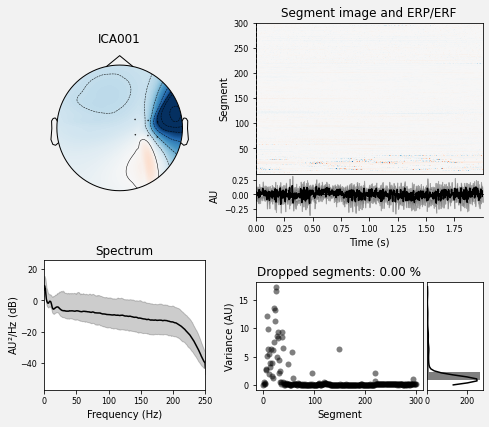

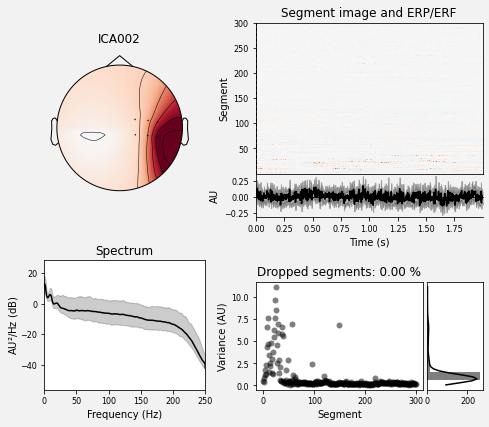

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw, picks=ica.exclude)
plt.show()

#### We can select different brain regions through the chart below:

#### For instance C4:

In [ ]:
# F3 = raw.pick_channels(['EEG 19', 'EEG 20', 'EEG 23', 'EEG 24', 'EEG 27', 'EEG 28'])

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


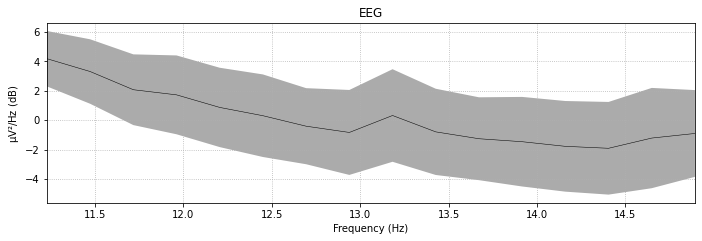

In [ ]:
# 5400 (90 minutes in seconds)

spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


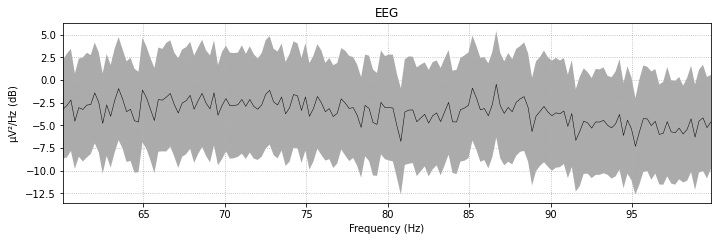

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


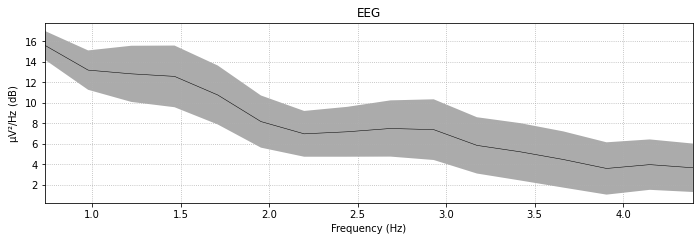

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


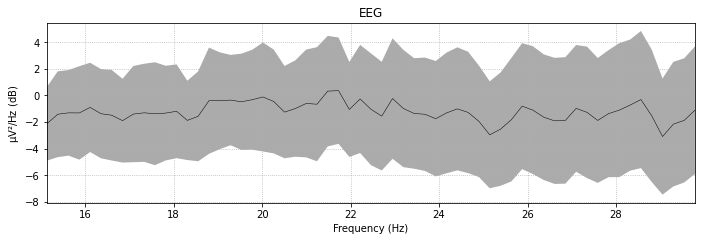

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw.load_data(), fmin=15, fmax=30, average = 'Median')
plt.show()

In [ ]:
# https://raphaelvallat.com/bandpower.html
# link above highlights what sensors are common for sleep analysis. which is Fz and Cz

psd, freqs = mne.time_frequency.psd_array_welch(raw.get_data(), sfreq=raw.info['sfreq'], n_fft=4096)

Effective window size : 8.192 (s)


In [ ]:
psd.shape

(6, 2049)

In [ ]:
freqs.shape

(2049,)

In [ ]:
# an_array = freqs
# repetitions = 6

# repeats_array = np.tile(an_array, (repetitions, 1))

# repeats_array.shape

In [ ]:
# an_array = [3,40] 
# repetitions = 6

# freq_range = np.tile(an_array, (repetitions, 1))
# freq_range.shape

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.0737, 1.2299                                         
                                                                                                  
                                       16 peaks were found:                                       
          

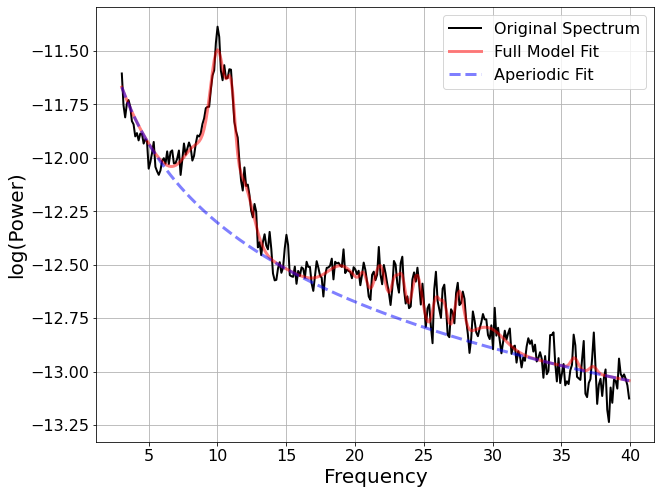

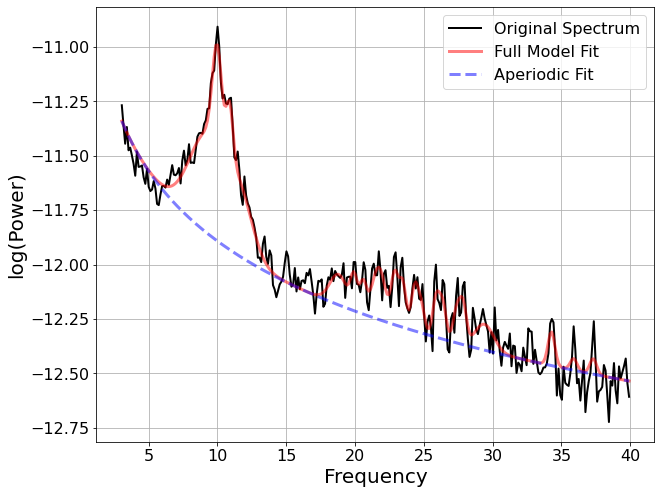

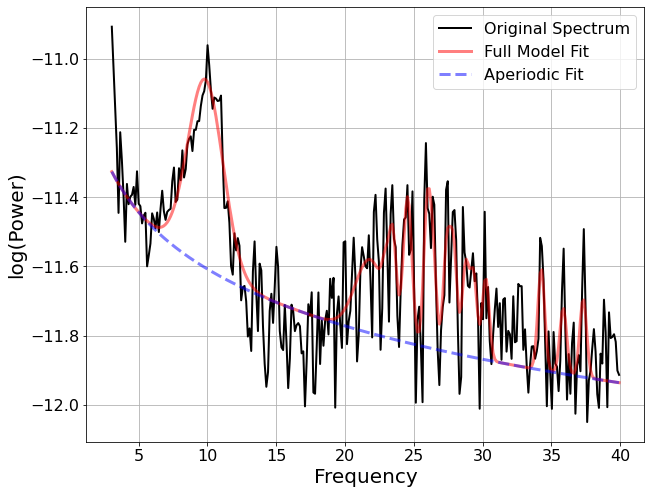

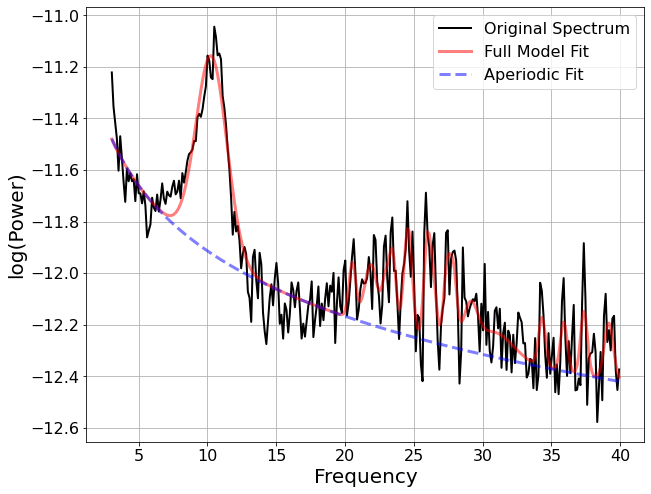

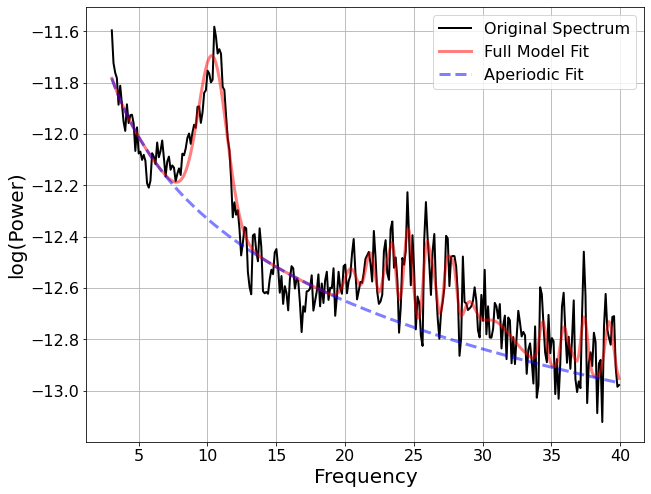

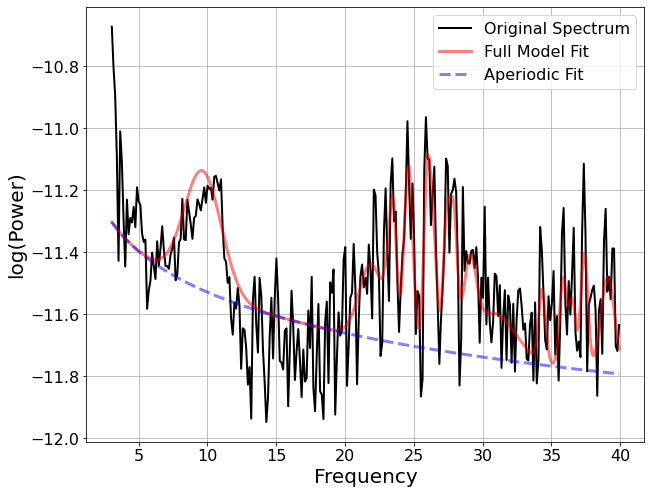

In [ ]:
# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
EEG_87_fm = FOOOF()
EEG_93_fm = FOOOF()
EEG_103_fm = FOOOF()
EEG_104_fm = FOOOF()
EEG_105_fm = FOOOF()
EEG_110_fm = FOOOF()

# freq_range = [11,15] 
freq_range = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
EEG_87 = EEG_87_fm.report(freqs, psd[0].flatten(), freq_range)
EEG_93 = EEG_93_fm.report(freqs, psd[1].flatten(), freq_range)
EEG_103 = EEG_103_fm.report(freqs, psd[2].flatten(), freq_range)
EEG_104 = EEG_104_fm.report(freqs, psd[3].flatten(), freq_range)
EEG_105 = EEG_105_fm.report(freqs, psd[4].flatten(), freq_range)
EEG_110 = EEG_110_fm.report(freqs, psd[5].flatten(), freq_range)

In [ ]:
# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
Freqs_C4_Music = [EEG_87_fm.freqs,EEG_93_fm.freqs,EEG_103_fm.freqs,EEG_104_fm.freqs,EEG_105_fm.freqs,EEG_110_fm.freqs]
Power_Spectrum_C4_Music = [EEG_87_fm.power_spectrum,EEG_93_fm.power_spectrum,EEG_103_fm.power_spectrum,EEG_104_fm.power_spectrum,EEG_105_fm.power_spectrum,EEG_110_fm.power_spectrum]

In [ ]:
# Music_Spec_1 = plot_spectrum(Freqs_C4_Music[0], Power_Spectrum_C4_Music[0])
# Music_Spec_2 = plot_spectrum(Freqs_C4_Music[1], Power_Spectrum_C4_Music[1])
# Music_Spec_3 = plot_spectrum(Freqs_C4_Music[2], Power_Spectrum_C4_Music[2])
# Music_Spec_4 = plot_spectrum(Freqs_C4_Music[3], Power_Spectrum_C4_Music[3])
# Music_Spec_5 = plot_spectrum(Freqs_C4_Music[4], Power_Spectrum_C4_Music[4])
# Music_Spec_6 = plot_spectrum(Freqs_C4_Music[5], Power_Spectrum_C4_Music[5])

In [ ]:
Freq_Range_C4_Music = [EEG_87_fm.freq_range,EEG_93_fm.freq_range,EEG_103_fm.freq_range,EEG_104_fm.freq_range,EEG_105_fm.freq_range,EEG_110_fm.freq_range]
Aperiodic_Params_C4_Music = [list(EEG_87_fm.aperiodic_params_),list(EEG_93_fm.aperiodic_params_),list(EEG_103_fm.aperiodic_params_),list(EEG_104_fm.aperiodic_params_),list(EEG_105_fm.aperiodic_params_),list(EEG_110_fm.aperiodic_params_)]
Peak_Params_C4_Music = [EEG_87_fm.peak_params_.tolist(),EEG_93_fm.peak_params_.tolist(),EEG_103_fm.peak_params_.tolist(),EEG_104_fm.peak_params_.tolist(),EEG_105_fm.peak_params_.tolist(),EEG_110_fm.peak_params_.tolist()]

In [ ]:
freqs_1_1, powers_1_1 = gen_power_spectrum(Freq_Range_C4_Music[0], Aperiodic_Params_C4_Music[0], Peak_Params_C4_Music[0])
freqs_1_2, powers_1_2 = gen_power_spectrum(Freq_Range_C4_Music[1], Aperiodic_Params_C4_Music[1], Peak_Params_C4_Music[1])
freqs_1_3, powers_1_3 = gen_power_spectrum(Freq_Range_C4_Music[2], Aperiodic_Params_C4_Music[2], Peak_Params_C4_Music[2])
freqs_1_4, powers_1_4 = gen_power_spectrum(Freq_Range_C4_Music[3], Aperiodic_Params_C4_Music[3], Peak_Params_C4_Music[3])
freqs_1_5, powers_1_5 = gen_power_spectrum(Freq_Range_C4_Music[4], Aperiodic_Params_C4_Music[4], Peak_Params_C4_Music[4])
freqs_1_6, powers_1_6 = gen_power_spectrum(Freq_Range_C4_Music[5], Aperiodic_Params_C4_Music[5], Peak_Params_C4_Music[5])

# Music_p_1 = plot_spectrum(freqs_1_1, powers_1_1, log_powers=True)
# Music_p_2 = plot_spectrum(freqs_1_2, powers_1_2, log_powers=True)
# Music_p_3 = plot_spectrum(freqs_1_3, powers_1_3, log_powers=True)
# Music_p_4 = plot_spectrum(freqs_1_4, powers_1_4, log_powers=True)
# Music_p_5 = plot_spectrum(freqs_1_5, powers_1_5, log_powers=True)
# Music_p_6 = plot_spectrum(freqs_1_6, powers_1_6, log_powers=True)

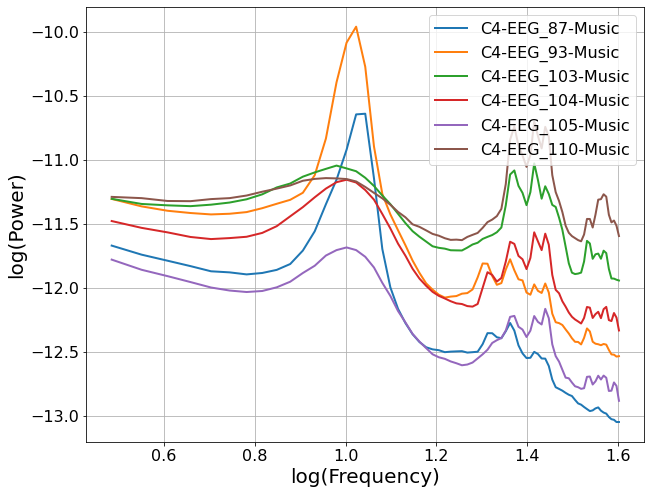

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['C4-EEG_87-Music', 'C4-EEG_93-Music', 'C4-EEG_103-Music', 'C4-EEG_104-Music', 'C4-EEG_105-Music', 'C4-EEG_110-Music']#'C4-TextAudio'

plot_spectra(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

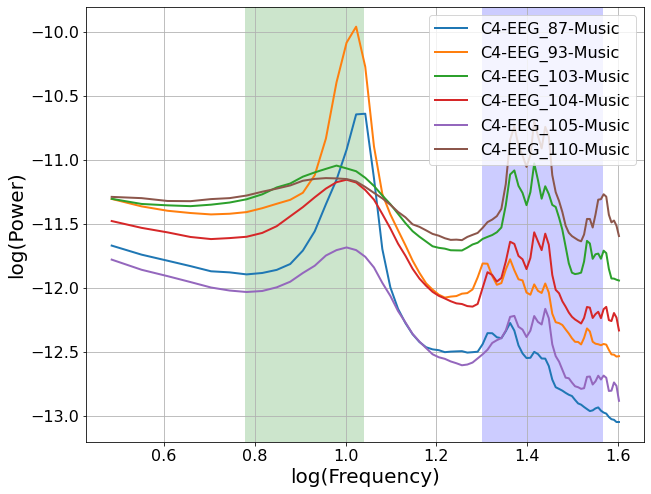

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['C4-EEG_87-Music', 'C4-EEG_93-Music', 'C4-EEG_103-Music', 'C4-EEG_104-Music', 'C4-EEG_105-Music', 'C4-EEG_110-Music']
plot_spectra_shading(freqs_1_1, [powers_1_1, powers_1_2, powers_1_3,powers_1_4, powers_1_5, powers_1_6], [[6, 11], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting only Slow Wave (music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.9992, 1.4376                                         
                                                                                                  
                                       1 peaks were found:                                        
          

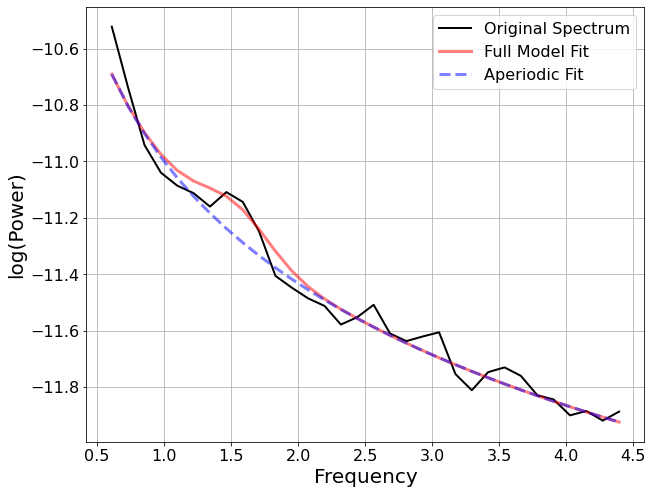

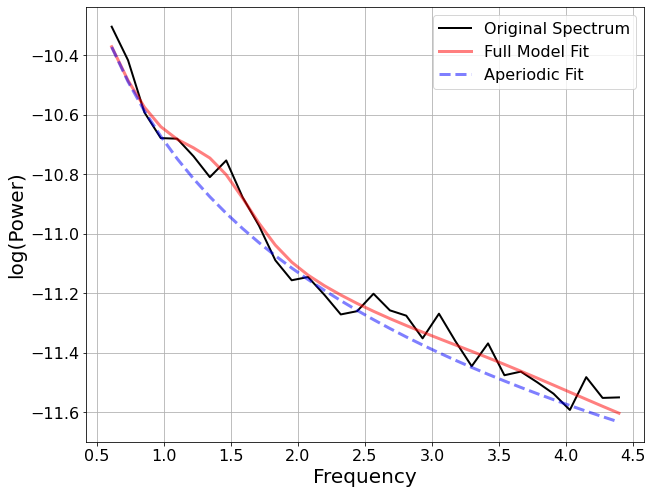

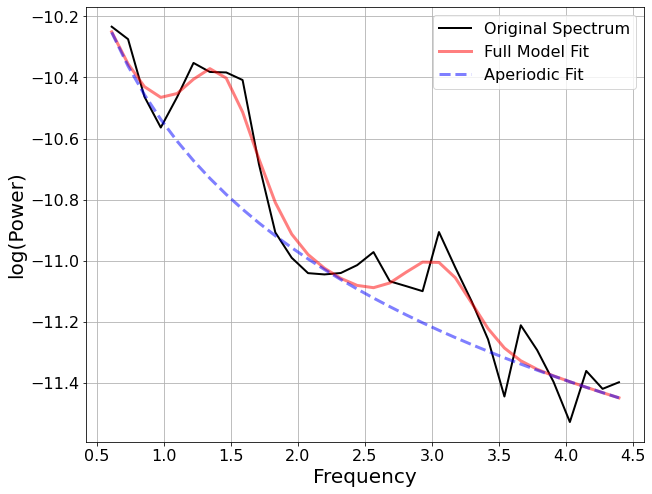

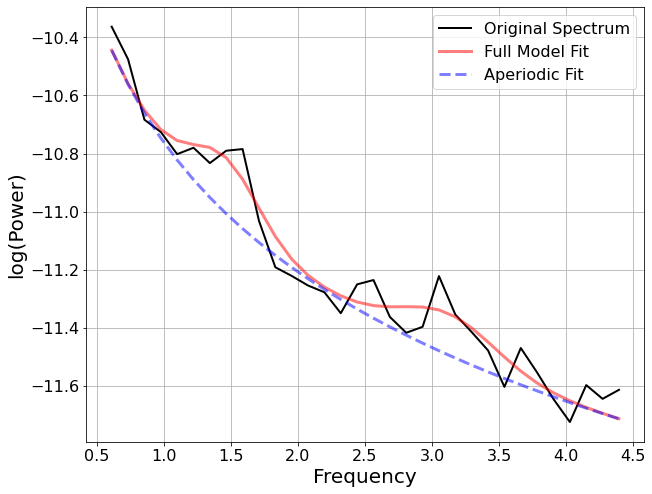

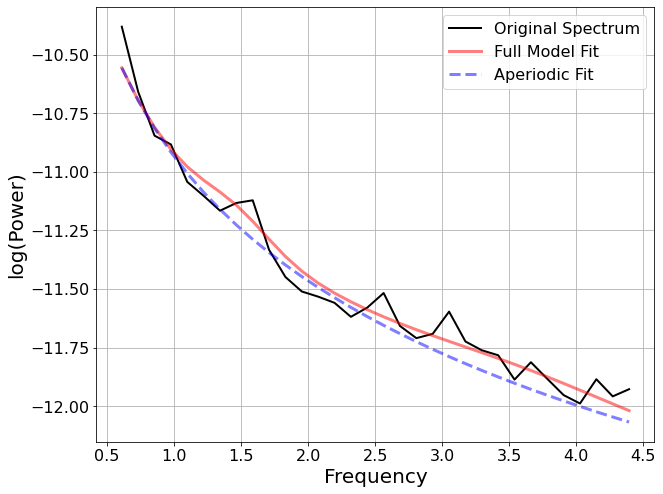

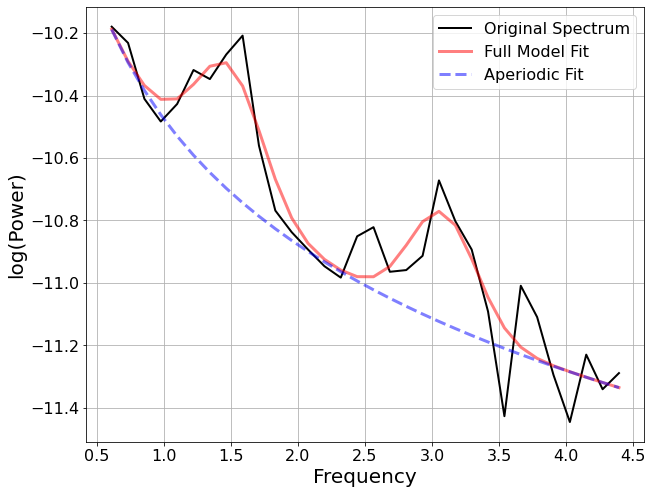

In [ ]:
# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
EEG_87_fm_mus_sw = FOOOF()
EEG_93_fm_mus_sw = FOOOF()
EEG_103_fm_mus_sw = FOOOF()
EEG_104_fm_mus_sw = FOOOF()
EEG_105_fm_mus_sw = FOOOF()
EEG_110_fm_mus_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
EEG_87_mus_sw = EEG_87_fm_mus_sw.report(freqs, psd[0].flatten(), freq_range)
EEG_93_mus_sw = EEG_93_fm_mus_sw.report(freqs, psd[1].flatten(), freq_range)
EEG_103_mus_sw = EEG_103_fm_mus_sw.report(freqs, psd[2].flatten(), freq_range)
EEG_104_mus_sw = EEG_104_fm_mus_sw.report(freqs, psd[3].flatten(), freq_range)
EEG_105_mus_sw = EEG_105_fm_mus_sw.report(freqs, psd[4].flatten(), freq_range)
EEG_110_mus_sw = EEG_110_fm_mus_sw.report(freqs, psd[5].flatten(), freq_range)

Extracting only beta (music)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.2554, 1.0577                                         
                                                                                                  
                                       9 peaks were found:                                        
          

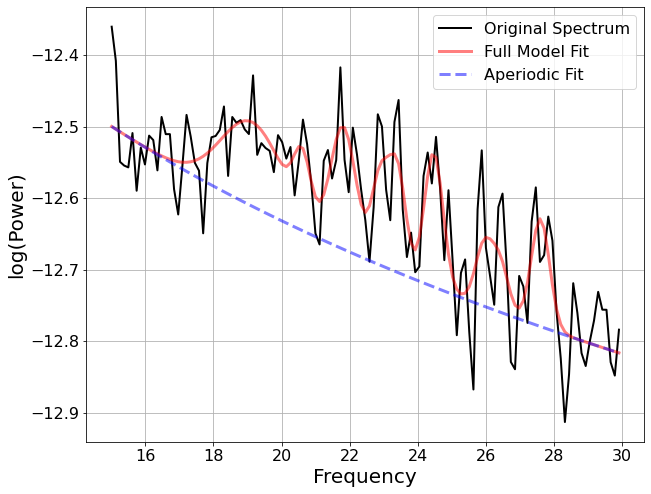

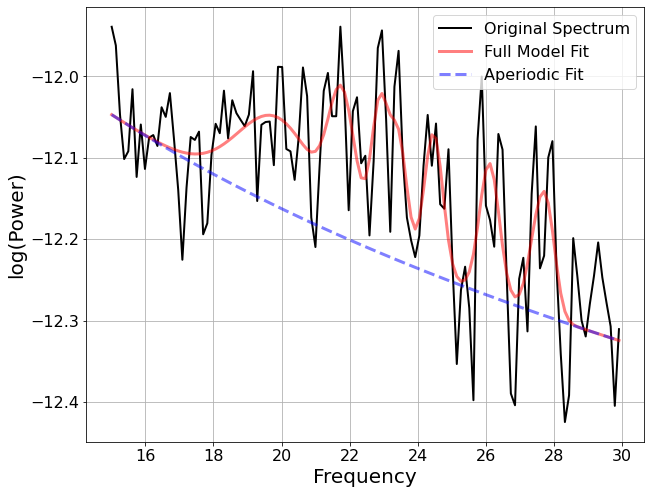

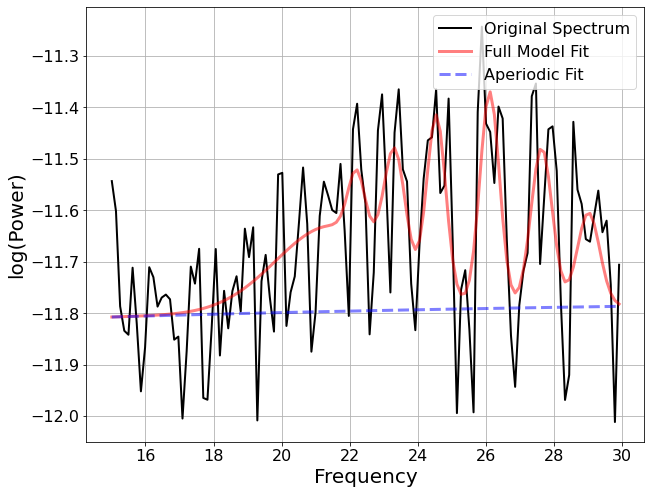

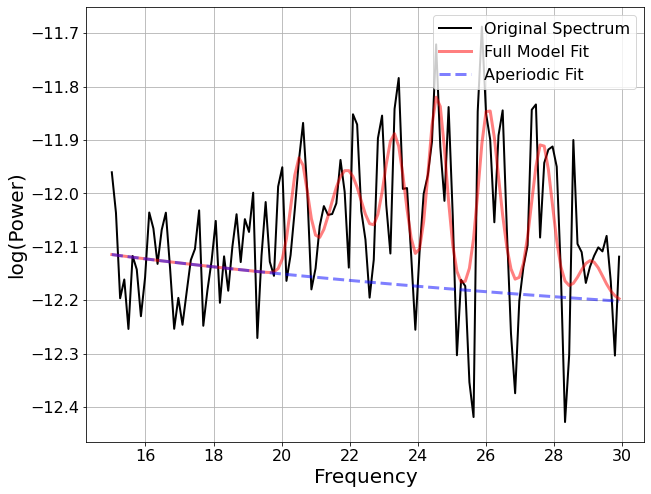

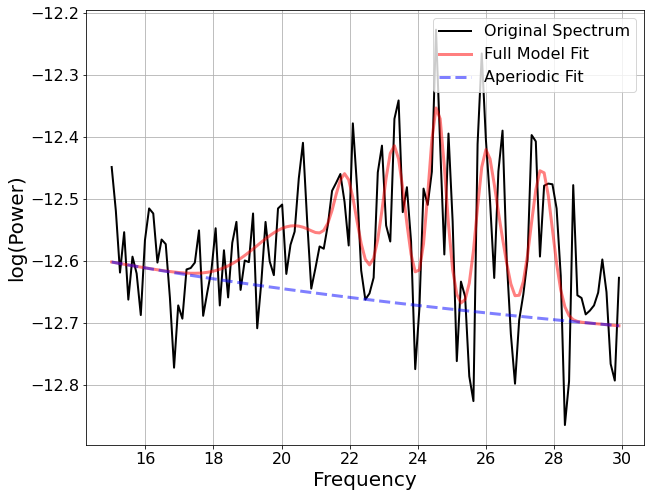

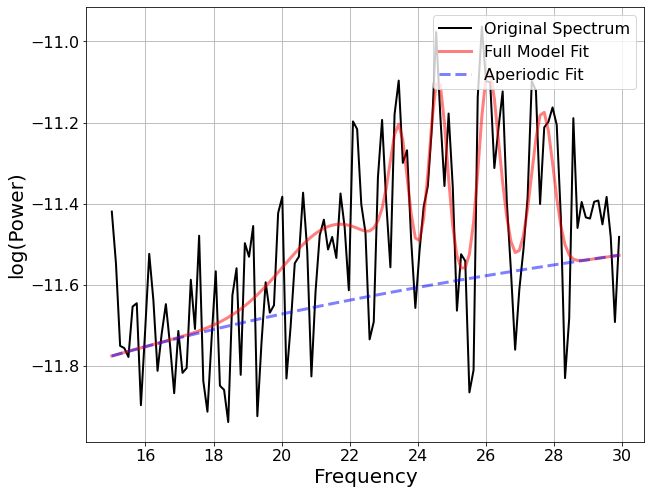

In [ ]:
# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
EEG_87_fm_mus_b = FOOOF()
EEG_93_fm_mus_b = FOOOF()
EEG_103_fm_mus_b = FOOOF()
EEG_104_fm_mus_b = FOOOF()
EEG_105_fm_mus_b = FOOOF()
EEG_110_fm_mus_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
EEG_87_mus_b = EEG_87_fm_mus_b.report(freqs, psd[0].flatten(), freq_range)
EEG_93_mus_b = EEG_93_fm_mus_b.report(freqs, psd[1].flatten(), freq_range)
EEG_103_mus_b = EEG_103_fm_mus_b.report(freqs, psd[2].flatten(), freq_range)
EEG_104_mus_b = EEG_104_fm_mus_b.report(freqs, psd[3].flatten(), freq_range)
EEG_105_mus_b = EEG_105_fm_mus_b.report(freqs, psd[4].flatten(), freq_range)
EEG_110_mus_b = EEG_110_fm_mus_b.report(freqs, psd[5].flatten(), freq_range)

Computing sw/beta ratios (music)

In [ ]:
EEG_87_mus_ratio = sum(EEG_87_fm_mus_sw.power_spectrum) / sum(EEG_87_fm_mus_b.power_spectrum)
EEG_93_mus_ratio = sum(EEG_93_fm_mus_sw.power_spectrum) / sum(EEG_93_fm_mus_b.power_spectrum)
EEG_103_mus_ratio = sum(EEG_103_fm_mus_sw.power_spectrum) / sum(EEG_103_fm_mus_b.power_spectrum)
EEG_104_mus_ratio = sum(EEG_104_fm_mus_sw.power_spectrum) / sum(EEG_104_fm_mus_b.power_spectrum)
EEG_105_mus_ratio = sum(EEG_105_fm_mus_sw.power_spectrum) / sum(EEG_105_fm_mus_b.power_spectrum)
EEG_110_mus_ratio = sum(EEG_110_fm_mus_sw.power_spectrum) / sum(EEG_110_fm_mus_b.power_spectrum)

In [ ]:
raw2 = mne.io.read_raw_edf('msm_p03_t3.edf') 
raw2.crop(tmin = 339, tmax = 939)
raw2.pick_channels(['EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'])

Extracting EDF parameters from /content/drive/Shareddrives/COGS 138/msm_p03_t3.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~11 kB, data not loaded>

In [ ]:
channel_renaming_dict = {'EEG 87': 'CP2', 'EEG 93': 'CP4', 'EEG 103': 'CP6', 'EEG 104': 'C4', 'EEG 105': 'C2', 'EEG 110': 'C6'}

raw2.rename_channels(channel_renaming_dict)  # happens in-place

raw2.ch_names

['CP2', 'CP4', 'CP6', 'C4', 'C2', 'C6']

In [ ]:
montage = mne.channels.make_standard_montage('standard_1020')

raw2.set_montage(montage)

<RawEDF | msm_p03_t3.edf, 6 x 300001 (600.0 s), ~16 kB, data not loaded>

Fitting ICA to data using 6 channels (please be patient, this may take a while)


<ipython-input-35-1f682e7cb6ee>:2: RuntimeWarning: The data has not been high-pass filtered. For good ICA performance, it should be high-pass filtered (e.g., with a 1.0 Hz lower bound) before fitting ICA.
  ica.fit(raw2)


Selecting by number: 6 components
Fitting ICA took 4.3s.
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
Not setting metadata
Not setting metadata
300 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


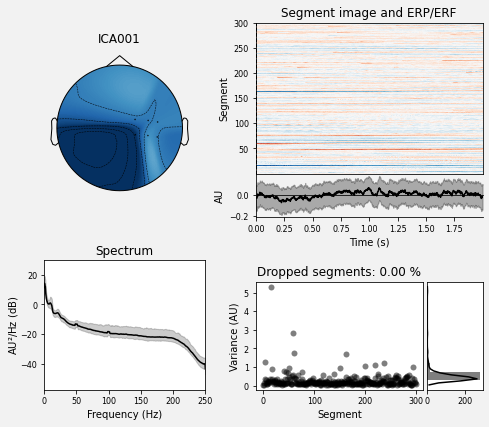

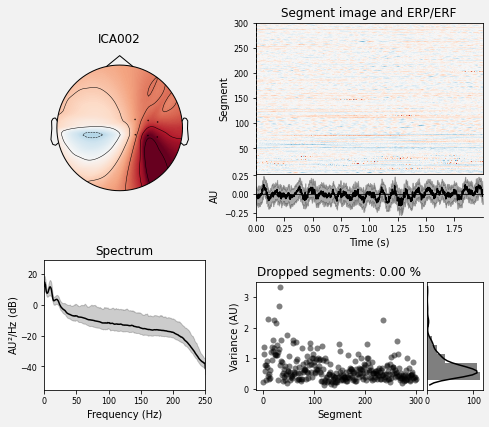

In [ ]:
ica = mne.preprocessing.ICA(n_components=6, random_state=97, max_iter=800)
ica.fit(raw2)
ica.exclude = [1, 2]  # details on how we picked these are omitted here
ica.plot_properties(raw2, picks=ica.exclude)
plt.show()

In [ ]:
# for ann in raw2.annotations:
#     descr = ann['description']
#     start = ann['onset']
#     # end = ann['onset'] + ann['duration']
#     print(f"'{descr}' starts at {start}")

Reading 0 ... 300000  =      0.000 ...   600.000 secs...
Effective window size : 4.096 (s)


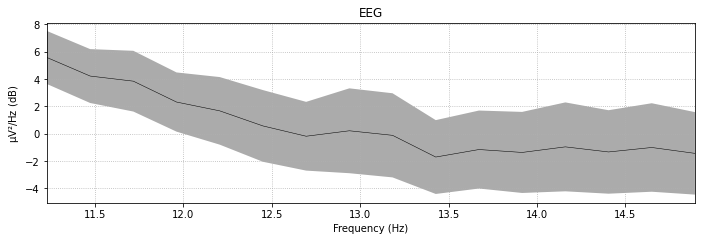

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=11, fmax=15, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


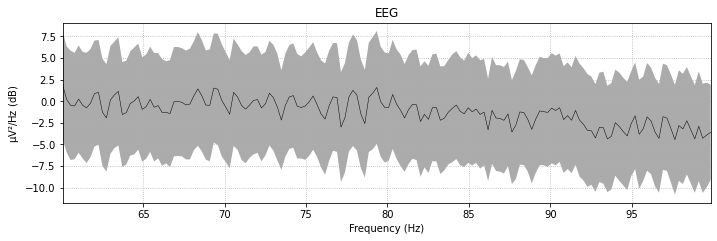

In [ ]:
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


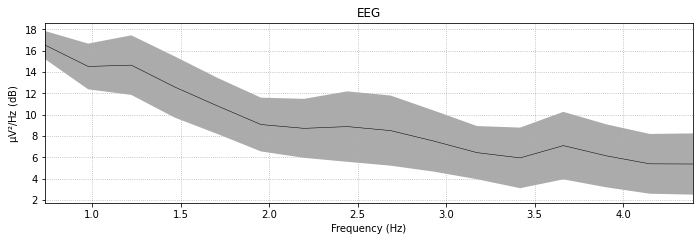

In [ ]:
# SWS
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=0.5, fmax=4.5, average = 'Median')
plt.show()

Effective window size : 4.096 (s)


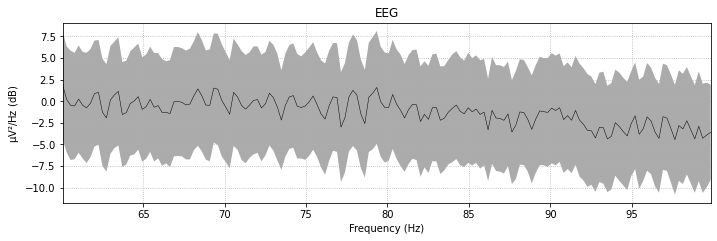

In [ ]:
# Beta Waves
spectrum = mne.viz.plot_raw_psd(raw2.load_data(), fmin=60, fmax=100, average = 'Median')
plt.show()

In [ ]:
psd2, freqs2 = mne.time_frequency.psd_array_welch(raw2.get_data(), sfreq=raw2.info['sfreq'], n_fft=4096)
psd2.shape,freqs2.shape

Effective window size : 8.192 (s)


((6, 2049), (2049,))

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 3 - 40 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.9631, 1.2413                                         
                                                                                                  
                                       18 peaks were found:                                       
          

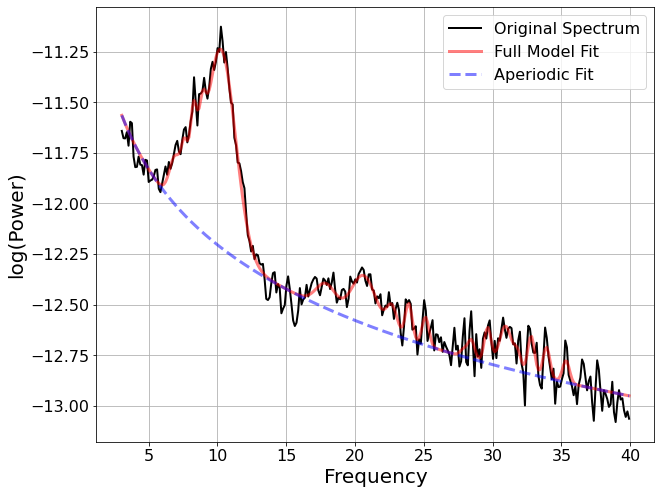

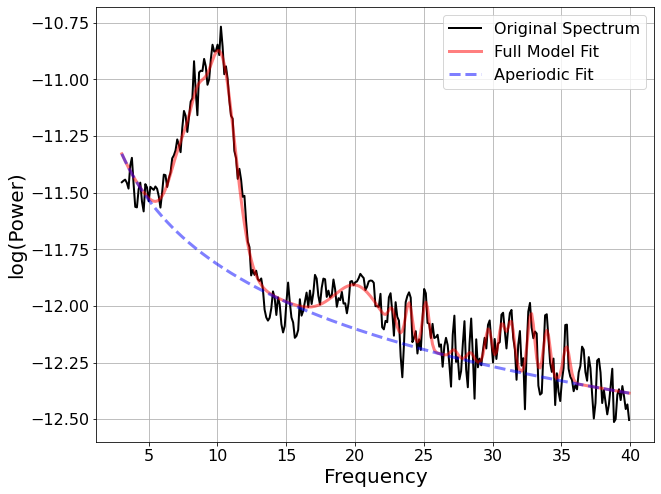

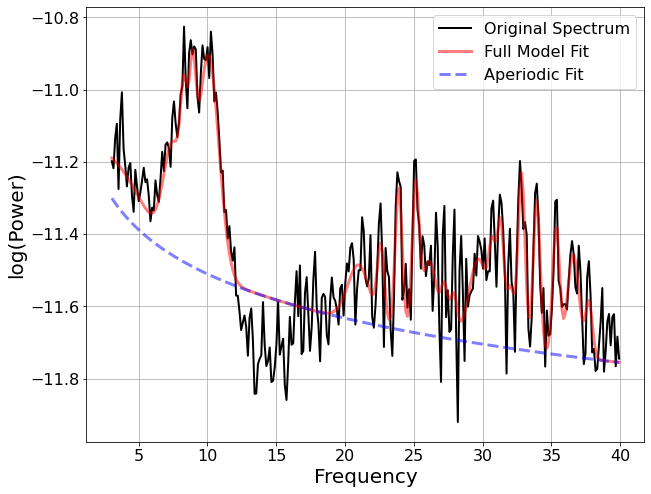

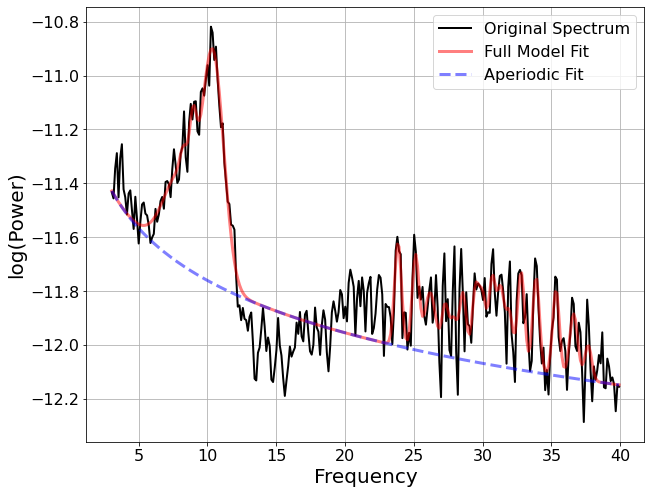

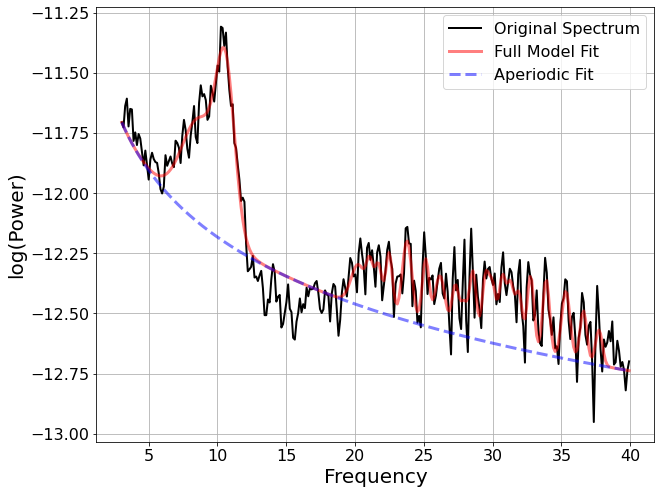

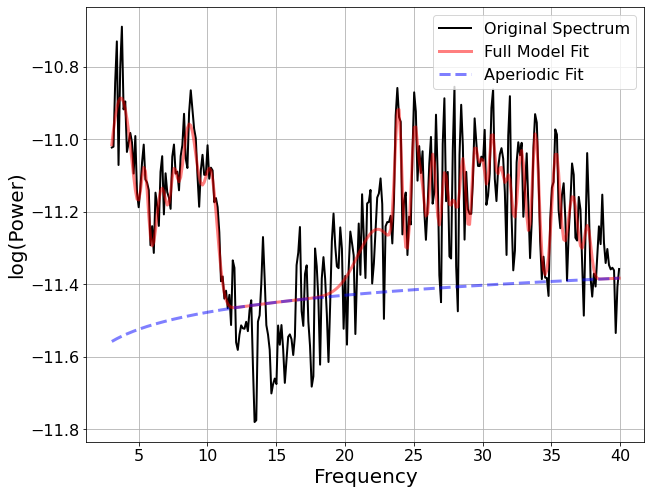

In [ ]:
# 'EEG 87': 'CP2', 'EEG 93': 'CP4', 'EEG 103': 'CP6', 'EEG 104': 'C4', 'EEG 105': 'C2', 'EEG 110': 'C6'
EEG_87_fm2 = FOOOF()
EEG_93_fm2 = FOOOF()
EEG_103_fm2 = FOOOF()
EEG_104_fm2 = FOOOF()
EEG_105_fm2 = FOOOF()
EEG_110_fm2 = FOOOF()

# freq_range = [11,15] 
freq_range2 = [3,40] 
# freq_range = [.5,4.5] # SWA 
# freq_range = [3,40] # Beta


EEG_87 = EEG_87_fm2.report(freqs2, psd2[0].flatten(), freq_range2)
EEG_93 = EEG_93_fm2.report(freqs2, psd2[1].flatten(), freq_range2)
EEG_103 = EEG_103_fm2.report(freqs2, psd2[2].flatten(), freq_range2)
EEG_104 = EEG_104_fm2.report(freqs2, psd2[3].flatten(), freq_range2)
EEG_105 = EEG_105_fm2.report(freqs2, psd2[4].flatten(), freq_range2)
EEG_110 = EEG_110_fm2.report(freqs2, psd2[5].flatten(), freq_range2)

In [ ]:
#'EEG 87': 'CP2', 'EEG 93': 'CP4', 'EEG 103': 'CP6', 'EEG 104': 'C4', 'EEG 105': 'C2', 'EEG 110': 'C6'
Freqs_C4_text = [EEG_87_fm2.freqs,EEG_93_fm2.freqs,EEG_103_fm2.freqs,EEG_104_fm2.freqs,EEG_105_fm2.freqs,EEG_110_fm2.freqs]
Power_Spectrum_C4_Text = [EEG_87_fm2.power_spectrum,EEG_93_fm2.power_spectrum,EEG_103_fm2.power_spectrum,EEG_104_fm2.power_spectrum,EEG_105_fm2.power_spectrum,EEG_110_fm2.power_spectrum]

In [ ]:
# Text_Spec_1 = plot_spectrum(Freqs_C4_text[0], Power_Spectrum_C4_Text[0])
# Text_Spec_2 = plot_spectrum(Freqs_C4_text[1], Power_Spectrum_C4_Text[1])
# Text_Spec_3 = plot_spectrum(Freqs_C4_text[2], Power_Spectrum_C4_Text[2])
# Text_Spec_4 = plot_spectrum(Freqs_C4_text[3], Power_Spectrum_C4_Text[3])
# Text_Spec_5 = plot_spectrum(Freqs_C4_text[4], Power_Spectrum_C4_Text[4])
# Text_Spec_6 = plot_spectrum(Freqs_C4_text[5], Power_Spectrum_C4_Text[5])

In [ ]:
# spec_2 = plot_spectrum(fm2.freqs, fm2.power_spectrum)
# plt.show()

In [ ]:
Freq_Range_C4_Text = [EEG_87_fm2.freq_range,EEG_93_fm2.freq_range,EEG_103_fm2.freq_range,EEG_104_fm2.freq_range,EEG_105_fm2.freq_range,EEG_110_fm2.freq_range]
Aperiodic_Params_C4_Text = [list(EEG_87_fm2.aperiodic_params_),list(EEG_93_fm2.aperiodic_params_),list(EEG_103_fm2.aperiodic_params_),list(EEG_104_fm2.aperiodic_params_),list(EEG_105_fm2.aperiodic_params_),list(EEG_110_fm2.aperiodic_params_)]
Peak_Params_C4_Text = [EEG_87_fm2.peak_params_.tolist(),EEG_93_fm2.peak_params_.tolist(),EEG_103_fm2.peak_params_.tolist(),EEG_104_fm2.peak_params_.tolist(),EEG_105_fm2.peak_params_.tolist(),EEG_110_fm2.peak_params_.tolist()]

In [ ]:
freqs_2_1, powers_2_1 = gen_power_spectrum(Freq_Range_C4_Text[0], Aperiodic_Params_C4_Text[0], Peak_Params_C4_Text[0])
freqs_2_2, powers_2_2 = gen_power_spectrum(Freq_Range_C4_Text[1], Aperiodic_Params_C4_Text[1], Peak_Params_C4_Text[1])
freqs_2_3, powers_2_3 = gen_power_spectrum(Freq_Range_C4_Text[2], Aperiodic_Params_C4_Text[2], Peak_Params_C4_Text[2])
freqs_2_4, powers_2_4 = gen_power_spectrum(Freq_Range_C4_Text[3], Aperiodic_Params_C4_Text[3], Peak_Params_C4_Text[3])
freqs_2_5, powers_2_5 = gen_power_spectrum(Freq_Range_C4_Text[4], Aperiodic_Params_C4_Text[4], Peak_Params_C4_Text[4])
freqs_2_6, powers_2_6 = gen_power_spectrum(Freq_Range_C4_Text[5], Aperiodic_Params_C4_Text[5], Peak_Params_C4_Text[5])

# Text_p_1 = plot_spectrum(freqs_2_1, powers_2_1, log_powers=True)
# Text_p_2 = plot_spectrum(freqs_2_2, powers_2_2, log_powers=True)
# Text_p_3 = plot_spectrum(freqs_2_3, powers_2_3, log_powers=True)
# Text_p_4 = plot_spectrum(freqs_2_4, powers_2_4, log_powers=True)
# Text_p_5 = plot_spectrum(freqs_2_5, powers_2_5, log_powers=True)
# Text_p_6 = plot_spectrum(freqs_2_6, powers_2_6, log_powers=True)

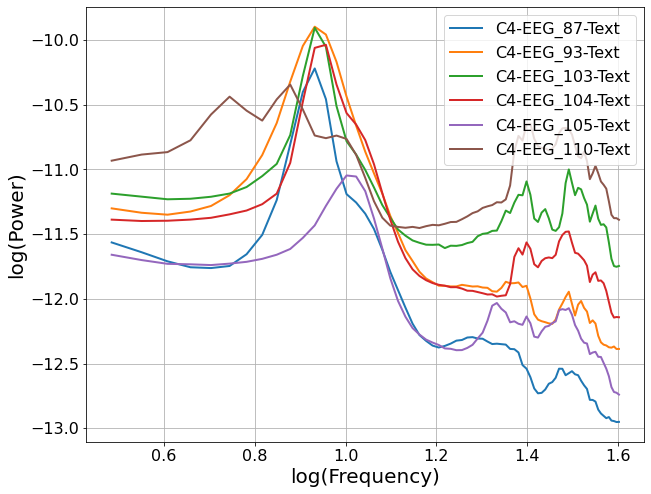

In [ ]:
# Plot multiple spectra on the same plot, in log-log space, specifying some labels
labels = ['C4-EEG_87-Text', 'C4-EEG_93-Text', 'C4-EEG_103-Text', 'C4-EEG_104-Text', 'C4-EEG_105-Text', 'C4-EEG_110-Text']#'C4-TextAudio'

plot_spectra(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], log_powers=True, log_freqs=True, labels=labels)#, log_freqs=True,

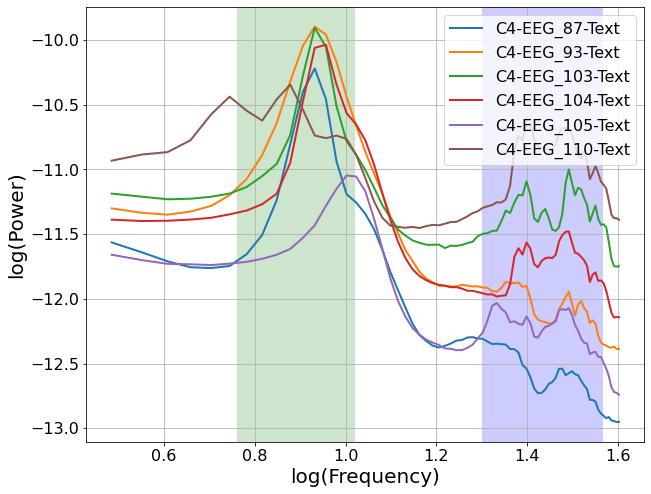

In [ ]:
# Plot multiple power spectra, with shades covering theta & beta ranges
labels = ['C4-EEG_87-Text', 'C4-EEG_93-Text', 'C4-EEG_103-Text', 'C4-EEG_104-Text', 'C4-EEG_105-Text', 'C4-EEG_110-Text']
plot_spectra_shading(freqs_2_1, [powers_2_1, powers_2_2, powers_2_3,powers_2_4, powers_2_5, powers_2_6], [[5.75, 10.5], [20, 37]],
                     log_powers=True, log_freqs=True, shade_colors=['green', 'blue'], labels=labels)

Extracting only sw (text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                        The model was run on the frequency range 0 - 5 Hz                         
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -10.9216, 1.4792                                         
                                                                                                  
                                       2 peaks were found:                                        
          

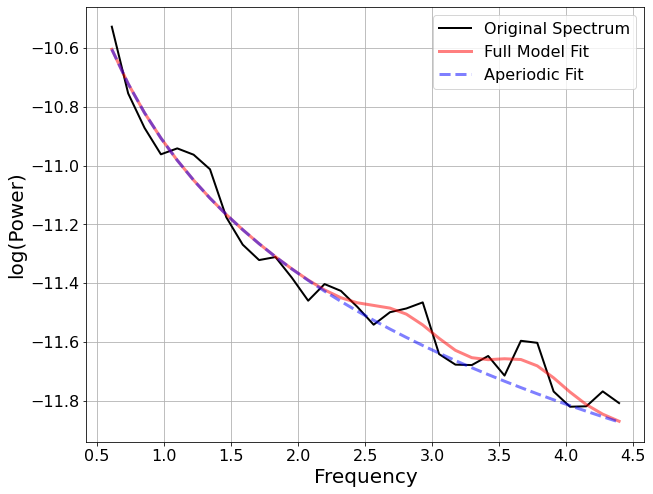

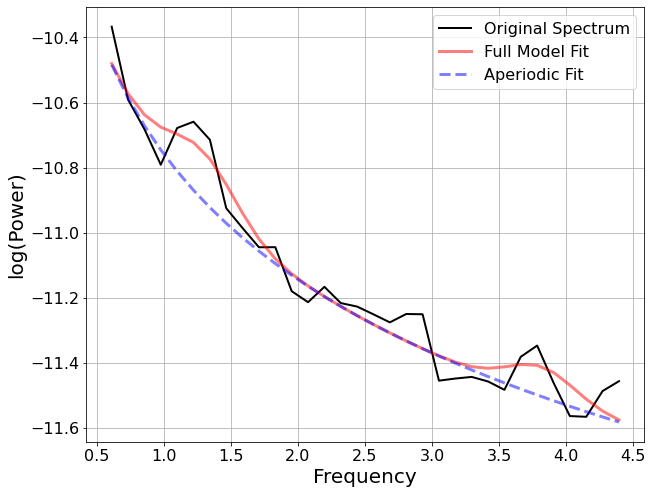

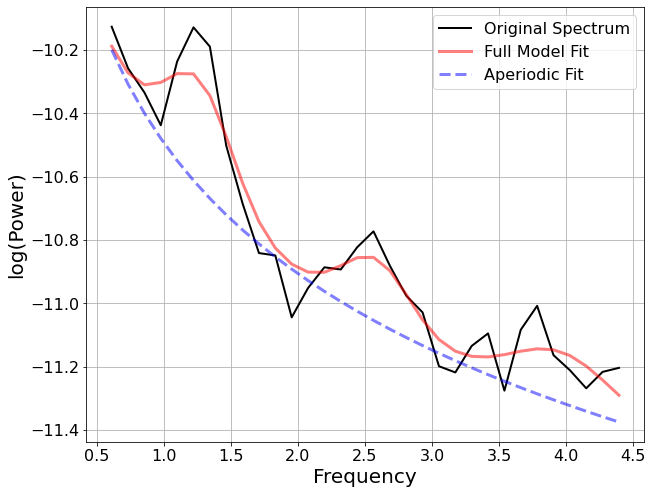

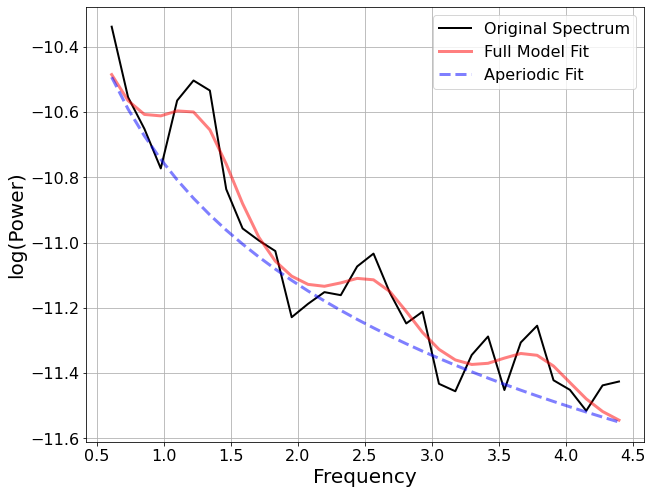

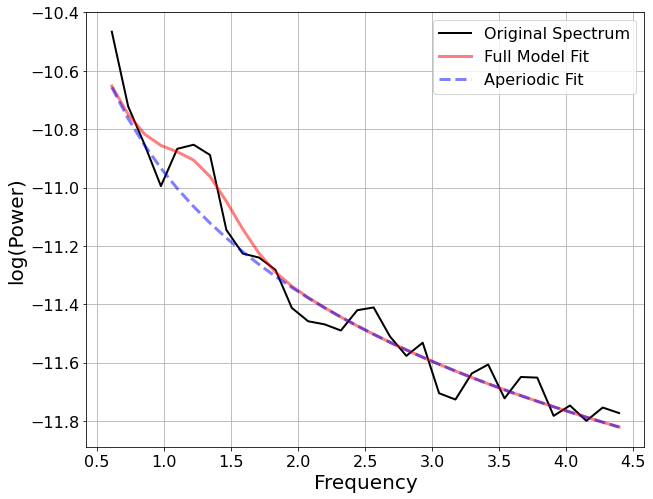

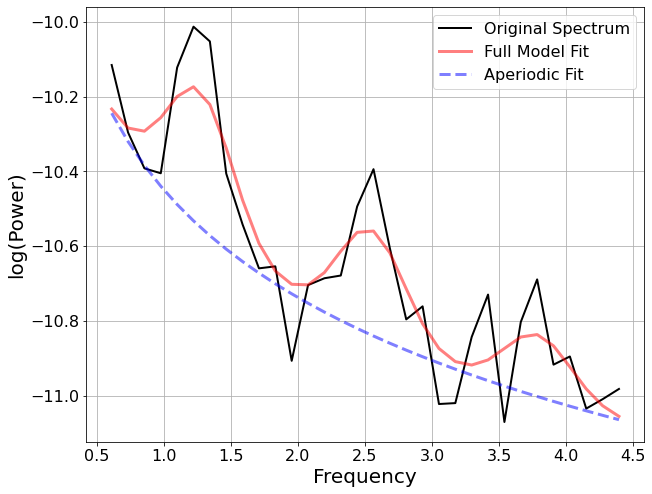

In [ ]:
# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
EEG_87_fm_text_sw = FOOOF()
EEG_93_fm_text_sw = FOOOF()
EEG_103_fm_text_sw = FOOOF()
EEG_104_fm_text_sw = FOOOF()
EEG_105_fm_text_sw = FOOOF()
EEG_110_fm_text_sw = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
freq_range = [0.5,4.5] # SWA 
# freq_range = [3,40] # Beta


# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
EEG_87_text_sw = EEG_87_fm_text_sw.report(freqs, psd2[0].flatten(), freq_range)
EEG_93_text_sw = EEG_93_fm_text_sw.report(freqs, psd2[1].flatten(), freq_range)
EEG_103_text_sw = EEG_103_fm_text_sw.report(freqs, psd2[2].flatten(), freq_range)
EEG_104_text_sw = EEG_104_fm_text_sw.report(freqs, psd2[3].flatten(), freq_range)
EEG_105_text_sw = EEG_105_fm_text_sw.report(freqs, psd2[4].flatten(), freq_range)
EEG_110_text_sw = EEG_110_fm_text_sw.report(freqs, psd2[5].flatten(), freq_range)

Extracting only beta (text)

                                                                                                  
                                   FOOOF - POWER SPECTRUM MODEL                                   
                                                                                                  
                       The model was run on the frequency range 15 - 30 Hz                        
                                 Frequency Resolution is 0.12 Hz                                  
                                                                                                  
                            Aperiodic Parameters (offset, exponent):                              
                                         -11.3226, 0.9611                                         
                                                                                                  
                                       6 peaks were found:                                        
          

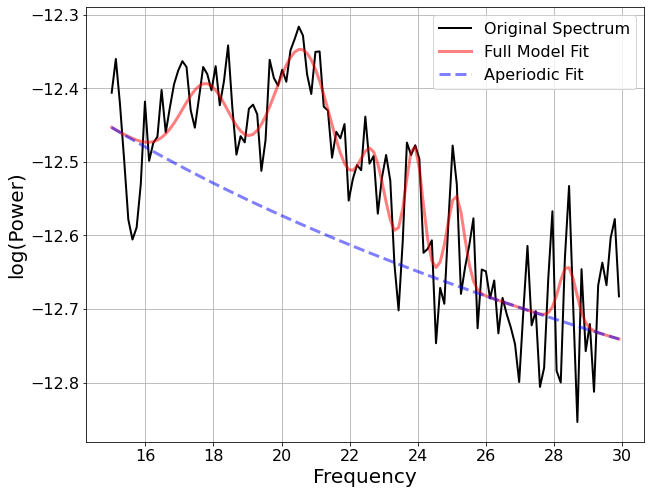

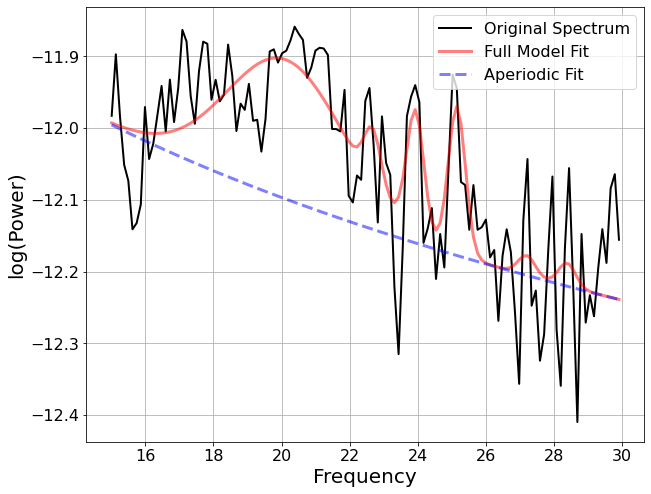

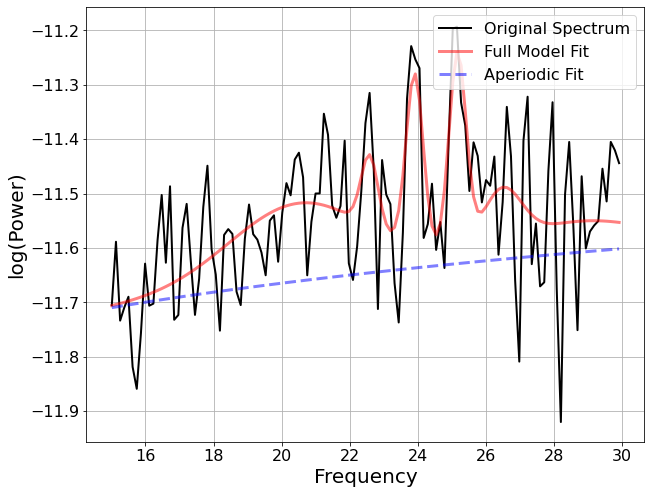

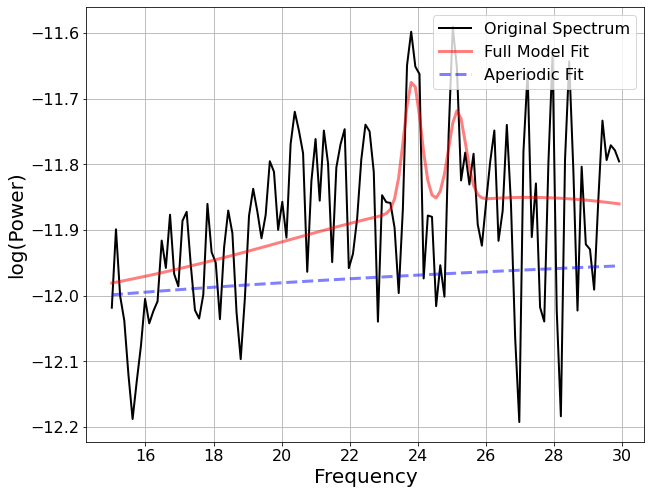

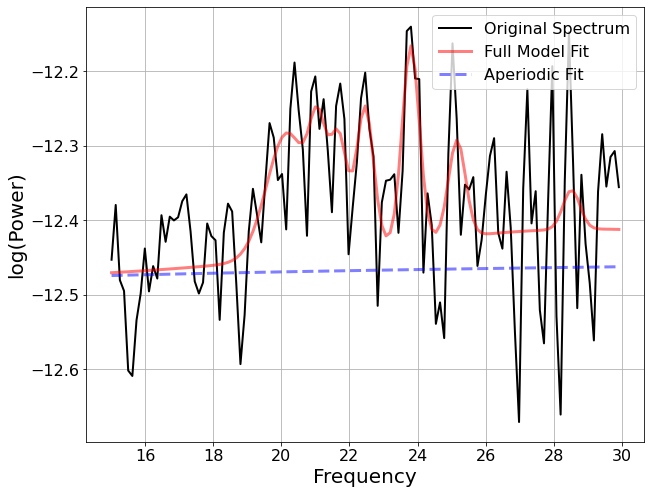

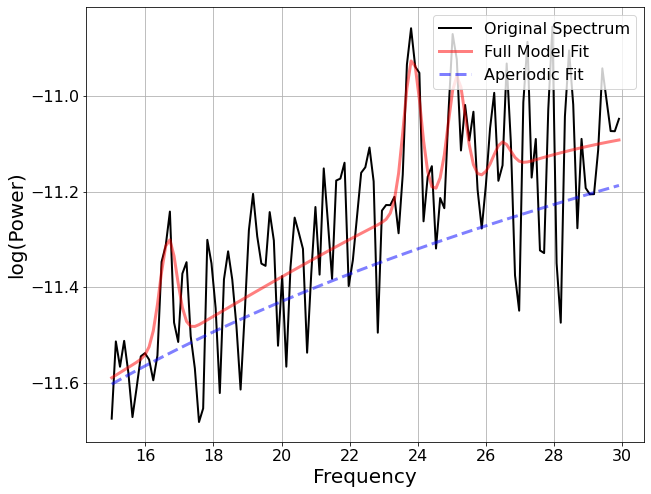

In [ ]:
# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
EEG_87_fm_text_b = FOOOF()
EEG_93_fm_text_b = FOOOF()
EEG_103_fm_text_b = FOOOF()
EEG_104_fm_text_b = FOOOF()
EEG_105_fm_text_b = FOOOF()
EEG_110_fm_text_b = FOOOF()

# freq_range = [11,15] 
# freq_range = [3,40] 
# freq_range = [0.5,4.5] # SWA 
freq_range = [15,30] # Beta


# 'EEG 87', 'EEG 93', 'EEG 103', 'EEG 104', 'EEG 105', 'EEG 110'
EEG_87_text_b = EEG_87_fm_text_b.report(freqs, psd2[0].flatten(), freq_range)
EEG_93_text_b = EEG_93_fm_text_b.report(freqs, psd2[1].flatten(), freq_range)
EEG_103_text_b = EEG_103_fm_text_b.report(freqs, psd2[2].flatten(), freq_range)
EEG_104_text_b = EEG_104_fm_text_b.report(freqs, psd2[3].flatten(), freq_range)
EEG_105_text_b = EEG_105_fm_text_b.report(freqs, psd2[4].flatten(), freq_range)
EEG_110_text_b = EEG_110_fm_text_b.report(freqs, psd2[5].flatten(), freq_range)

SW/beta ratios (text)

In [ ]:
EEG_87_text_ratio = sum(EEG_87_fm_text_sw.power_spectrum) / sum(EEG_87_fm_text_b.power_spectrum)
EEG_93_text_ratio = sum(EEG_93_fm_text_sw.power_spectrum) / sum(EEG_93_fm_text_b.power_spectrum)
EEG_103_text_ratio = sum(EEG_103_fm_text_sw.power_spectrum) / sum(EEG_103_fm_text_b.power_spectrum)
EEG_104_text_ratio = sum(EEG_104_fm_text_sw.power_spectrum) / sum(EEG_104_fm_text_b.power_spectrum)
EEG_105_text_ratio = sum(EEG_105_fm_text_sw.power_spectrum) / sum(EEG_105_fm_text_b.power_spectrum)
EEG_110_text_ratio = sum(EEG_110_fm_text_sw.power_spectrum) / sum(EEG_110_fm_text_b.power_spectrum)

Comparison between ratios for music and control(text)

In [ ]:
mus_ratios = [EEG_87_mus_ratio, EEG_93_mus_ratio, EEG_103_mus_ratio, EEG_104_mus_ratio, EEG_105_mus_ratio, EEG_110_mus_ratio]
text_ratios = [EEG_87_text_ratio, EEG_93_text_ratio, EEG_103_text_ratio, EEG_104_text_ratio, EEG_105_text_ratio, EEG_110_text_ratio]
difference = np.array(mus_ratios) - np.array(text_ratios)

In [ ]:
results = pd.DataFrame([mus_ratios, text_ratios, difference], index = ['Music', 'Text', 'Difference'], columns = [87, 93, 103, 104, 105, 110])
results = results.style.set_table_attributes("style='display:inline'").set_caption('C4 Slow Wave/Beta Activity')
results

,87,93,103,104,105,110
Music,0.236670,0.238966,0.243710,0.241497,0.237662,0.244426
Text,0.236548,0.240828,0.244328,0.242854,0.239229,0.245823
Difference,0.000122,-0.001862,-0.000617,-0.001357,-0.001567,-0.001396


Higher values of this ratio are indicative of slower EEG activity, and therefore more restorative sleep. In four of the five C4 electrodes, the slow wave / beta activity ratio in the text condition is greater than that of the music condition. However, the differences are very small.

## Conclusion & Discussion

  The data above goes along with the other findings that were referenced, but there were limitations we faced. The sheer amount of data collected for the original experiment had to be downloaded and organized before we were able to run our simulations. Due to several recordings that were not labeled we were unable to look at N1 sleep stage or the other stages of sleep. Lack of labeled electrode placement, uncoded labels, etc we found it difficult to sort which recordings would be useful to run. Given the data was not refined, extracting and reading in the data was time consuming for our group as there were results from 50 EEG readings.
  
  What we ended up doing was transferring to using Google Colab which allowed us to have access to all of the data at once by connecting to Google Drive's API which integrates extremely well with the platform and does not require us to download anything to our computers. Once we were able to compile the data, the slow wave and beta sleep activity proved to be replicated from the original paper and furthers their results that these two sleep stages can be impactful in trying to improve sleep.

   Dividing into three main regions of the brain we were able to analyze the different sleep/wake states the subjects were in. We took the measurements of 6 different electrode clusters corresponding to common brain regions analyzed in sleep. We found that from 0-5 Hz the full model fit was at a higher power than the original spectrum. Meanwhile for 15-30 Hz the full model was within the original spectrum, however from 23-25 Hz the power was higher in our full model fit. Yet the aperiodic fit was always lower than either the spectrum or our full model fit, and we noticed there was no significant difference between sws and beta ratios. Our model confirms the results for the original paper to the extent we were able to analyze. Going forward we would have liked to start off on a more collective sample size, rather than multiple individual recordings, and analyze the activity with our varying genres of music. Seeing how other factors of music could affect the activity recorded in the favored stages could also aid in the self reports of quality of sleep.

   The slow wave to beta activity ratios were very close to eachother for all six brain regions. Although we did not perform statistical analysis on the results, it is likely that the result is not significant, as was the conclusion from the initial research.

   Any other conclusions are likely insignificant as well, considering that we were only able to analyze a single participant. 

